<a href="https://colab.research.google.com/github/SergeiVKalinin/BO_Research/blob/master/sMFGP_1D_IsingModel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Multi-fidelity BO- Unstructured to Structured**
June, 2023

Multi-Fidelity BO with structured and unstructured multifidelity GP-- Example- 1D Ising model

-- Notebook prepared by **Arpan Biswas**

-- Structured GP is developed by **Maxim Ziatdinov** in GPax Python library, expanded to multi-fidelity structred GP by **Arpan Biswas**




In [ ]:
!pip install -q git+https://github.com/ziatdinovmax/gpax.git

  Preparing metadata (setup.py) ... done


In [ ]:
import gpax
import numpy as np
import matplotlib.pyplot as plt
from numpy.random import rand

from tqdm import tqdm

gpax.utils.enable_x64()  # enable double precision

from typing import Union, Dict, Callable

import math

import jax.numpy as jnp
from jax import jit
from gpax.kernels import RBFKernel

import jax
import numpyro

import time


In [ ]:
#@title square model
class IsingSim():

  """This class performs Ising model simulations on a 2D grid. Interaction parameters are given by a matrix at each lattice site.
  Field dependence is not supported at this time but will be in due course. The simulator outputs configurations after equlibrium
  as well as the trajectories, if specifically requested.
  Inputs:
    - N : (integer) - Size of lattice will be N^2. Only 2D square lattice is supported at this stage.
    - J_mat: (numpy matrix of shape(5,5)) - entries being floats for interaction parameters. Self-interaction (middle element of matrix)=0.
    - T: (float) - Reduced temperature for simulation
    - save_trajectories: (Boolean) - whether to save trajectories, or only final state. Default False.
    - eqSteps: (integer) number of Monte-Carlo steps for equlibration before simulation starts. Default 750. AKA 'burn-in'.
    - mcSteps: (integer) number of Monte-Carlo for simulation. Default 750.
  Outputs: Several outputs are available, including trajectories (if called), configurations (i.e., the 2D states) and configurations histograms.
  These can be obtained by calling methods self.configurations(), self.histograms() and self.trajectories()"""

  def __init__(self, N = 40, J_mat = None, T = 2.7, save_trajectories = False,
               eqSteps = 750, mcSteps = 750):
    self.N = N

    #If no J matrix is provided we default to isotropic J interaction with NN with value 0.5
    if np.array(J_mat).all() == None:
      J_mat = np.zeros((5,5))
      J_mat[1,2] = J_mat[2,1] = J_mat[2,3] = J_mat[3,2] = 0.5 #Defaulting to 0.5 for NN, all others zeroed out.

    self.J_mat = J_mat

    self.save_trajectories = save_trajectories
    self.eqSteps = eqSteps
    self.mcSteps = mcSteps
    self.config = self.initialState(random = False)
    self.T = T

  def initialState(self, random = False):
    ''' Generates a lattice with spin configurations drawn randomly [-1 or 1] if random=True
    Else, the lattice is generated with all sites = 1 '''

    if random==True: state = 2*np.random.randint(2, size=(self.N,self.N))-1
    else: state = np.ones([self.N,self.N])

    return state

  def mcmove(self, config):
    '''Monte Carlo move using Metropolis algorithm '''

    M = 5 #neighborhood size (M^2). Do not change!
    beta = 1.0/self.T

    for i in range(self.N):
      for j in range(self.N):
        J_mat = self.J_mat
        cost = 0.0
        s =  np.copy(config[i, j])

        for p in range(-int(M/2), int(M/2)+1, 1):
          for q in range(-int(M/2), int(M/2)+1, 1):
            cost += 2 * J_mat[int(M/2)+p, int(M/2)+q] * config[(i+p)%self.N,(j+q)%self.N] * config[i,j]

        if cost < 0:
          s *= -1
        elif rand() < np.exp(-cost*beta):
          s *= -1
        config[i, j] = s
    return config


  def calcEnergy(self, config):
    '''Returns the energy of the current configuration'''
    M = 5
    energy = 0.0
    for i in range(len(config)):
      for j in range(len(config)):
        J_mat = self.J_mat #otherwise, no

        s = config[i,j]
        for p in range(-int(M/2), int(M/2)+1, 1):
          for q in range(-int(M/2), int(M/2)+1, 1):
            energy += -J_mat[int(M/2)+p, int(M/2)+q] * config[(i+p)%self.N,(j+q)%self.N] * config[i,j]

    return energy/4.0


  def calcMag(self, config):
    '''Magnetization of a given configuration'''
    return np.sum(config)

  def calcAbsMag(self, config):
    ''' Absolute Magnetization of a given configuration'''
    return (np.abs(np.sum(config)))*1.0

  def performIsingSim(self):

    E1, M1, E2, M2 = 0.0,0.0,0.0,0.0    #These are all the average properties of all MC steps used
    E_traj, M_traj = np.zeros(self.mcSteps), np.zeros(self.mcSteps)

    config = np.copy(self.config)
    T = self.T
    if self.save_trajectories: config_mat = np.zeros([self.mcSteps,self.N,self.N])   #Saving all the configurations


    print('\n---Performing Equlibration---\n')
    for i in tqdm(range(self.eqSteps)):
        config = self.mcmove(config)

    print('\n---Finished...\n----Performing MC Moves----\n')
    for j in tqdm(range(self.mcSteps)):
        config = self.mcmove(config)
        Ene, Mag = self.calcEnergy(config), self.calcAbsMag(config)
        E_traj[j] = self.calcEnergy(config)/(self.N*self.N)
        M_traj[j] = self.calcAbsMag(config)/(self.N*self.N)

        E1 = E1 + Ene
        M1 = M1 + Mag
        M2 = M2 + Mag * Mag
        E2 = E2 + Ene * Ene

        if self.save_trajectories: config_mat[j] = config

    print('Completed. Saving')
    Energy = E1 / (self.mcSteps * self.N * self.N)
    Magnetization = M1 / (self.mcSteps * self.N * self.N)
    n1, n2  = 1.0/(self.mcSteps*self.N*self.N), 1.0/(self.mcSteps*self.mcSteps*self.N*self.N)
    iT = 1.0/self.T
    iT2 = iT*iT
    SpecificHeat = (n1*E2 - n2*E1*E1)*iT2
    Susceptibility = (n1*M2 - n2*M1*M1)*iT
    # SpecificHeat = (E2 / self.mcSteps - E1 * E1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T * self.T)
    # Susceptibility = (M2 / self.mcSteps - M1 * M1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T)

    self.config = config


    if self.save_trajectories:
      results_dict = {'config': config_mat, 'Energy': Energy, 'Magnetization': Magnetization,
      'SpecificHeat': SpecificHeat, 'Susceptibility': Susceptibility, 'E_traj': E_traj,
      'M_traj': M_traj,
      }
    else:
      results_dict = {'Energy': Energy, 'Magnetization': Magnetization,
      'SpecificHeat': SpecificHeat, 'Susceptibility': Susceptibility,
      'E_traj': E_traj, 'M_traj': M_traj,}

    self.results = results_dict

    return 'Completed simulation'

In [ ]:
#@title Triangular Ising model
import numpy as np
from numpy.random import rand
import matplotlib.pyplot as plt
from tqdm import tqdm
from matplotlib import colors
import matplotlib.patches as mpatches
from matplotlib.collections import PatchCollection


class Tri_IsingSim():

  """This class performs Ising model simulations on a 2D grid. Interaction parameters are given by a matrix at each lattice site.
  Field dependence is not supported at this time but will be in due course. The simulator outputs configurations after equlibrium
  as well as the trajectories, if specifically requested.
  Inputs:
    - N : (integer) - Size of lattice will be N^2 : 2D triangular lattice
    - J_mat: (numpy matrix of shape(3,5)) - entries being floats for interaction parameters. Self-interaction (middle element of matrix)=0.
              or: (list) of size(3,5) with each element belonging to scipy distribution from which to draw J value (for bond disorder)
    - T: (float) - Reduced temperature for simulation
    - save_trajectories: (Boolean) - whether to save trajectories, or only final state. Default False.
    - eqSteps: (integer) number of Monte-Carlo steps for equlibration before simulation starts. Default 750. AKA 'burn-in'.
    - mcSteps: (integer) number of Monte-Carlo for simulation. Default 750.
  Outputs: Several outputs are available, including trajectories (if called), configurations (i.e., the 2D states) and configurations histograms.
  These can be obtained by calling methods self.configurations(), self.histograms() and self.trajectories()"""

  def __init__(self, N = 40, J_mat = None, T = 2.7, save_trajectories = False,
               eqSteps = 750, mcSteps = 750, prop = 0.5):
    self.N = N
    self.prop = prop
    #If no J matrix is provided we default to isotropic J interaction with NN with value 0.5
    if (J_mat).all == None:
      J_mat = np.zeros((3,5))
      J_mat[0,1] = J_mat[0,3] = J_mat[1,0] = J_mat[1,4] = J_mat[2,1] = J_mat[2,3] = 0.5 #Defaulting to 0.5 for NN, all others zeroed out.

    self.J_mat = J_mat
    self.save_trajectories = save_trajectories
    self.eqSteps = eqSteps
    self.mcSteps = mcSteps
    self.config = self.initialState()
    self.T = T

  def initialState(self):
    ''' Generates a lattice with spin configurations drawn randomly [-1 or 1] if random=True
    Else, the lattice is generated with all sites = 1
    Can do better, remove probability and see how you can include numbers'''

    state = np.random.choice([1, -1], size = ([self.N,2*self.N]), p=[self.prop, 1-self.prop])

    for i in range(0,self.N,2):
      for j in range(0,2*self.N,2):
        state[i,j] = 0

    for i in range(1,self.N,2):
      for j in range(1,2*self.N,2):
        state[i,j] = 0


    return state

  def EmptySite(self, row_1, col_1, spin_1, config):
    #You can do better, this takes a lot of time because of intermittent zeros
    row_2, col_2 = row_1, col_1
    spin_2 = spin_1
    while (spin_2*spin_1 != -1.0):
        row_2, col_2     = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
        spin_2 = config[row_2, col_2]

    return row_2, col_2

  def mcmove(self):
    '''Monte Carlo move using Metropolis algorithm '''
    M = 3 #check whether you can obtain this from J_mat
    T = 5
    beta = 1.0/self.T
    config = self.config
    config_1 = np.where(config == -1, 0.0, config)

    for i in range(self.N):
      for j in range(2*self.N):
        row_1, col_1 = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
        spin_1 = config[row_1, col_1]

        if(spin_1):
          J_mat = self.J_mat
          row_2, col_2 = np.random.randint(0, self.N), np.random.randint(0, 2*self.N)
          spin_2   = config[row_2, col_2]

          if (spin_2*spin_1 != -1.0):
            (row_2, col_2) = self.EmptySite(row_1, col_1, spin_1, config)
            spin_2 = config[row_2, col_2]

          ini_ene_1, ini_ene_2, fin_ene_1, fin_ene_2 = 0.0,0.0,0.0,0.0

          if spin_1 == 1.0:
              for p in range(-int(M/2), int(M/2)+1, 1):
                for q in range(-int(T/2), int(T/2)+1, 1):
                  ini_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_1
                  ini_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_2
                  fin_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_2
                  fin_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_1

          if spin_1 == -1.0:
              for p in range(-int(M/2), int(M/2)+1, 1):
                for q in range(-int(T/2), int(T/2)+1, 1):
                  ini_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_1
                  ini_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_2
                  fin_ene_1 += -J_mat[int(M/2)+p, int(T/2)+q] * config[(row_1+p)%self.N,(col_1+q)%(2*self.N)] * spin_2
                  fin_ene_2 += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(row_2+p)%self.N,(col_2+q)%(2*self.N)] * spin_1

          cost = (fin_ene_1 + fin_ene_2) - (ini_ene_1 + ini_ene_2)
          if cost < 0 or (rand() < np.exp(-cost*beta)):
            spin_1 *= -1
            spin_2 *= -1
          config[row_1, col_1], config[row_2, col_2] = spin_1, spin_2

      self.config = config
    return None


  def calcEnergy(self):
    '''Returns the energy of the current configuration'''
    config = self.config
    config_1 = np.where(config == -1, 0.0, config)
    M = 3
    T = 5
    energy = 0.0
    for i in range(self.N):
      for j in range(2*self.N):

        J_mat = self.J_mat #otherwise, no

        s = config[i,j]
        if (s):
            if s == 1.0:
                for p in range(-int(M/2), int(M/2)+1, 1):
                    for q in range(-int(T/2), int(T/2)+1, 1):
                        energy += -J_mat[int(M/2)+p, int(T/2)+q] * config[(i+p)%self.N,(j+q)%(2*self.N)] * config[i,j]

            if s == -1.0:
                for p in range(-int(M/2), int(M/2)+1, 1):
                    for q in range(-int(T/2), int(T/2)+1, 1):
                        energy += -J_mat[int(M/2)+p, int(T/2)+q] * config_1[(i+p)%self.N,(j+q)%(2*self.N)] * config[i,j]
    return energy/4.0


  def calcMag(self):
    '''Magnetization of a given configuration'''
    return float(np.nansum(self.config))

  def calcAbsMag(self):
    ''' Absolute Magnetization of a given configuration'''
    return float(np.abs(np.nansum(self.config)))

  def performIsingSim(self):

    E1, E2 = 0.0,0.0   #These are all the average properties of all MC steps used
    E_traj = np.zeros(self.mcSteps)
    if self.save_trajectories: config_mat = np.zeros([self.mcSteps,self.N,2*self.N])   #Saving all the configurations

    print('\n---Performing Equlibration---\n')
    for i in tqdm(range(self.eqSteps)):
        self.mcmove()

    print('\n---Finished...\n----Performing MC Moves----\n')
    for j in tqdm(range(self.mcSteps)):
        self.mcmove()
        Ene = self.calcEnergy()
        E_traj[j] = Ene/(self.N*self.N)


        E1 = E1 + Ene
        E2 = E2 + Ene * Ene

        if self.save_trajectories: config_mat[j] = self.config

    print('Completed. Saving')
    Energy = E1 / (self.mcSteps * self.N * self.N)
    n1, n2  = 1.0/(self.mcSteps*self.N*self.N), 1.0/(self.mcSteps*self.mcSteps*self.N*self.N)
    iT = 1.0/self.T
    iT2 = iT*iT
    SpecificHeat = (n1*E2 - n2*E1*E1)*iT2
    # SpecificHeat = (E2 / self.mcSteps - E1 * E1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T * self.T)
    # Susceptibility = (M2 / self.mcSteps - M1 * M1 / (self.mcSteps * self.mcSteps)) / (self.N * self.T)




    if self.save_trajectories:
      results_dict = {'config': config_mat, 'Energy': Energy,
      'SpecificHeat': SpecificHeat,
      'E_traj': E_traj}
    else:
      results_dict = {'Energy': Energy, 'E_traj': E_traj,
      'SpecificHeat': SpecificHeat,
    }

    self.results = results_dict

  def plot_config(self, config, figsize = (7,7)):

    config_nozeros = np.zeros([self.N,self.N])
    k = 0
    for i in range(0,self.N):
      if i%2 == 0:
        for j in range(1,2*self.N,2):
            config_nozeros[np.unravel_index(k, config_nozeros.shape)] = config[i,j]
            k+=1
      else:
        for j in range(0,2*self.N,2):
            config_nozeros[np.unravel_index(k, config_nozeros.shape)] = config[i,j]
            k+=1

    x = np.linspace(0, 1, self.N)
    y = np.linspace(1, 0, self.N)
    X, Y = np.meshgrid(x, y)

    dx = np.diff(x)[0]
    dy = np.diff(y)[0]
    ds = np.sqrt(dx**2 +  dy**2)

    # example_data = np.random.choice([-1,1], size = (nx,ny))
    cmap = colors.ListedColormap(['blue', 'red'])
    bounds = [-1,0,1]
    norm = colors.BoundaryNorm(bounds, cmap.N)

    patches = []
    for i in x:
        for n, j in enumerate(y):
            if n%2:
                polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)
            else:
                polygon = mpatches.RegularPolygon([i, j], numVertices = 6, radius = 0.6*dx)
            patches.append(polygon)

    collection = PatchCollection(patches, cmap=cmap, norm=norm, alpha=1.0)

    fig, ax = plt.subplots(1,1, figsize = figsize)
    ax.add_collection(collection)
    ax.axes.xaxis.set_visible(False)
    ax.axes.yaxis.set_visible(False)
    collection.set_array(np.transpose(config_nozeros).ravel())

In [ ]:

def fidelity_kernel_prior() -> Dict[str, jnp.ndarray]:
    length = numpyro.sample("k_length", numpyro.distributions.Uniform(0.05, 1))
    scale = numpyro.sample("k_scale", numpyro.distributions.Uniform(0.05, 1))
    delta = numpyro.sample("delta", numpyro.distributions.Uniform(0, 1))
    return {"k_length": length, "k_scale": scale, "delta": delta}

def fidelity_kernel_prior2() -> Dict[str, jnp.ndarray]: # For structured GP, we set more relaxed/non-informative kernel. The structure GP should learn by itself
    length = numpyro.sample("k_length", numpyro.distributions.HalfNormal(1))
    scale = numpyro.sample("k_scale", numpyro.distributions.HalfNormal(1))
    delta = numpyro.sample("delta", numpyro.distributions.HalfNormal(1))
    return {"k_length": length, "k_scale": scale, "delta": delta}

@jit
def fidelity_kernel(X: jnp.ndarray, Z: jnp.ndarray,
              params: Dict[str, jnp.ndarray],
              delta: int = 1, **kwargs: float) -> jnp.ndarray:
    """
    Radial basis function kernel
    Args:
        X: 2D vector with *(number of points, number of features+fidelity)* dimension
        Note: The last column of the X matrix is the fidelity space
        Z: 2D vector with *(number of points, number of features)* dimension
        params: Dictionary with kernel hyperparameters 'k_length' and 'k_scale'
        noise: optional noise vector with dimension (n,)
    Returns:
        Computed kernel matrix betwenen X and Z
    """

    X_data = X[:, :-1]  #data space
    X_fidelity = X[:, -1] #fidelity space
    Z_data = Z[:, :-1]
    Z_fidelity = jnp.reshape(Z[:, -1], (len(Z[:, -1]), 1)) #fidelity space

    fidelity_diff = params["delta"] * jnp.abs(jnp.subtract(X_fidelity, Z_fidelity))

    fidelity_kernel =  jnp.exp(-fidelity_diff)

    # Call the existing RBFKernel function to compute the spatial correlation
    spatial_correlation = RBFKernel(X_data, Z_data, params)

    #Multi-fidelity kernel

    K = jnp.multiply(spatial_correlation, fidelity_kernel.T)
    #jax.debug.print("K: {}", K.shape)
    return K

def fidelity_acqfun(models, Data, fidelity, cost_ratio, params, ieval, isnorm=False):
    """
    multifidelity acquisition function- EI based
    Args:
        models: Multi-fidelity and low-fidelity krigging model
        Data: Unexplored data to evaluate for next sample selection in list with actual values and normalized values
        fidelity: fidelity values assigned of high and low fidelity models, in order from low to high
        cost_ratio: cost ratio between high and low fidelity models
        params: Params required for EI acq function
        ieval: All the current locations explored
        isnorm: If the data need to be normalized. Default is False

    Returns:
        array of acquisition function values, maximum acquistion value location and value
    """

    data_real = Data[0] # True data
    data_norm = Data[1] #Normalize data
    if isnorm == False:
        data = data_real
        # print(data)
    else:
        data = data_norm
        # print(data)

    gp_model = models
    X_test_hf = np.transpose(np.vstack([data[:int(data.shape[0]/2), 0], np.ones_like(data[:int(data.shape[0]/2), 0])*fidelity[0]]))
    X_test_lf = np.transpose(np.vstack([data[int(data.shape[0]/2):, 0], np.ones_like(data[int(data.shape[0]/2):, 0])*fidelity[1]]))
    X_test =np.vstack((X_test_hf, X_test_lf))
    # Compute HF acq
    HF_acq = gpax.acquisition.EI(params, gp_model, data[int(data.shape[0]/2):, :], maximize=True, noiseless=False)
    HF_acq = np.array(HF_acq)
    # Check for stability
    HF_acq[np.isnan(HF_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=HF_acq[np.isnan(HF_acq)==True].shape)*1e-3
    lf_acq = gpax.acquisition.EI(params, gp_model, data[:int(data.shape[0]/2), :], maximize=True, noiseless=False)
    lf_acq = np.array(lf_acq)
    # Check for stability
    lf_acq[np.isnan(lf_acq)==True] = np.random.uniform(low=0.0, high=1.0, size=lf_acq[np.isnan(lf_acq)==True].shape)*1e-3

    LF_acq = np.absolute(HF_acq-lf_acq)
    mf_acq =np.hstack((LF_acq, HF_acq))
    mf_acq = np.array(mf_acq)
    print(mf_acq.shape)
    # Eliminate evaluated samples from consideration to avoid repeatation in future sampling
    mf_acq[ieval] = 0
    # Compute MF acq
    MF_acq = (((X_test[:,1]-fidelity[0])/cost_ratio)*mf_acq) + ((fidelity[1]-X_test[:, 1])*mf_acq)

    maxacq_idx = MF_acq.argmax()
    maxacq_val = MF_acq.max()
    nextpt = data_real[maxacq_idx]

    # Optional- Print acq functions
    plt.plot(data_real[:int(data.shape[0]/2), 0], (mf_acq[int(data.shape[0]/2):]/cost_ratio), label="cost-adjusted HF acq", c="r")
    plt.plot(data_real[:int(data.shape[0]/2), 0], mf_acq[:int(data.shape[0]/2)], label="LF acq", c="b")
    plt.scatter(nextpt[0], maxacq_val, label="next point, f= "+ str(nextpt[1]), marker = 'X', c="g")
    plt.legend(loc="best")
    plt.xlabel("x")
    plt.ylabel("acq_func")
    plt.show()

    return MF_acq, maxacq_idx, maxacq_val



In [ ]:
lb = -2
ub = 2
N_total = 201
bounds = np.array((lb, ub), dtype=float)
fidelities = np.array((0.95, 1.0))

xs = np.linspace(lb, ub, N_total)
xs_norm = (xs-lb)/(ub-lb)

Full grid evaluation for 20x20 1D Ising model -Square Model

Evaluation 1 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.46it/s]


Completed. Saving
Time (s) to complete simulation 1: 24.528814554214478


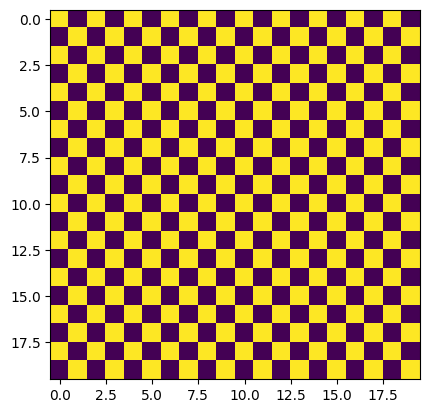

Evaluation 2 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.77it/s]


Completed. Saving
Time (s) to complete simulation 2: 23.70946764945984


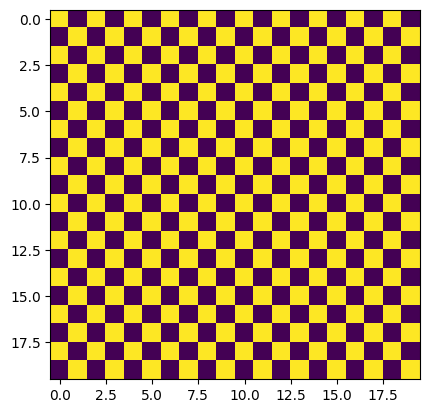

Evaluation 3 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.39it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.74it/s]


Completed. Saving
Time (s) to complete simulation 3: 23.733448028564453


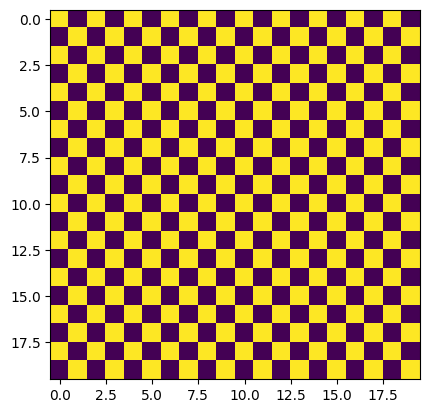

Evaluation 4 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.04it/s]


Completed. Saving
Time (s) to complete simulation 4: 23.47469925880432


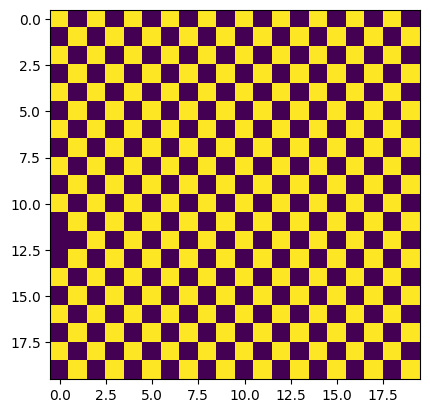

Evaluation 5 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.00it/s]


Completed. Saving
Time (s) to complete simulation 5: 23.401362895965576


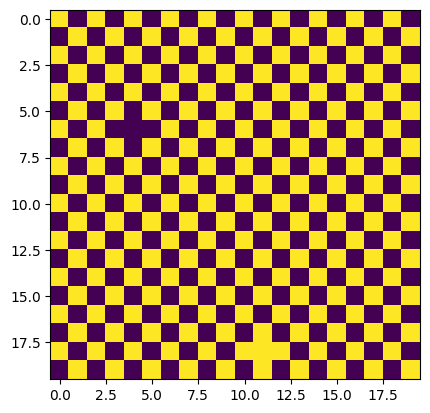

Evaluation 6 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.76it/s]


Completed. Saving
Time (s) to complete simulation 6: 23.721986770629883


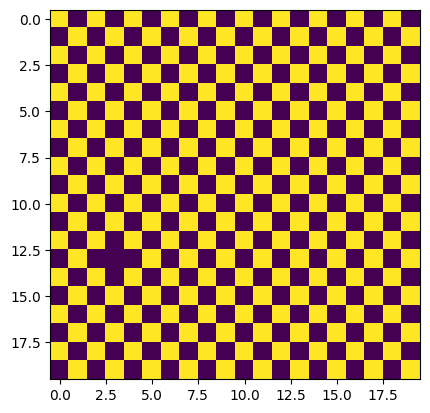

Evaluation 7 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.98it/s]


Completed. Saving
Time (s) to complete simulation 7: 23.505910396575928


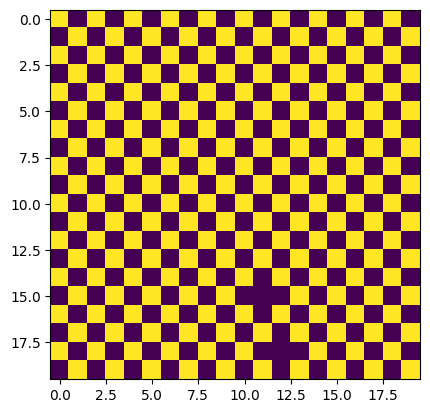

Evaluation 8 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.65it/s]


Completed. Saving
Time (s) to complete simulation 8: 23.472917318344116


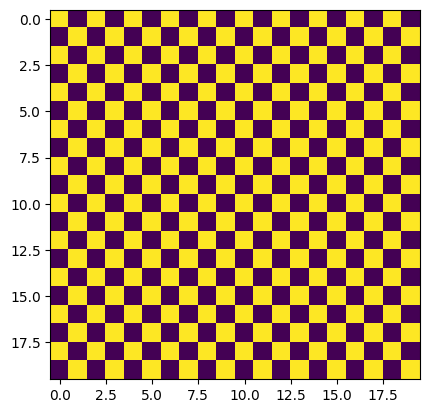

Evaluation 9 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.49it/s]


Completed. Saving
Time (s) to complete simulation 9: 23.73081636428833


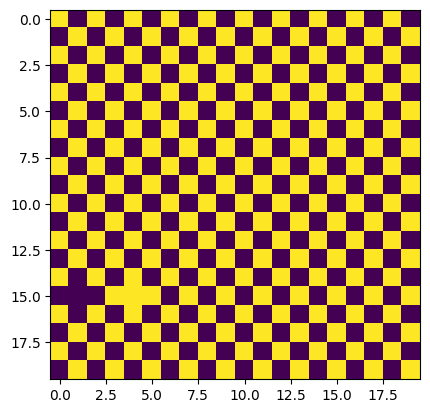

Evaluation 10 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.24it/s]


Completed. Saving
Time (s) to complete simulation 10: 23.205236673355103


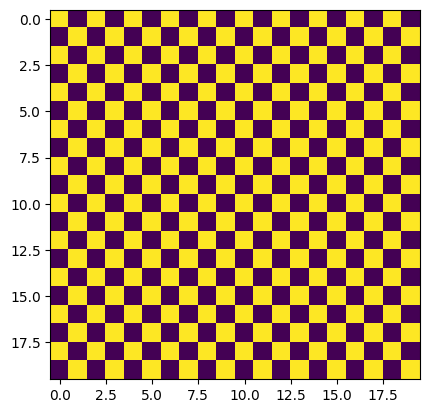

Evaluation 11 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.95it/s]


Completed. Saving
Time (s) to complete simulation 11: 23.53671884536743


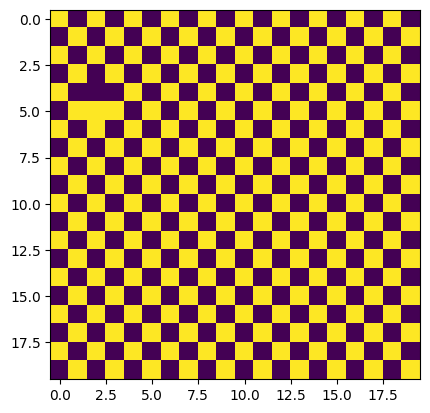

Evaluation 12 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.85it/s]


Completed. Saving
Time (s) to complete simulation 12: 23.346296787261963


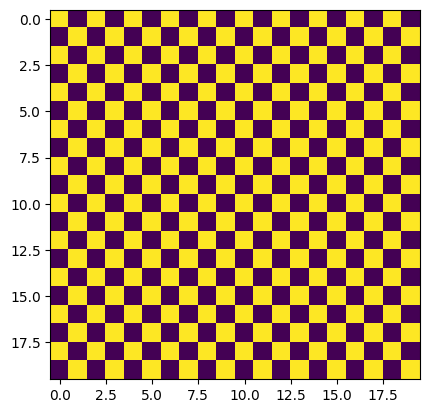

Evaluation 13 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.11it/s]


Completed. Saving
Time (s) to complete simulation 13: 23.384835720062256


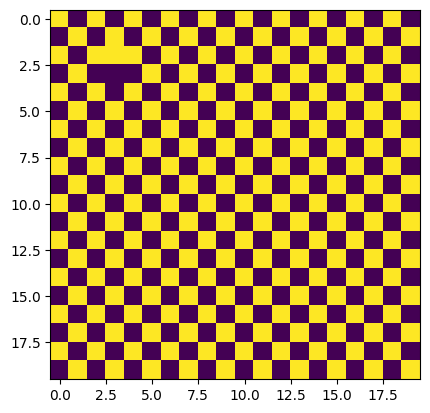

Evaluation 14 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.13it/s]


Completed. Saving
Time (s) to complete simulation 14: 23.371670246124268


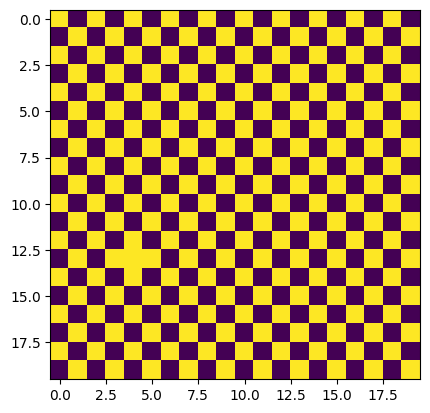

Evaluation 15 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.94it/s]


Completed. Saving
Time (s) to complete simulation 15: 23.598961114883423


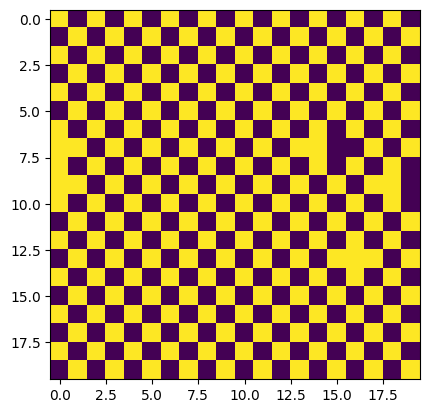

Evaluation 16 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.65it/s]


Completed. Saving
Time (s) to complete simulation 16: 23.572763204574585


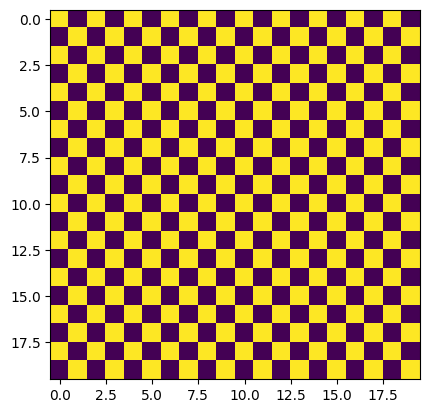

Evaluation 17 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.64it/s]


Completed. Saving
Time (s) to complete simulation 17: 23.493546962738037


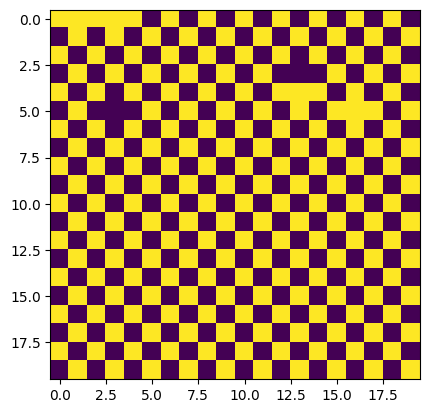

Evaluation 18 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.07it/s]


Completed. Saving
Time (s) to complete simulation 18: 23.383965492248535


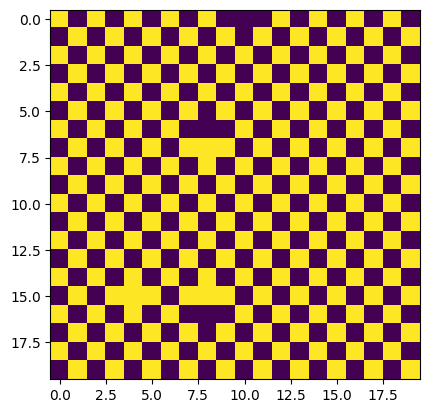

Evaluation 19 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.22it/s]


Completed. Saving
Time (s) to complete simulation 19: 23.312997817993164


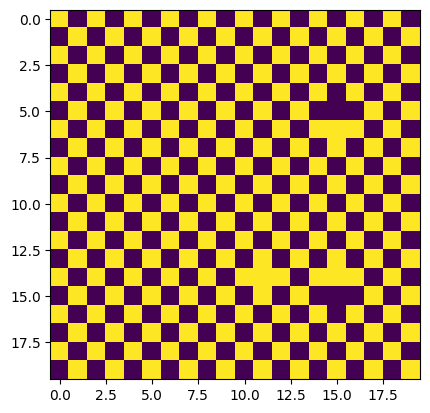

Evaluation 20 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.62it/s]


Completed. Saving
Time (s) to complete simulation 20: 23.05666995048523


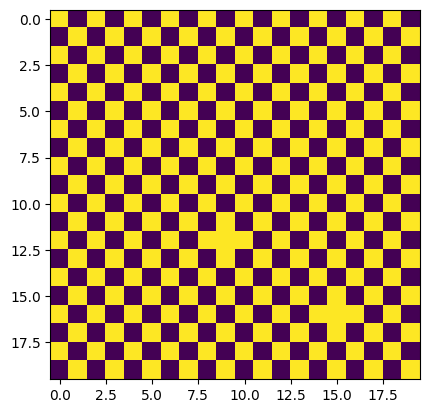

Evaluation 21 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.04it/s]


Completed. Saving
Time (s) to complete simulation 21: 23.35980749130249


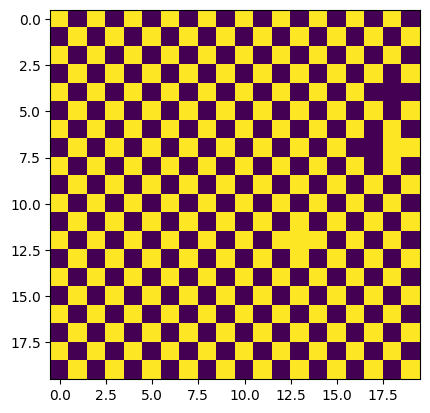

Evaluation 22 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.97it/s]


Completed. Saving
Time (s) to complete simulation 22: 23.36321496963501


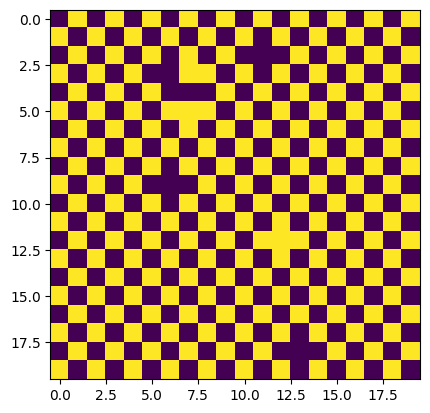

Evaluation 23 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.22it/s]


Completed. Saving
Time (s) to complete simulation 23: 23.23216462135315


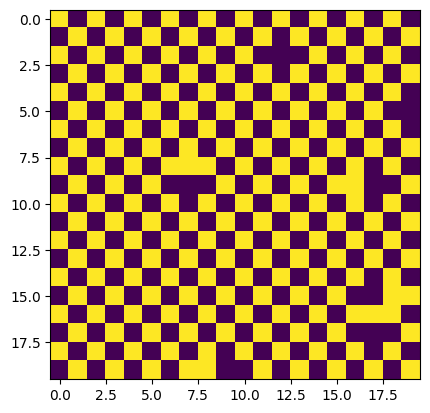

Evaluation 24 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.81it/s]


Completed. Saving
Time (s) to complete simulation 24: 23.058608293533325


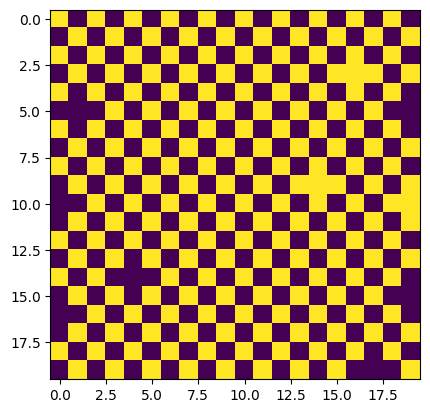

Evaluation 25 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 77.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.38it/s]


Completed. Saving
Time (s) to complete simulation 25: 22.891098499298096


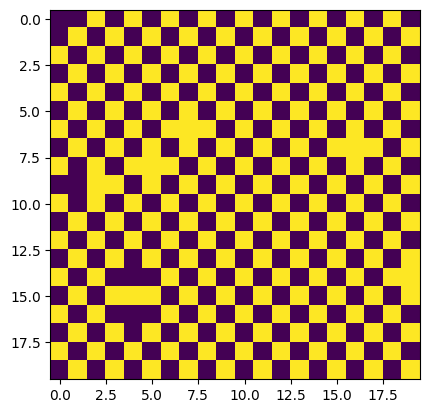

Evaluation 26 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.05it/s]


Completed. Saving
Time (s) to complete simulation 26: 23.20809507369995


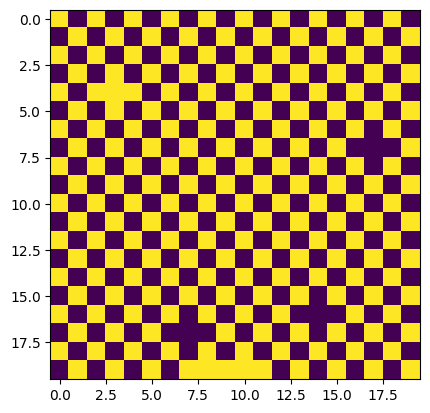

Evaluation 27 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 76.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.80it/s]


Completed. Saving
Time (s) to complete simulation 27: 22.753487586975098


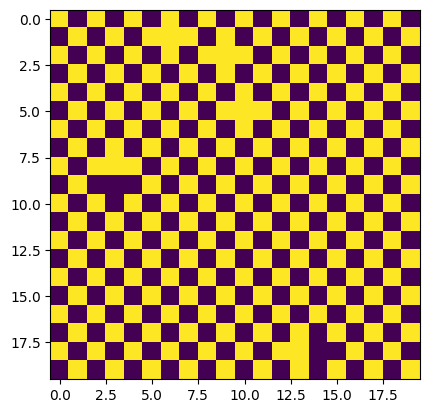

Evaluation 28 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.52it/s]


Completed. Saving
Time (s) to complete simulation 28: 23.263575315475464


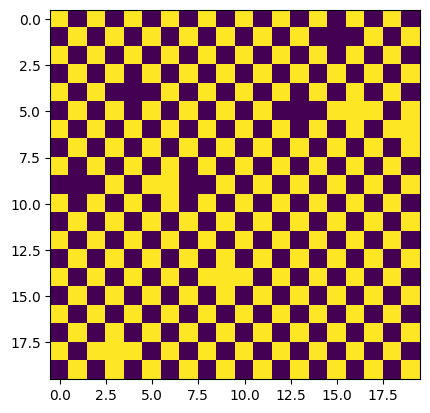

Evaluation 29 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.18it/s]


Completed. Saving
Time (s) to complete simulation 29: 23.421220064163208


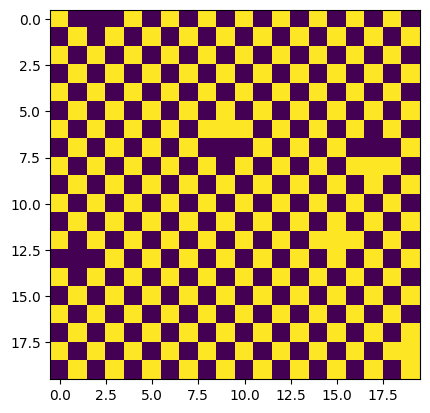

Evaluation 30 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.72it/s]


Completed. Saving
Time (s) to complete simulation 30: 23.518928050994873


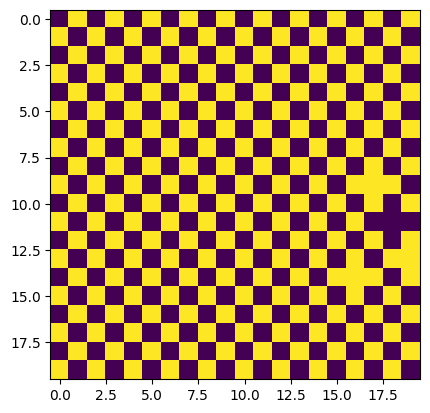

Evaluation 31 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.43it/s]


Completed. Saving
Time (s) to complete simulation 31: 23.17561388015747


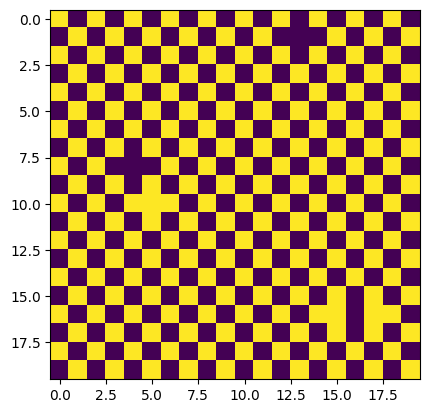

Evaluation 32 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.76it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.75it/s]


Completed. Saving
Time (s) to complete simulation 32: 23.05044388771057


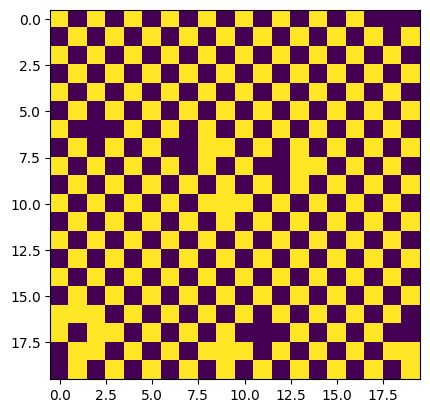

Evaluation 33 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.86it/s]


Completed. Saving
Time (s) to complete simulation 33: 23.425999641418457


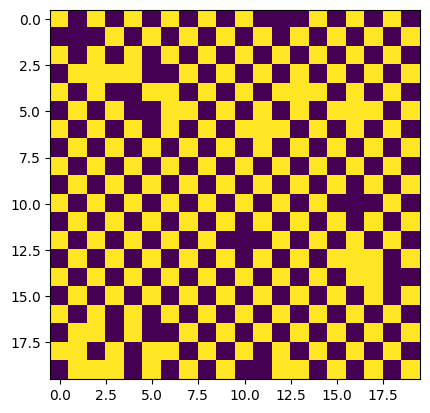

Evaluation 34 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.81it/s]


Completed. Saving
Time (s) to complete simulation 34: 23.366745710372925


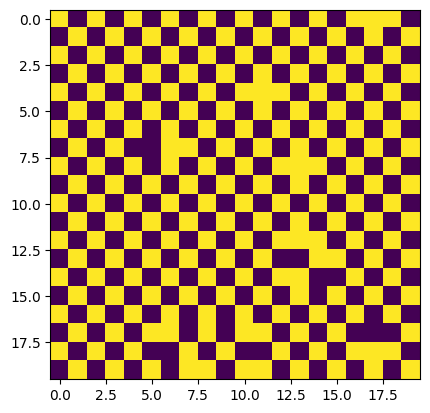

Evaluation 35 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.74it/s]


Completed. Saving
Time (s) to complete simulation 35: 23.49653196334839


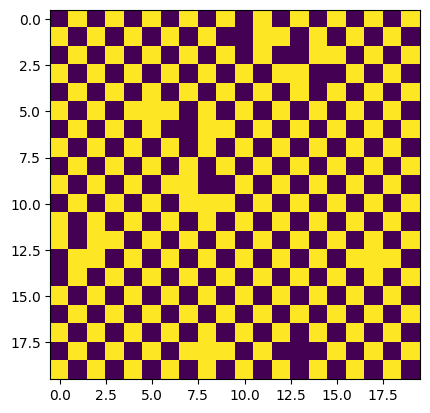

Evaluation 36 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.18it/s]


Completed. Saving
Time (s) to complete simulation 36: 23.21786332130432


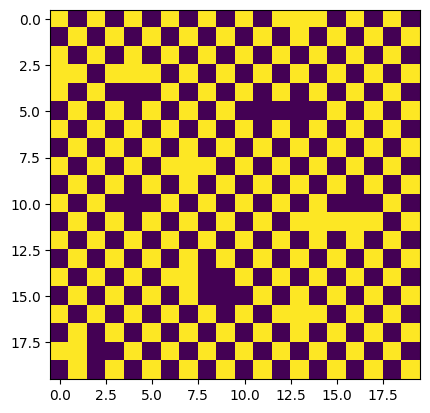

Evaluation 37 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.92it/s]


Completed. Saving
Time (s) to complete simulation 37: 23.436439037322998


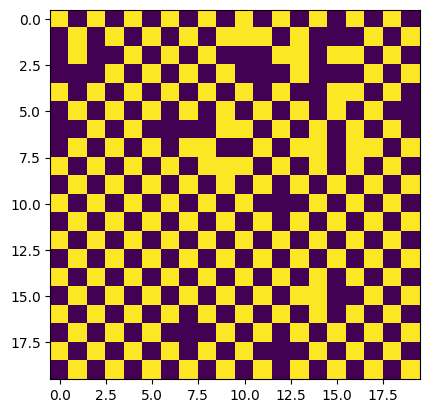

Evaluation 38 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.08it/s]


Completed. Saving
Time (s) to complete simulation 38: 23.400355100631714


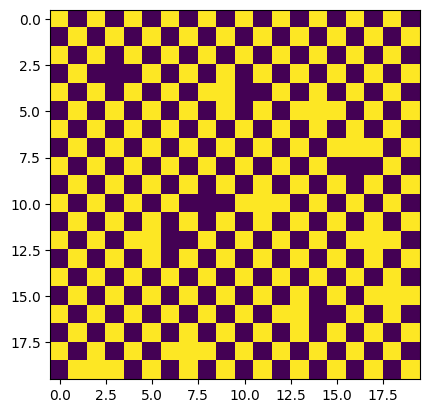

Evaluation 39 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.11it/s]


Completed. Saving
Time (s) to complete simulation 39: 23.241833686828613


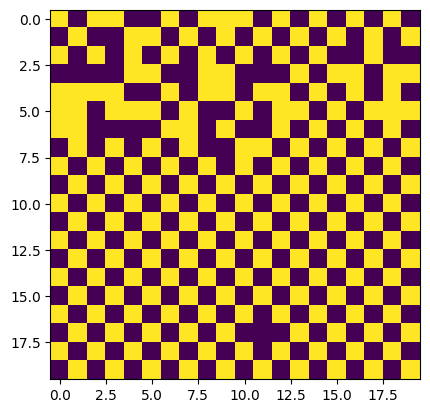

Evaluation 40 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.78it/s]


Completed. Saving
Time (s) to complete simulation 40: 23.567739248275757


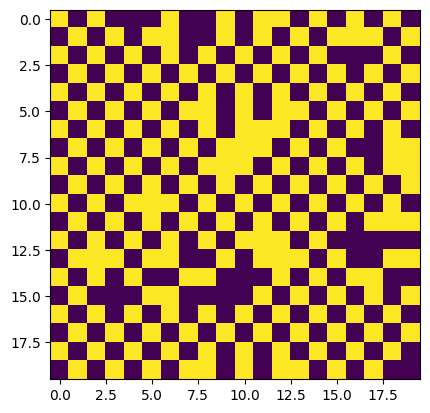

Evaluation 41 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.35it/s]


Completed. Saving
Time (s) to complete simulation 41: 23.259851932525635


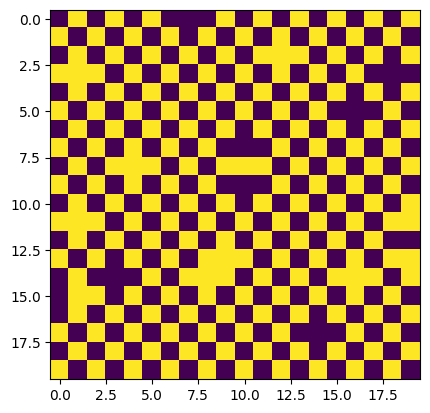

Evaluation 42 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.01it/s]


Completed. Saving
Time (s) to complete simulation 42: 24.01100754737854


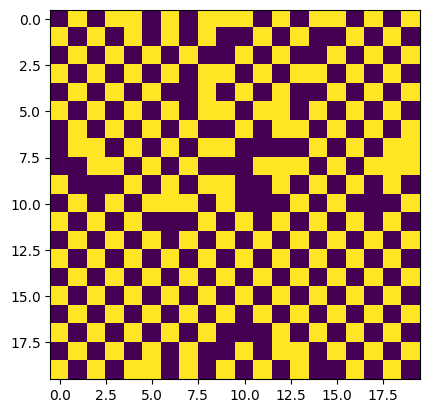

Evaluation 43 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.72it/s]


Completed. Saving
Time (s) to complete simulation 43: 23.468481063842773


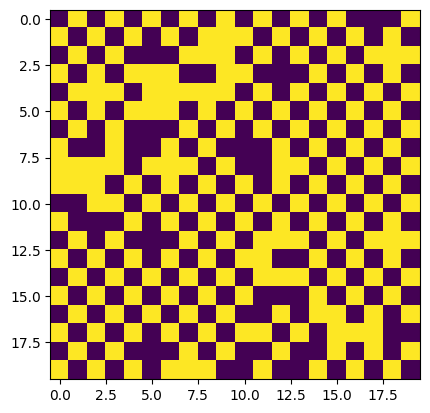

Evaluation 44 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.21it/s]


Completed. Saving
Time (s) to complete simulation 44: 23.987646341323853


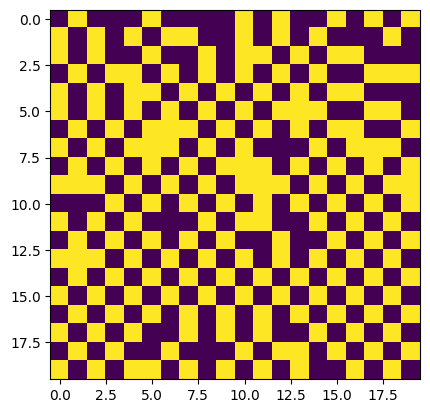

Evaluation 45 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.17it/s]


Completed. Saving
Time (s) to complete simulation 45: 23.429613828659058


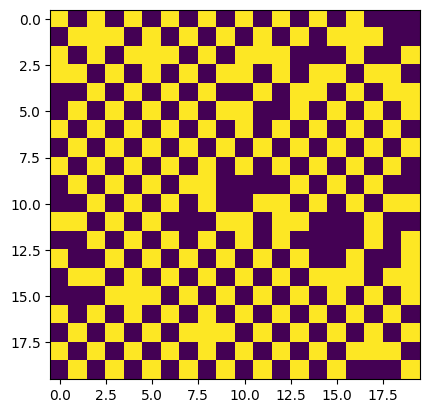

Evaluation 46 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.35it/s]


Completed. Saving
Time (s) to complete simulation 46: 23.424206972122192


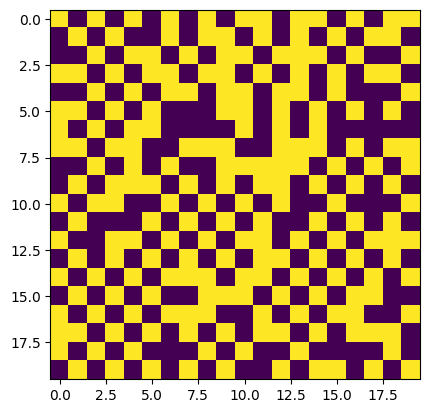

Evaluation 47 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.24it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.37it/s]


Completed. Saving
Time (s) to complete simulation 47: 23.959620714187622


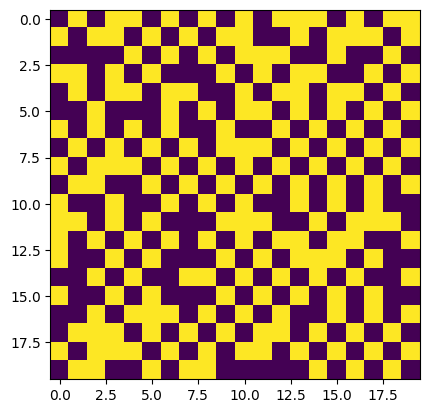

Evaluation 48 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.65it/s]


Completed. Saving
Time (s) to complete simulation 48: 23.695583820343018


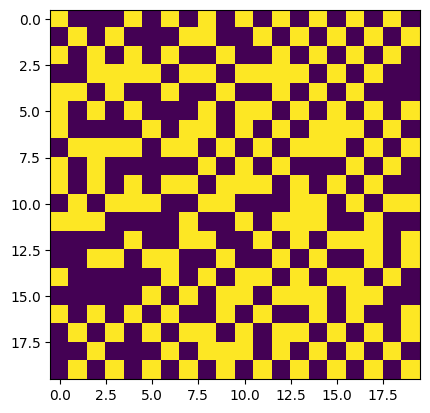

Evaluation 49 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.57it/s]


Completed. Saving
Time (s) to complete simulation 49: 23.745169162750244


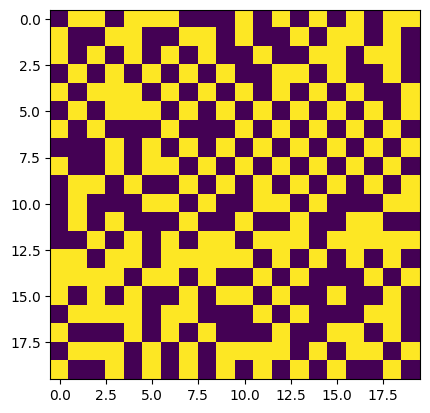

Evaluation 50 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.26it/s]


Completed. Saving
Time (s) to complete simulation 50: 24.041093111038208


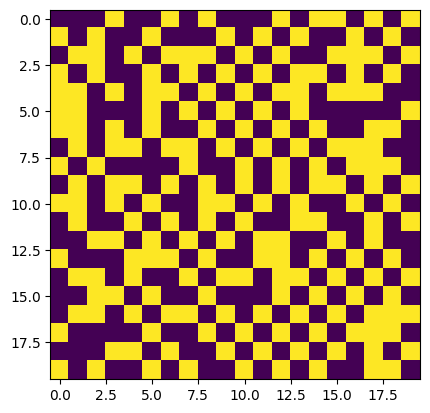

Evaluation 51 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.85it/s]


Completed. Saving
Time (s) to complete simulation 51: 23.755937576293945


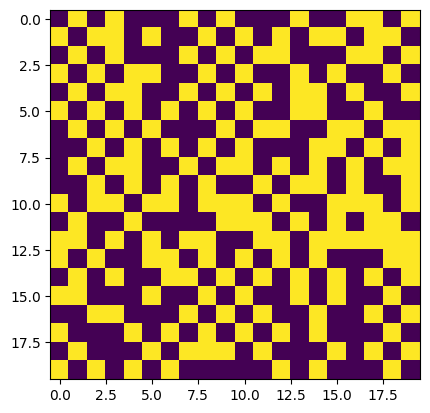

Evaluation 52 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.37it/s]


Completed. Saving
Time (s) to complete simulation 52: 23.970752716064453


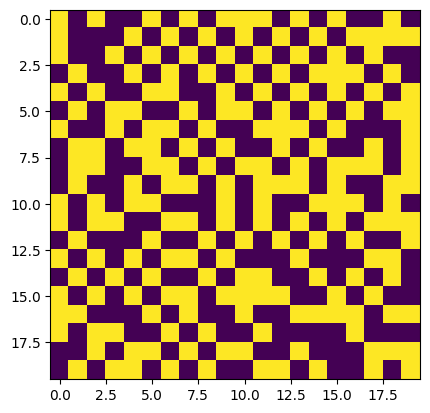

Evaluation 53 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 30.01it/s]


Completed. Saving
Time (s) to complete simulation 53: 23.536670684814453


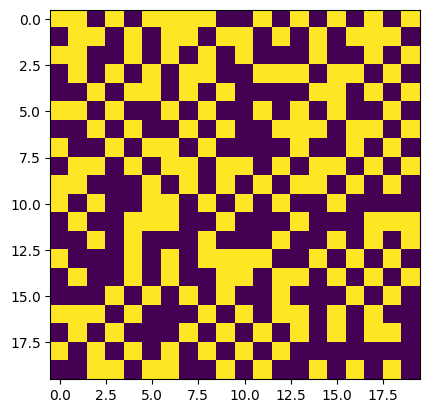

Evaluation 54 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.48it/s]


Completed. Saving
Time (s) to complete simulation 54: 23.901422023773193


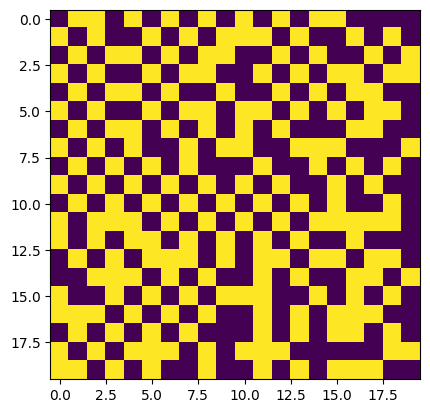

Evaluation 55 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.40it/s]


Completed. Saving
Time (s) to complete simulation 55: 23.876776218414307


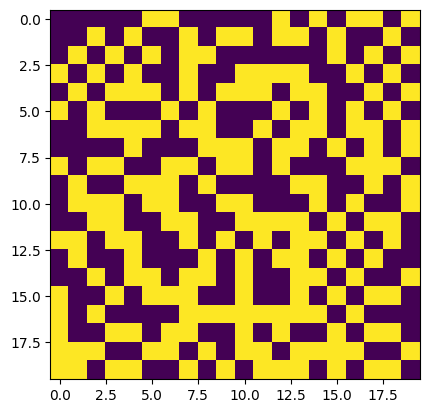

Evaluation 56 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.37it/s]


Completed. Saving
Time (s) to complete simulation 56: 24.053556442260742


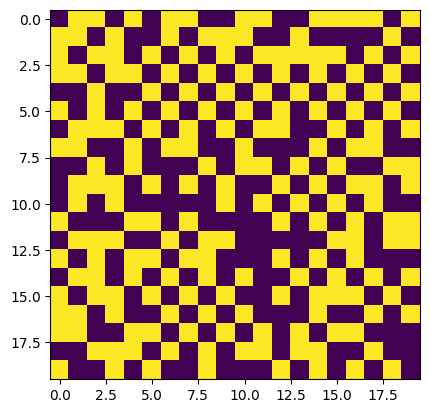

Evaluation 57 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.44it/s]


Completed. Saving
Time (s) to complete simulation 57: 24.010955572128296


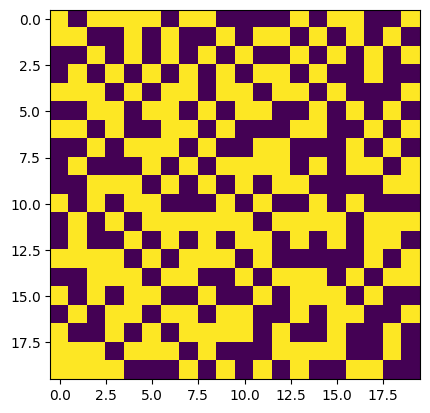

Evaluation 58 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.74it/s]


Completed. Saving
Time (s) to complete simulation 58: 23.785276174545288


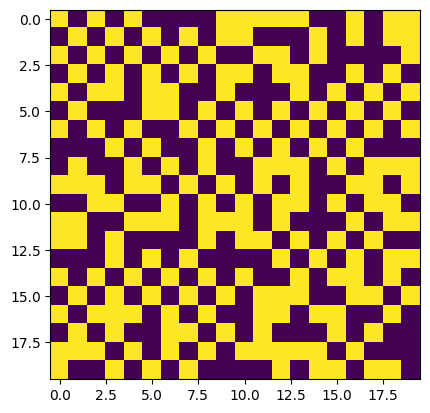

Evaluation 59 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.90it/s]


Completed. Saving
Time (s) to complete simulation 59: 23.788008451461792


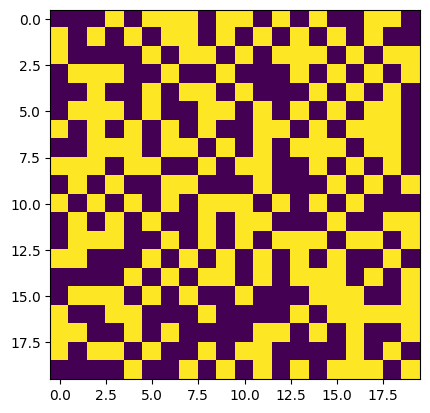

Evaluation 60 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.59it/s]


Completed. Saving
Time (s) to complete simulation 60: 23.83682346343994


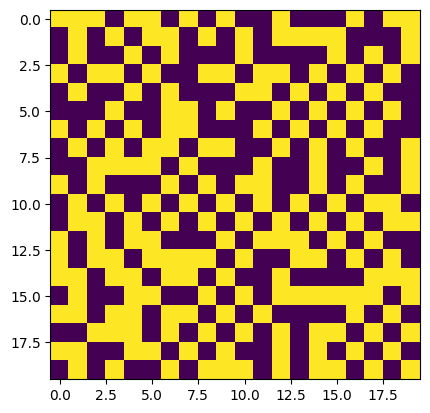

Evaluation 61 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.67it/s]


Completed. Saving
Time (s) to complete simulation 61: 24.457496881484985


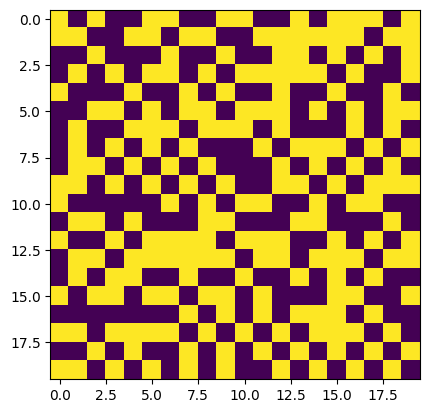

Evaluation 62 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.68it/s]


Completed. Saving
Time (s) to complete simulation 62: 23.686259984970093


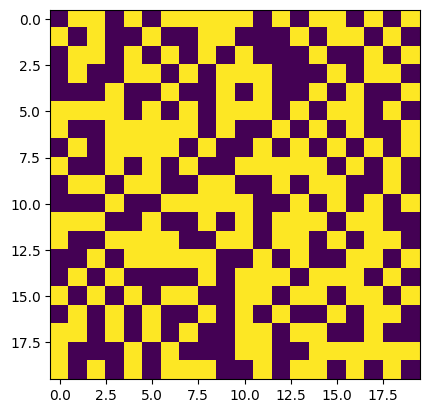

Evaluation 63 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.20it/s]


Completed. Saving
Time (s) to complete simulation 63: 24.127824306488037


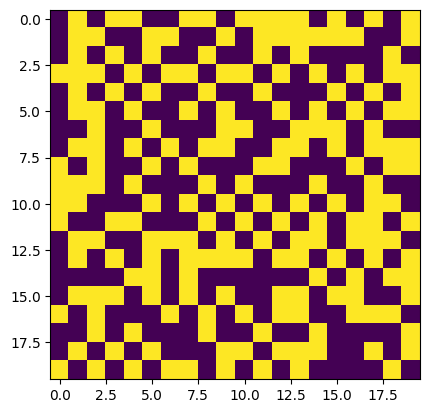

Evaluation 64 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.39it/s]


Completed. Saving
Time (s) to complete simulation 64: 24.280890226364136


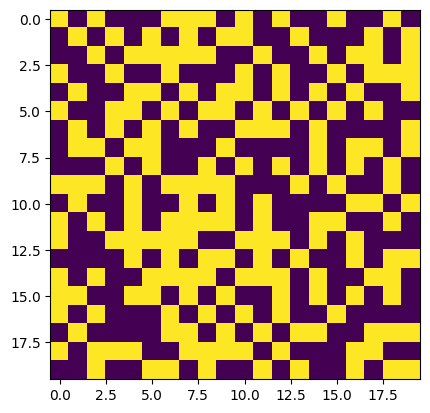

Evaluation 65 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.88it/s]


Completed. Saving
Time (s) to complete simulation 65: 24.339624166488647


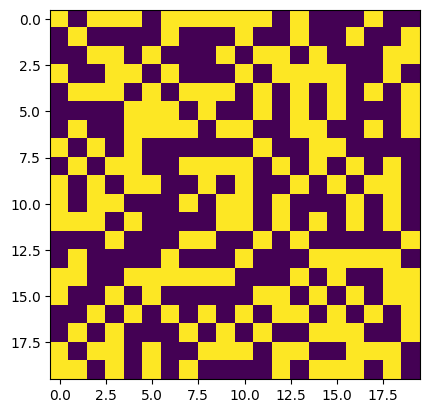

Evaluation 66 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.67it/s]


Completed. Saving
Time (s) to complete simulation 66: 24.406580209732056


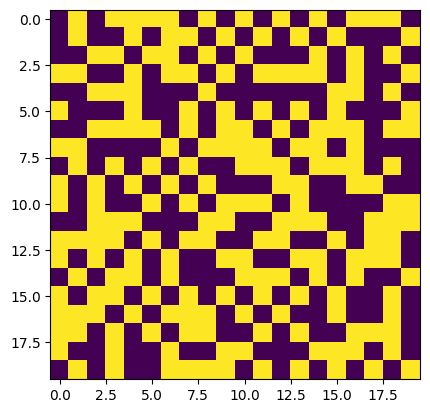

Evaluation 67 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.64it/s]


Completed. Saving
Time (s) to complete simulation 67: 25.043270349502563


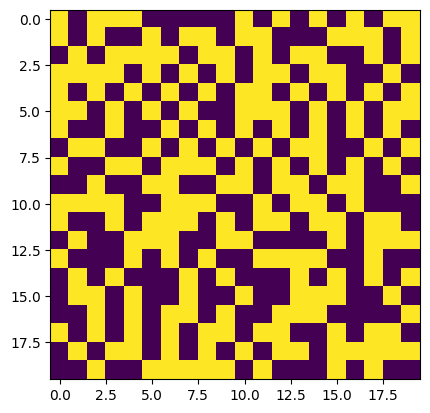

Evaluation 68 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.06it/s]


Completed. Saving
Time (s) to complete simulation 68: 24.274615049362183


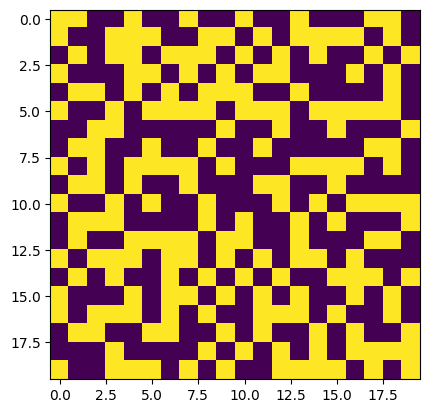

Evaluation 69 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.22it/s]


Completed. Saving
Time (s) to complete simulation 69: 24.078795433044434


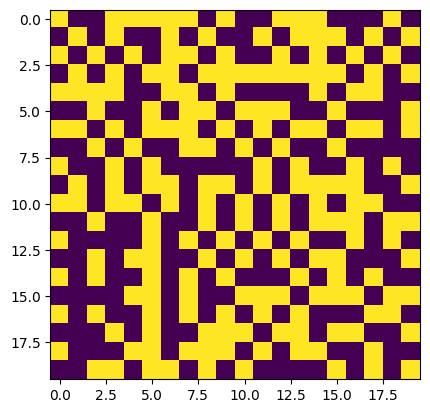

Evaluation 70 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.30it/s]


Completed. Saving
Time (s) to complete simulation 70: 24.273281574249268


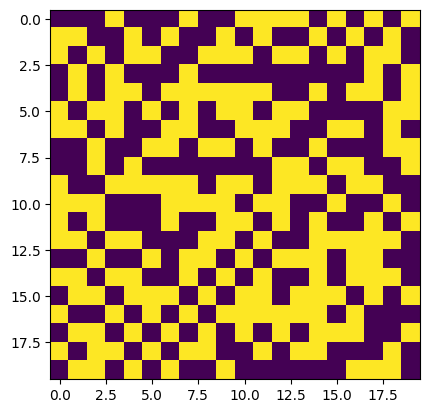

Evaluation 71 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.95it/s]


Completed. Saving
Time (s) to complete simulation 71: 24.29861354827881


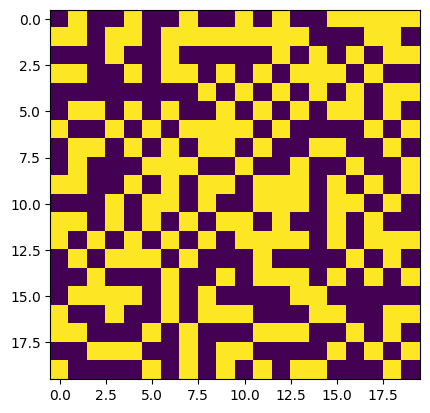

Evaluation 72 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.22it/s]


Completed. Saving
Time (s) to complete simulation 72: 23.983298778533936


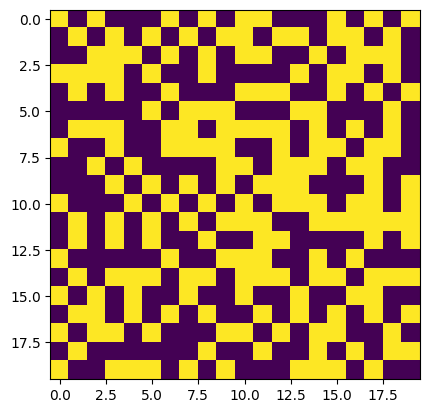

Evaluation 73 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.15it/s]


Completed. Saving
Time (s) to complete simulation 73: 24.243422746658325


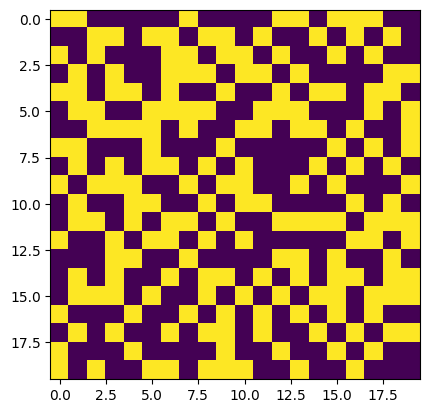

Evaluation 74 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.93it/s]


Completed. Saving
Time (s) to complete simulation 74: 24.594106674194336


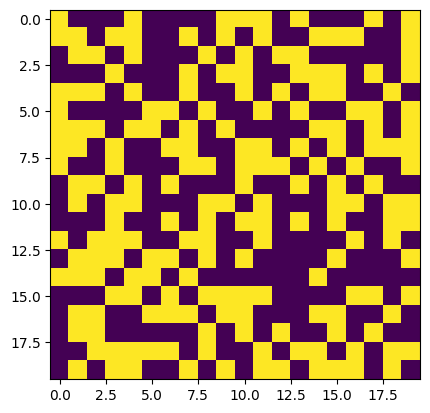

Evaluation 75 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.91it/s]


Completed. Saving
Time (s) to complete simulation 75: 24.566936492919922


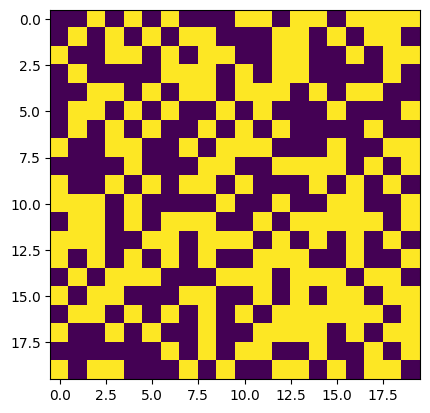

Evaluation 76 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.47it/s]


Completed. Saving
Time (s) to complete simulation 76: 24.457096338272095


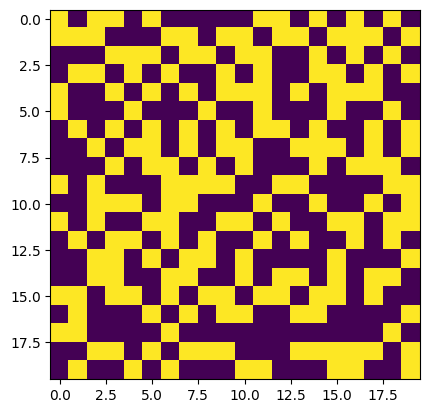

Evaluation 77 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.74it/s]


Completed. Saving
Time (s) to complete simulation 77: 24.523691654205322


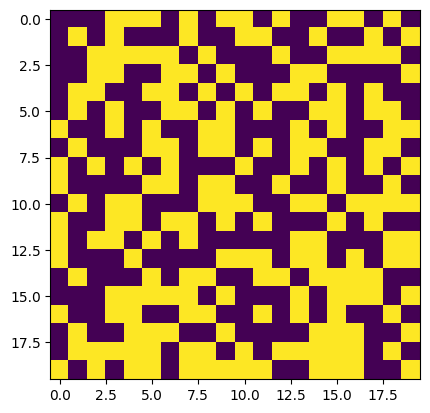

Evaluation 78 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.72it/s]


Completed. Saving
Time (s) to complete simulation 78: 24.553978443145752


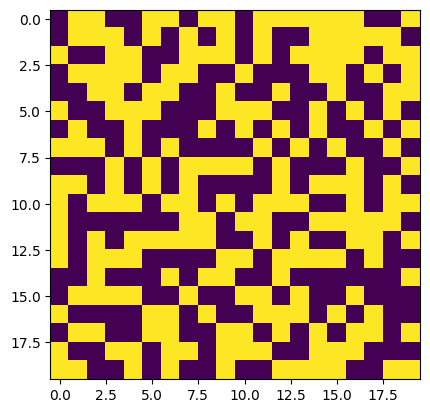

Evaluation 79 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.83it/s]


Completed. Saving
Time (s) to complete simulation 79: 23.952985048294067


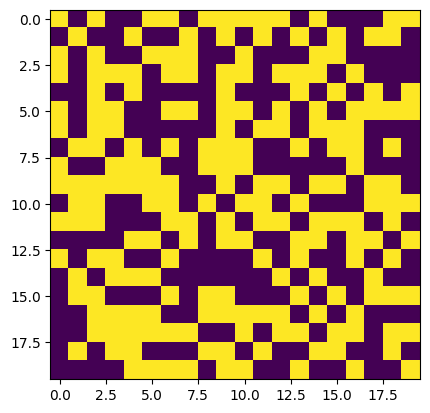

Evaluation 80 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 67.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.72it/s]


Completed. Saving
Time (s) to complete simulation 80: 24.794759511947632


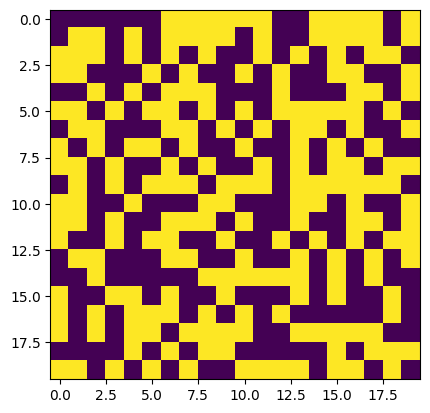

Evaluation 81 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.29it/s]


Completed. Saving
Time (s) to complete simulation 81: 24.038164854049683


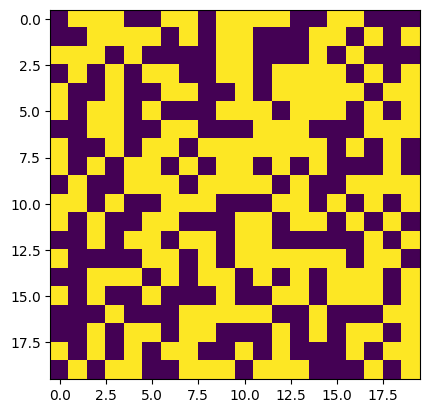

Evaluation 82 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.74it/s]


Completed. Saving
Time (s) to complete simulation 82: 24.529797315597534


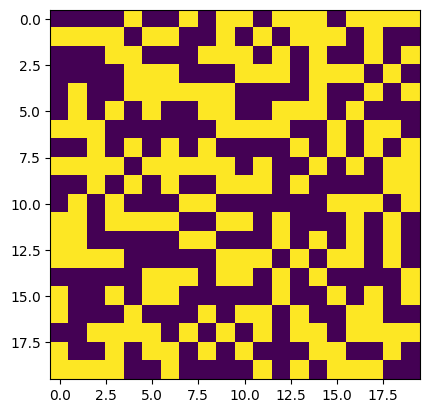

Evaluation 83 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.75it/s]


Completed. Saving
Time (s) to complete simulation 83: 24.526532411575317


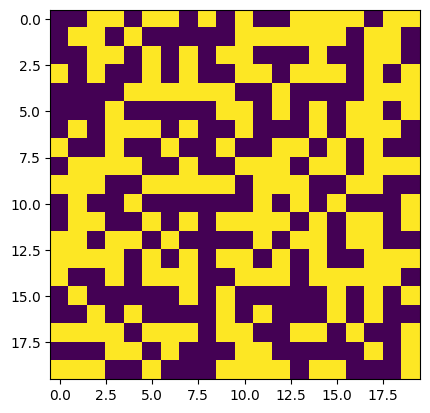

Evaluation 84 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.07it/s]


Completed. Saving
Time (s) to complete simulation 84: 24.500832080841064


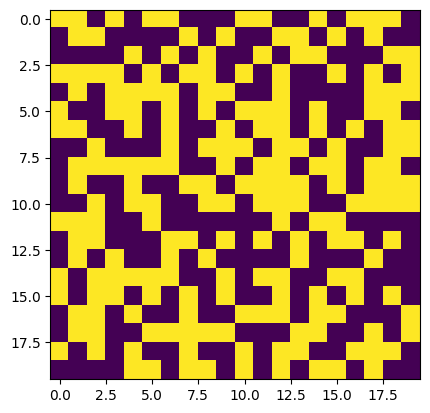

Evaluation 85 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.02it/s]


Completed. Saving
Time (s) to complete simulation 85: 24.517017364501953


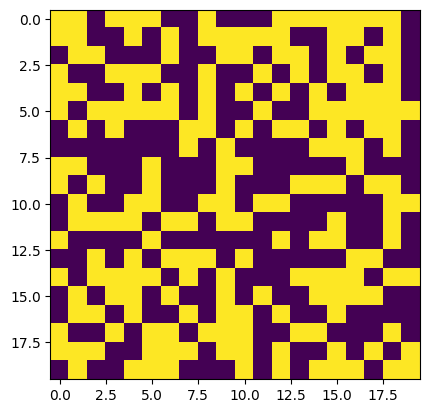

Evaluation 86 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.96it/s]


Completed. Saving
Time (s) to complete simulation 86: 24.295052766799927


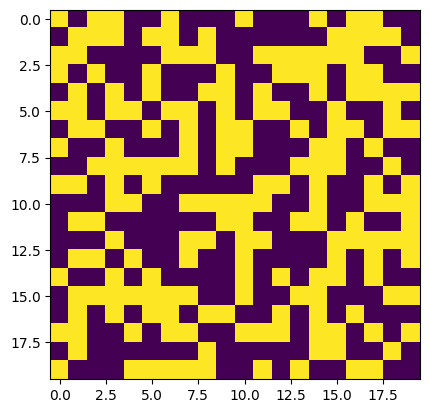

Evaluation 87 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.95it/s]


Completed. Saving
Time (s) to complete simulation 87: 24.46168279647827


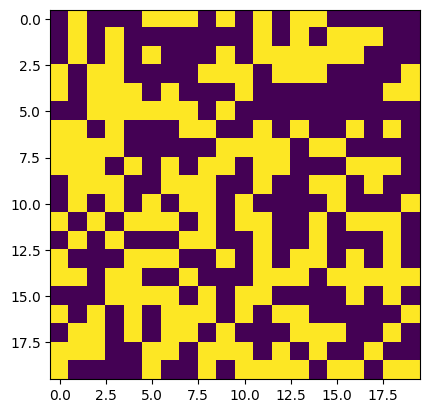

Evaluation 88 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.47it/s]


Completed. Saving
Time (s) to complete simulation 88: 24.06306290626526


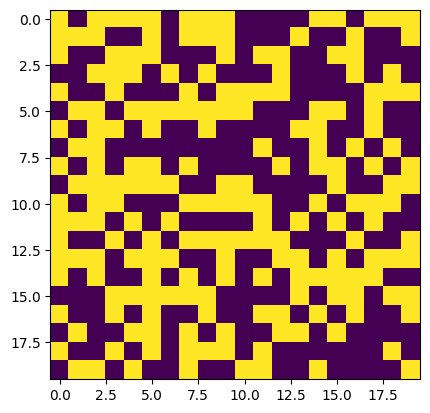

Evaluation 89 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.82it/s]


Completed. Saving
Time (s) to complete simulation 89: 24.47492504119873


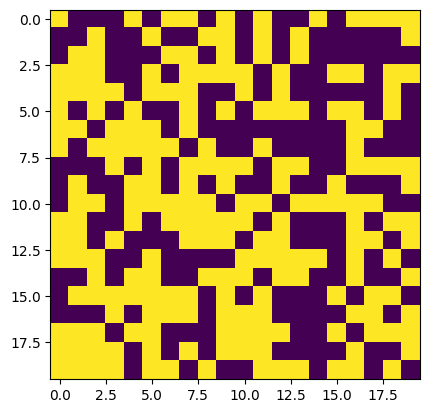

Evaluation 90 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.77it/s]


Completed. Saving
Time (s) to complete simulation 90: 24.600565433502197


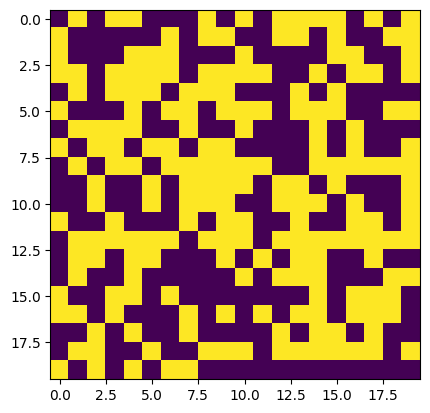

Evaluation 91 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.13it/s]


Completed. Saving
Time (s) to complete simulation 91: 24.322795629501343


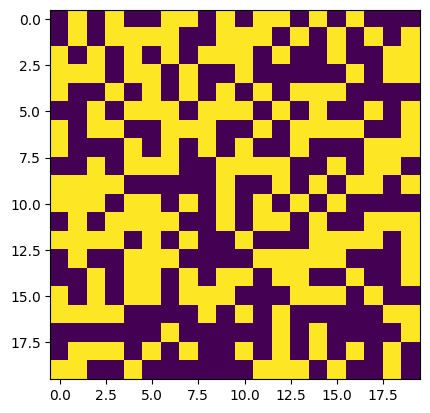

Evaluation 92 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 27.62it/s]


Completed. Saving
Time (s) to complete simulation 92: 25.287486791610718


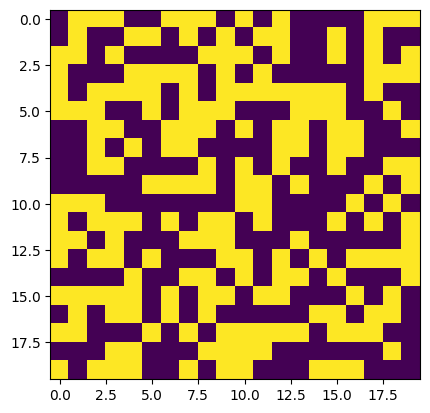

Evaluation 93 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.32it/s]


Completed. Saving
Time (s) to complete simulation 93: 24.85847306251526


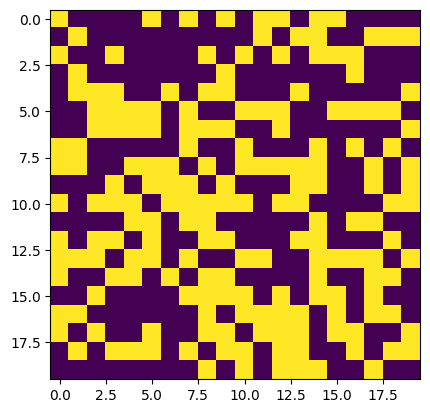

Evaluation 94 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.56it/s]


Completed. Saving
Time (s) to complete simulation 94: 24.678428649902344


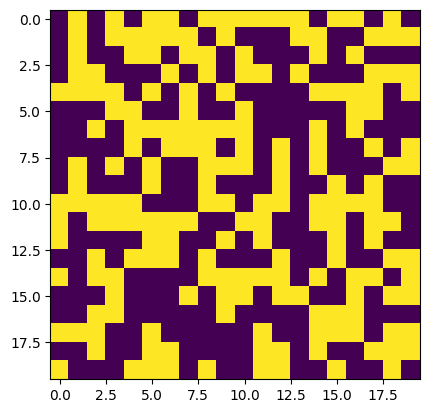

Evaluation 95 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.76it/s]


Completed. Saving
Time (s) to complete simulation 95: 24.629276752471924


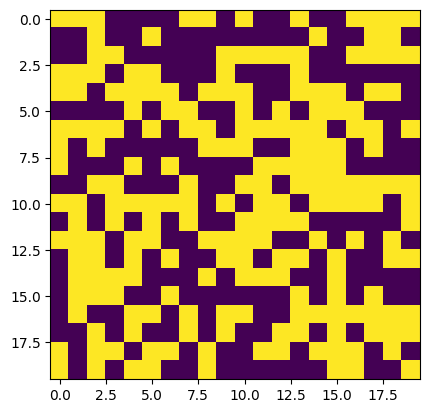

Evaluation 96 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 67.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.36it/s]


Completed. Saving
Time (s) to complete simulation 96: 24.426924228668213


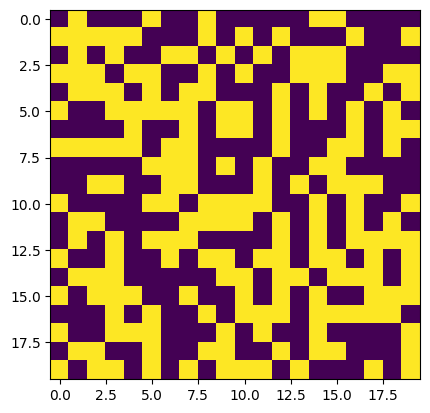

Evaluation 97 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.94it/s]


Completed. Saving
Time (s) to complete simulation 97: 24.62559223175049


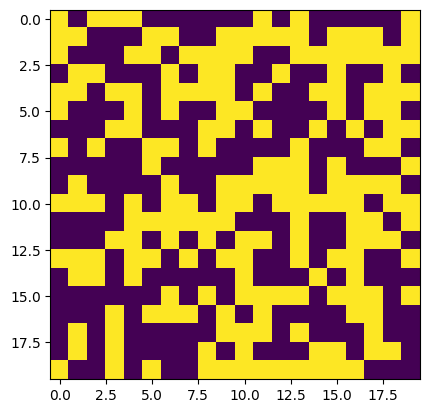

Evaluation 98 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.72it/s]


Completed. Saving
Time (s) to complete simulation 98: 24.41501522064209


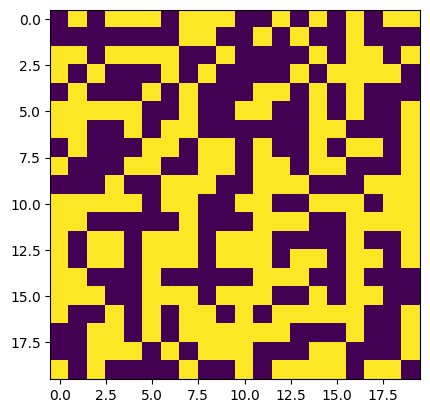

Evaluation 99 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.65it/s]


Completed. Saving
Time (s) to complete simulation 99: 24.561633110046387


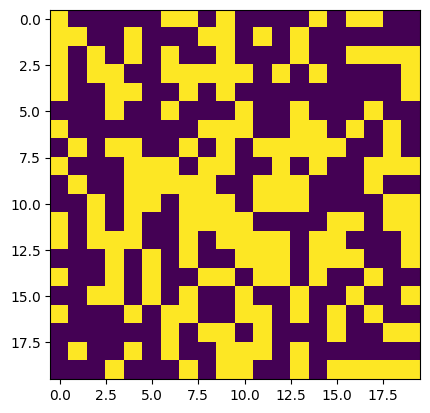

Evaluation 100 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.85it/s]


Completed. Saving
Time (s) to complete simulation 100: 24.487030744552612


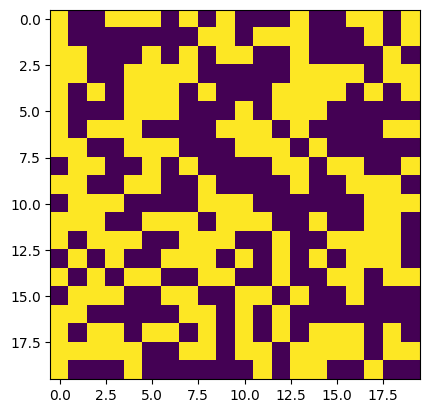

Evaluation 101 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 65.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.75it/s]


Completed. Saving
Time (s) to complete simulation 101: 25.076492071151733


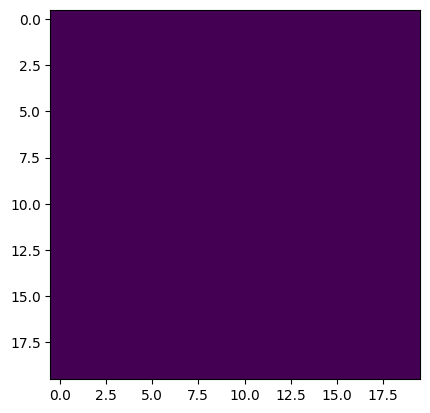

Evaluation 102 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.30it/s]


Completed. Saving
Time (s) to complete simulation 102: 24.969284296035767


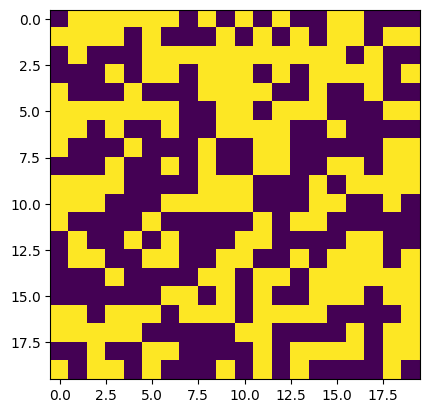

Evaluation 103 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.93it/s]


Completed. Saving
Time (s) to complete simulation 103: 24.468410968780518


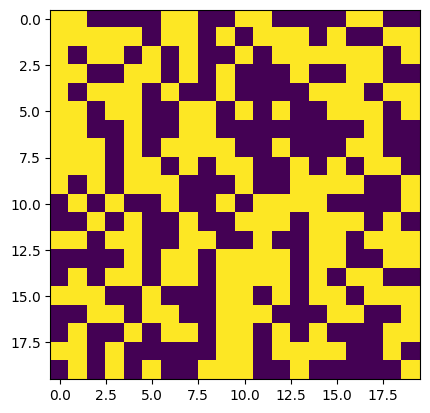

Evaluation 104 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.20it/s]


Completed. Saving
Time (s) to complete simulation 104: 24.942341327667236


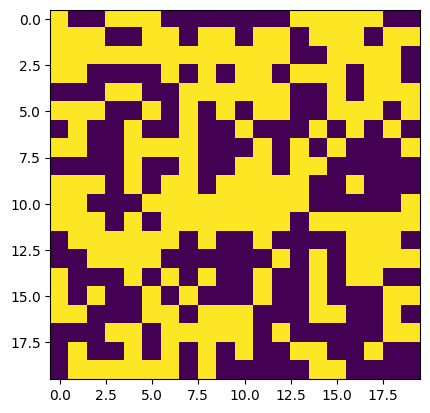

Evaluation 105 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.81it/s]


Completed. Saving
Time (s) to complete simulation 105: 24.605397939682007


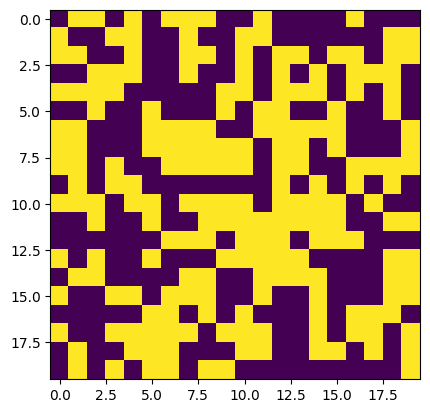

Evaluation 106 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 67.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.88it/s]


Completed. Saving
Time (s) to complete simulation 106: 24.77175259590149


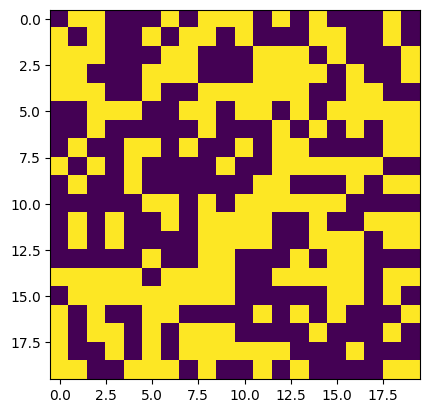

Evaluation 107 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.52it/s]


Completed. Saving
Time (s) to complete simulation 107: 24.63343906402588


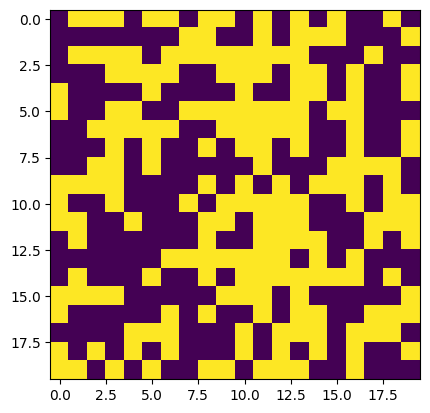

Evaluation 108 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.97it/s]


Completed. Saving
Time (s) to complete simulation 108: 24.439882516860962


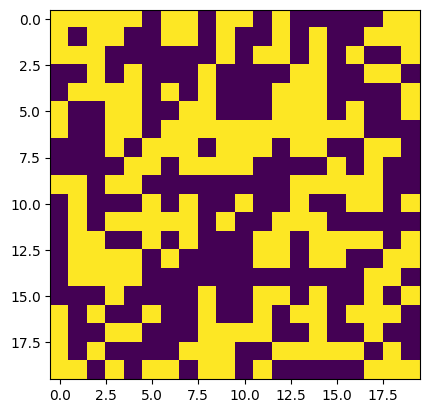

Evaluation 109 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.52it/s]


Completed. Saving
Time (s) to complete simulation 109: 24.797181129455566


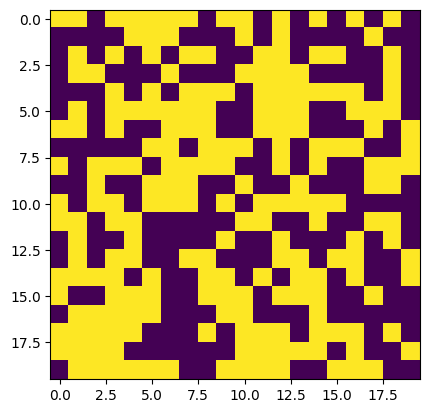

Evaluation 110 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.14it/s]


Completed. Saving
Time (s) to complete simulation 110: 24.938284158706665


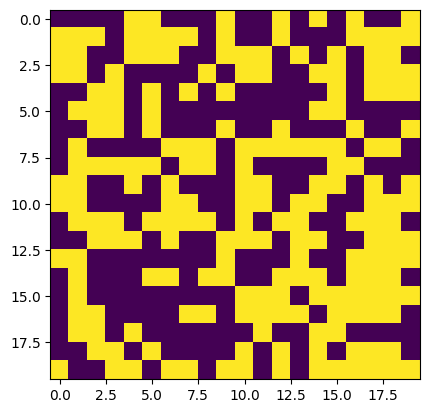

Evaluation 111 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.62it/s]


Completed. Saving
Time (s) to complete simulation 111: 24.58179473876953


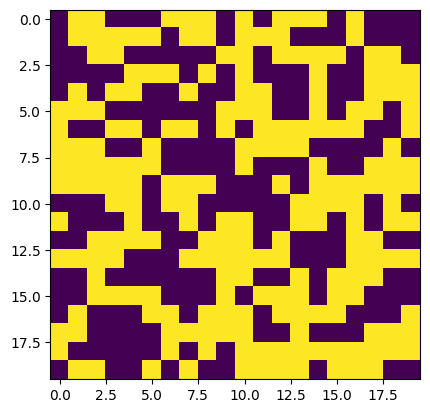

Evaluation 112 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.36it/s]


Completed. Saving
Time (s) to complete simulation 112: 24.14007878303528


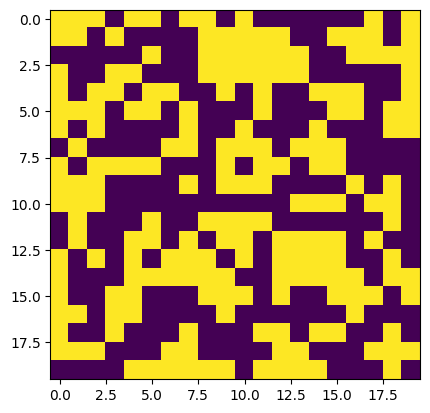

Evaluation 113 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.90it/s]


Completed. Saving
Time (s) to complete simulation 113: 24.567880630493164


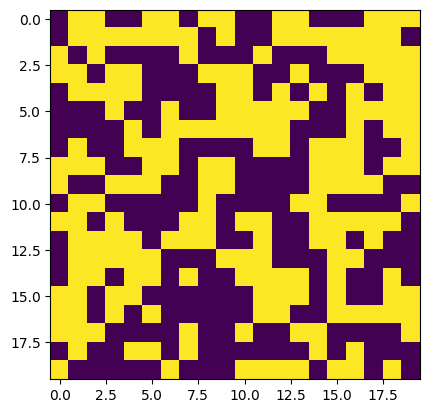

Evaluation 114 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.41it/s]


Completed. Saving
Time (s) to complete simulation 114: 24.185638666152954


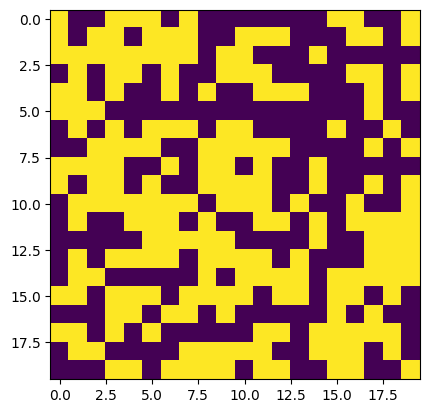

Evaluation 115 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.31it/s]


Completed. Saving
Time (s) to complete simulation 115: 24.804369688034058


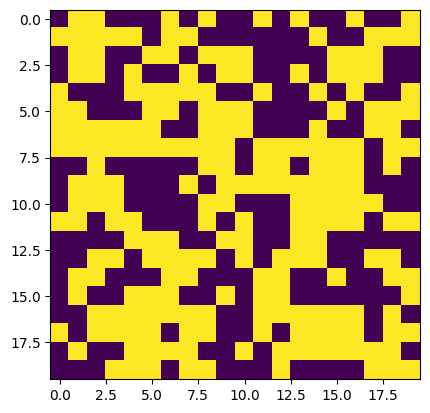

Evaluation 116 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.30it/s]


Completed. Saving
Time (s) to complete simulation 116: 24.75955033302307


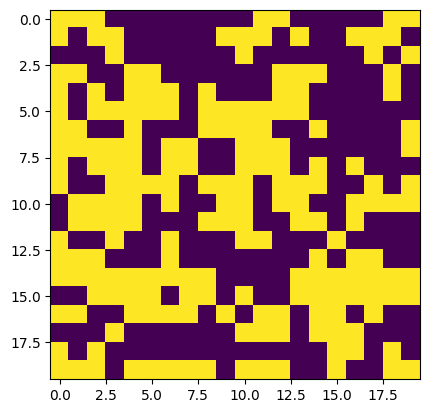

Evaluation 117 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 65.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.15it/s]


Completed. Saving
Time (s) to complete simulation 117: 24.795475959777832


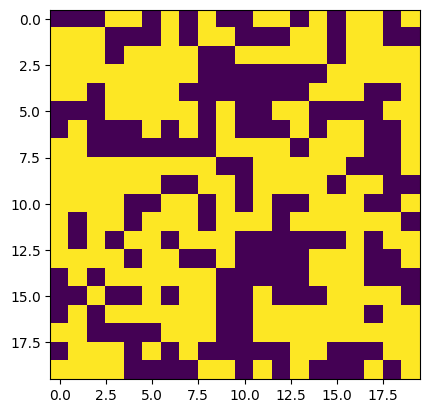

Evaluation 118 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.52it/s]


Completed. Saving
Time (s) to complete simulation 118: 24.81450366973877


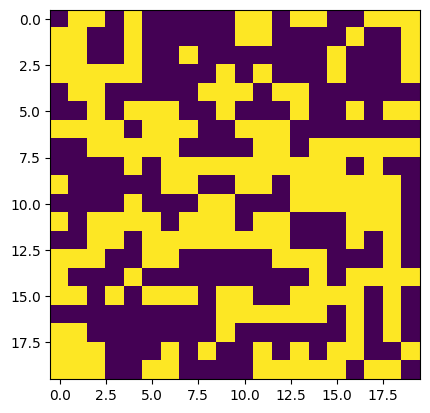

Evaluation 119 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.49it/s]


Completed. Saving
Time (s) to complete simulation 119: 24.694087743759155


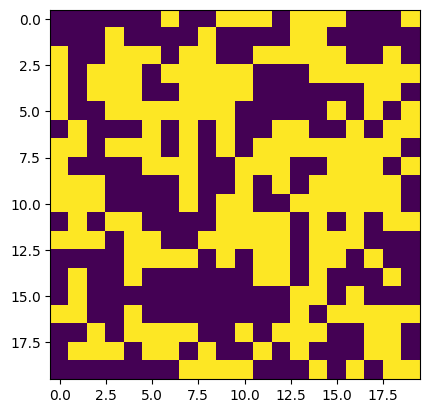

Evaluation 120 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.51it/s]


Completed. Saving
Time (s) to complete simulation 120: 24.67631959915161


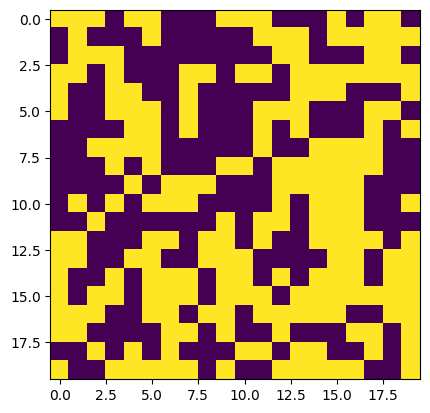

Evaluation 121 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.89it/s]


Completed. Saving
Time (s) to complete simulation 121: 24.502673864364624


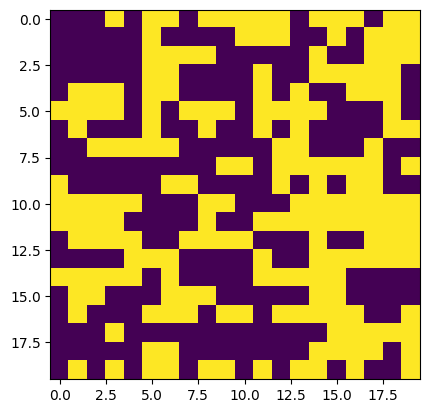

Evaluation 122 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.34it/s]


Completed. Saving
Time (s) to complete simulation 122: 24.251543521881104


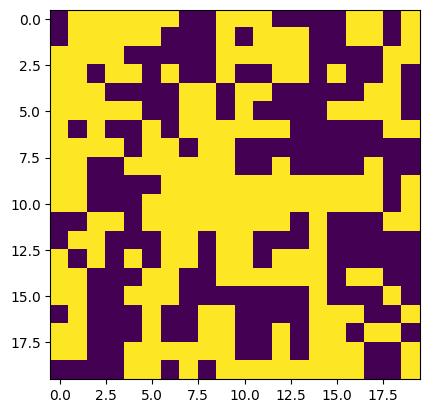

Evaluation 123 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.66it/s]


Completed. Saving
Time (s) to complete simulation 123: 24.6517014503479


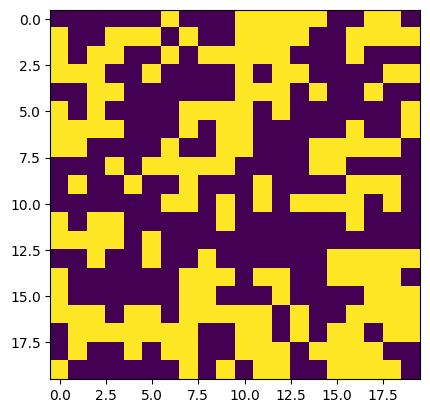

Evaluation 124 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.97it/s]


Completed. Saving
Time (s) to complete simulation 124: 24.418108463287354


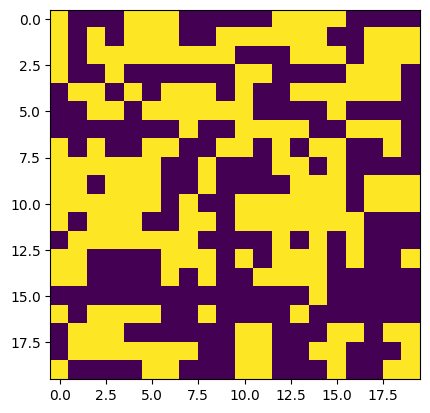

Evaluation 125 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:18<00:00, 26.71it/s]


Completed. Saving
Time (s) to complete simulation 125: 25.792325735092163


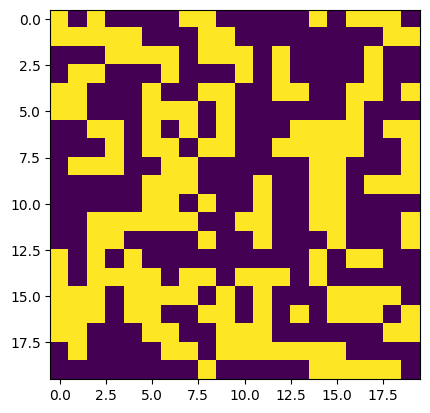

Evaluation 126 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.11it/s]


Completed. Saving
Time (s) to complete simulation 126: 24.29927086830139


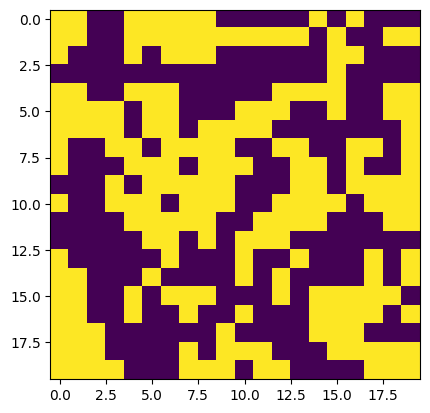

Evaluation 127 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 68.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.13it/s]


Completed. Saving
Time (s) to complete simulation 127: 24.446380138397217


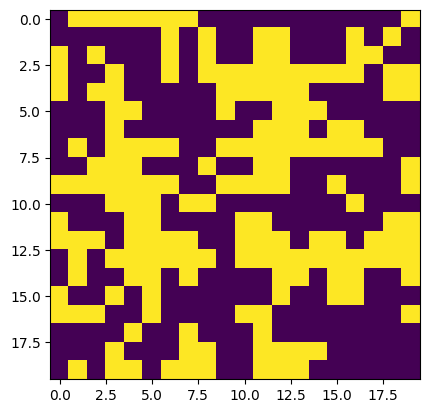

Evaluation 128 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.47it/s]


Completed. Saving
Time (s) to complete simulation 128: 24.723363637924194


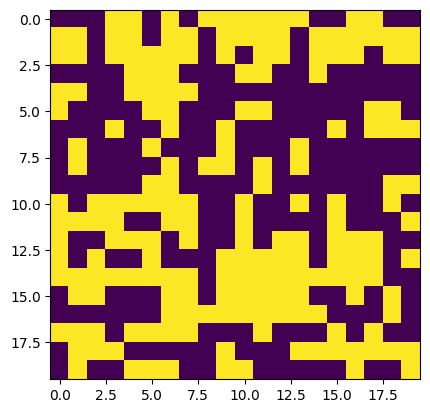

Evaluation 129 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.86it/s]


Completed. Saving
Time (s) to complete simulation 129: 24.484740018844604


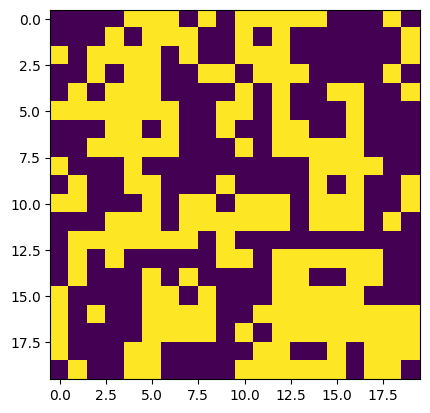

Evaluation 130 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.49it/s]


Completed. Saving
Time (s) to complete simulation 130: 24.74391794204712


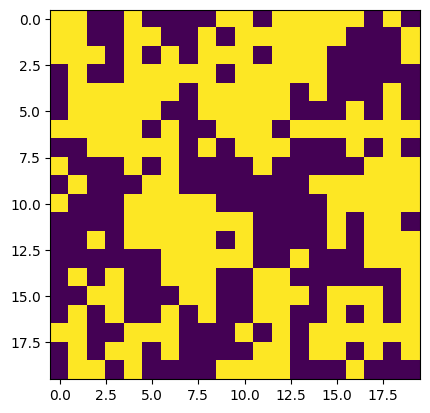

Evaluation 131 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.24it/s]


Completed. Saving
Time (s) to complete simulation 131: 24.238516092300415


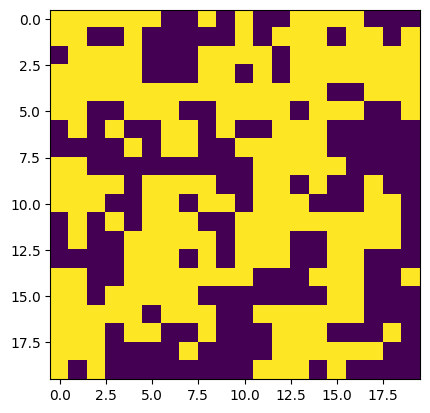

Evaluation 132 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.88it/s]


Completed. Saving
Time (s) to complete simulation 132: 24.477001667022705


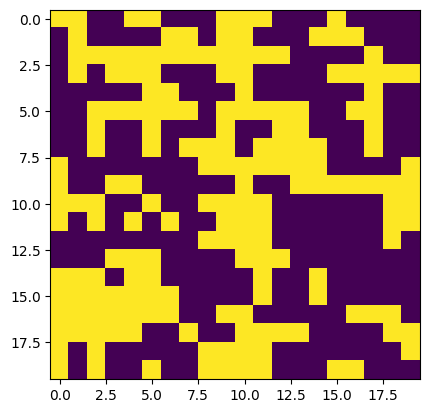

Evaluation 133 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.38it/s]


Completed. Saving
Time (s) to complete simulation 133: 24.170109272003174


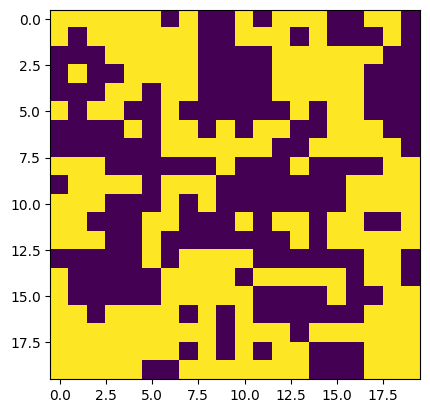

Evaluation 134 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.09it/s]


Completed. Saving
Time (s) to complete simulation 134: 24.750986576080322


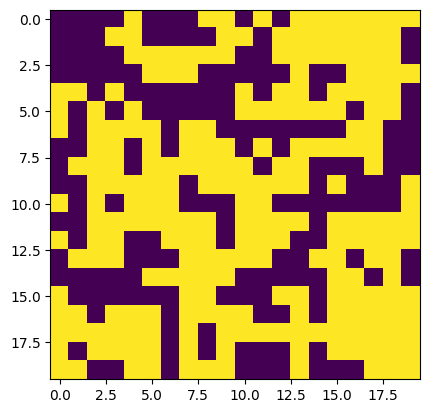

Evaluation 135 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.91it/s]


Completed. Saving
Time (s) to complete simulation 135: 24.431535482406616


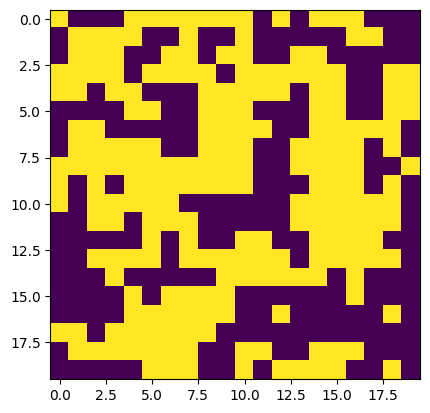

Evaluation 136 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.62it/s]


Completed. Saving
Time (s) to complete simulation 136: 23.93614149093628


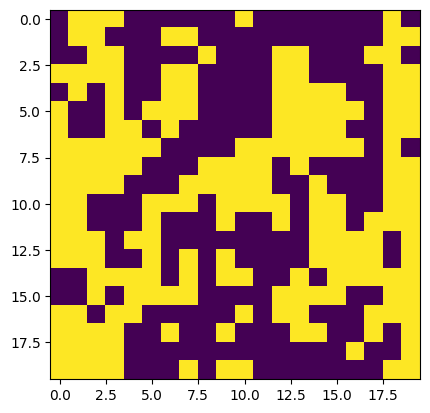

Evaluation 137 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.67it/s]


Completed. Saving
Time (s) to complete simulation 137: 23.917986631393433


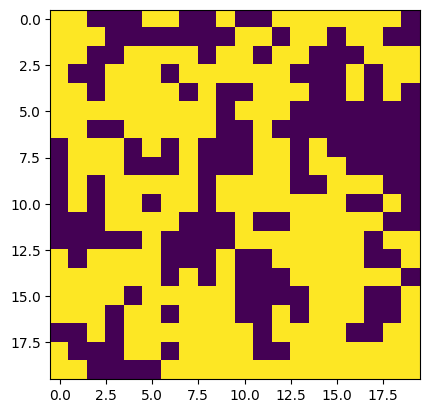

Evaluation 138 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.33it/s]


Completed. Saving
Time (s) to complete simulation 138: 24.157204627990723


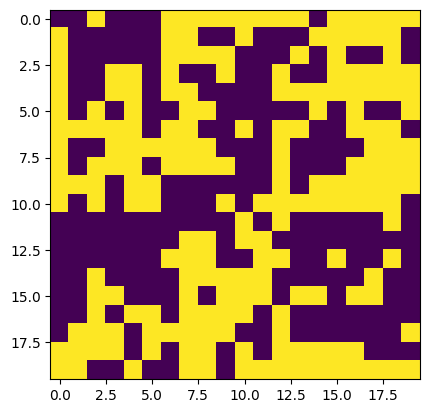

Evaluation 139 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.64it/s]


Completed. Saving
Time (s) to complete simulation 139: 24.37013840675354


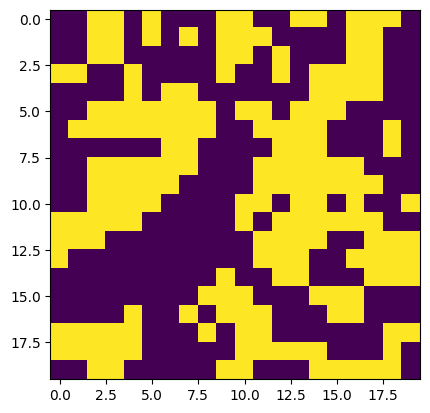

Evaluation 140 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.51it/s]


Completed. Saving
Time (s) to complete simulation 140: 24.535571813583374


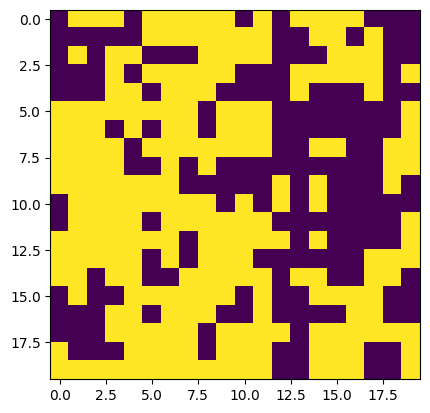

Evaluation 141 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.70it/s]


Completed. Saving
Time (s) to complete simulation 141: 24.539525032043457


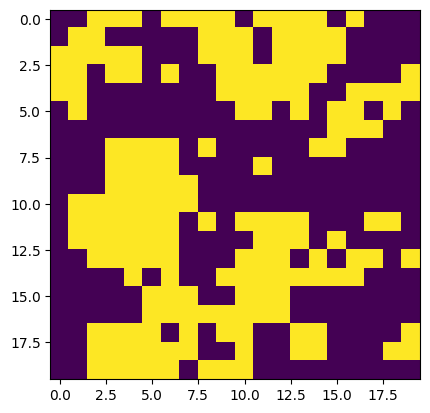

Evaluation 142 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.65it/s]


Completed. Saving
Time (s) to complete simulation 142: 24.61844754219055


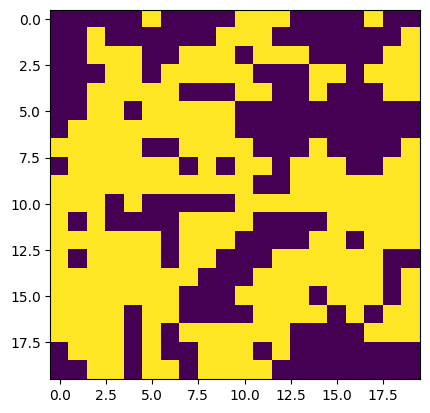

Evaluation 143 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.81it/s]


Completed. Saving
Time (s) to complete simulation 143: 24.38299870491028


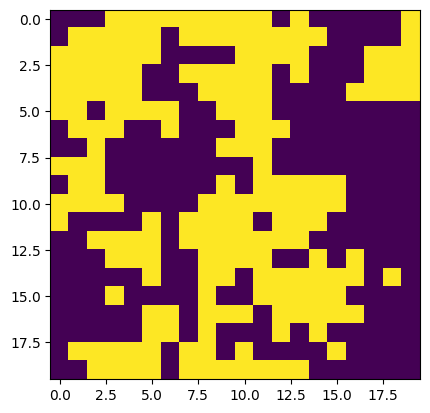

Evaluation 144 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.64it/s]


Completed. Saving
Time (s) to complete simulation 144: 24.335465908050537


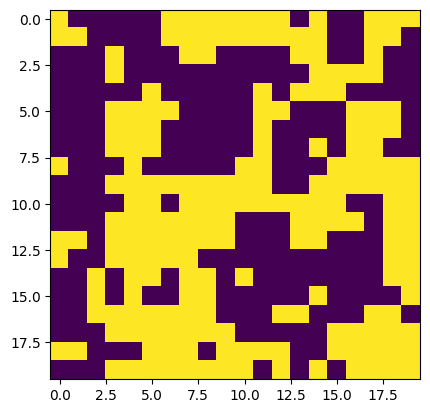

Evaluation 145 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.08it/s]


Completed. Saving
Time (s) to complete simulation 145: 24.24538016319275


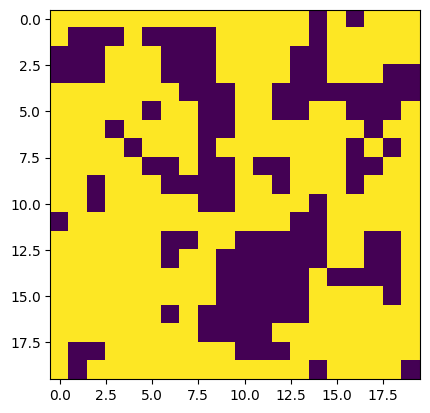

Evaluation 146 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.74it/s]


Completed. Saving
Time (s) to complete simulation 146: 24.542474269866943


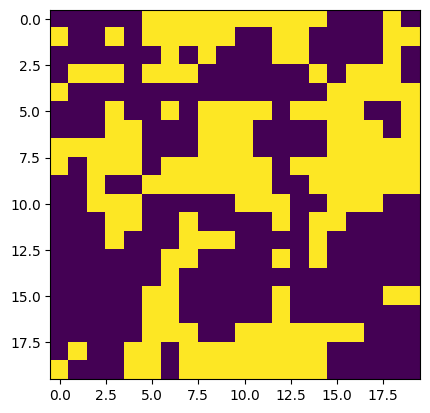

Evaluation 147 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.18it/s]


Completed. Saving
Time (s) to complete simulation 147: 24.20781183242798


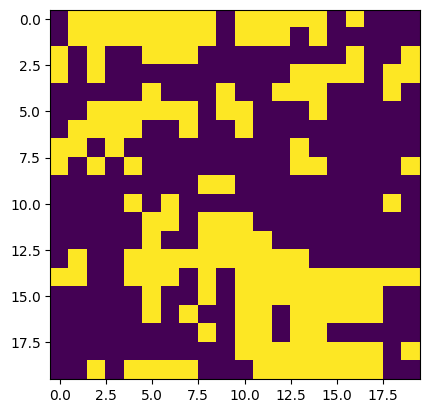

Evaluation 148 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.96it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.14it/s]


Completed. Saving
Time (s) to complete simulation 148: 24.212791919708252


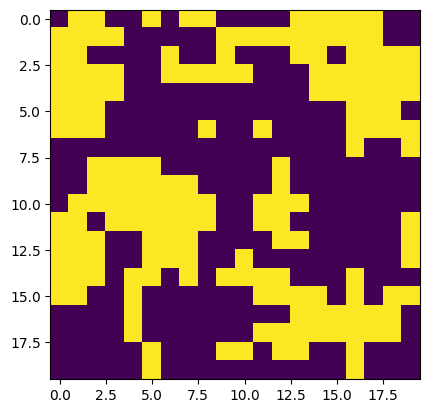

Evaluation 149 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.56it/s]


Completed. Saving
Time (s) to complete simulation 149: 24.639026641845703


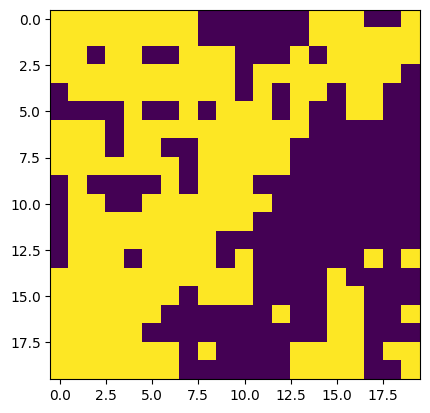

Evaluation 150 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.94it/s]


Completed. Saving
Time (s) to complete simulation 150: 24.24907898902893


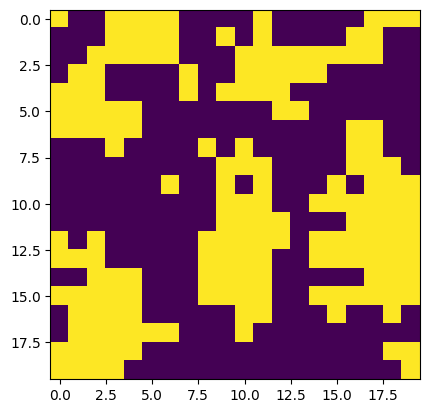

Evaluation 151 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.83it/s]


Completed. Saving
Time (s) to complete simulation 151: 24.425041675567627


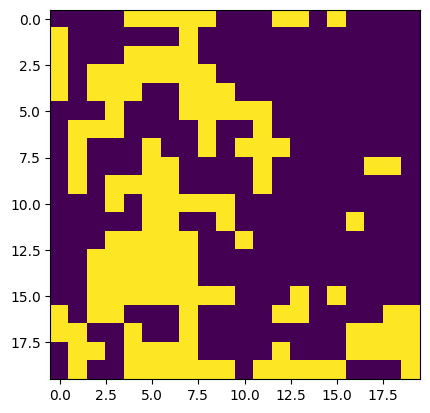

Evaluation 152 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.19it/s]


Completed. Saving
Time (s) to complete simulation 152: 24.261091470718384


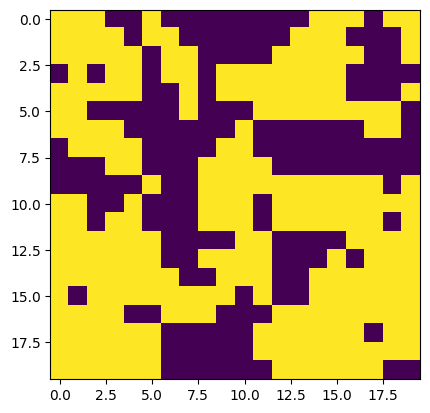

Evaluation 153 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.88it/s]


Completed. Saving
Time (s) to complete simulation 153: 24.479427099227905


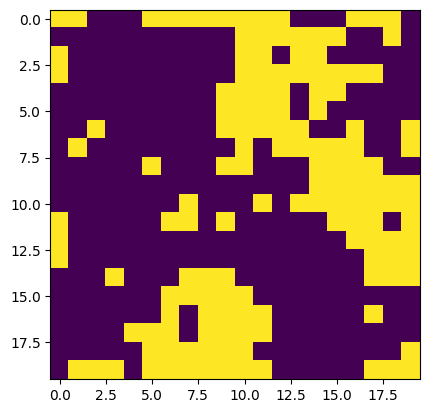

Evaluation 154 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.04it/s]


Completed. Saving
Time (s) to complete simulation 154: 24.15887451171875


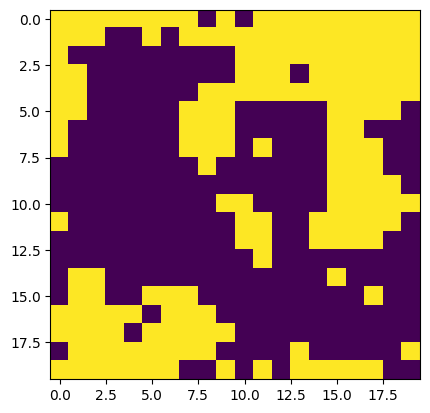

Evaluation 155 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.50it/s]


Completed. Saving
Time (s) to complete simulation 155: 23.84098982810974


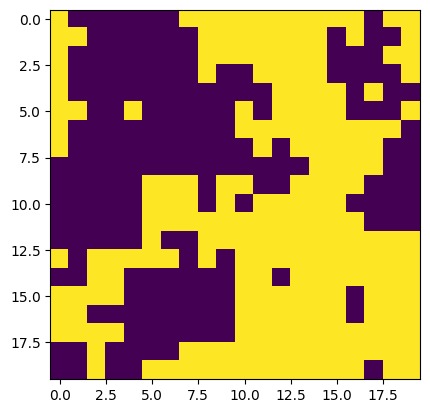

Evaluation 156 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.69it/s]


Completed. Saving
Time (s) to complete simulation 156: 24.575258016586304


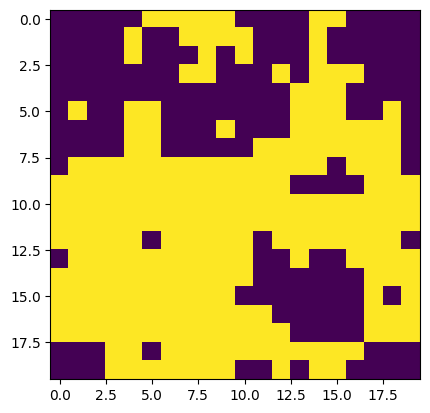

Evaluation 157 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.97it/s]


Completed. Saving
Time (s) to complete simulation 157: 23.523541927337646


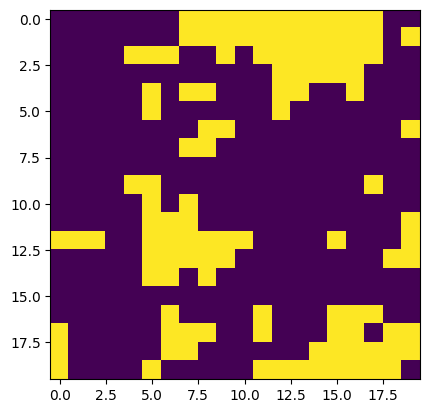

Evaluation 158 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.50it/s]


Completed. Saving
Time (s) to complete simulation 158: 24.06935143470764


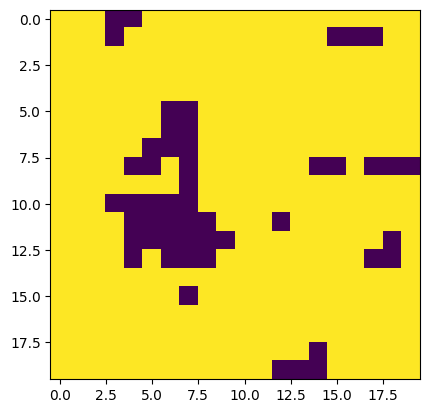

Evaluation 159 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.43it/s]


Completed. Saving
Time (s) to complete simulation 159: 23.80914831161499


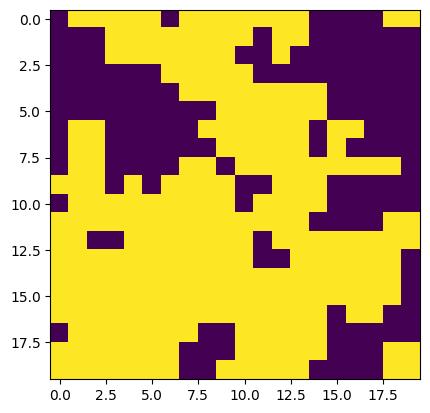

Evaluation 160 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.98it/s]


Completed. Saving
Time (s) to complete simulation 160: 24.12614417076111


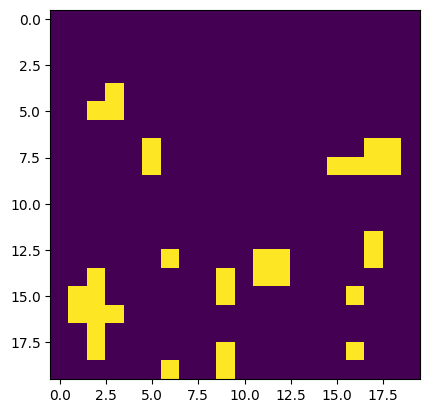

Evaluation 161 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.21it/s]


Completed. Saving
Time (s) to complete simulation 161: 24.034714698791504


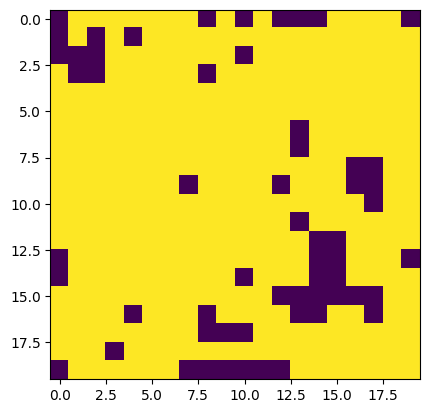

Evaluation 162 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.71it/s]


Completed. Saving
Time (s) to complete simulation 162: 23.914150953292847


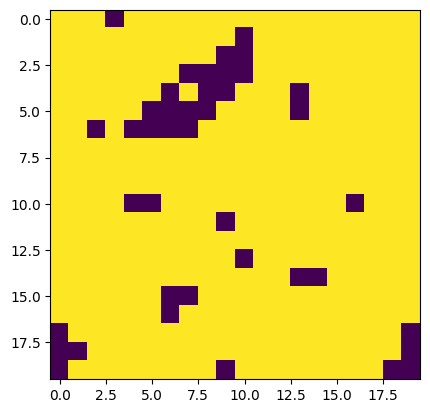

Evaluation 163 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.68it/s]


Completed. Saving
Time (s) to complete simulation 163: 23.777464866638184


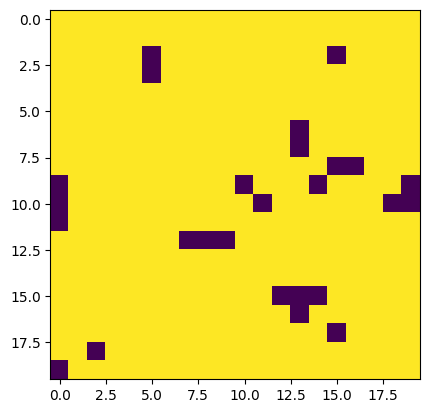

Evaluation 164 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.18it/s]


Completed. Saving
Time (s) to complete simulation 164: 23.970077991485596


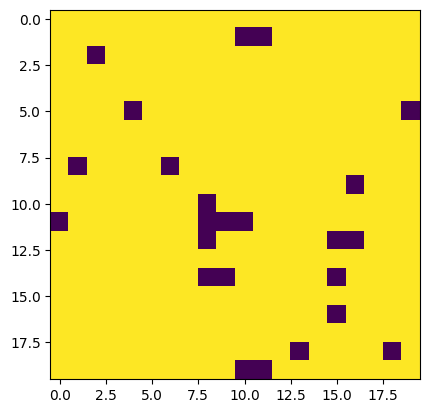

Evaluation 165 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.46it/s]


Completed. Saving
Time (s) to complete simulation 165: 24.321740865707397


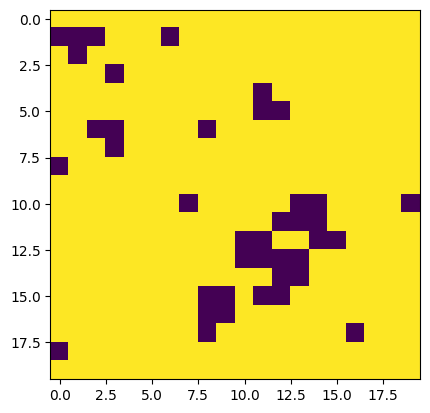

Evaluation 166 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.02it/s]


Completed. Saving
Time (s) to complete simulation 166: 24.041688203811646


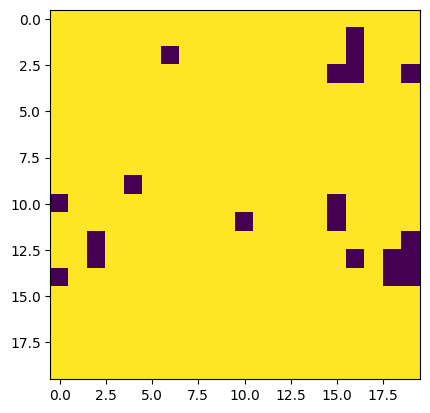

Evaluation 167 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.61it/s]


Completed. Saving
Time (s) to complete simulation 167: 23.818780183792114


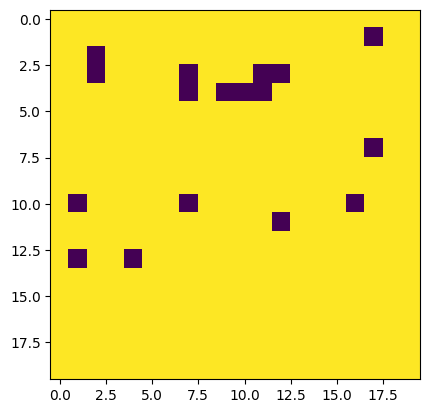

Evaluation 168 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.63it/s]


Completed. Saving
Time (s) to complete simulation 168: 24.02555537223816


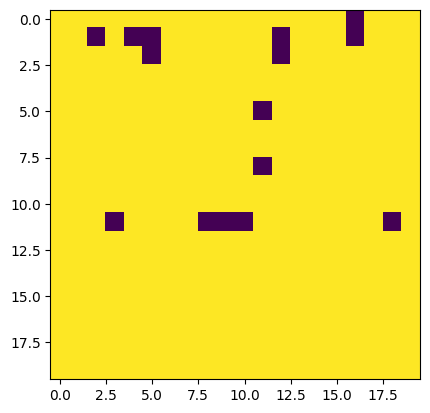

Evaluation 169 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.38it/s]


Completed. Saving
Time (s) to complete simulation 169: 23.90121293067932


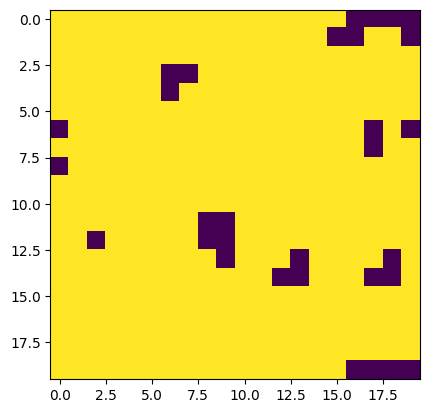

Evaluation 170 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.25it/s]


Completed. Saving
Time (s) to complete simulation 170: 24.064050436019897


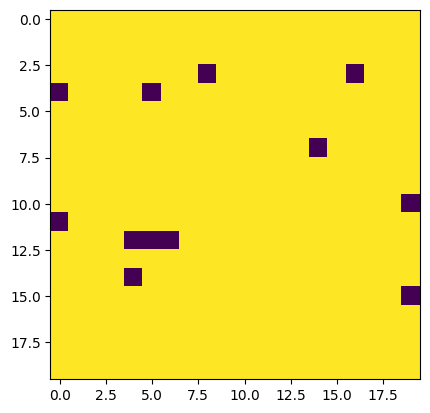

Evaluation 171 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 75.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.08it/s]


Completed. Saving
Time (s) to complete simulation 171: 23.83533477783203


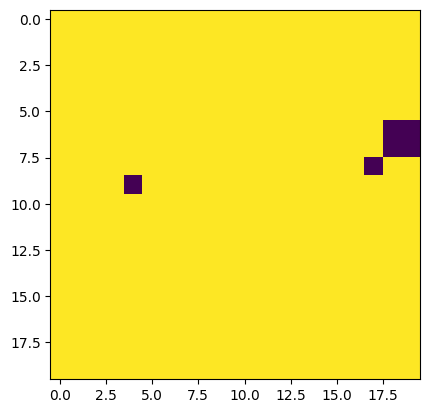

Evaluation 172 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.57it/s]


Completed. Saving
Time (s) to complete simulation 172: 23.76514220237732


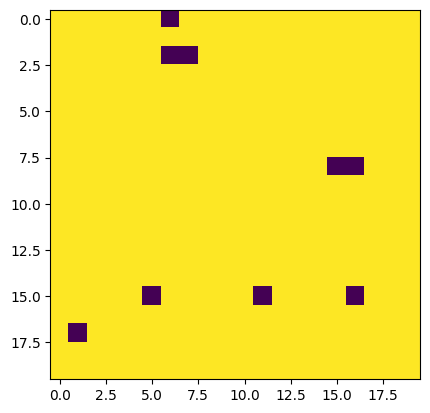

Evaluation 173 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 69.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.37it/s]


Completed. Saving
Time (s) to complete simulation 173: 24.223519563674927


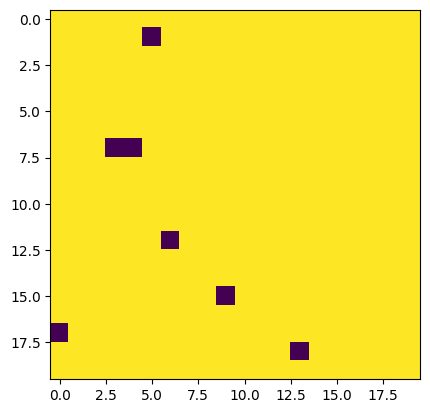

Evaluation 174 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.25it/s]


Completed. Saving
Time (s) to complete simulation 174: 23.939200401306152


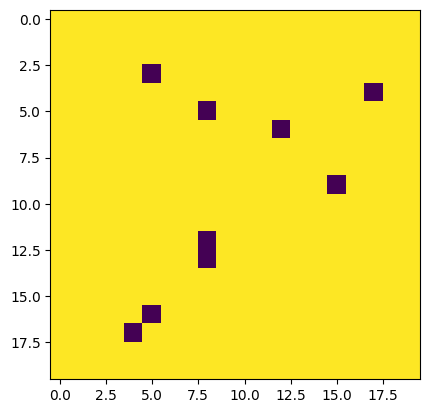

Evaluation 175 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.31it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.25it/s]


Completed. Saving
Time (s) to complete simulation 175: 23.922460556030273


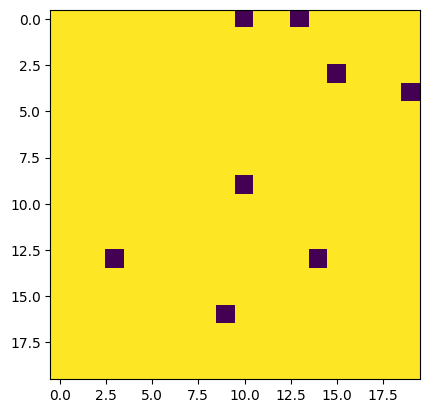

Evaluation 176 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.39it/s]


Completed. Saving
Time (s) to complete simulation 176: 24.051883935928345


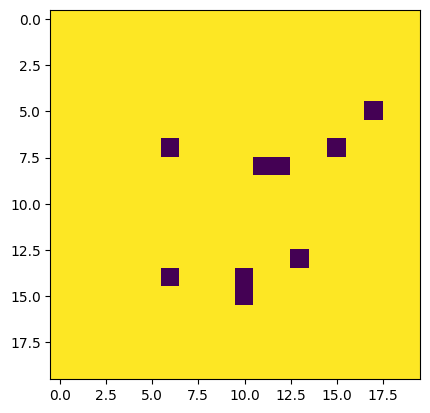

Evaluation 177 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.05it/s]


Completed. Saving
Time (s) to complete simulation 177: 24.14064073562622


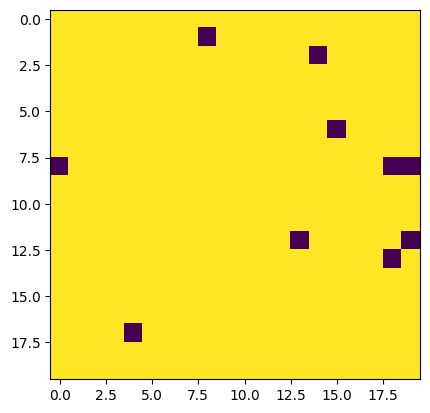

Evaluation 178 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.79it/s]


Completed. Saving
Time (s) to complete simulation 178: 24.28535294532776


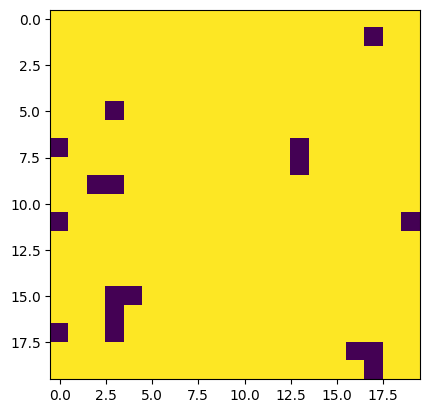

Evaluation 179 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.30it/s]


Completed. Saving
Time (s) to complete simulation 179: 23.88314700126648


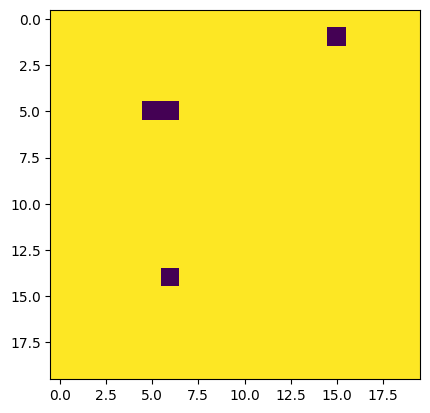

Evaluation 180 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.84it/s]


Completed. Saving
Time (s) to complete simulation 180: 24.23379611968994


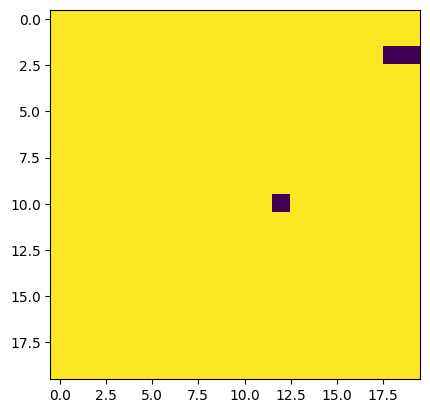

Evaluation 181 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.89it/s]


Completed. Saving
Time (s) to complete simulation 181: 23.64512586593628


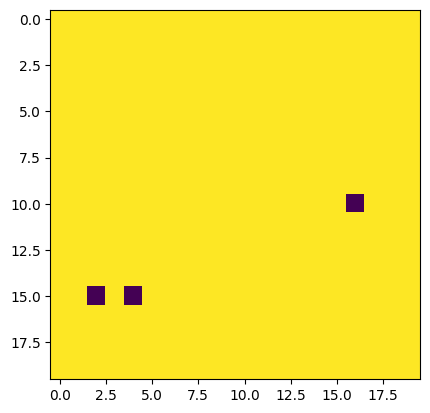

Evaluation 182 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 71.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.08it/s]


Completed. Saving
Time (s) to complete simulation 182: 24.24406671524048


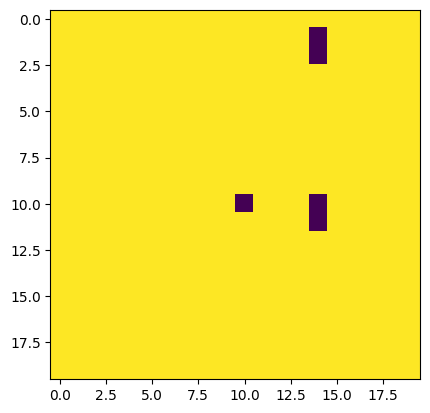

Evaluation 183 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.00it/s]


Completed. Saving
Time (s) to complete simulation 183: 24.149110555648804


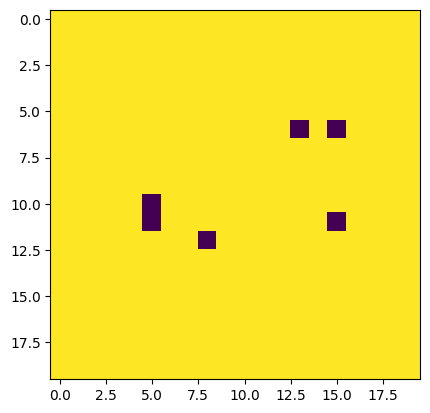

Evaluation 184 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 74.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.01it/s]


Completed. Saving
Time (s) to complete simulation 184: 23.99839186668396


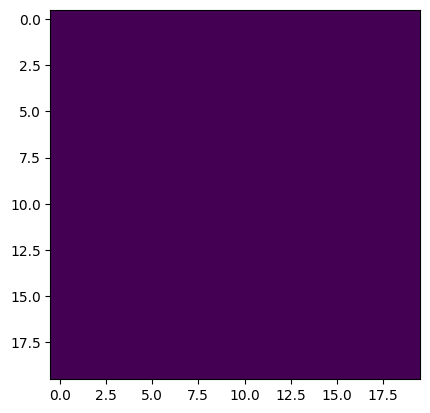

Evaluation 185 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.01it/s]


Completed. Saving
Time (s) to complete simulation 185: 24.12151861190796


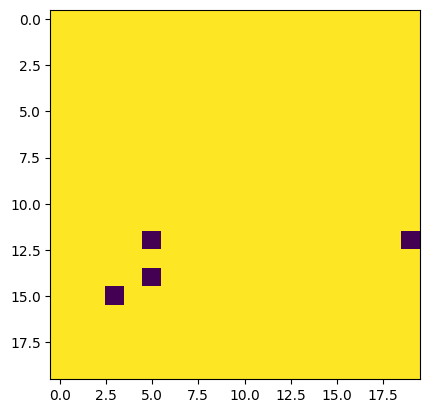

Evaluation 186 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.60it/s]


Completed. Saving
Time (s) to complete simulation 186: 23.883718967437744


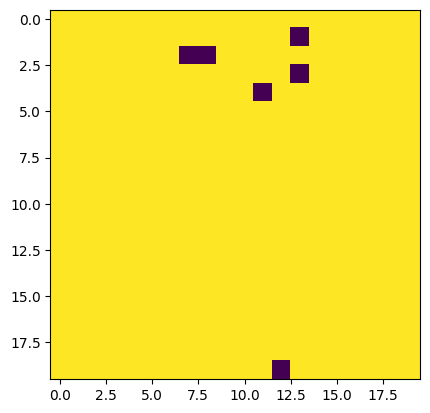

Evaluation 187 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:07<00:00, 70.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.60it/s]


Completed. Saving
Time (s) to complete simulation 187: 23.987664461135864


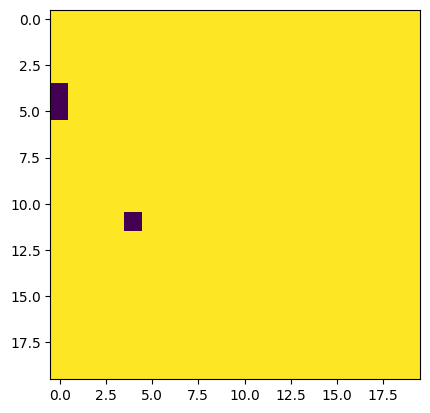

Evaluation 188 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.01it/s]


Completed. Saving
Time (s) to complete simulation 188: 24.09065079689026


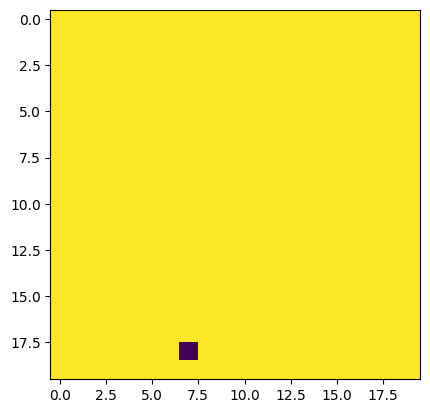

Evaluation 189 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.22it/s]


Completed. Saving
Time (s) to complete simulation 189: 23.891475200653076


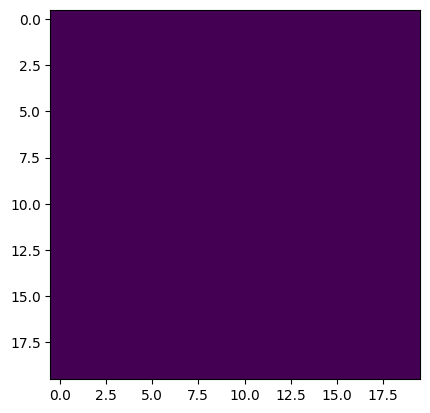

Evaluation 190 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.68it/s]


Completed. Saving
Time (s) to complete simulation 190: 24.27325987815857


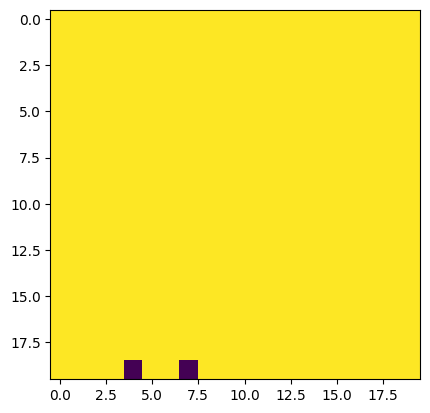

Evaluation 191 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.64it/s]


Completed. Saving
Time (s) to complete simulation 191: 23.804242849349976


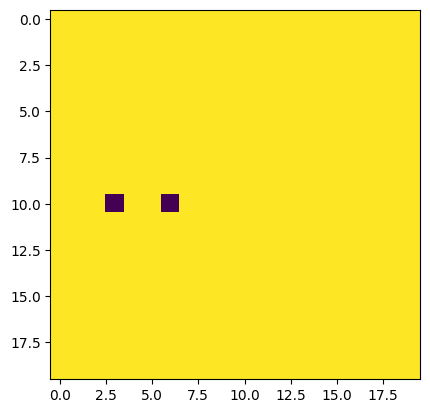

Evaluation 192 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.85it/s]


Completed. Saving
Time (s) to complete simulation 192: 23.7573344707489


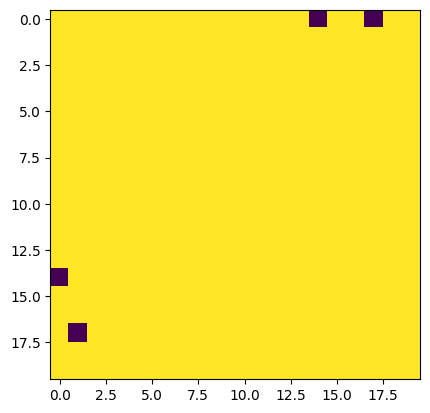

Evaluation 193 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.64it/s]


Completed. Saving
Time (s) to complete simulation 193: 24.431787490844727


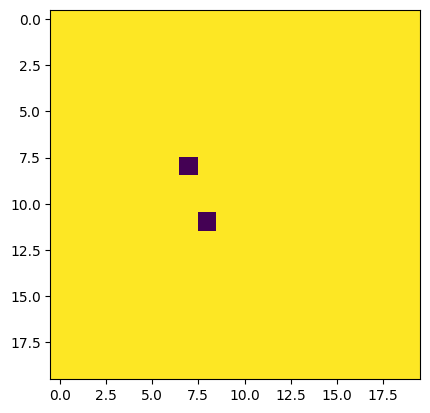

Evaluation 194 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.83it/s]


Completed. Saving
Time (s) to complete simulation 194: 24.200825214385986


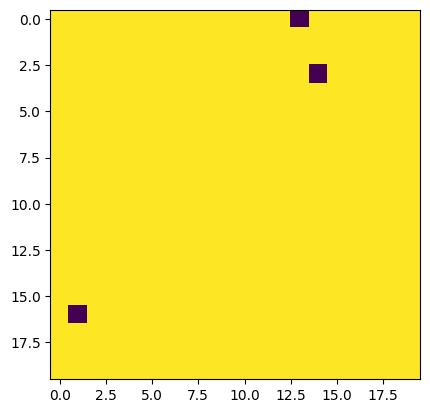

Evaluation 195 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.32it/s]


Completed. Saving
Time (s) to complete simulation 195: 23.825998067855835


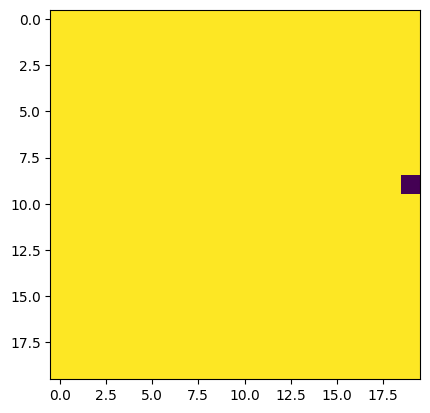

Evaluation 196 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.00it/s]


Completed. Saving
Time (s) to complete simulation 196: 24.039313554763794


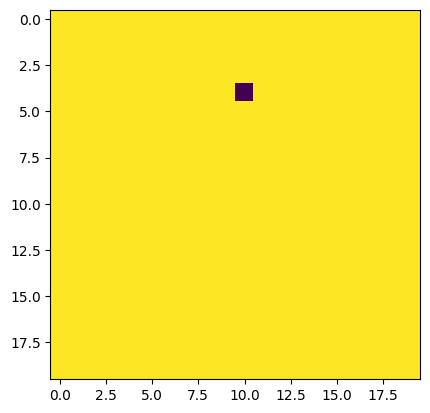

Evaluation 197 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 71.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.70it/s]


Completed. Saving
Time (s) to complete simulation 197: 23.831742763519287


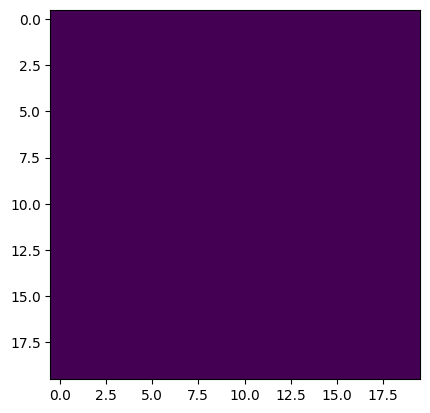

Evaluation 198 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 29.02it/s]


Completed. Saving
Time (s) to complete simulation 198: 24.125696182250977


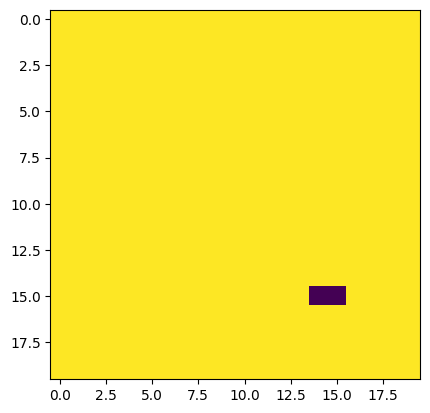

Evaluation 199 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.81it/s]


Completed. Saving
Time (s) to complete simulation 199: 23.691177129745483


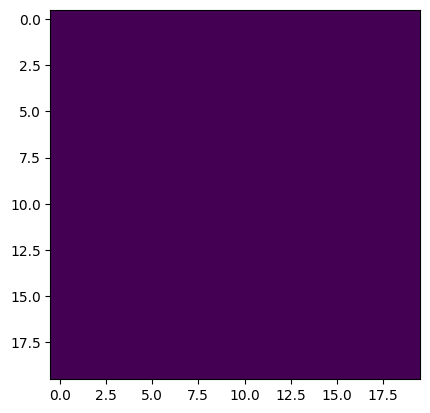

Evaluation 200 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 73.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:17<00:00, 28.97it/s]


Completed. Saving
Time (s) to complete simulation 200: 24.07935881614685


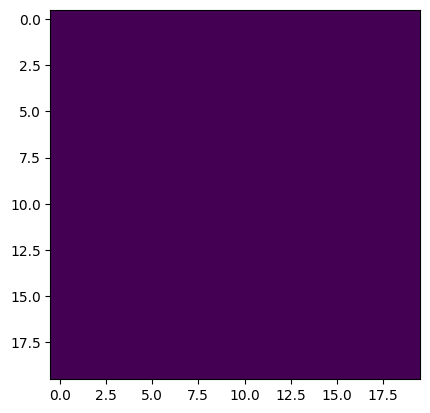

Evaluation 201 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:06<00:00, 72.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:16<00:00, 29.59it/s]


Completed. Saving
Time (s) to complete simulation 201: 23.8006911277771


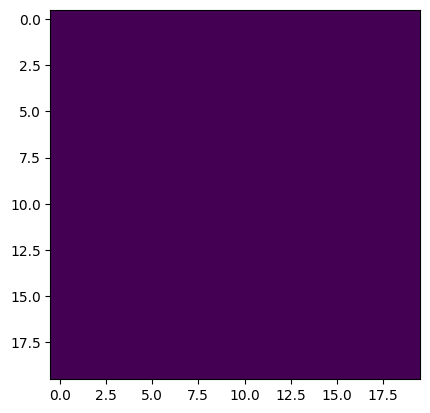

In [ ]:
Jx = xs
results_dict = {}
approx_ys = np.zeros(xs.shape[0])
time_eval = np.zeros(xs.shape[0])
for i in range(0, Jx.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(N_total))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(time_eval[i]))
    results_dict[i] = {'sim': sq_sim.results,}
    approx_ys[i] = results_dict[i]['sim']['SpecificHeat']
    plt.imshow(results_dict[i]['sim']['config'][-1])
    plt.show()

In [ ]:
np.save("results_dict_square.npy", results_dict)

In [ ]:
from google.colab import files
files.download("results_dict_square.npy")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

(24.084554430264145, 0.5040963153177385)

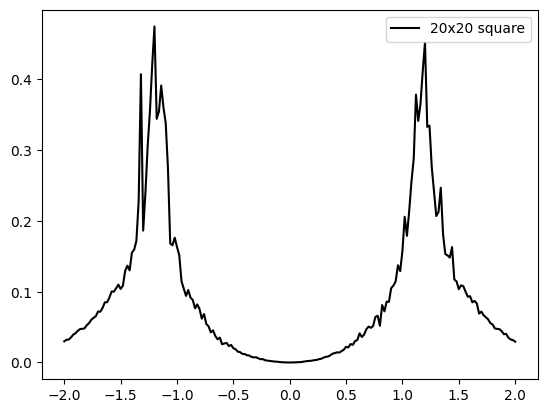

In [ ]:
plt.plot(xs, approx_ys, "k", label="20x20 square")
plt.legend(loc="best")
np.mean(time_eval), np.std(time_eval)

Full grid evaluation for 20x20 1D Ising model -Triangular Model

Evaluation 1 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.80it/s]
<ipython-input-29-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 1: 66.54958510398865


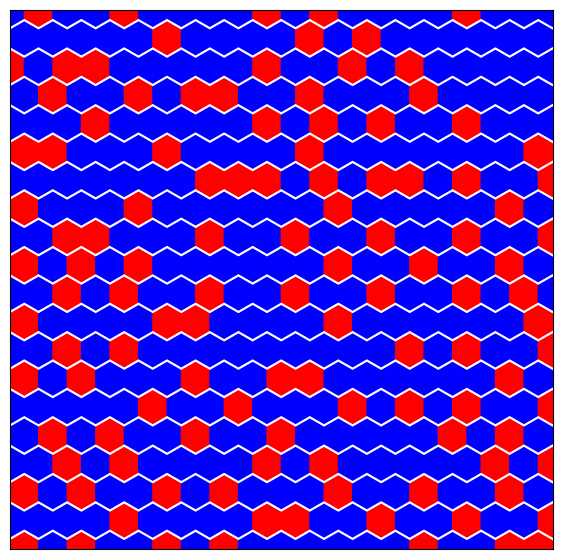

Evaluation 2 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:29<00:00, 17.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:34<00:00, 14.35it/s]


Completed. Saving
Time (s) to complete simulation 2: 64.10534119606018


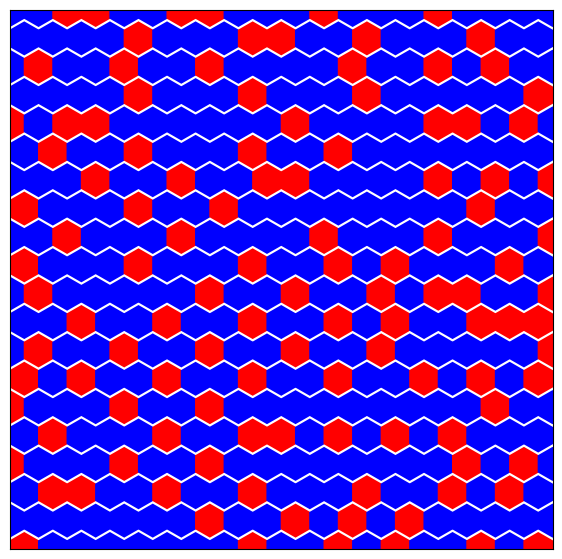

Evaluation 3 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:34<00:00, 14.31it/s]


Completed. Saving
Time (s) to complete simulation 3: 65.52952408790588


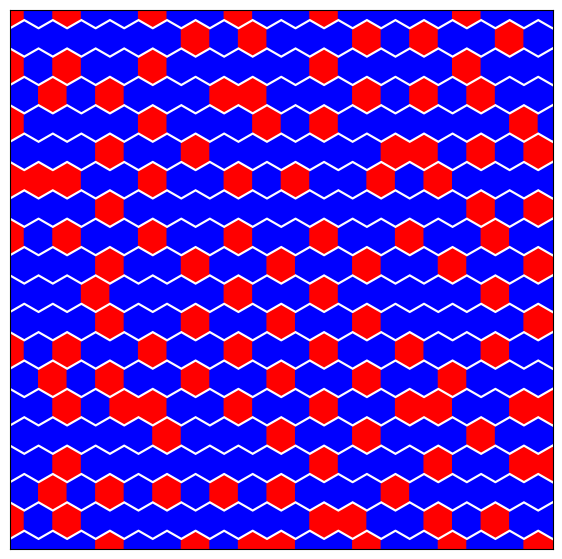

Evaluation 4 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.35it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.24it/s]


Completed. Saving
Time (s) to complete simulation 4: 65.71426343917847


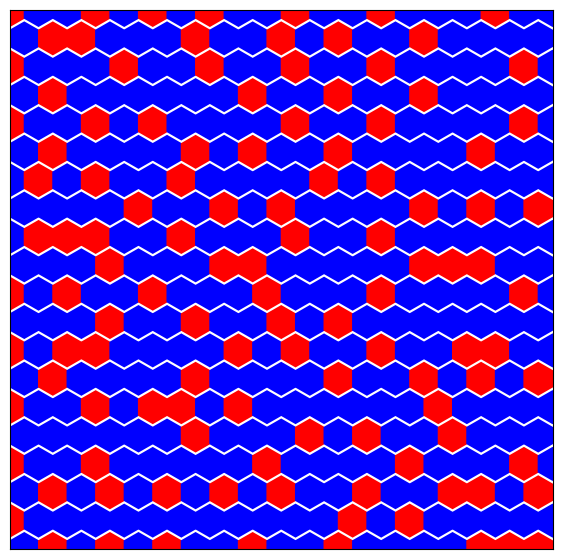

Evaluation 5 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.19it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.03it/s]


Completed. Saving
Time (s) to complete simulation 5: 66.53848147392273


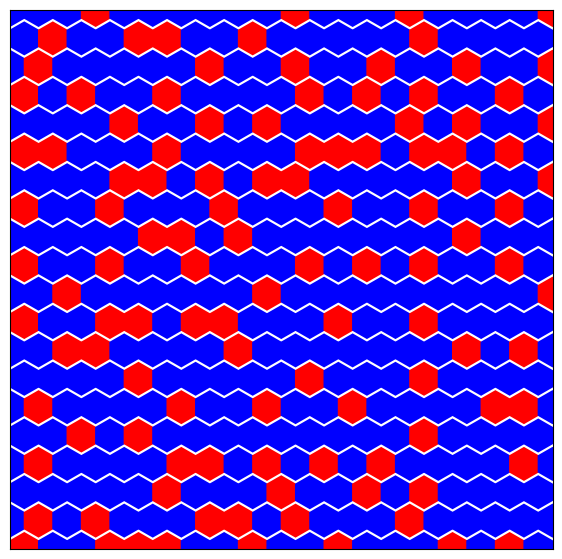

Evaluation 6 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.18it/s]


Completed. Saving
Time (s) to complete simulation 6: 65.66658449172974


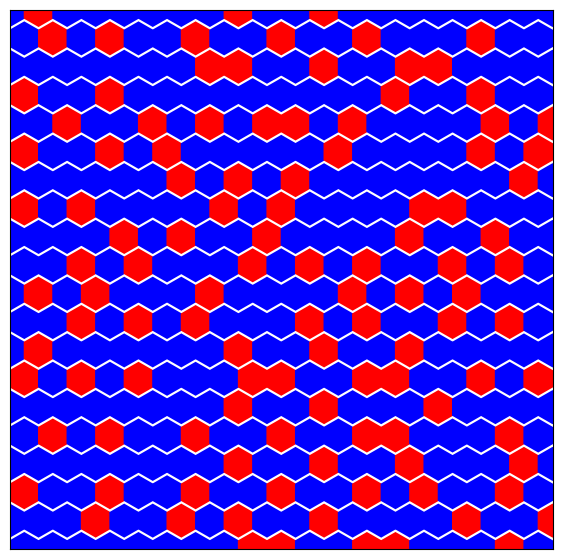

Evaluation 7 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.96it/s]


Completed. Saving
Time (s) to complete simulation 7: 66.5669047832489


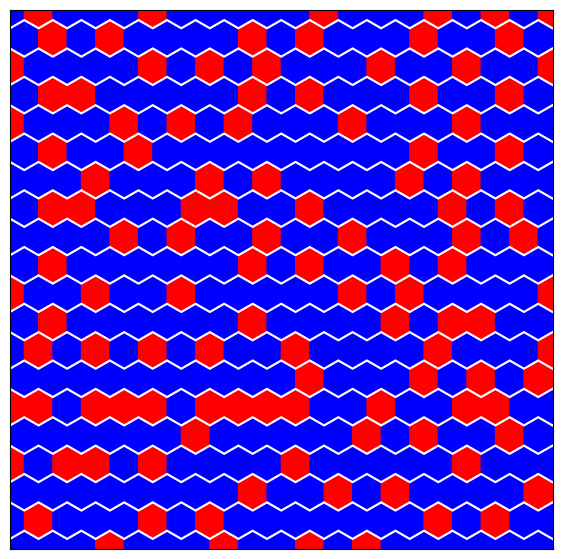

Evaluation 8 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.55it/s]

Completed. Saving
Time (s) to complete simulation 8: 67.17012429237366


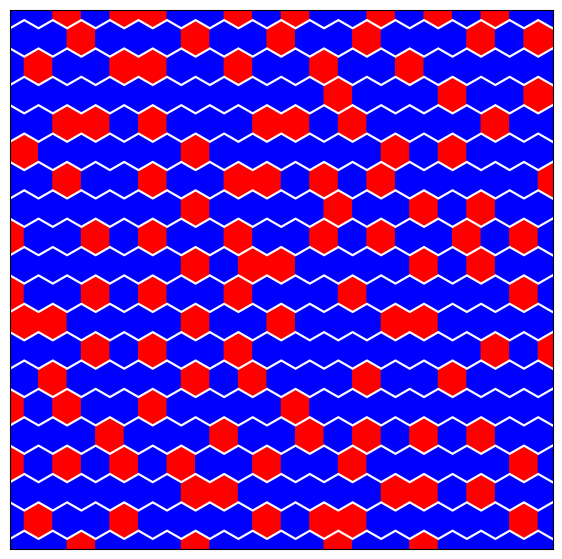

Evaluation 9 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.14it/s]


Completed. Saving
Time (s) to complete simulation 9: 65.72384643554688


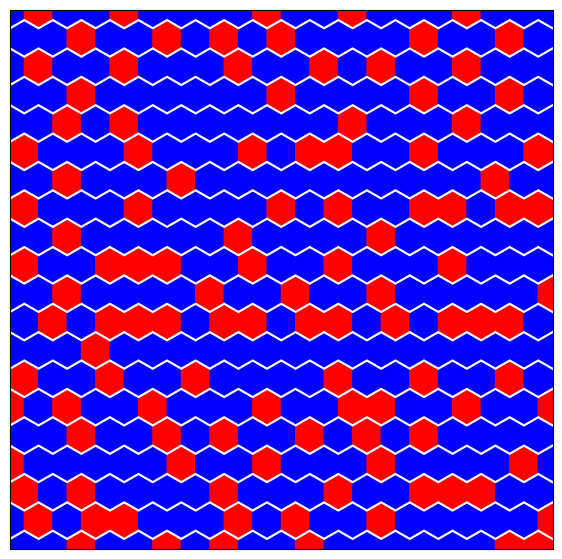

Evaluation 10 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.20it/s]


Completed. Saving
Time (s) to complete simulation 10: 65.72893261909485


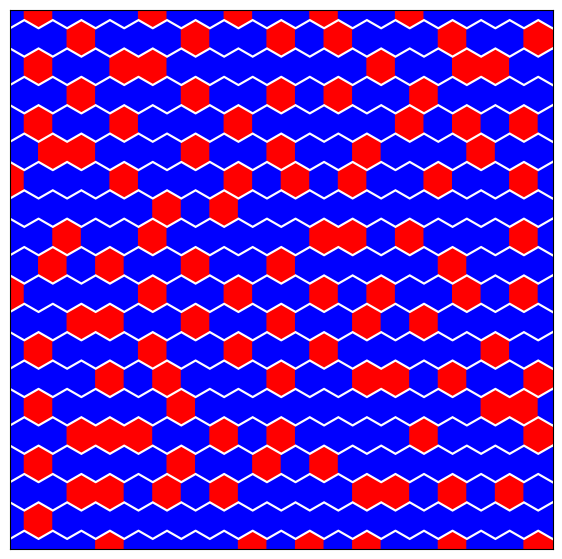

Evaluation 11 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.12it/s]


Completed. Saving
Time (s) to complete simulation 11: 67.08195972442627


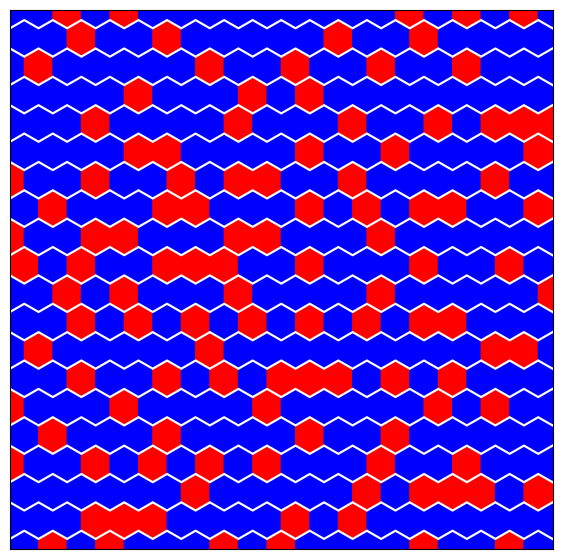

Evaluation 12 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.29it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.08it/s]


Completed. Saving
Time (s) to complete simulation 12: 66.22240543365479


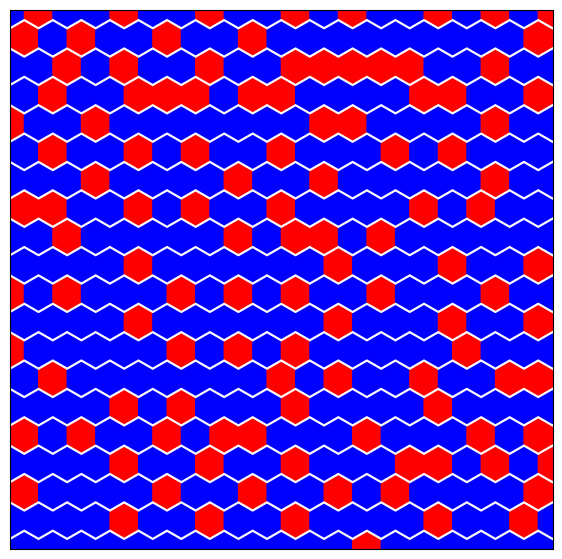

Evaluation 13 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.09it/s]


Completed. Saving
Time (s) to complete simulation 13: 67.0439383983612


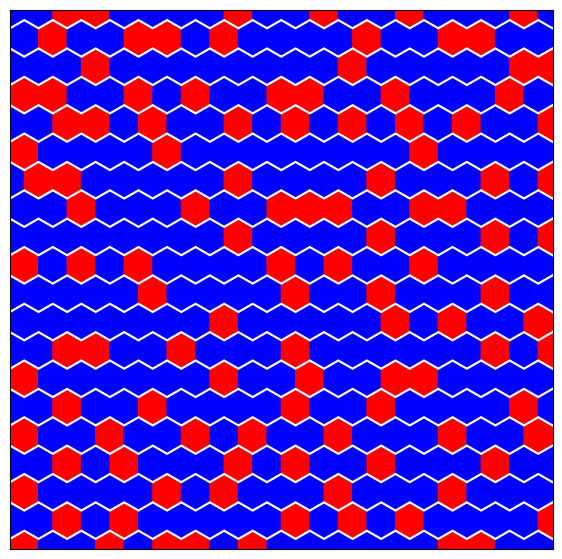

Evaluation 14 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.11it/s]


Completed. Saving
Time (s) to complete simulation 14: 66.00466775894165


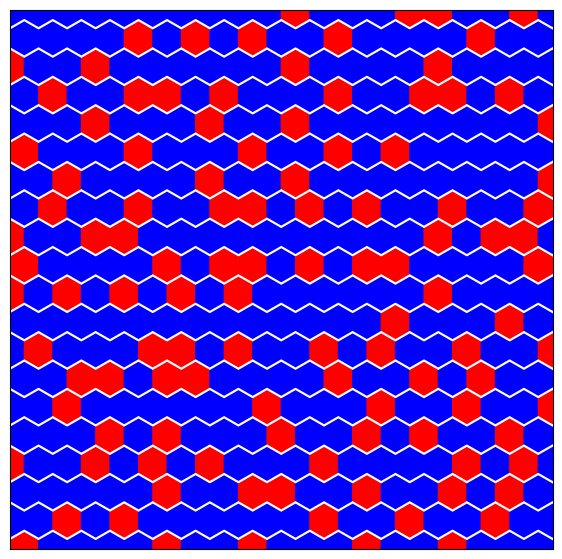

Evaluation 15 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.94it/s]


Completed. Saving
Time (s) to complete simulation 15: 66.44477128982544


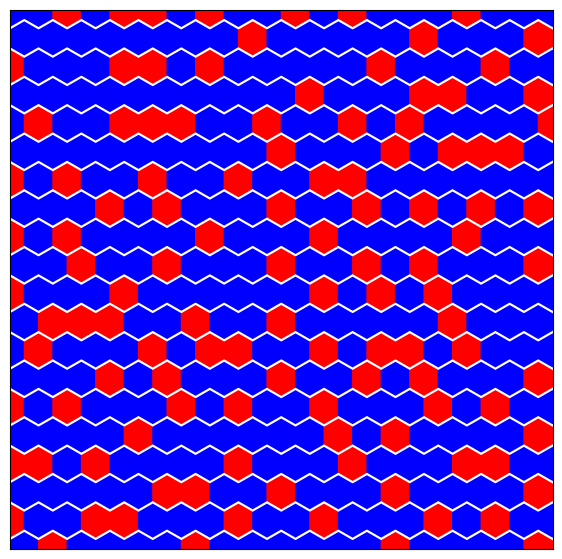

Evaluation 16 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.19it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.08it/s]


Completed. Saving
Time (s) to complete simulation 16: 66.41562390327454


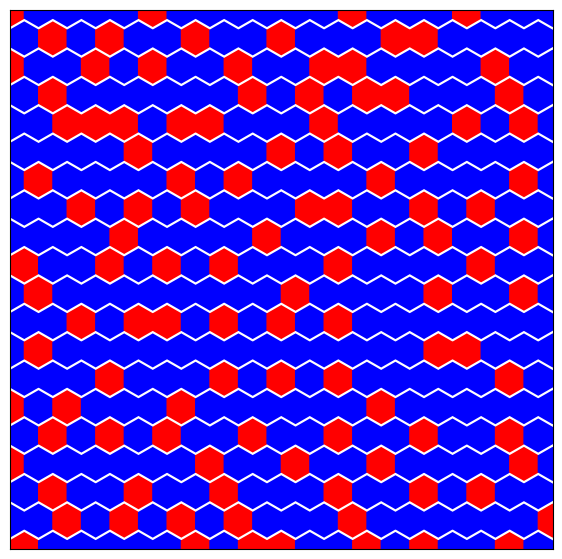

Evaluation 17 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.08it/s]


Completed. Saving
Time (s) to complete simulation 17: 66.3343608379364


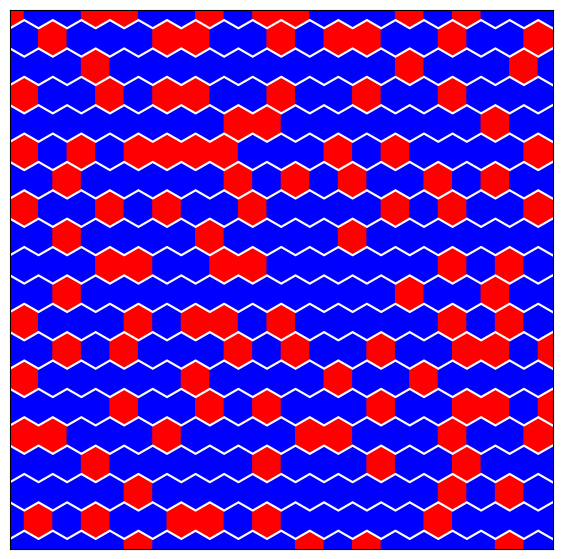

Evaluation 18 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.08it/s]


Completed. Saving
Time (s) to complete simulation 18: 66.45916604995728


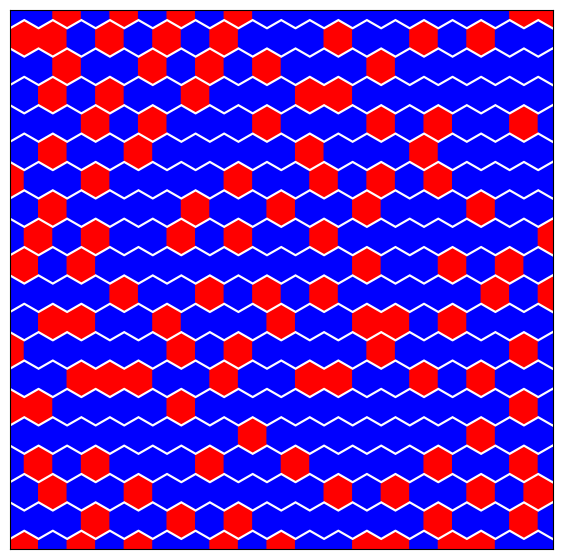

Evaluation 19 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.95it/s]


Completed. Saving
Time (s) to complete simulation 19: 67.02393555641174


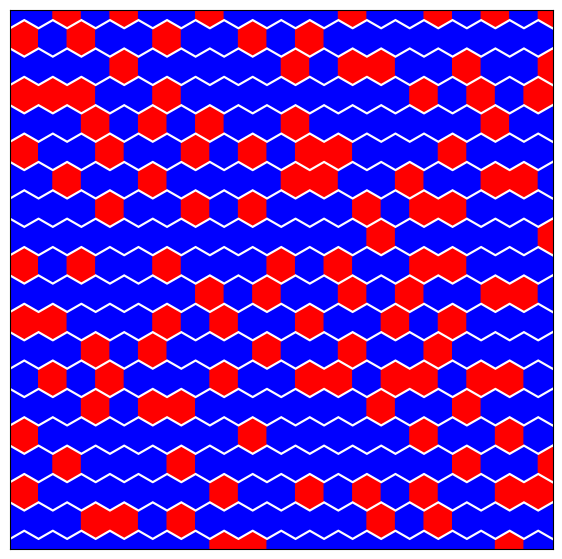

Evaluation 20 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.71it/s]


Completed. Saving
Time (s) to complete simulation 20: 67.59275078773499


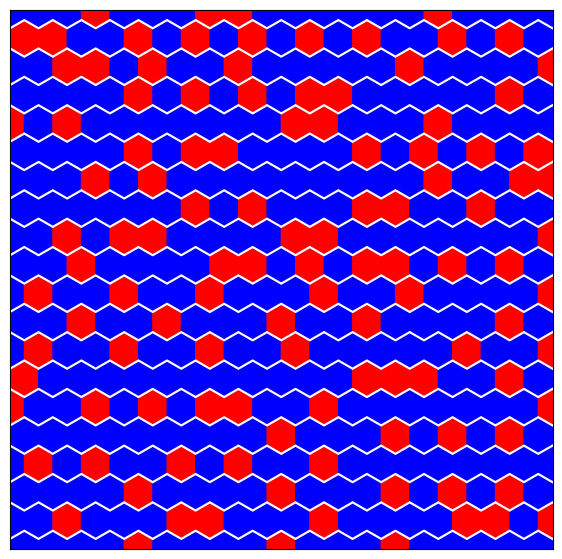

Evaluation 21 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.94it/s]


Completed. Saving
Time (s) to complete simulation 21: 66.50322914123535


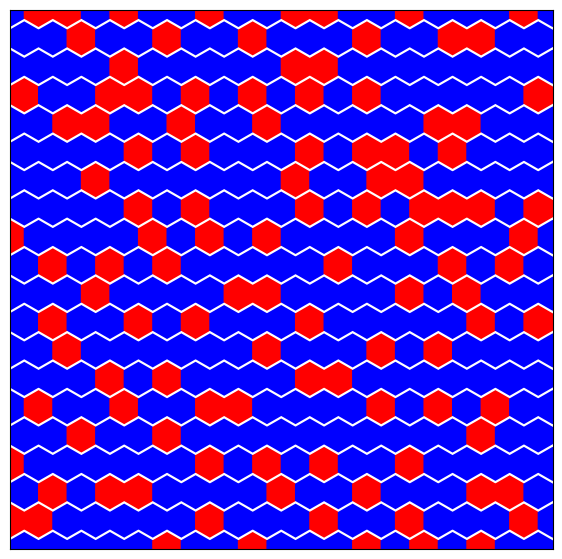

Evaluation 22 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.78it/s]


Completed. Saving
Time (s) to complete simulation 22: 67.35804438591003


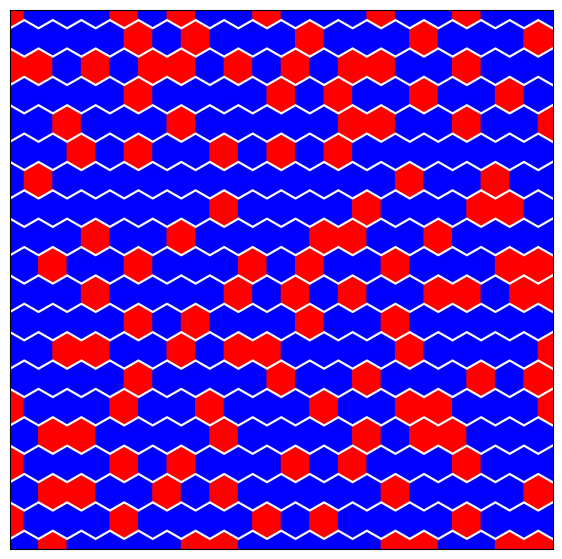

Evaluation 23 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.90it/s]


Completed. Saving
Time (s) to complete simulation 23: 66.84493851661682


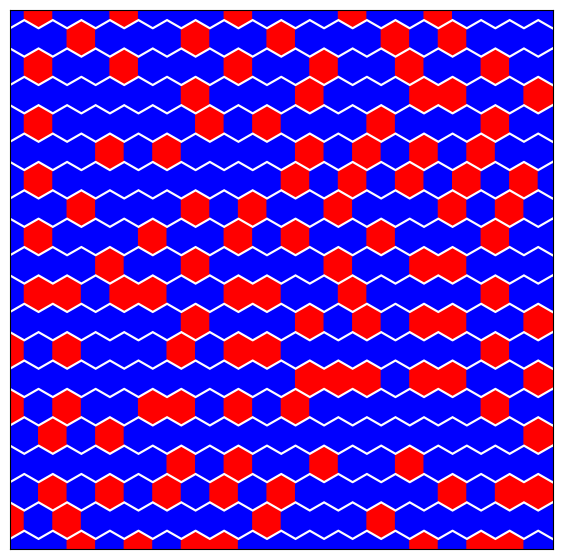

Evaluation 24 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.24it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.81it/s]


Completed. Saving
Time (s) to complete simulation 24: 67.02369785308838


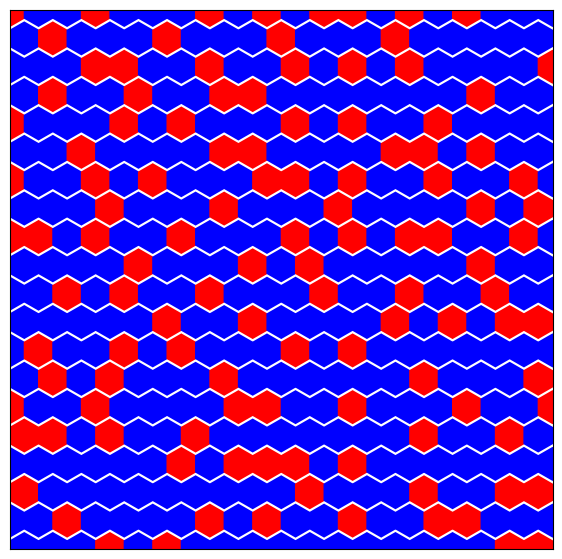

Evaluation 25 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.94it/s]


Completed. Saving
Time (s) to complete simulation 25: 67.42545104026794


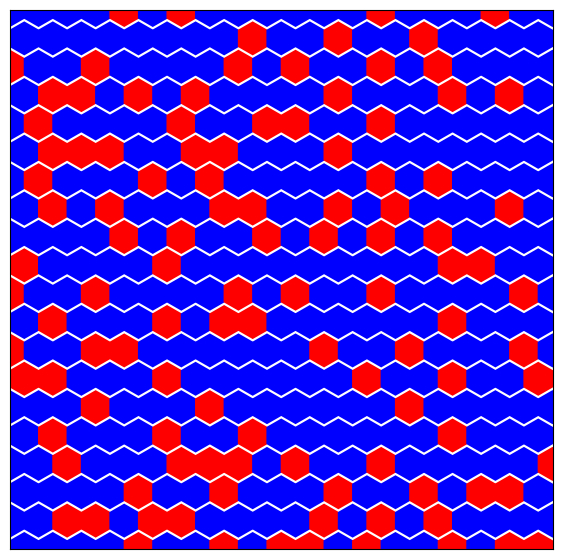

Evaluation 26 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.04it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.02it/s]


Completed. Saving
Time (s) to complete simulation 26: 66.86842346191406


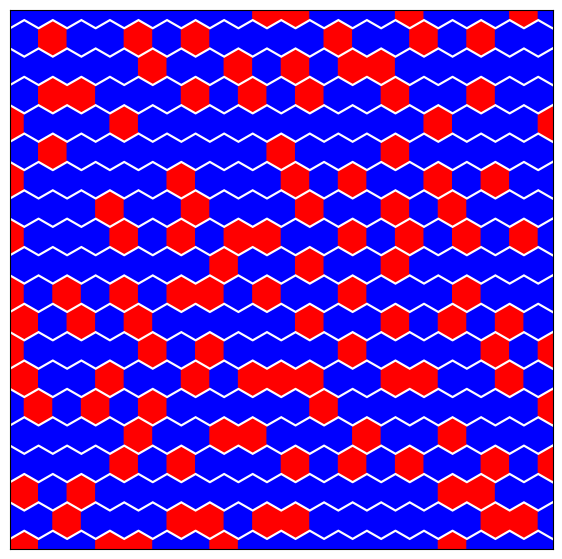

Evaluation 27 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.84it/s]


Completed. Saving
Time (s) to complete simulation 27: 66.88047862052917


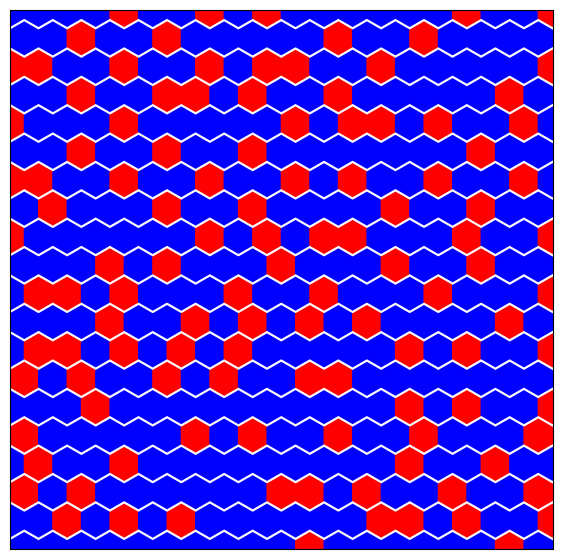

Evaluation 28 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.75it/s]


Completed. Saving
Time (s) to complete simulation 28: 67.81322622299194


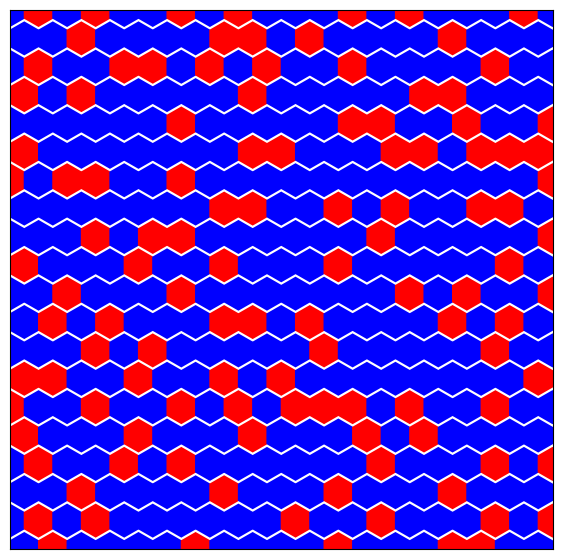

Evaluation 29 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.76it/s]


Completed. Saving
Time (s) to complete simulation 29: 67.43954491615295


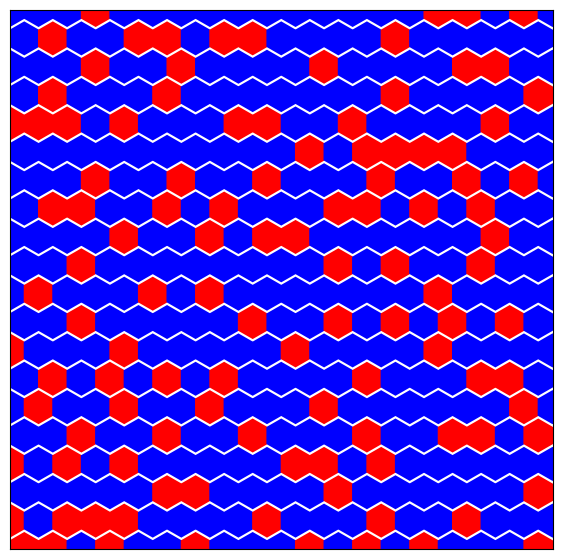

Evaluation 30 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.86it/s]


Completed. Saving
Time (s) to complete simulation 30: 68.53271746635437


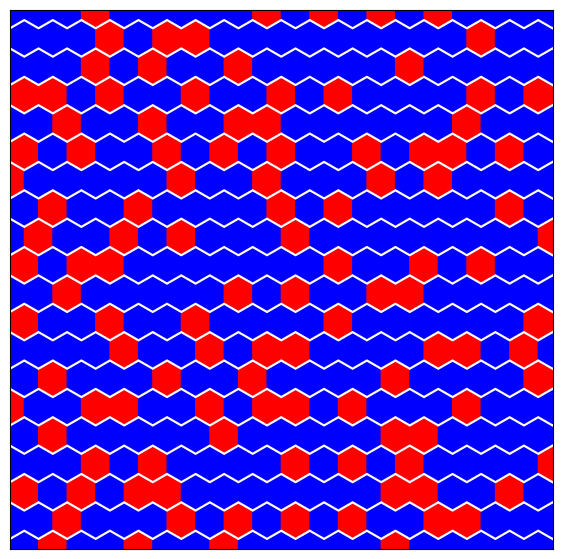

Evaluation 31 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.71it/s]


Completed. Saving
Time (s) to complete simulation 31: 68.29466366767883


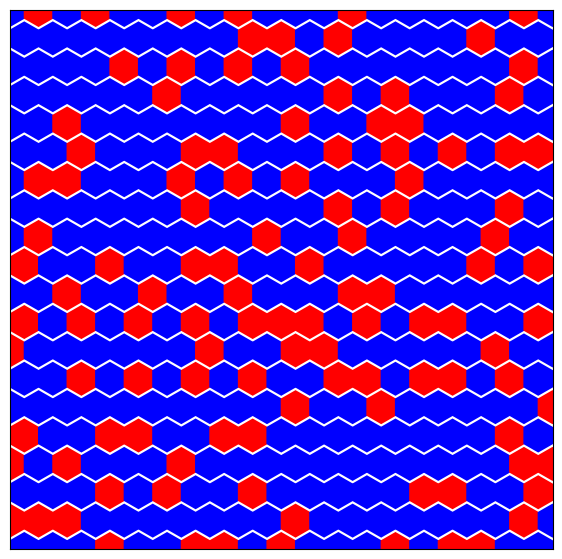

Evaluation 32 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.63it/s]


Completed. Saving
Time (s) to complete simulation 32: 68.65698647499084


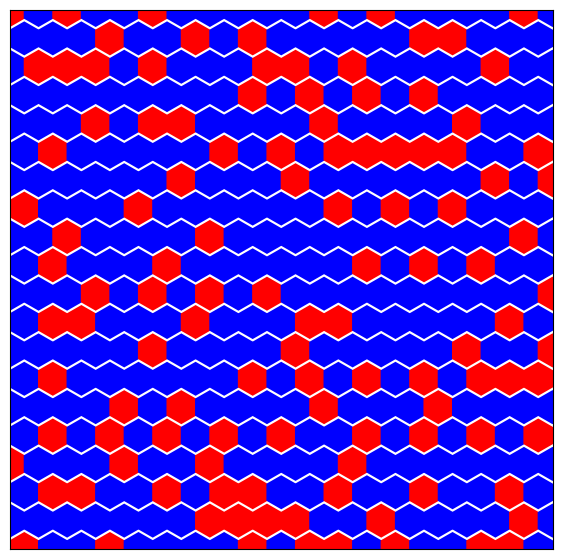

Evaluation 33 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.63it/s]


Completed. Saving
Time (s) to complete simulation 33: 68.72420001029968


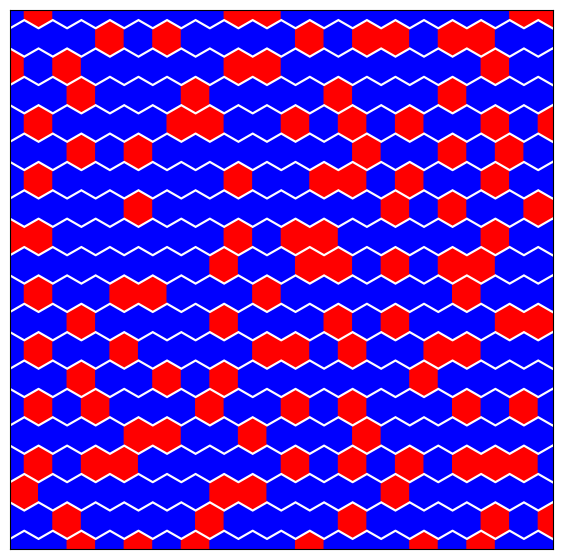

Evaluation 34 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.65it/s]


Completed. Saving
Time (s) to complete simulation 34: 68.14131355285645


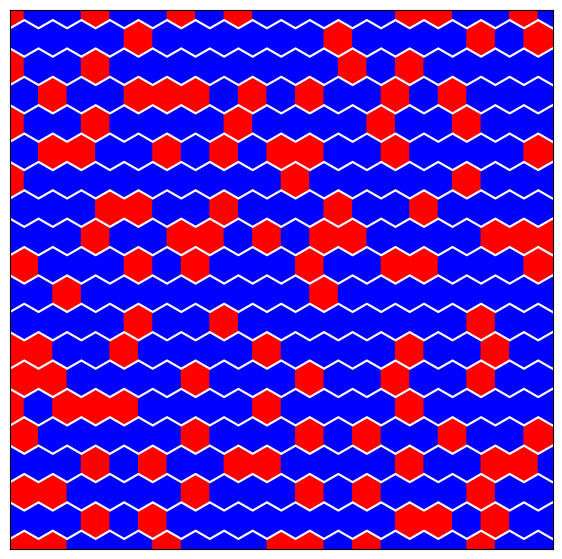

Evaluation 35 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.42it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.65it/s]


Completed. Saving
Time (s) to complete simulation 35: 69.05815958976746


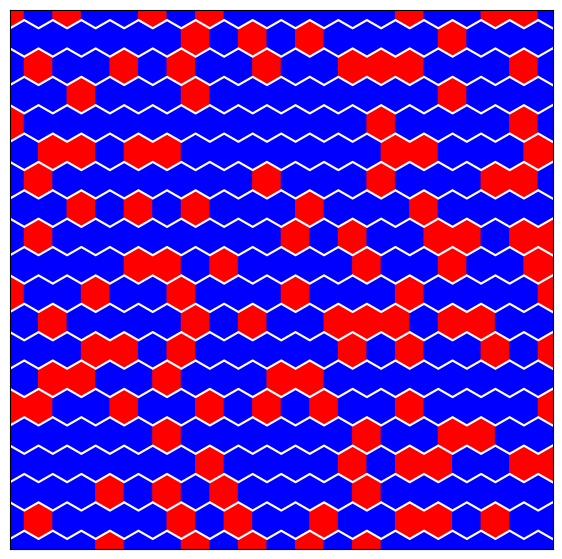

Evaluation 36 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.81it/s]


Completed. Saving
Time (s) to complete simulation 36: 67.52479290962219


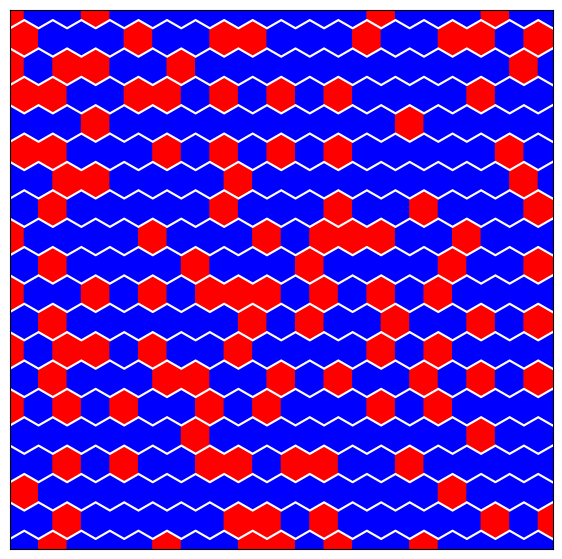

Evaluation 37 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.74it/s]


Completed. Saving
Time (s) to complete simulation 37: 68.11524653434753


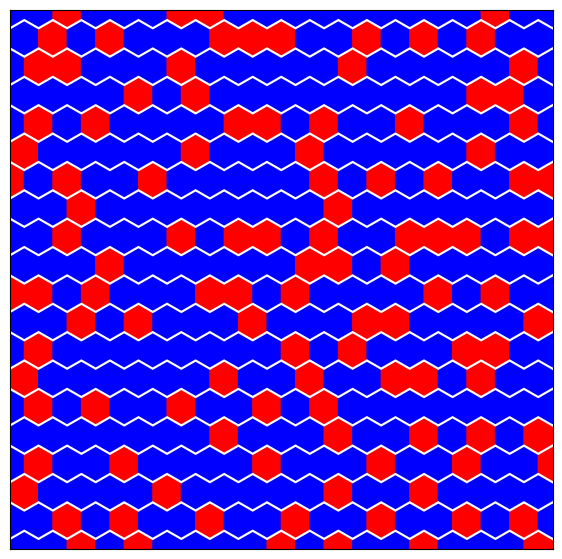

Evaluation 38 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.81it/s]


Completed. Saving
Time (s) to complete simulation 38: 68.22417521476746


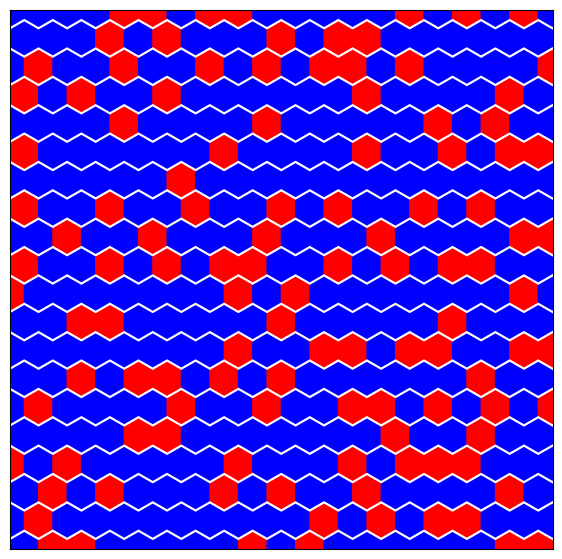

Evaluation 39 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.43it/s]


Completed. Saving
Time (s) to complete simulation 39: 68.84460020065308


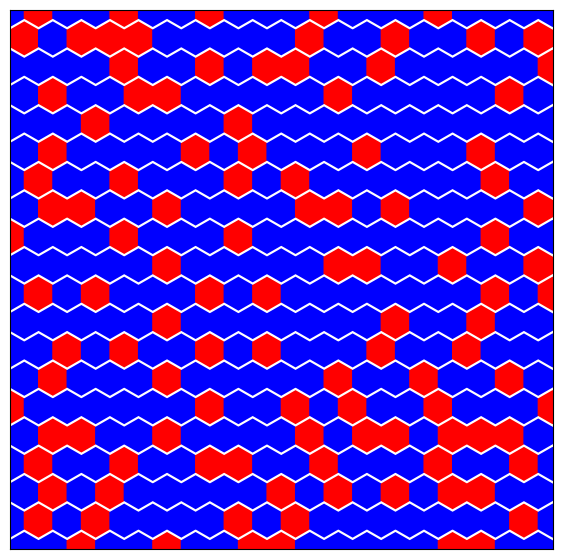

Evaluation 40 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.69it/s]


Completed. Saving
Time (s) to complete simulation 40: 67.73619723320007


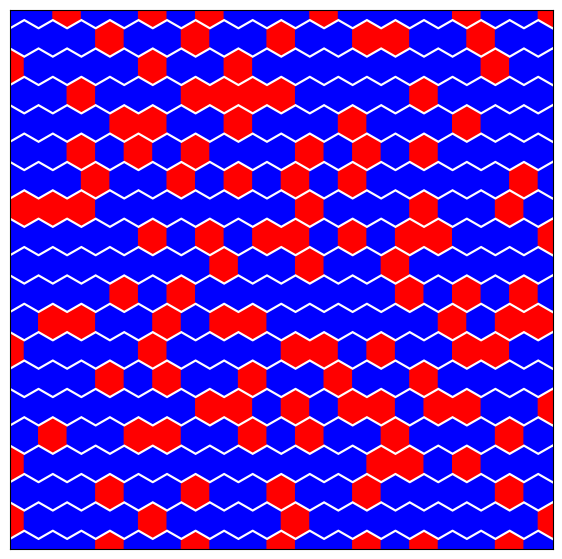

Evaluation 41 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.61it/s]


Completed. Saving
Time (s) to complete simulation 41: 68.39742636680603


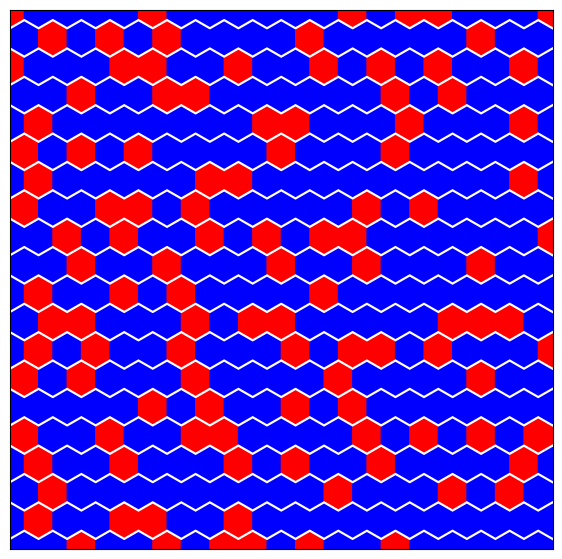

Evaluation 42 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.87it/s]


Completed. Saving
Time (s) to complete simulation 42: 67.33867263793945


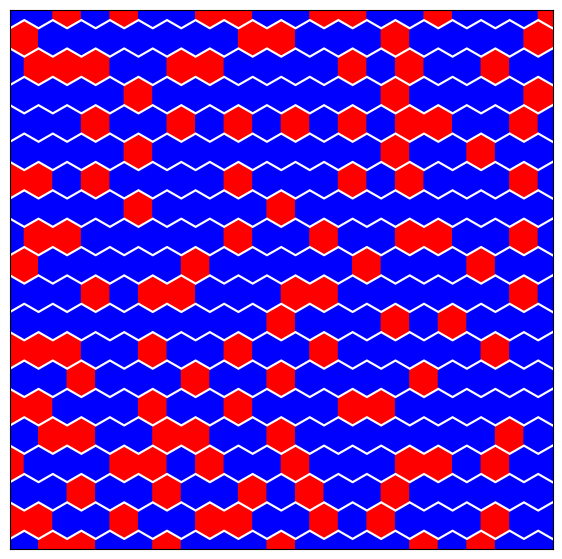

Evaluation 43 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.85it/s]


Completed. Saving
Time (s) to complete simulation 43: 67.30123233795166


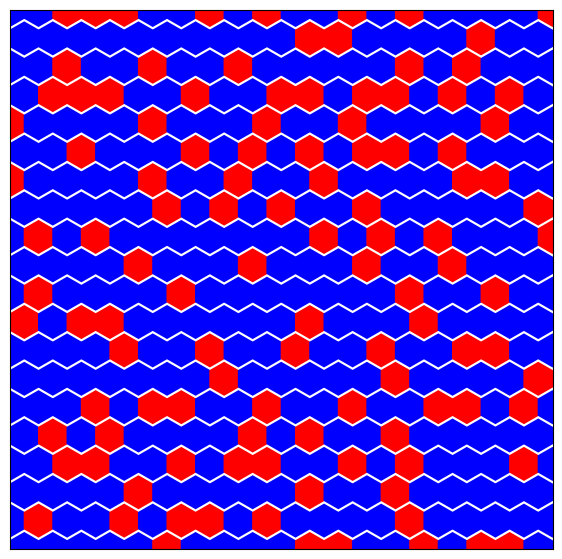

Evaluation 44 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.01it/s]


Completed. Saving
Time (s) to complete simulation 44: 68.0509135723114


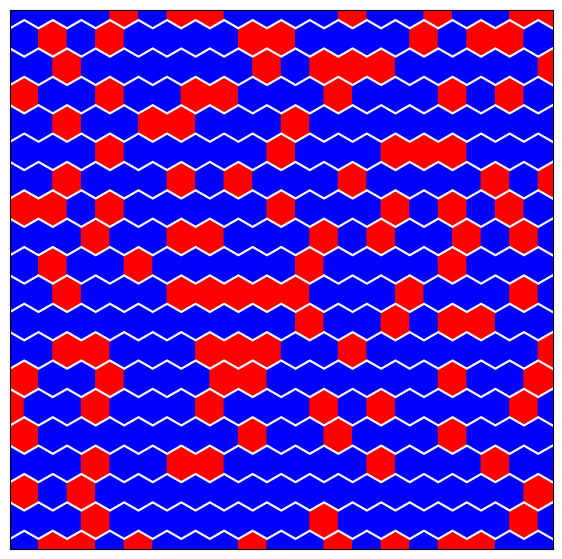

Evaluation 45 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.91it/s]


Completed. Saving
Time (s) to complete simulation 45: 67.62041330337524


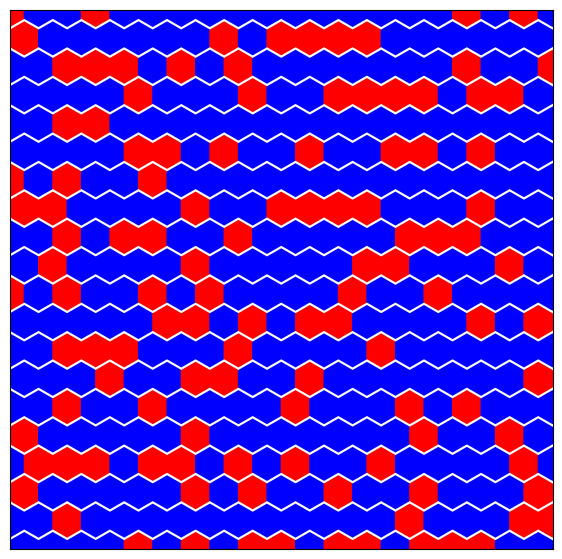

Evaluation 46 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.51it/s]


Completed. Saving
Time (s) to complete simulation 46: 68.44432258605957


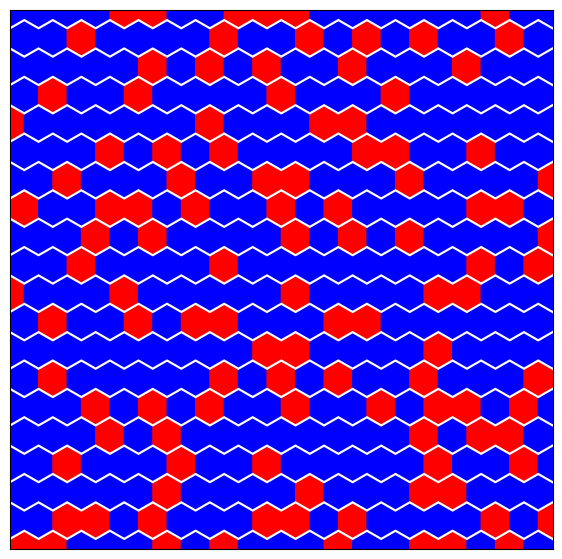

Evaluation 47 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.59it/s]


Completed. Saving
Time (s) to complete simulation 47: 68.15902781486511


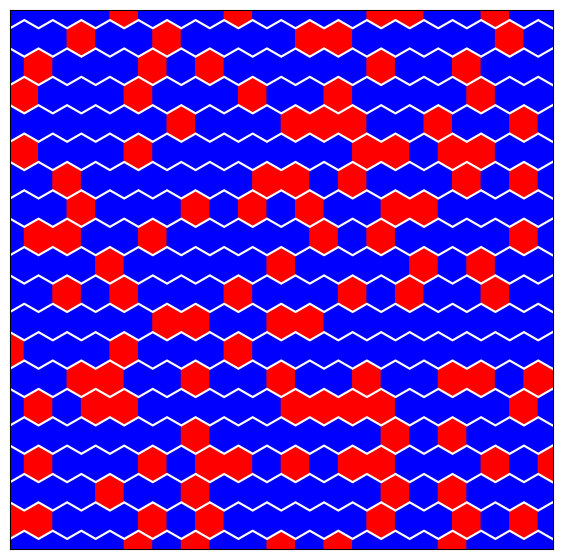

Evaluation 48 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.63it/s]


Completed. Saving
Time (s) to complete simulation 48: 68.36732459068298


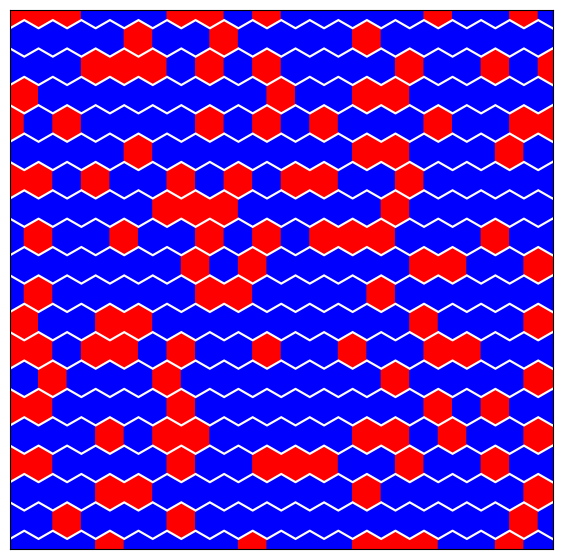

Evaluation 49 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.66it/s]


Completed. Saving
Time (s) to complete simulation 49: 69.45505690574646


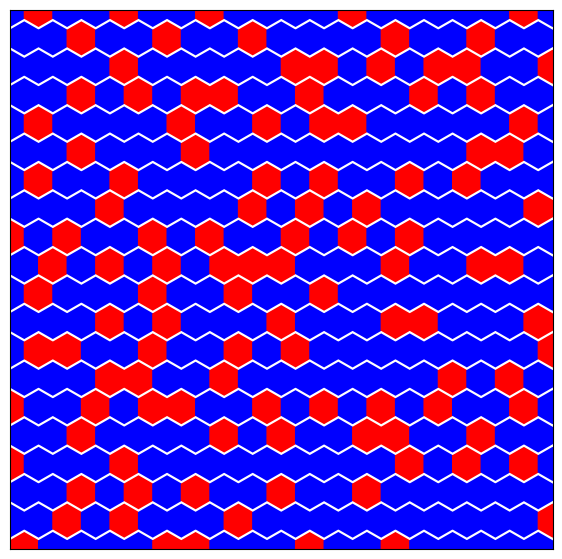

Evaluation 50 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.69it/s]


Completed. Saving
Time (s) to complete simulation 50: 68.58861303329468


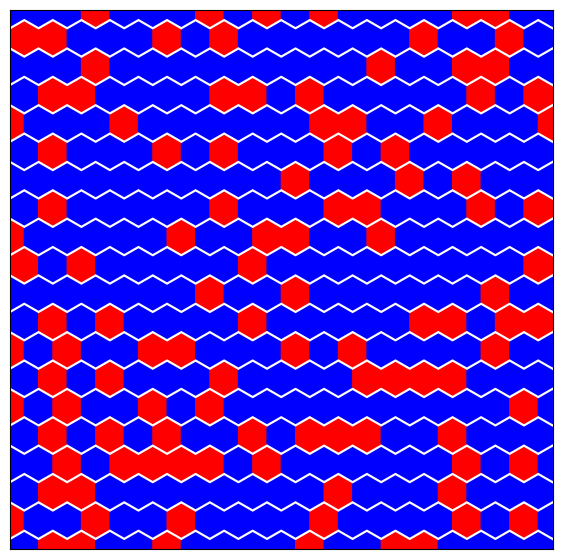

Evaluation 51 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 51: 69.50597524642944


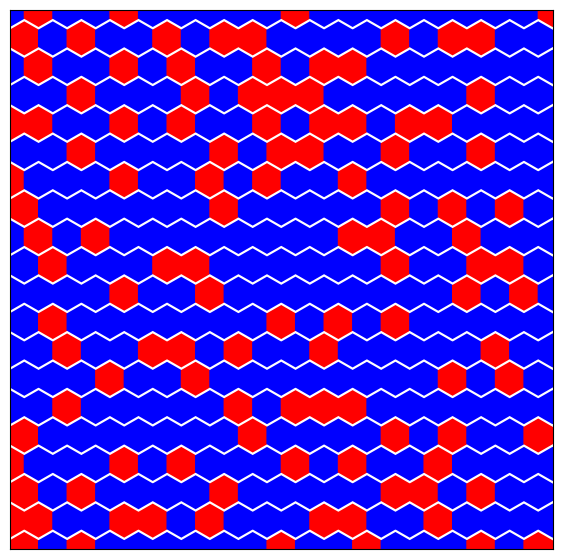

Evaluation 52 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.60it/s]


Completed. Saving
Time (s) to complete simulation 52: 68.2000482082367


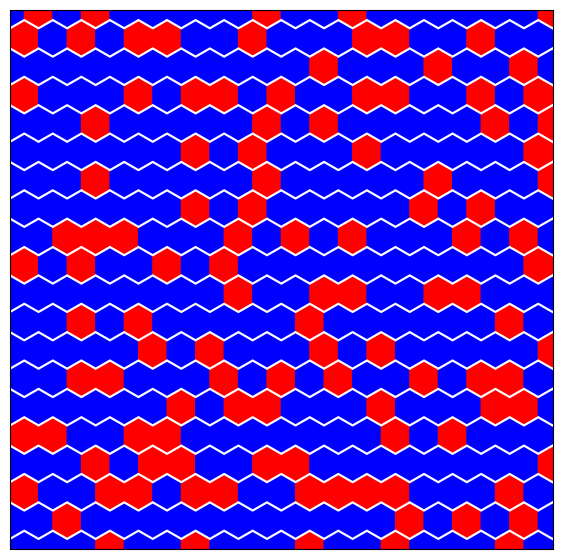

Evaluation 53 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.29it/s]


Completed. Saving
Time (s) to complete simulation 53: 69.65996861457825


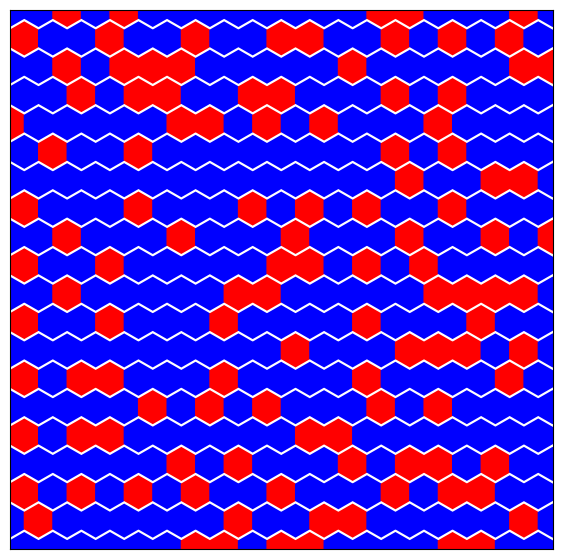

Evaluation 54 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.62it/s]


Completed. Saving
Time (s) to complete simulation 54: 69.11981797218323


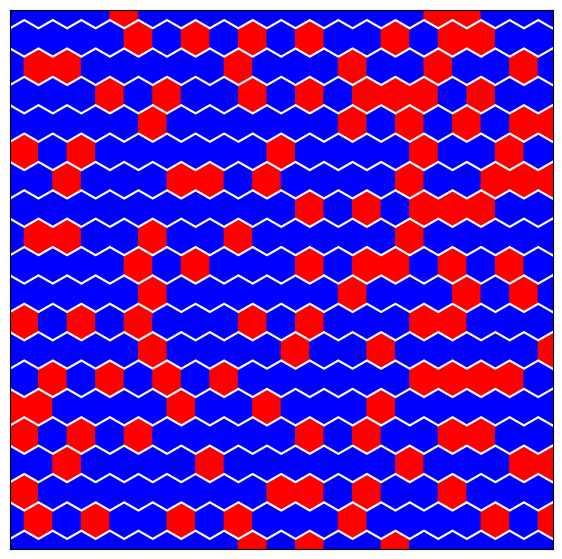

Evaluation 55 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.69it/s]


Completed. Saving
Time (s) to complete simulation 55: 68.41930651664734


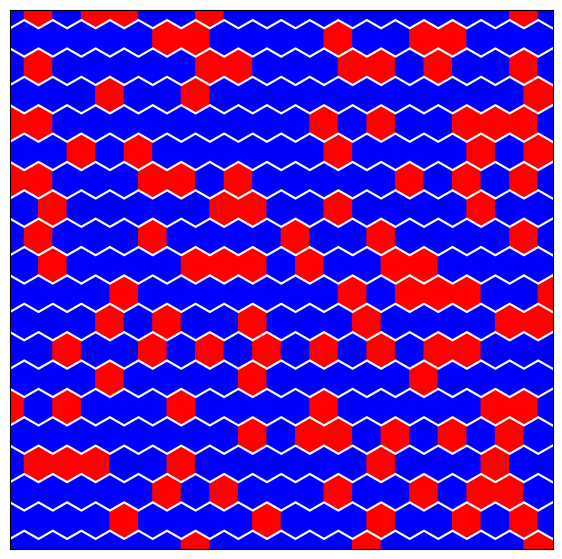

Evaluation 56 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.58it/s]


Completed. Saving
Time (s) to complete simulation 56: 69.0067925453186


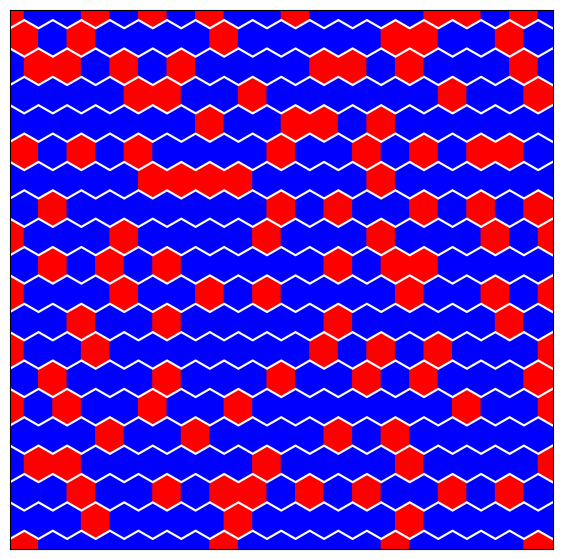

Evaluation 57 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.72it/s]


Completed. Saving
Time (s) to complete simulation 57: 67.9046790599823


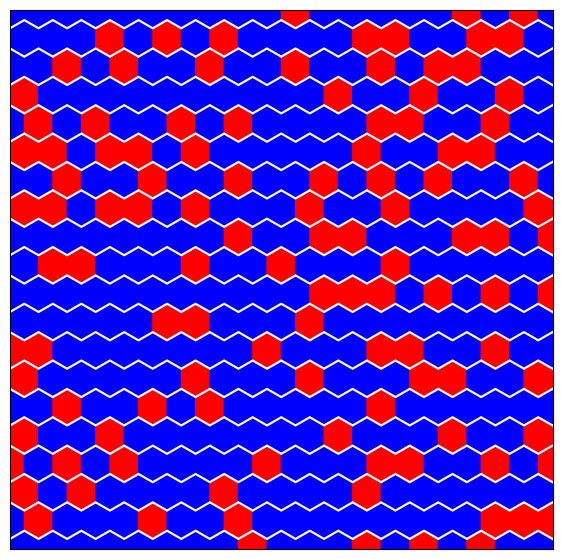

Evaluation 58 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.15it/s]

Completed. Saving
Time (s) to complete simulation 58: 70.4123547077179


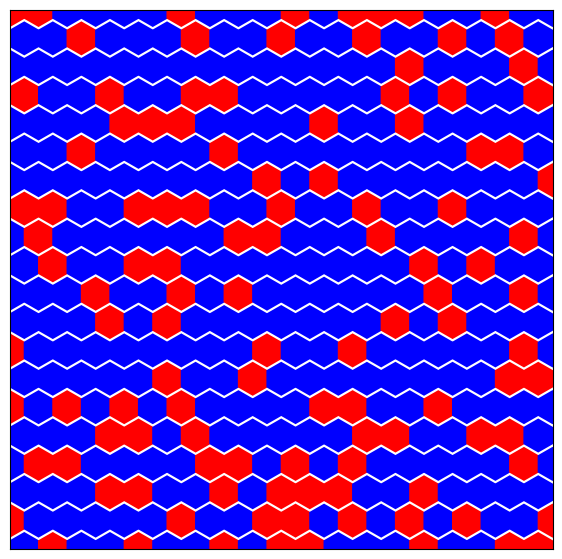

Evaluation 59 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.36it/s]


Completed. Saving
Time (s) to complete simulation 59: 70.54237675666809


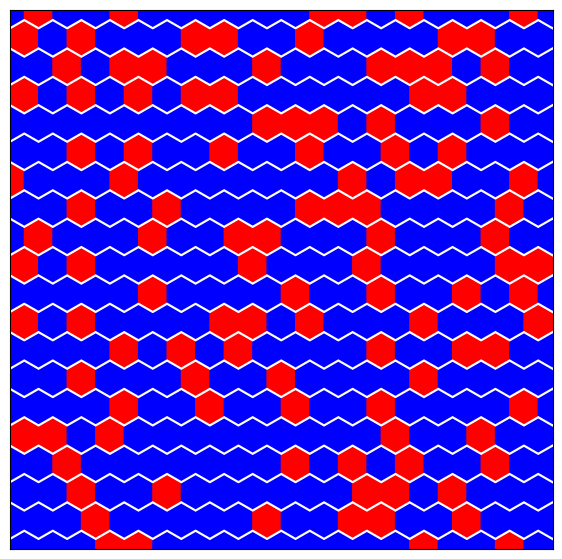

Evaluation 60 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.57it/s]


Completed. Saving
Time (s) to complete simulation 60: 68.68149161338806


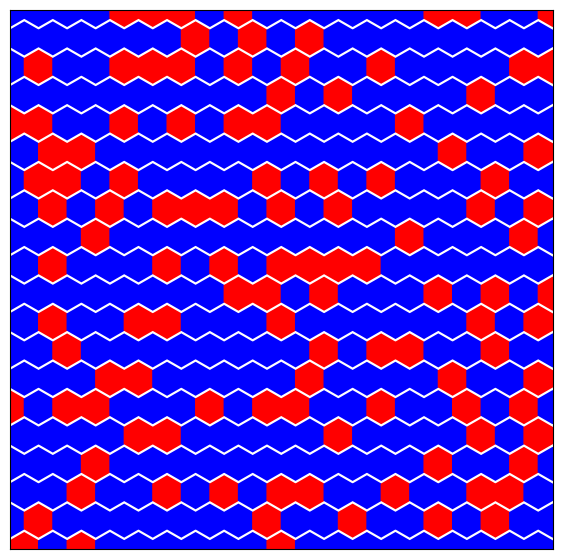

Evaluation 61 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.53it/s]


Completed. Saving
Time (s) to complete simulation 61: 69.32687854766846


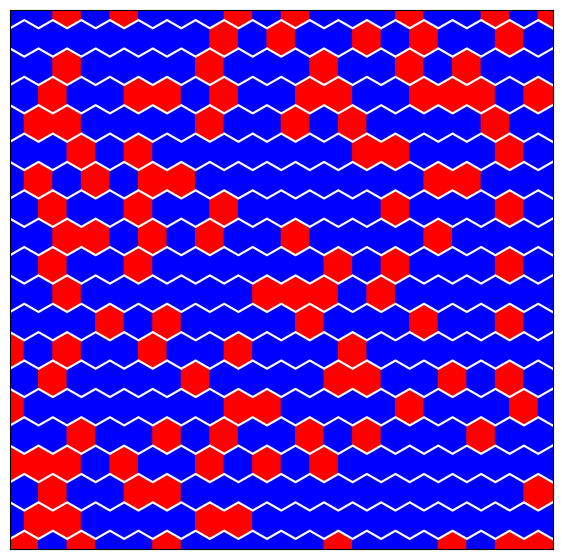

Evaluation 62 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.53it/s]


Completed. Saving
Time (s) to complete simulation 62: 69.1831922531128


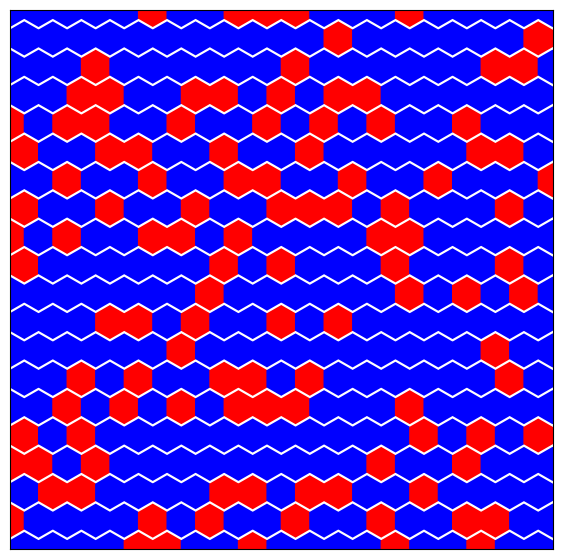

Evaluation 63 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.23it/s]


Completed. Saving
Time (s) to complete simulation 63: 69.95024728775024


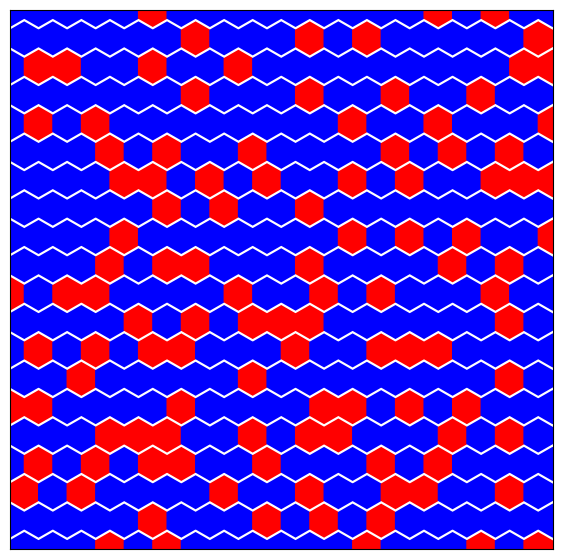

Evaluation 64 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.62it/s]


Completed. Saving
Time (s) to complete simulation 64: 68.1915020942688


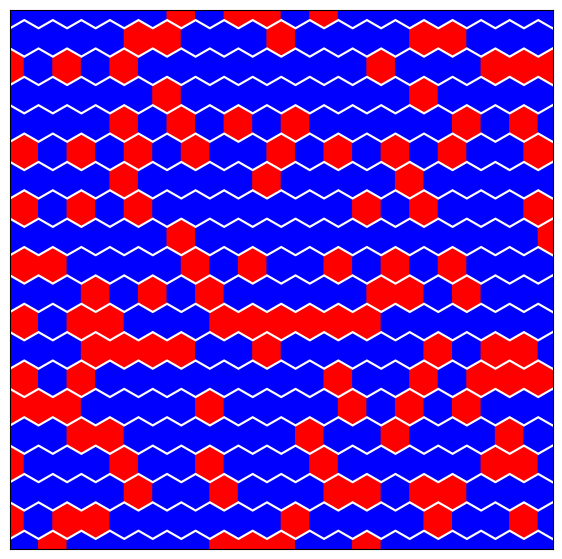

Evaluation 65 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.59it/s]


Completed. Saving
Time (s) to complete simulation 65: 68.48465394973755


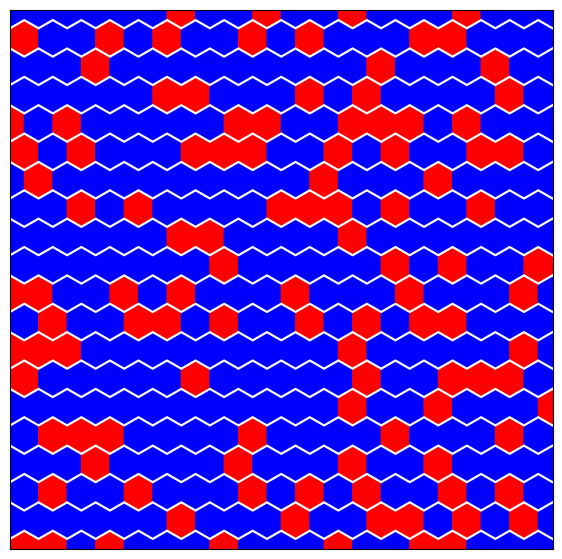

Evaluation 66 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.56it/s]

Completed. Saving
Time (s) to complete simulation 66: 70.19440817832947


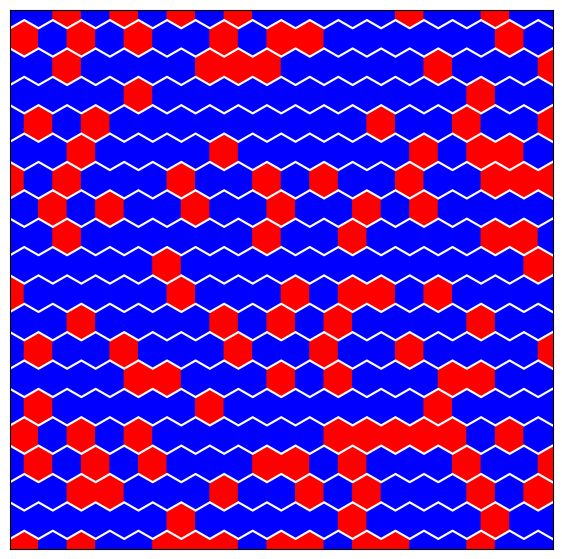

Evaluation 67 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.63it/s]


Completed. Saving
Time (s) to complete simulation 67: 69.09905815124512


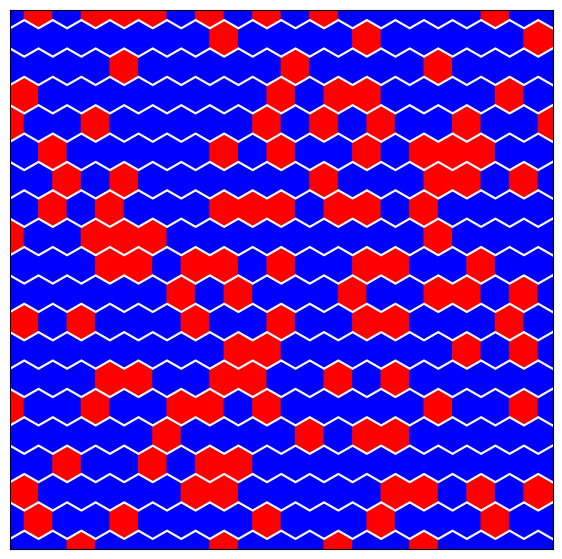

Evaluation 68 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.24it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.05it/s]


Completed. Saving
Time (s) to complete simulation 68: 71.14046931266785


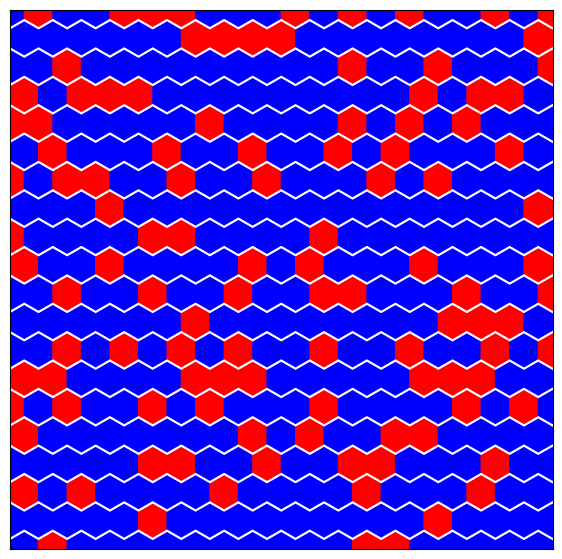

Evaluation 69 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.54it/s]


Completed. Saving
Time (s) to complete simulation 69: 68.44172382354736


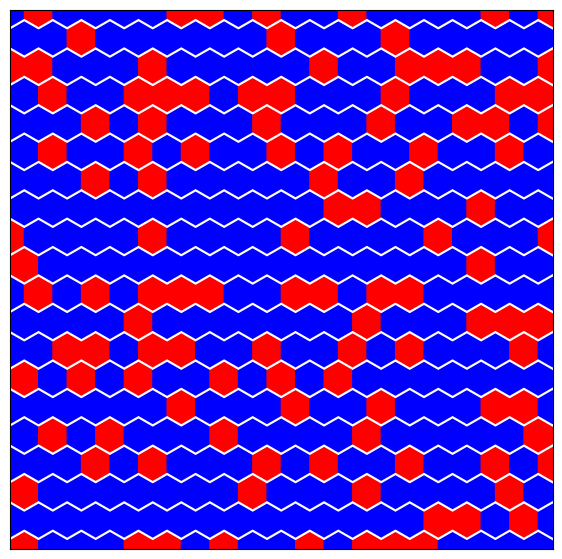

Evaluation 70 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.58it/s]


Completed. Saving
Time (s) to complete simulation 70: 68.64852905273438


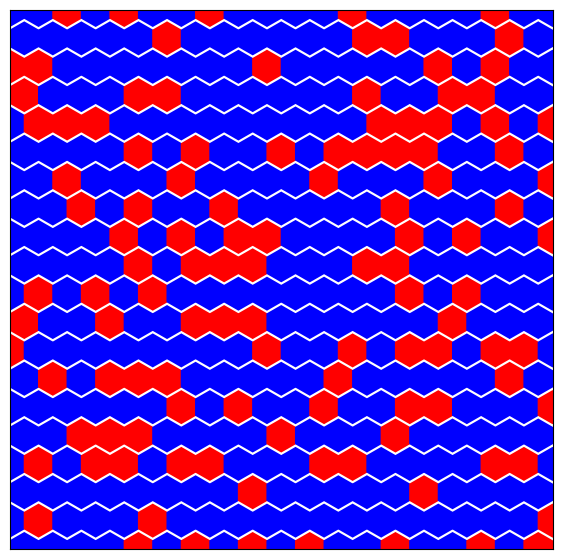

Evaluation 71 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.72it/s]


Completed. Saving
Time (s) to complete simulation 71: 69.68842935562134


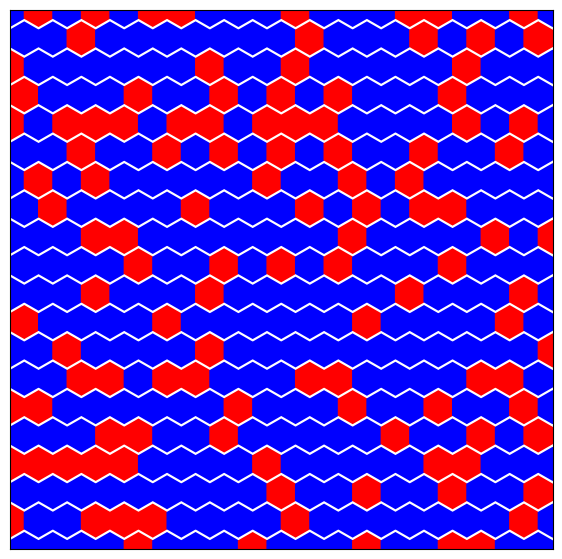

Evaluation 72 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.88it/s]


Completed. Saving
Time (s) to complete simulation 72: 68.13672399520874


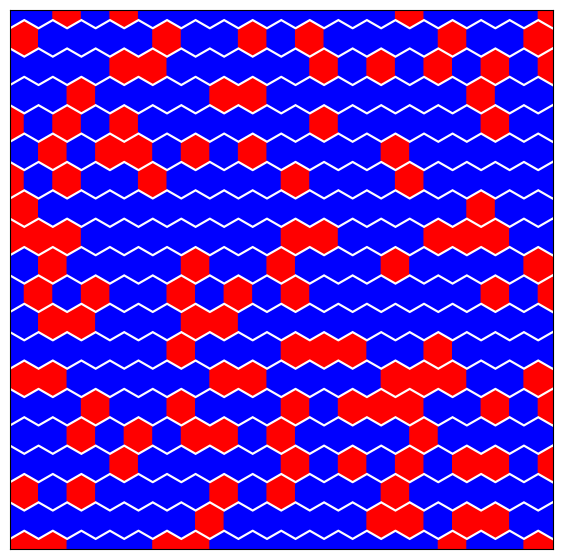

Evaluation 73 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 73: 70.06123876571655


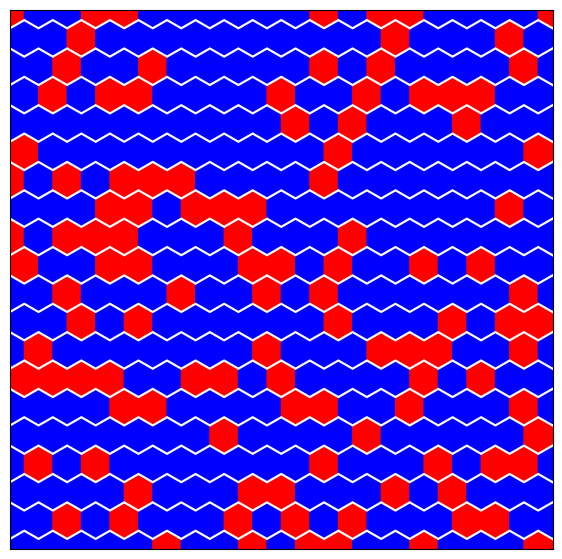

Evaluation 74 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.58it/s]


Completed. Saving
Time (s) to complete simulation 74: 68.58898735046387


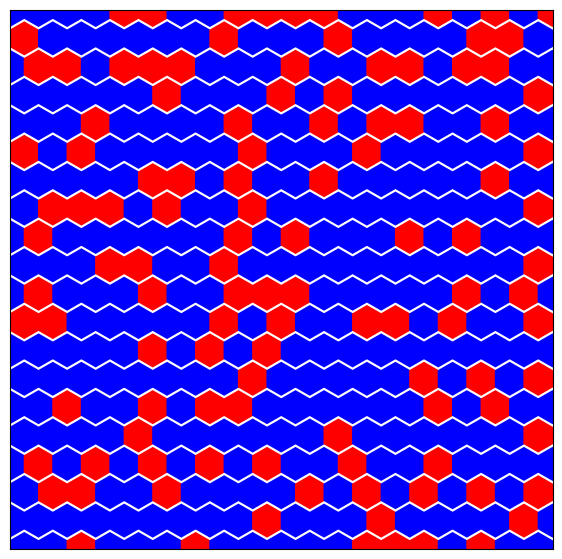

Evaluation 75 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.50it/s]


Completed. Saving
Time (s) to complete simulation 75: 68.65799117088318


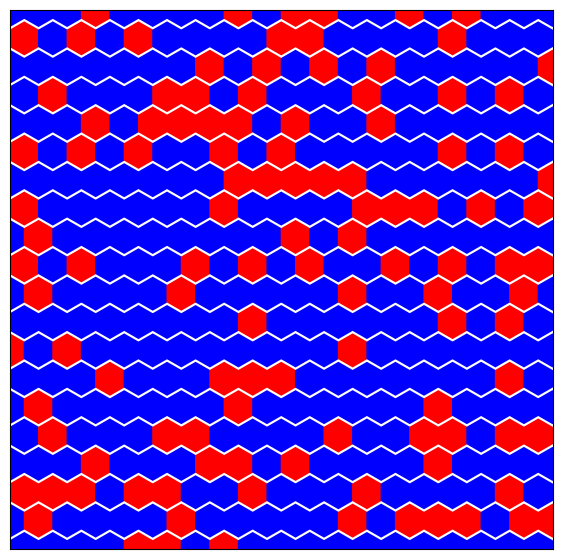

Evaluation 76 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.40it/s]


Completed. Saving
Time (s) to complete simulation 76: 69.84366226196289


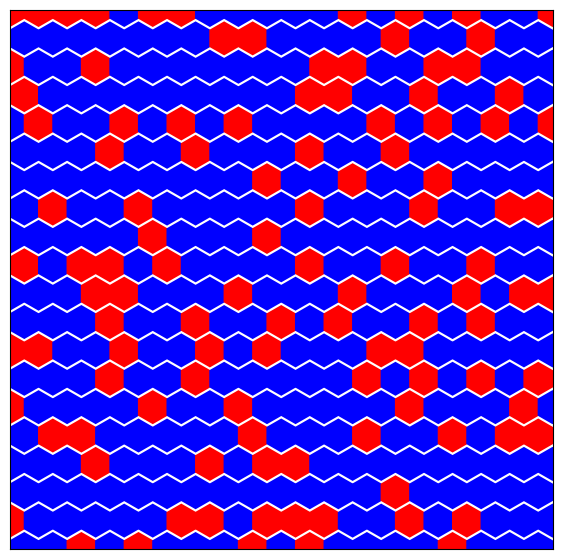

Evaluation 77 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.48it/s]


Completed. Saving
Time (s) to complete simulation 77: 69.8421938419342


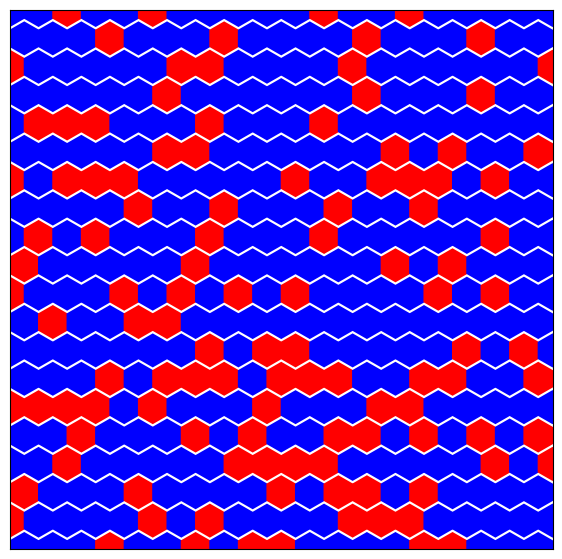

Evaluation 78 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.16it/s]


Completed. Saving
Time (s) to complete simulation 78: 69.93041014671326


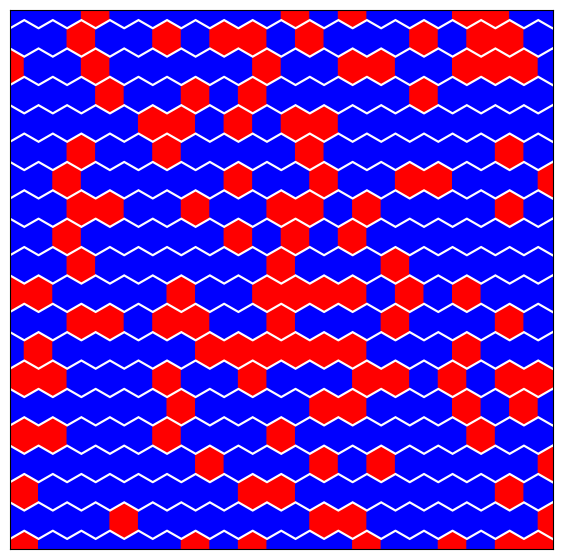

Evaluation 79 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.47it/s]


Completed. Saving
Time (s) to complete simulation 79: 68.92410278320312


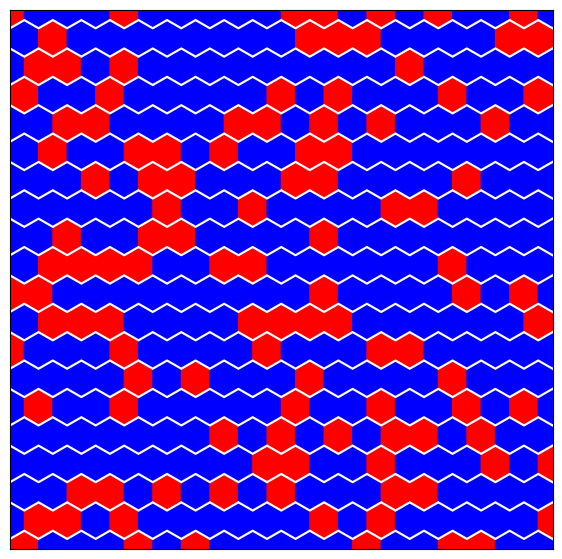

Evaluation 80 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.48it/s]


Completed. Saving
Time (s) to complete simulation 80: 69.58618903160095


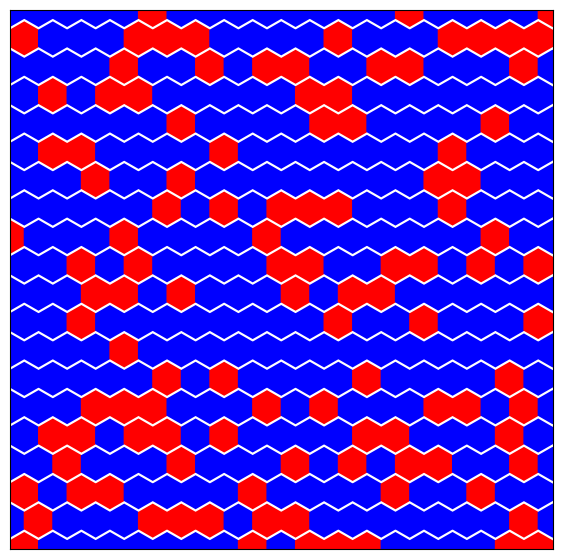

Evaluation 81 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.46it/s]


Completed. Saving
Time (s) to complete simulation 81: 70.85266089439392


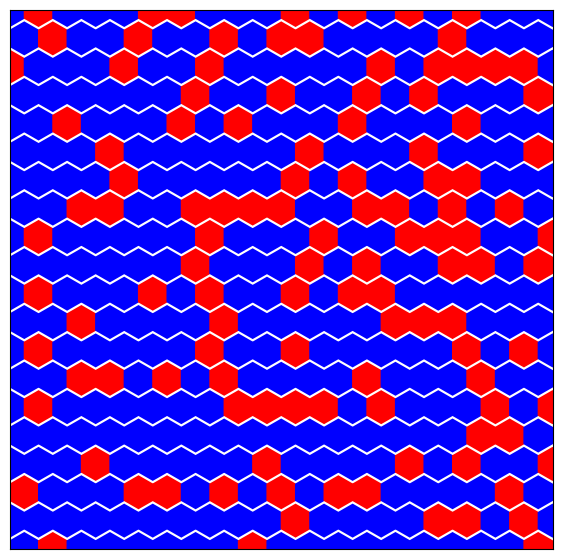

Evaluation 82 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.34it/s]


Completed. Saving
Time (s) to complete simulation 82: 69.82126355171204


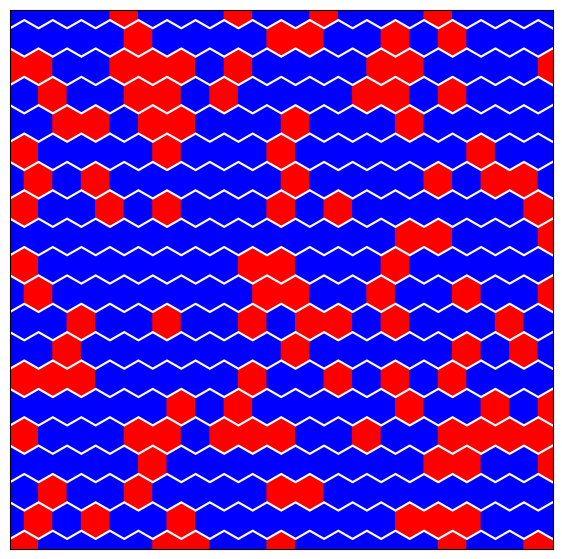

Evaluation 83 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.38it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.94it/s]


Completed. Saving
Time (s) to complete simulation 83: 71.1725561618805


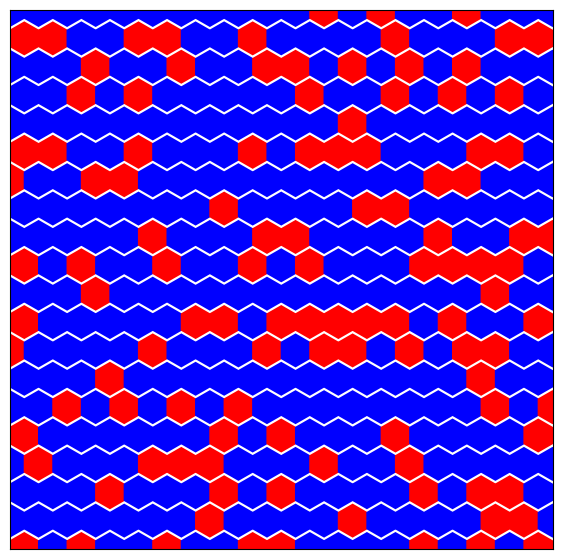

Evaluation 84 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.11it/s]


Completed. Saving
Time (s) to complete simulation 84: 70.60933017730713


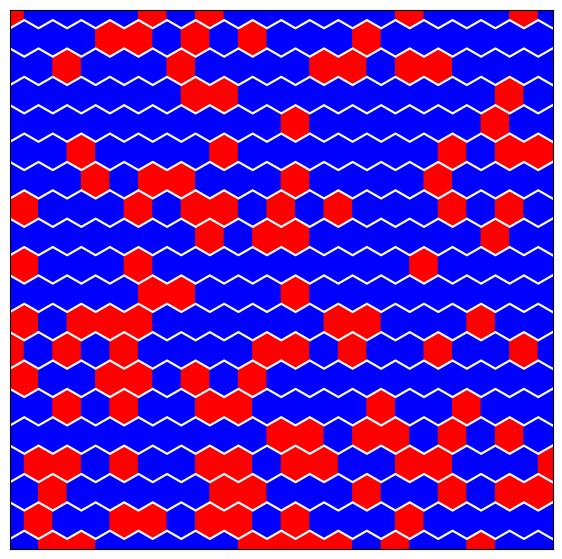

Evaluation 85 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.43it/s]

Completed. Saving
Time (s) to complete simulation 85: 70.26765394210815


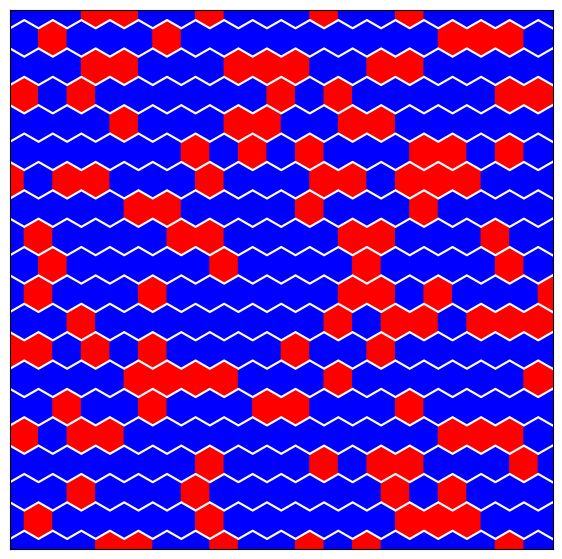

Evaluation 86 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.31it/s]


Completed. Saving
Time (s) to complete simulation 86: 71.20131945610046


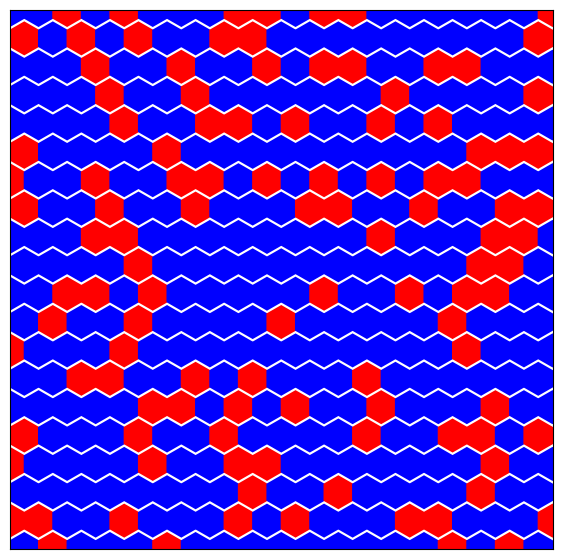

Evaluation 87 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.10it/s]


Completed. Saving
Time (s) to complete simulation 87: 70.65021800994873


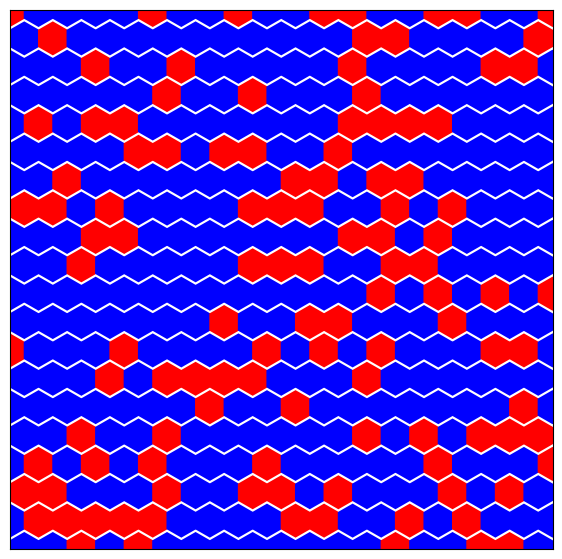

Evaluation 88 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.93it/s]


Completed. Saving
Time (s) to complete simulation 88: 70.94666981697083


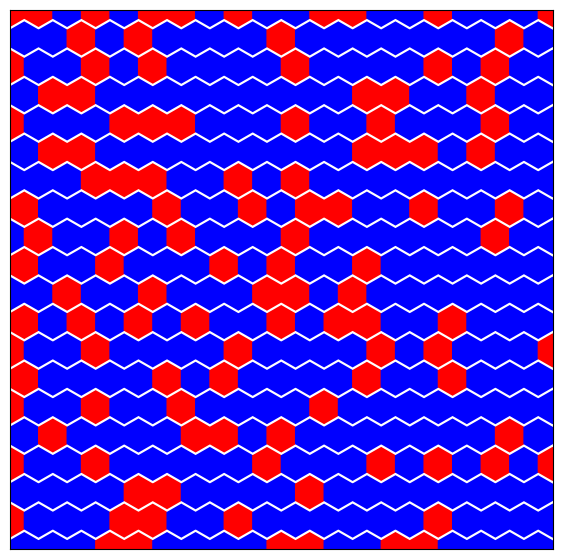

Evaluation 89 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.45it/s]

Completed. Saving
Time (s) to complete simulation 89: 70.24929714202881


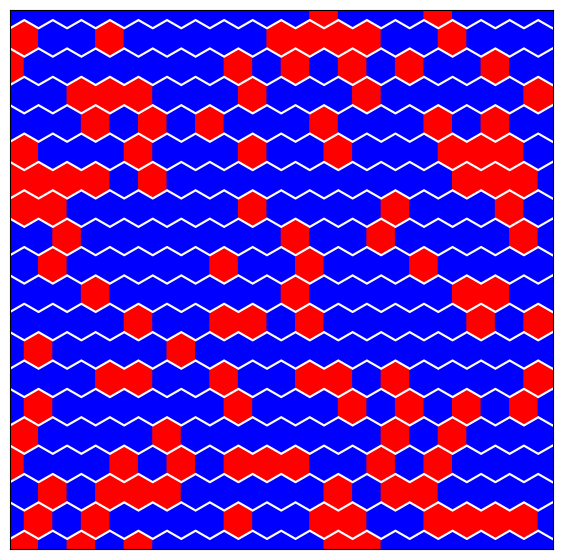

Evaluation 90 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.38it/s]


Completed. Saving
Time (s) to complete simulation 90: 70.01069593429565


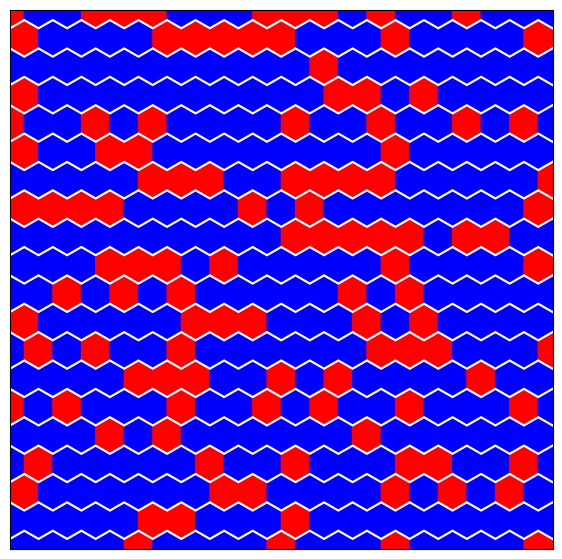

Evaluation 91 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.22it/s]


Completed. Saving
Time (s) to complete simulation 91: 71.12479162216187


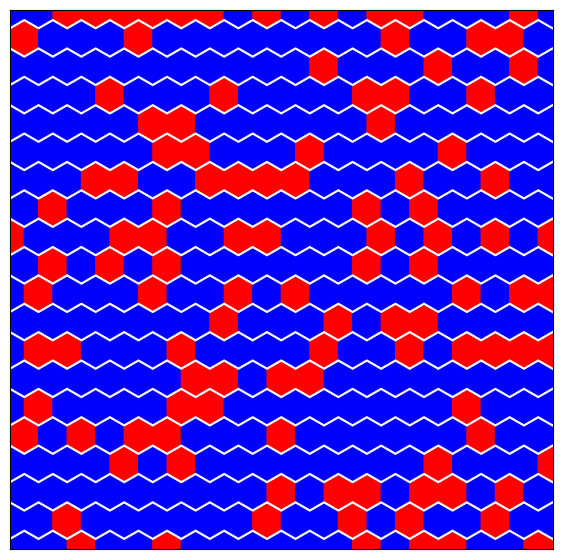

Evaluation 92 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.10it/s]


Completed. Saving
Time (s) to complete simulation 92: 70.58828949928284


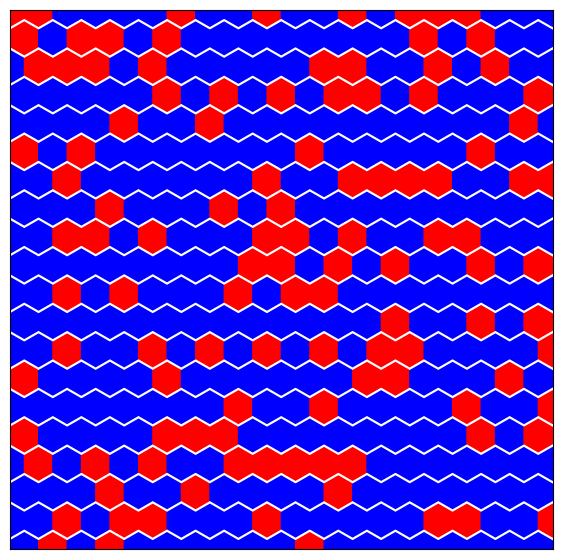

Evaluation 93 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.55it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.26it/s]


Completed. Saving
Time (s) to complete simulation 93: 69.8978807926178


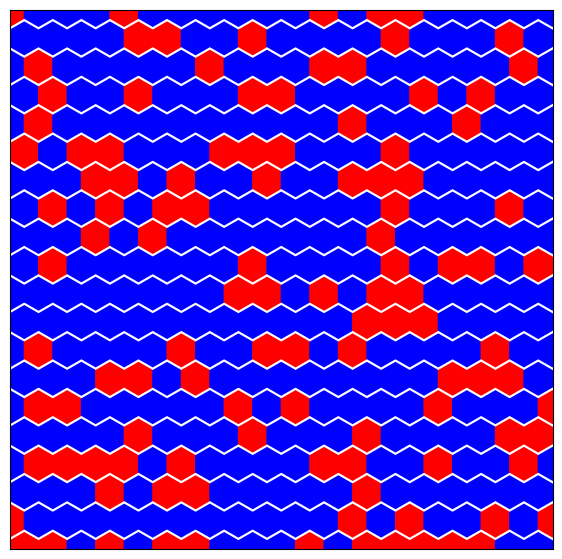

Evaluation 94 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.50it/s]

Completed. Saving
Time (s) to complete simulation 94: 70.15079760551453


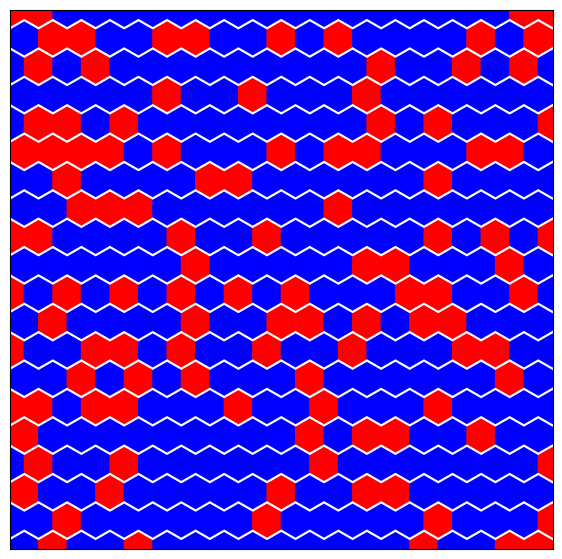

Evaluation 95 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 95: 70.51565909385681


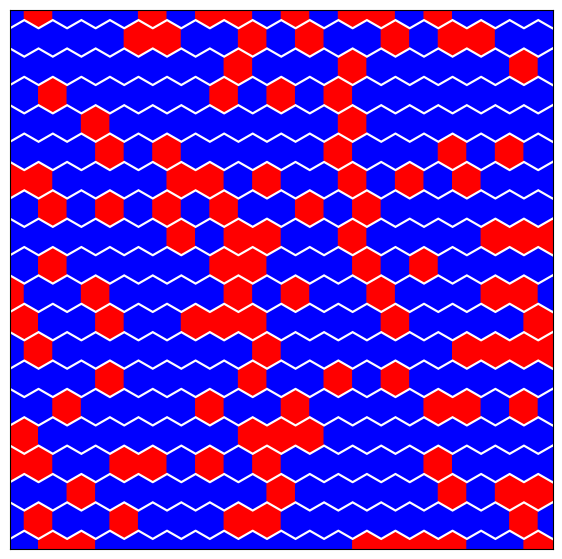

Evaluation 96 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.01it/s]


Completed. Saving
Time (s) to complete simulation 96: 70.88618540763855


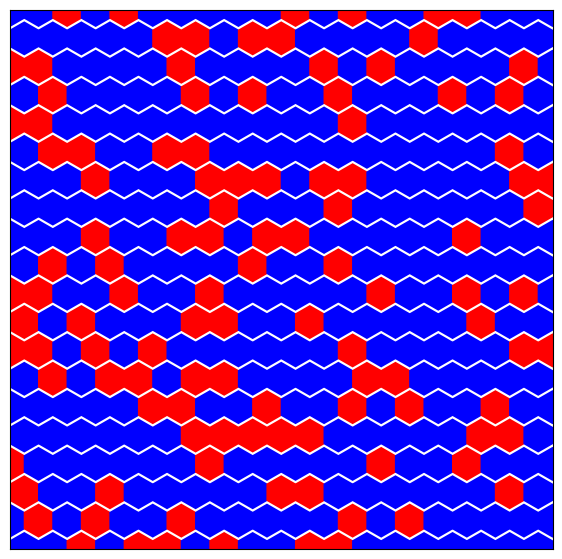

Evaluation 97 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.56it/s]


Completed. Saving
Time (s) to complete simulation 97: 68.17486929893494


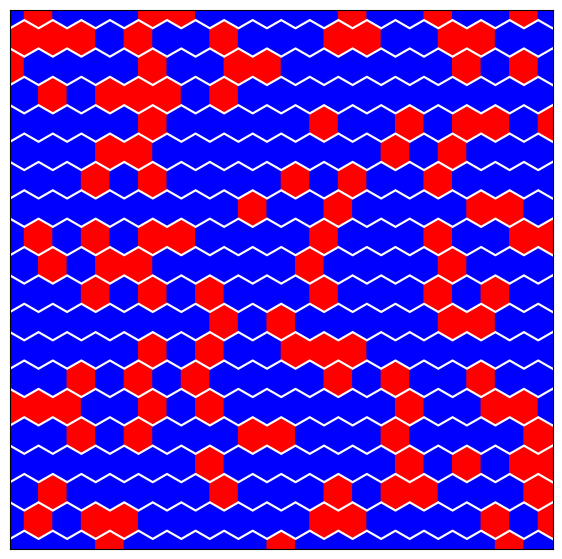

Evaluation 98 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.31it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.47it/s]

Completed. Saving
Time (s) to complete simulation 98: 69.79146957397461


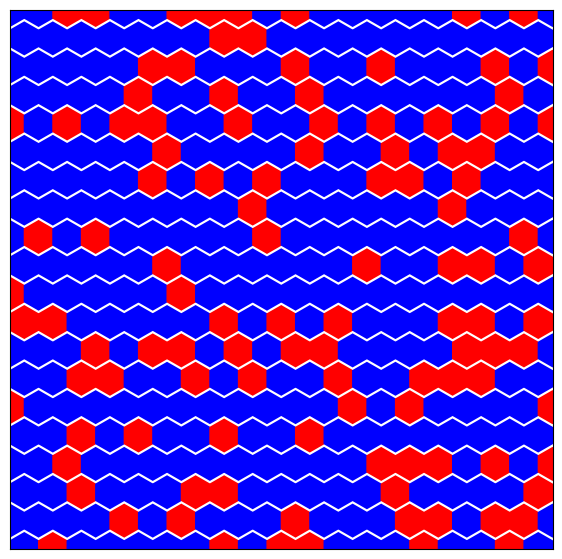

Evaluation 99 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.55it/s]


Completed. Saving
Time (s) to complete simulation 99: 70.26317286491394


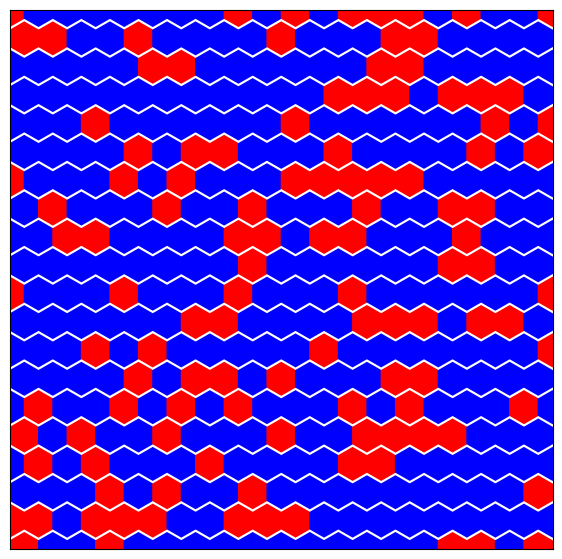

Evaluation 100 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.31it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.48it/s]

Completed. Saving
Time (s) to complete simulation 100: 69.77473783493042


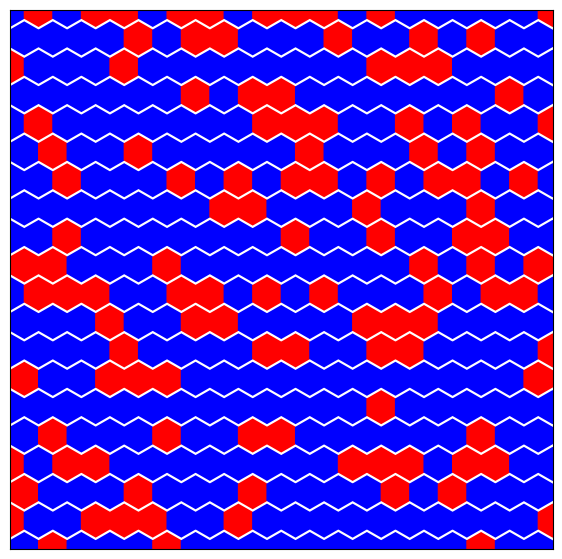

Evaluation 101 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.93it/s]


Completed. Saving
Time (s) to complete simulation 101: 71.47692346572876


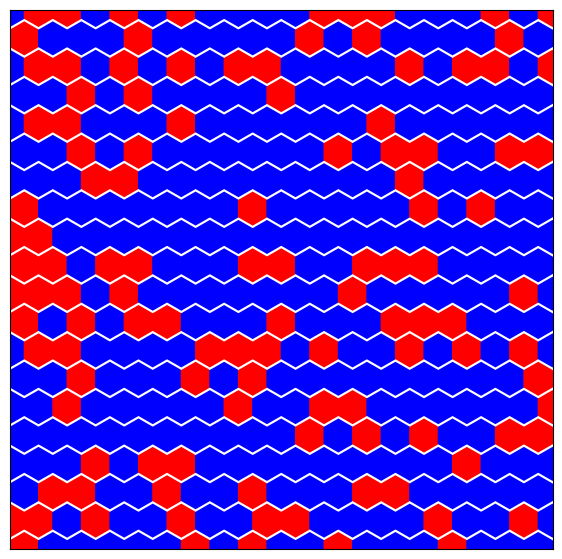

Evaluation 102 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.31it/s]


Completed. Saving
Time (s) to complete simulation 102: 69.82099294662476


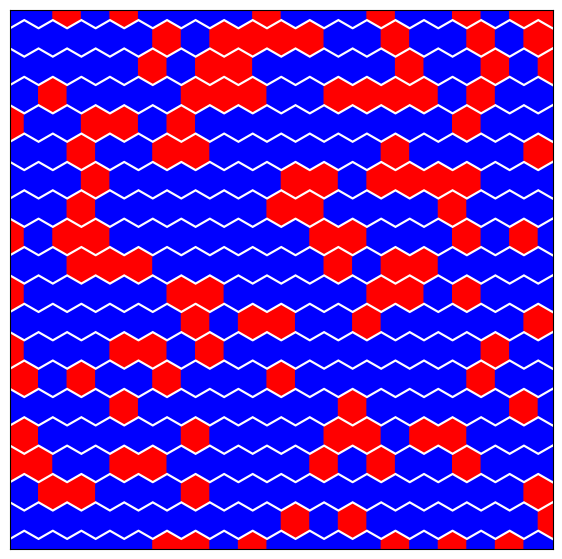

Evaluation 103 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.31it/s]


Completed. Saving
Time (s) to complete simulation 103: 70.26420593261719


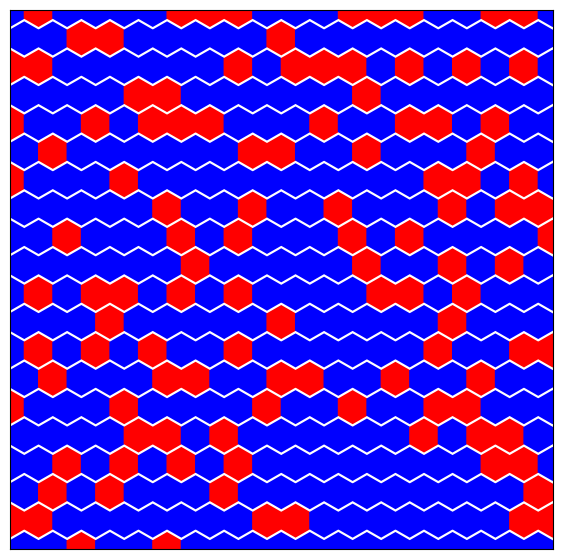

Evaluation 104 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.53it/s]


Completed. Saving
Time (s) to complete simulation 104: 70.43759679794312


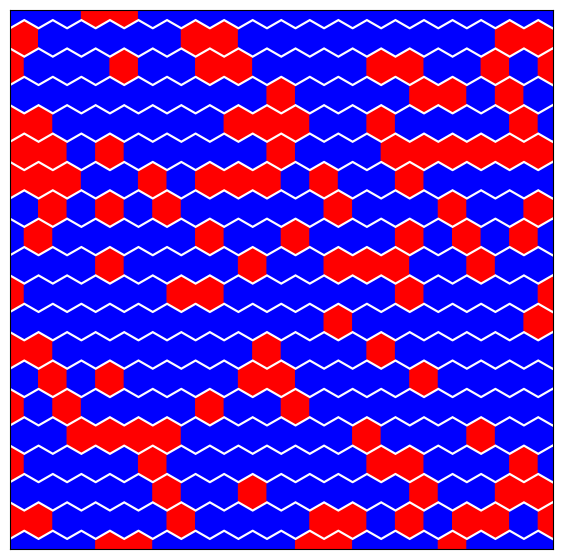

Evaluation 105 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.41it/s]


Completed. Saving
Time (s) to complete simulation 105: 69.96494793891907


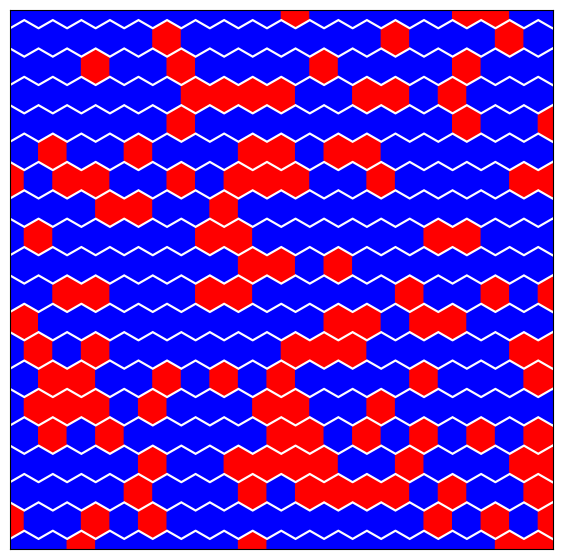

Evaluation 106 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.59it/s]


Completed. Saving
Time (s) to complete simulation 106: 68.62150716781616


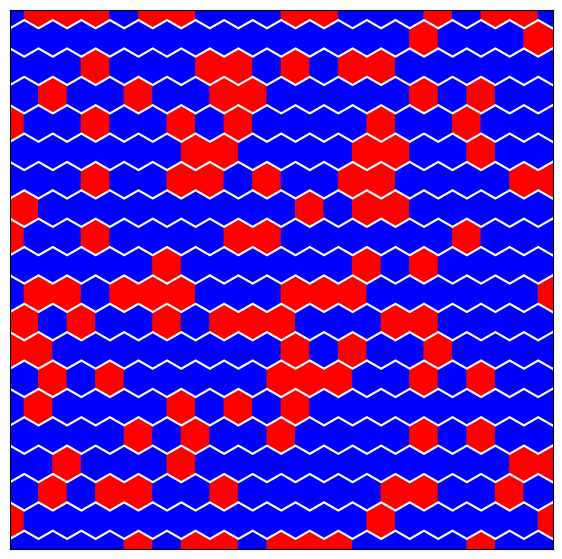

Evaluation 107 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.23it/s]


Completed. Saving
Time (s) to complete simulation 107: 70.65269422531128


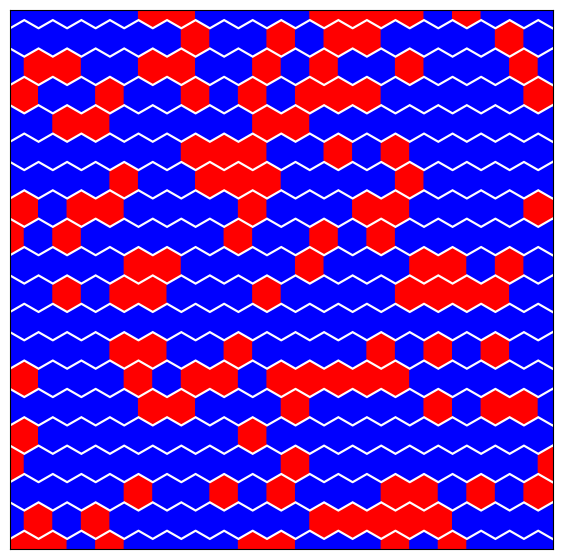

Evaluation 108 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 108: 70.13088154792786


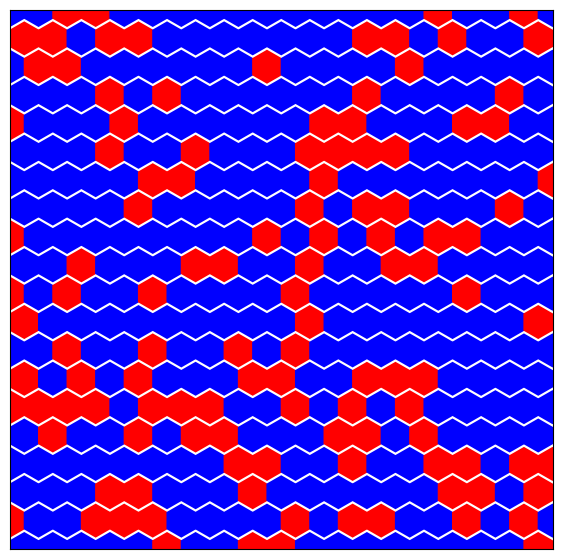

Evaluation 109 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.32it/s]


Completed. Saving
Time (s) to complete simulation 109: 70.64266228675842


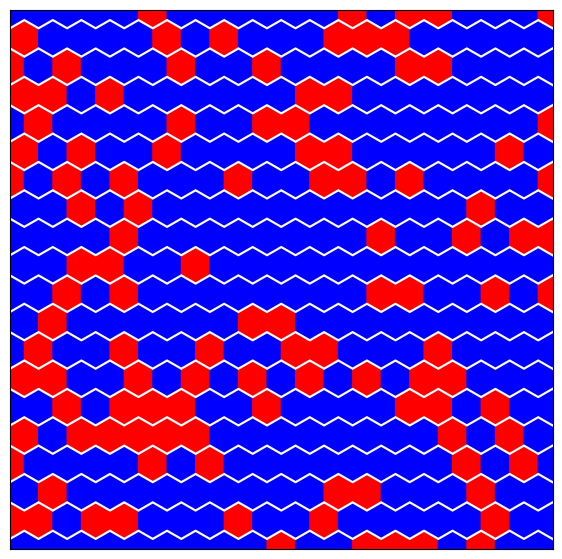

Evaluation 110 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.55it/s]


Completed. Saving
Time (s) to complete simulation 110: 70.13321590423584


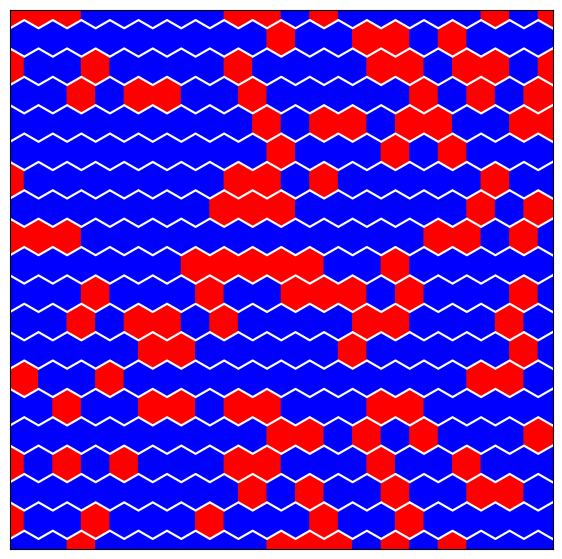

Evaluation 111 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.36it/s]


Completed. Saving
Time (s) to complete simulation 111: 69.62914276123047


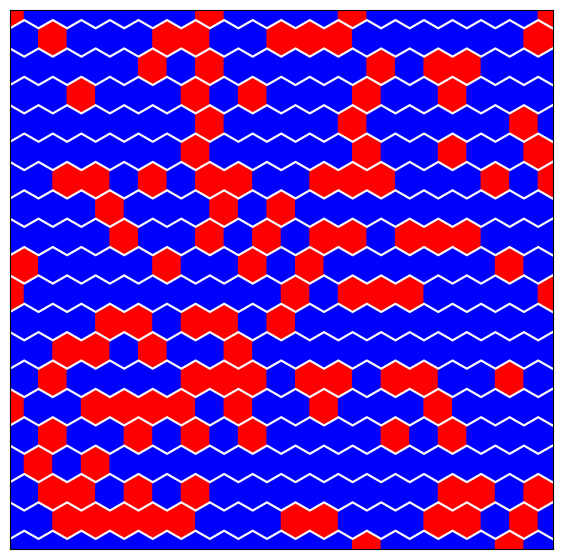

Evaluation 112 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.37it/s]


Completed. Saving
Time (s) to complete simulation 112: 70.2831163406372


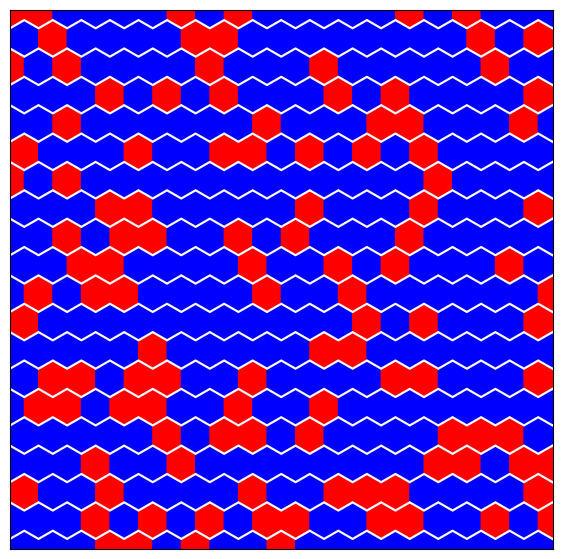

Evaluation 113 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.44it/s]


Completed. Saving
Time (s) to complete simulation 113: 71.29773879051208


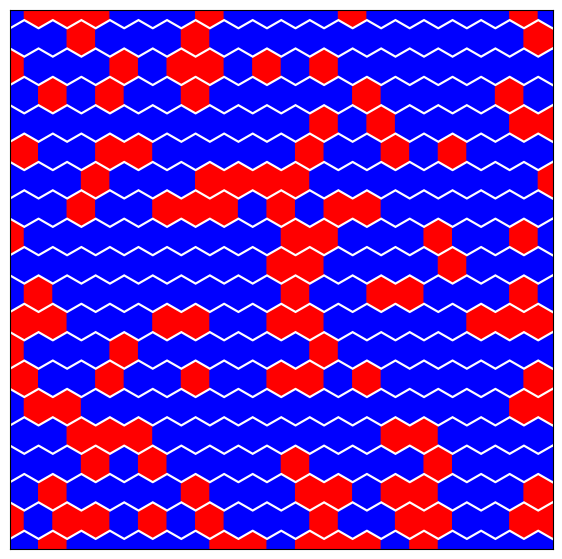

Evaluation 114 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.99it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 114: 71.25778532028198


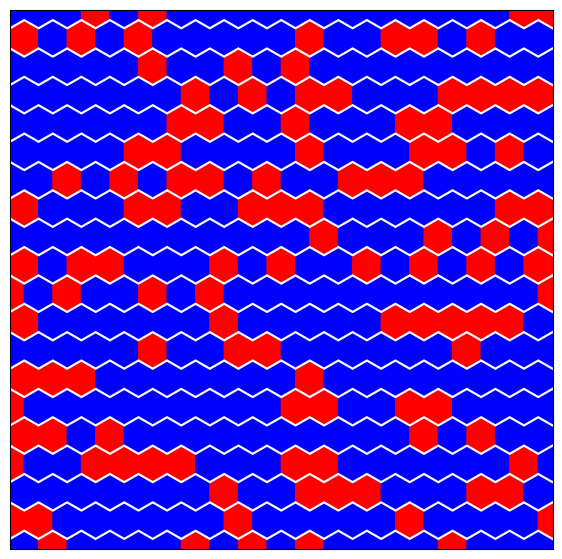

Evaluation 115 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.94it/s]

Completed. Saving
Time (s) to complete simulation 115: 70.61090302467346


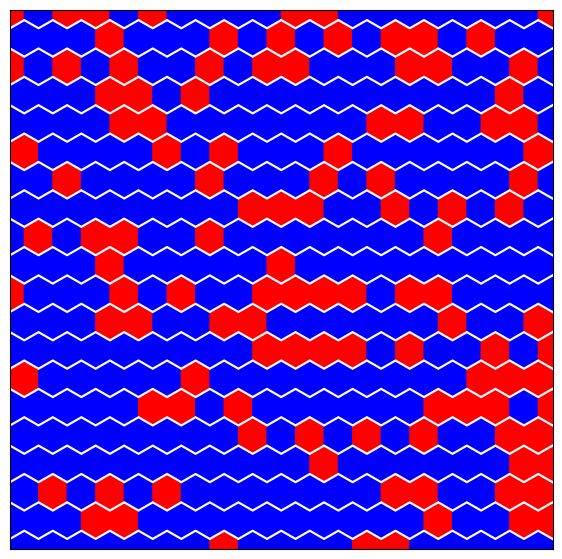

Evaluation 116 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.31it/s]


Completed. Saving
Time (s) to complete simulation 116: 69.50780200958252


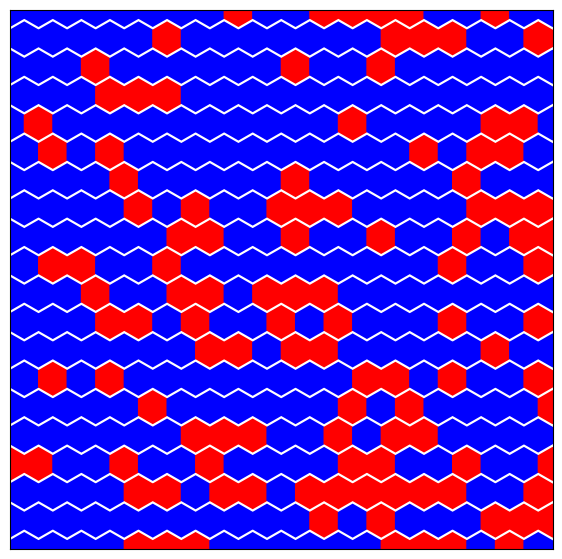

Evaluation 117 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.08it/s]

Completed. Saving
Time (s) to complete simulation 117: 70.12461233139038


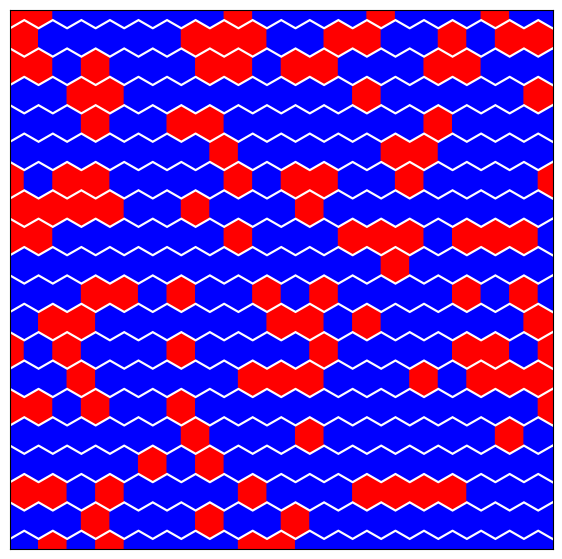

Evaluation 118 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.03it/s]

Completed. Saving
Time (s) to complete simulation 118: 73.02425861358643


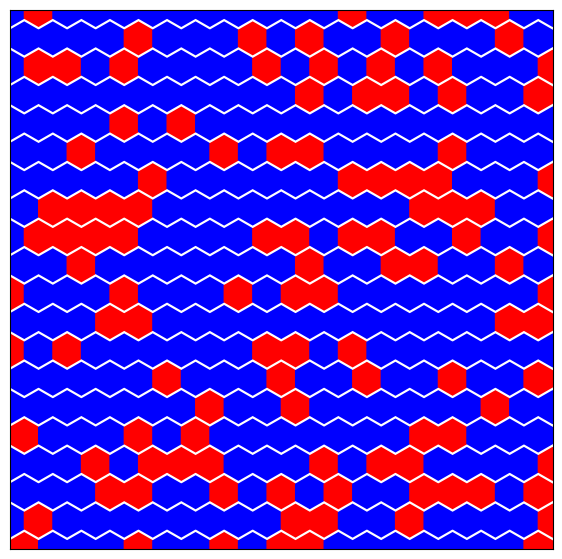

Evaluation 119 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 119: 69.85997033119202


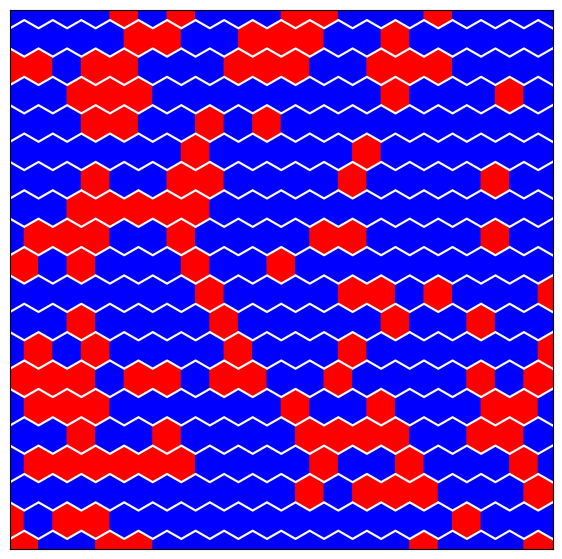

Evaluation 120 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:39<00:00, 12.61it/s]

Completed. Saving
Time (s) to complete simulation 120: 72.14517021179199


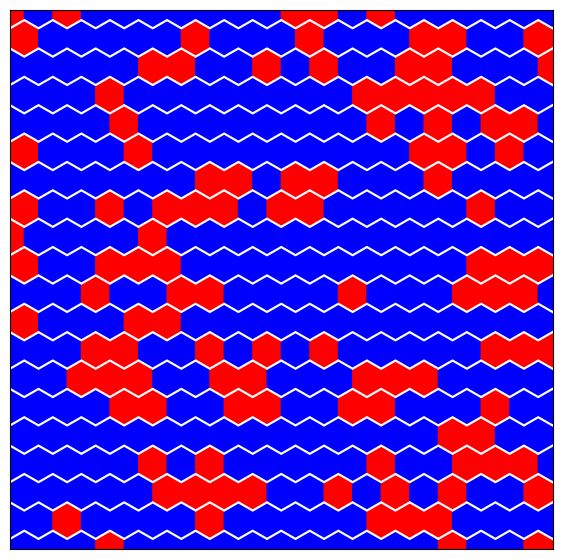

Evaluation 121 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.61it/s]


Completed. Saving
Time (s) to complete simulation 121: 70.43928170204163


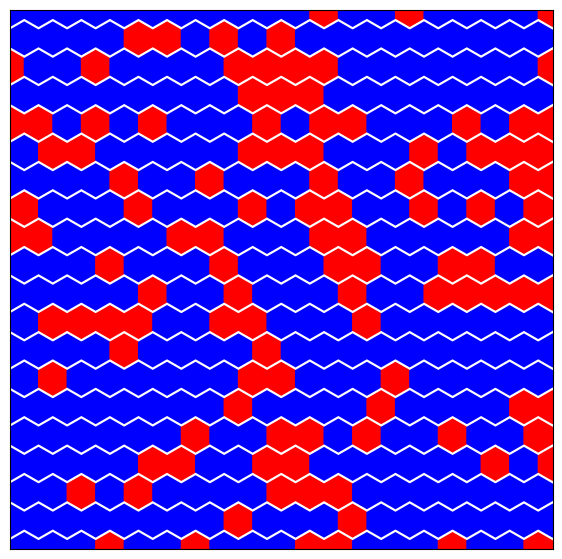

Evaluation 122 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.25it/s]


Completed. Saving
Time (s) to complete simulation 122: 70.91320848464966


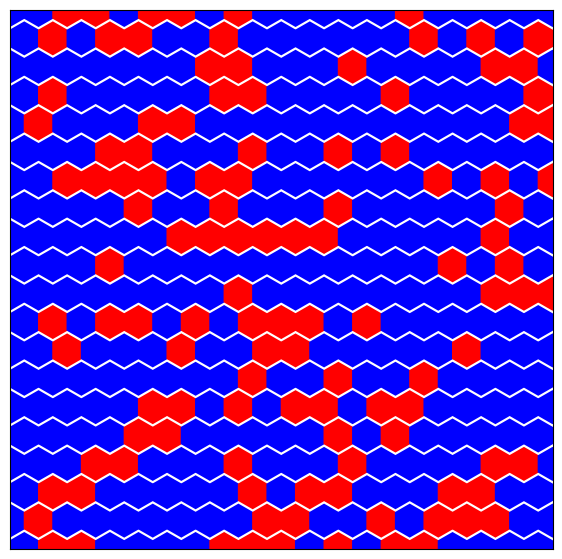

Evaluation 123 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.07it/s]

Completed. Saving
Time (s) to complete simulation 123: 71.45596551895142


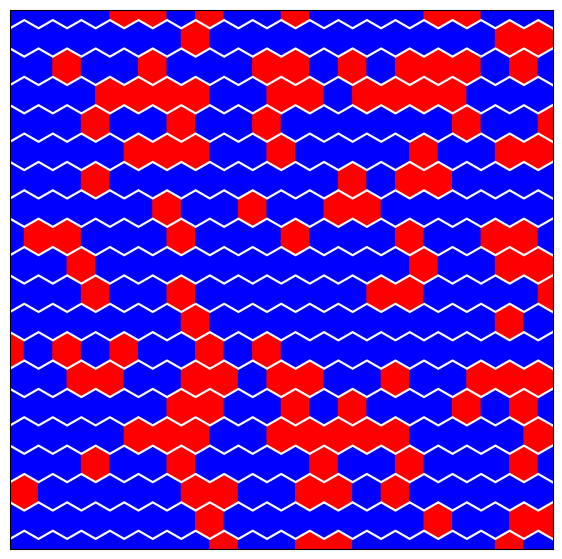

Evaluation 124 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.29it/s]


Completed. Saving
Time (s) to complete simulation 124: 69.39864873886108


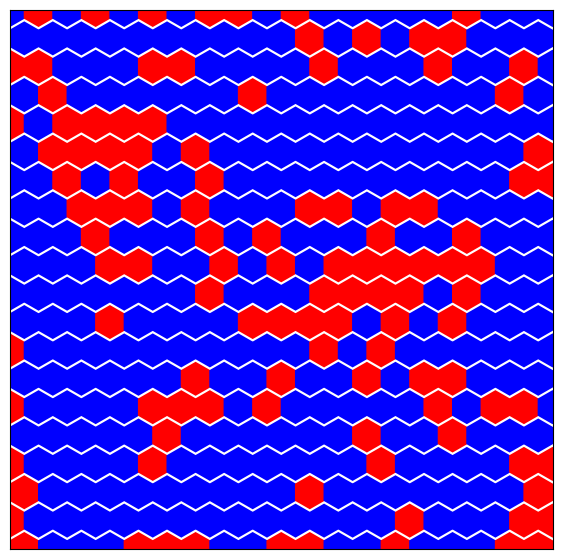

Evaluation 125 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.04it/s]

Completed. Saving
Time (s) to complete simulation 125: 70.91000699996948


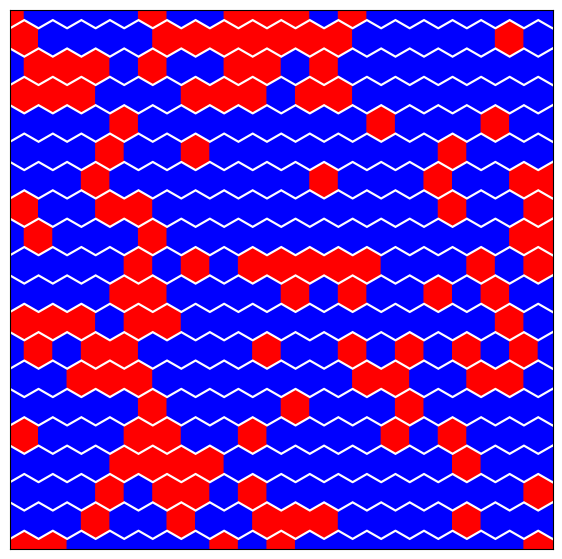

Evaluation 126 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.64it/s]


Completed. Saving
Time (s) to complete simulation 126: 69.52687644958496


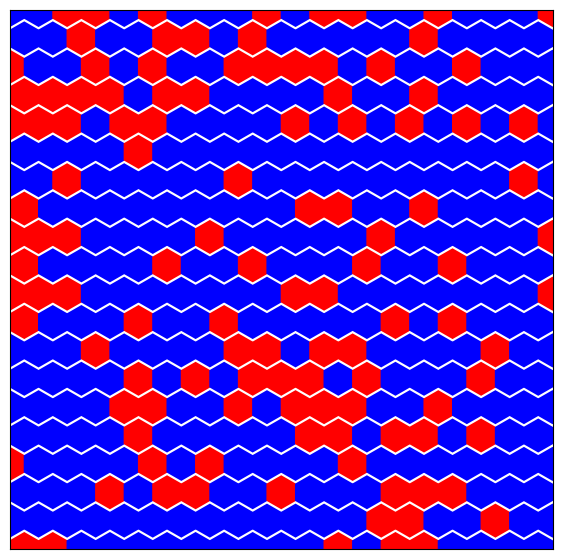

Evaluation 127 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.46it/s]


Completed. Saving
Time (s) to complete simulation 127: 70.8407723903656


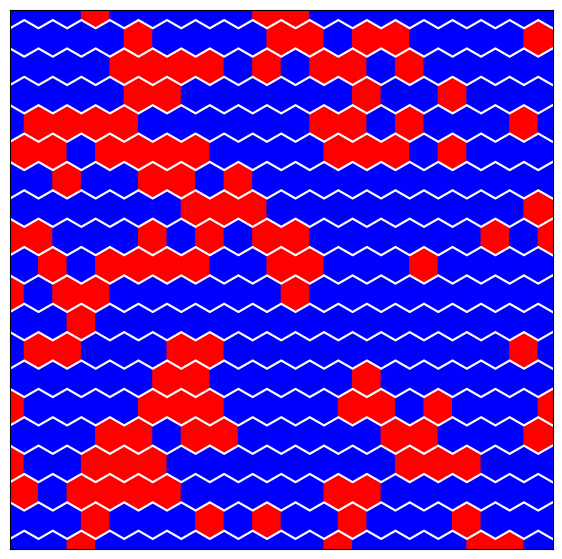

Evaluation 128 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.30it/s]


Completed. Saving
Time (s) to complete simulation 128: 72.21809911727905


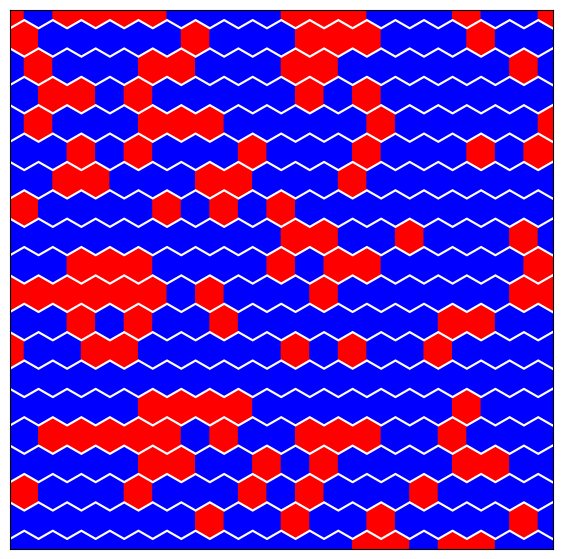

Evaluation 129 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.03it/s]


Completed. Saving
Time (s) to complete simulation 129: 70.46686935424805


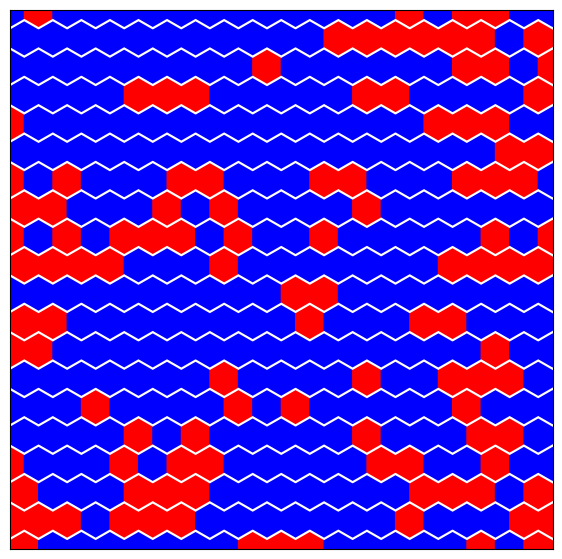

Evaluation 130 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.92it/s]

Completed. Saving
Time (s) to complete simulation 130: 72.42145776748657


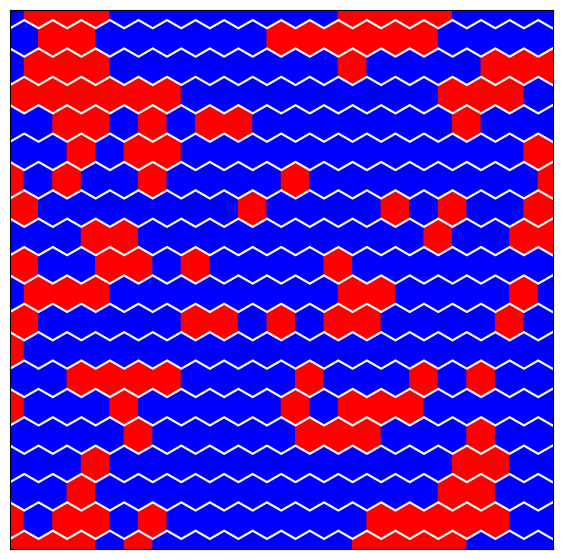

Evaluation 131 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.94it/s]


Completed. Saving
Time (s) to complete simulation 131: 71.42965936660767


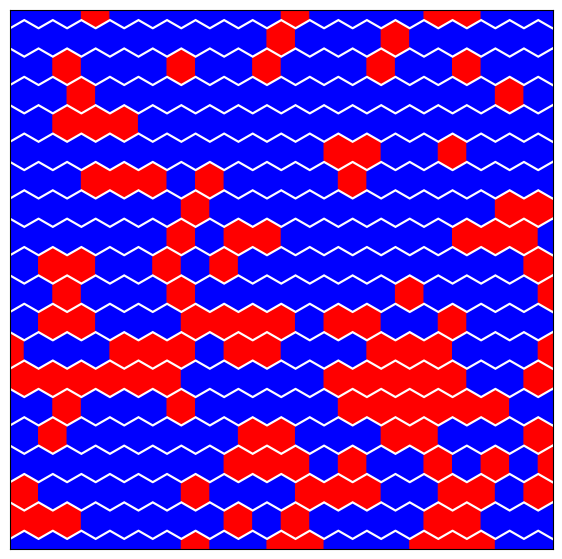

Evaluation 132 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.08it/s]


Completed. Saving
Time (s) to complete simulation 132: 70.8441870212555


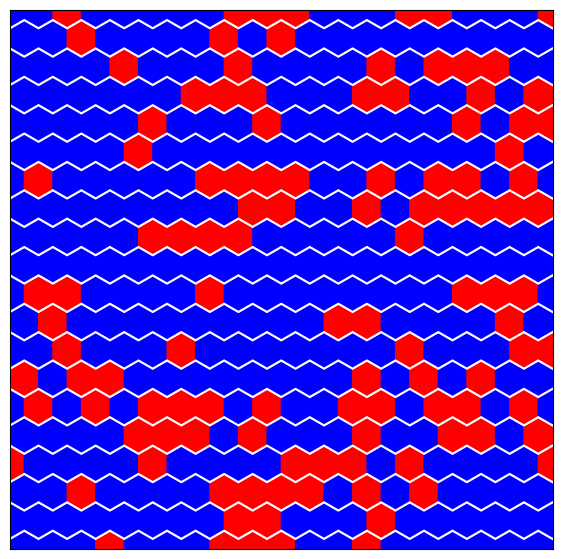

Evaluation 133 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.33it/s]

Completed. Saving
Time (s) to complete simulation 133: 71.00097990036011


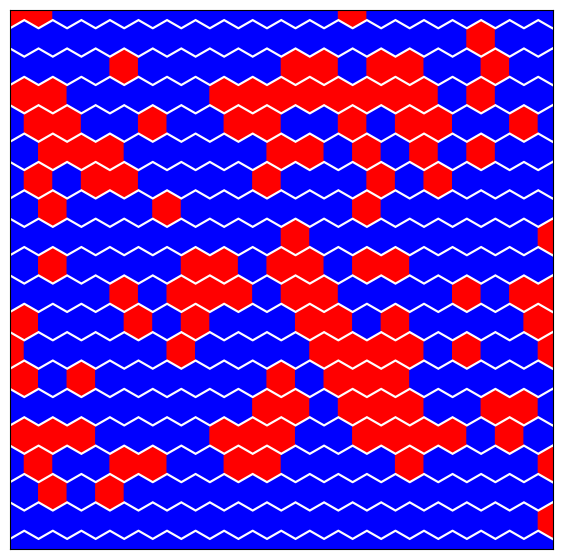

Evaluation 134 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.46it/s]


Completed. Saving
Time (s) to complete simulation 134: 70.33576893806458


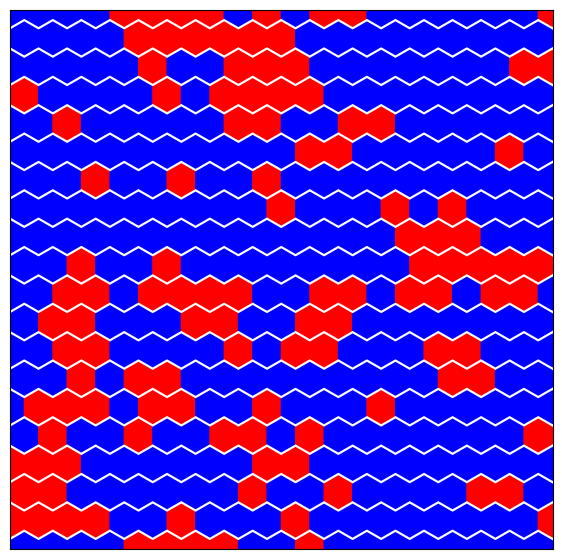

Evaluation 135 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.85it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.09it/s]


Completed. Saving
Time (s) to complete simulation 135: 71.88932299613953


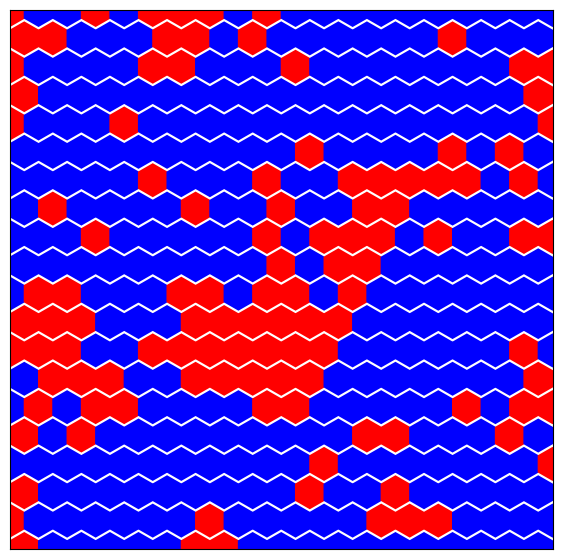

Evaluation 136 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.25it/s]


Completed. Saving
Time (s) to complete simulation 136: 70.46825909614563


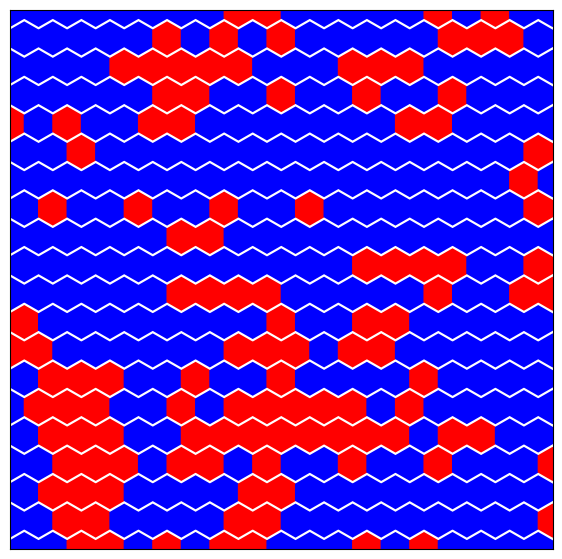

Evaluation 137 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.46it/s]


Completed. Saving
Time (s) to complete simulation 137: 69.64117288589478


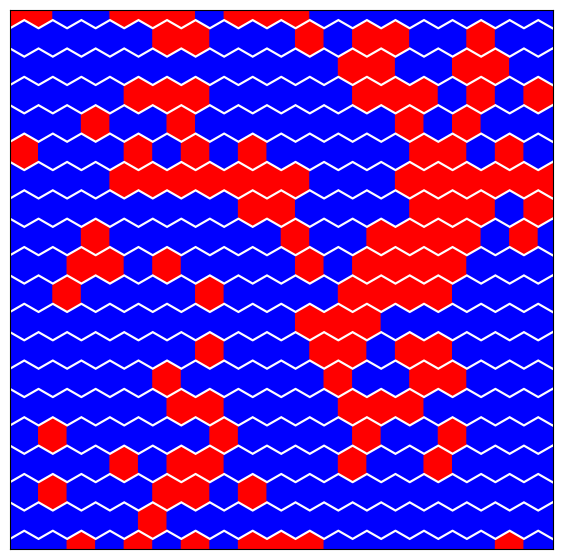

Evaluation 138 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.85it/s]

Completed. Saving
Time (s) to complete simulation 138: 70.64101696014404


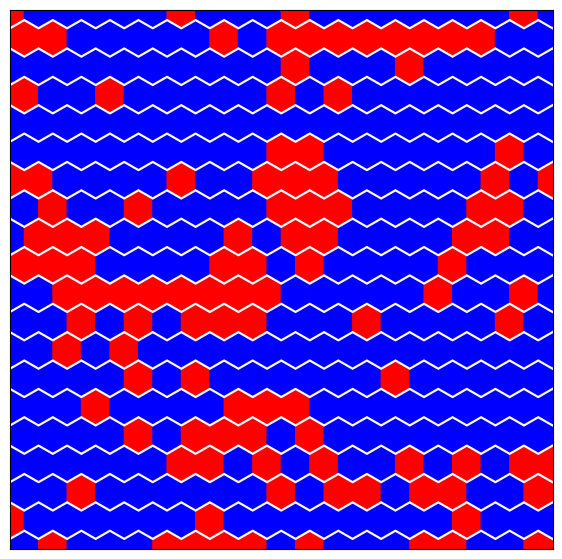

Evaluation 139 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.75it/s]


Completed. Saving
Time (s) to complete simulation 139: 69.40371417999268


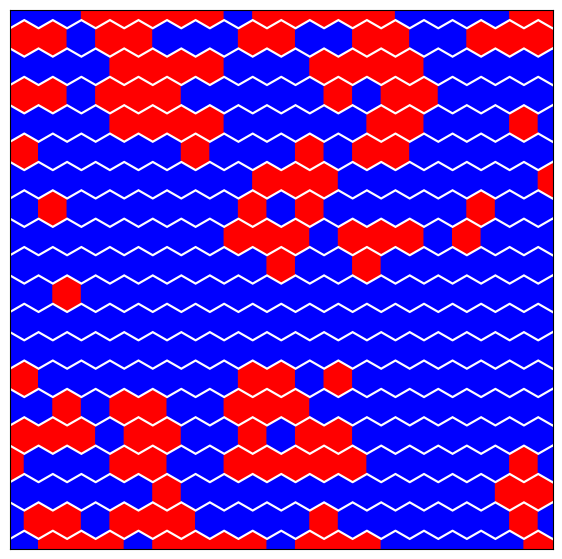

Evaluation 140 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.41it/s]


Completed. Saving
Time (s) to complete simulation 140: 70.14887738227844


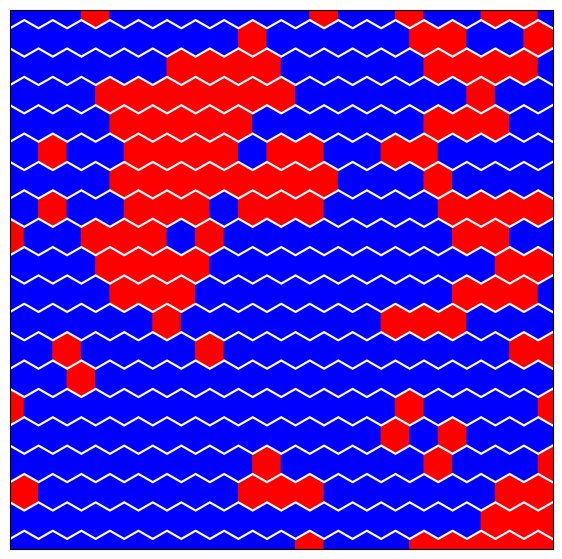

Evaluation 141 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.34it/s]


Completed. Saving
Time (s) to complete simulation 141: 70.31009483337402


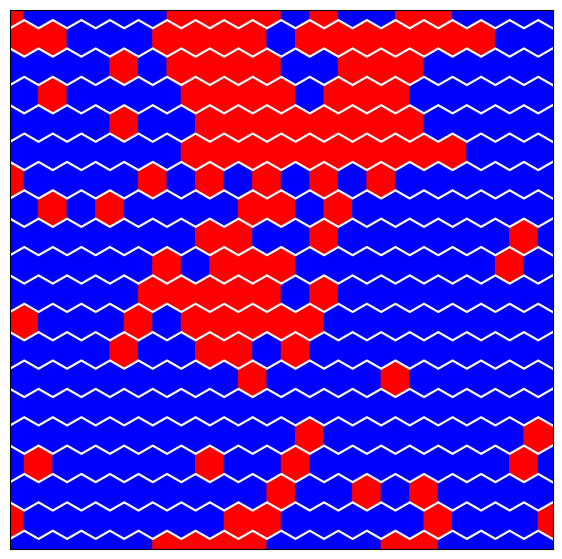

Evaluation 142 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.76it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.24it/s]


Completed. Saving
Time (s) to complete simulation 142: 69.51103091239929


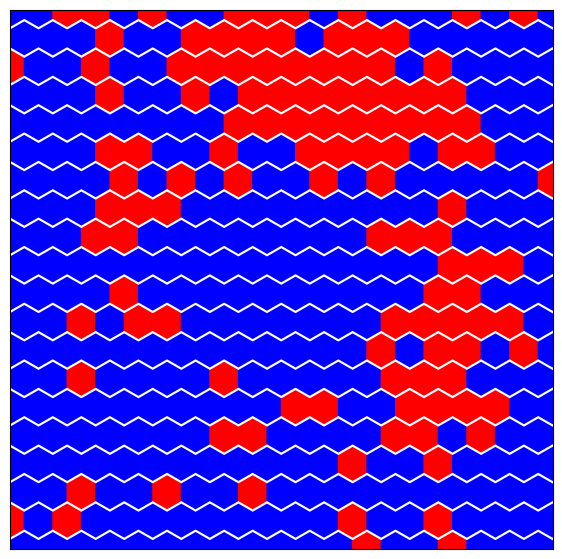

Evaluation 143 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:39<00:00, 12.68it/s]

Completed. Saving
Time (s) to complete simulation 143: 71.69099450111389


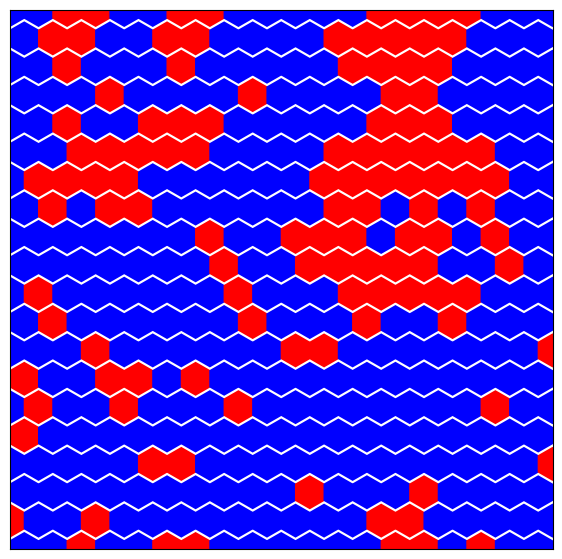

Evaluation 144 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.62it/s]

Completed. Saving
Time (s) to complete simulation 144: 70.28087711334229


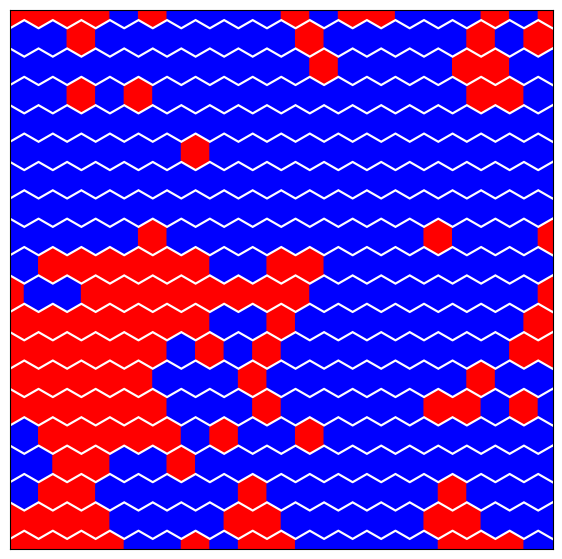

Evaluation 145 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.49it/s]


Completed. Saving
Time (s) to complete simulation 145: 69.40396237373352


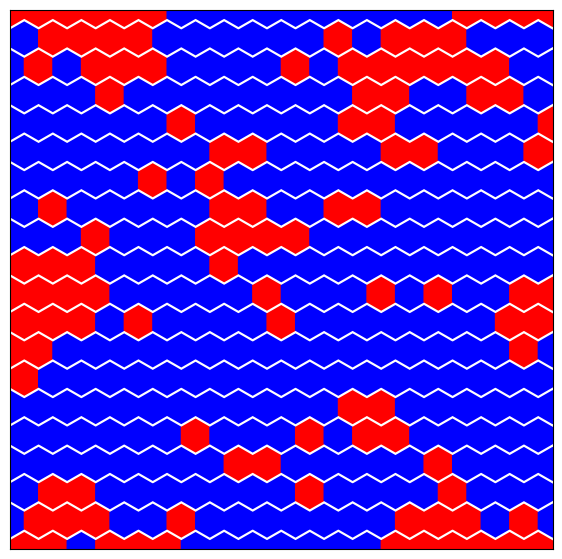

Evaluation 146 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.57it/s]


Completed. Saving
Time (s) to complete simulation 146: 68.79620671272278


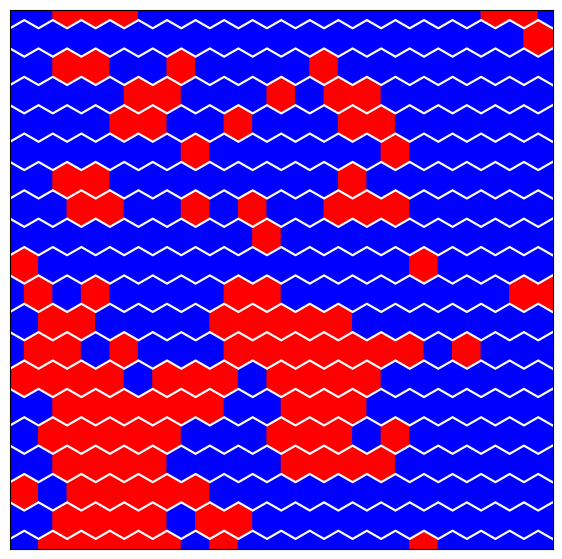

Evaluation 147 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.00it/s]


Completed. Saving
Time (s) to complete simulation 147: 70.2380485534668


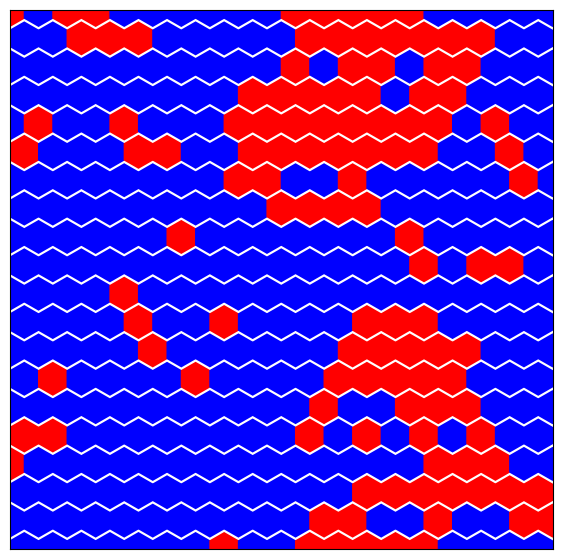

Evaluation 148 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:39<00:00, 12.66it/s]


Completed. Saving
Time (s) to complete simulation 148: 71.23782801628113


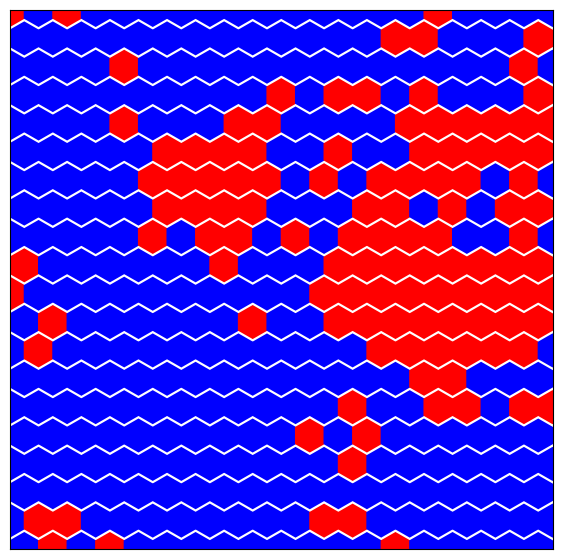

Evaluation 149 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.69it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.48it/s]


Completed. Saving
Time (s) to complete simulation 149: 68.95436429977417


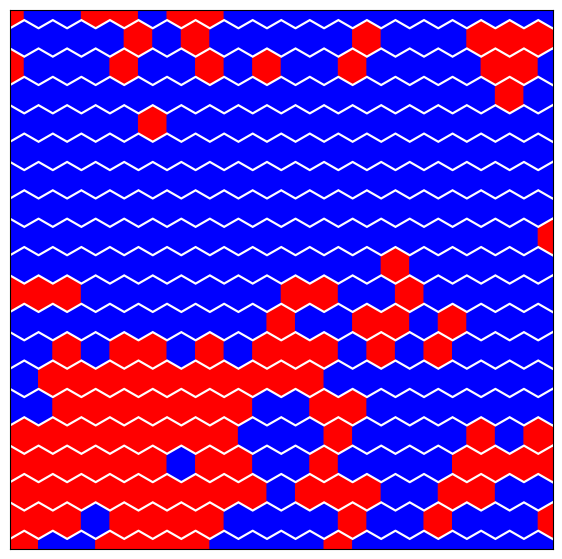

Evaluation 150 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.74it/s]


Completed. Saving
Time (s) to complete simulation 150: 69.18785214424133


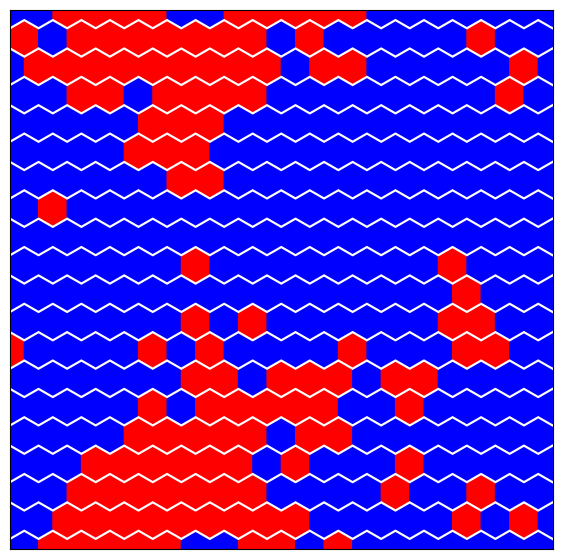

Evaluation 151 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.20it/s]


Completed. Saving
Time (s) to complete simulation 151: 71.68782329559326


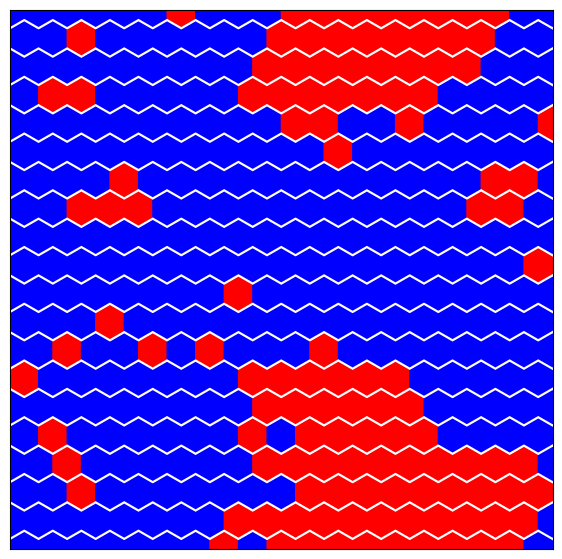

Evaluation 152 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.78it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.27it/s]

Completed. Saving
Time (s) to complete simulation 152: 69.3707160949707


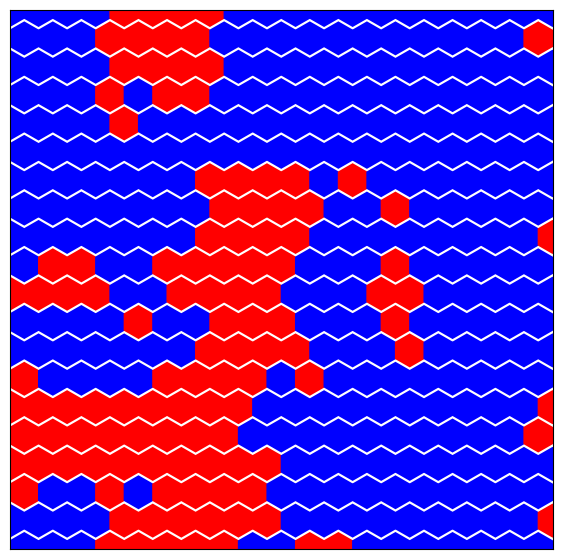

Evaluation 153 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.15it/s]


Completed. Saving
Time (s) to complete simulation 153: 69.40450954437256


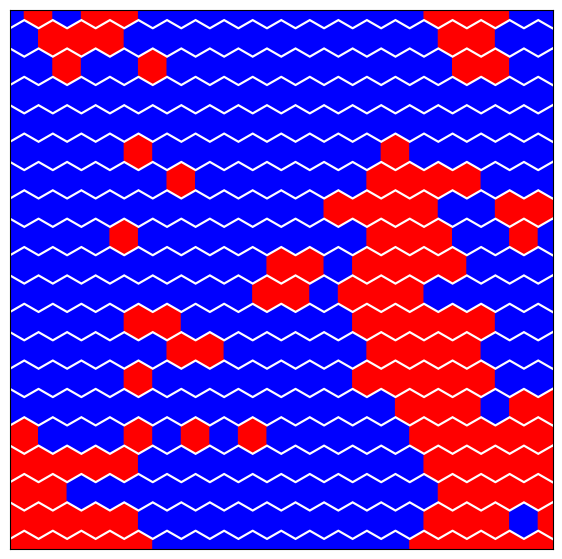

Evaluation 154 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.38it/s]

Completed. Saving
Time (s) to complete simulation 154: 68.89856553077698


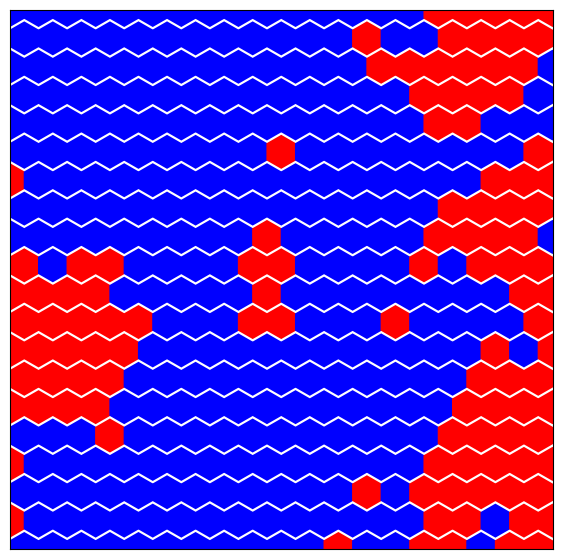

Evaluation 155 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.23it/s]


Completed. Saving
Time (s) to complete simulation 155: 69.71315884590149


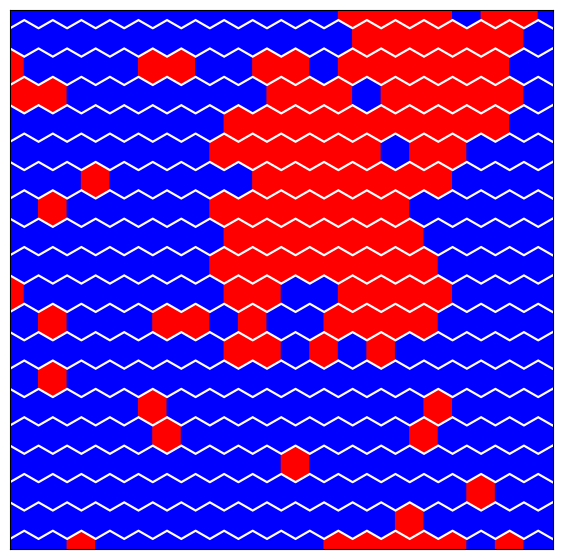

Evaluation 156 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.24it/s]


Completed. Saving
Time (s) to complete simulation 156: 70.25283002853394


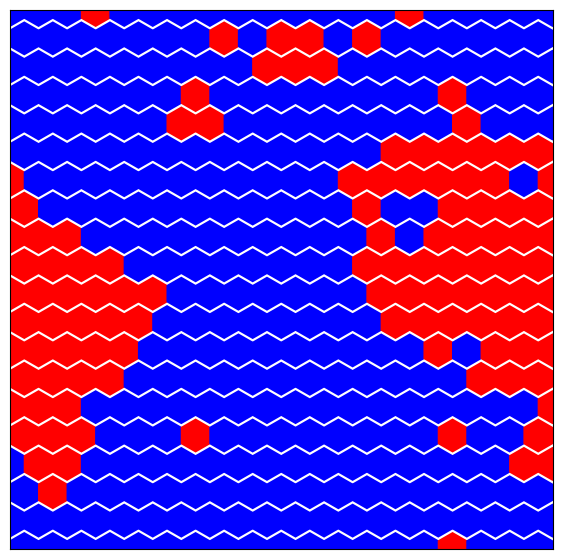

Evaluation 157 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.34it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.92it/s]


Completed. Saving
Time (s) to complete simulation 157: 68.53589820861816


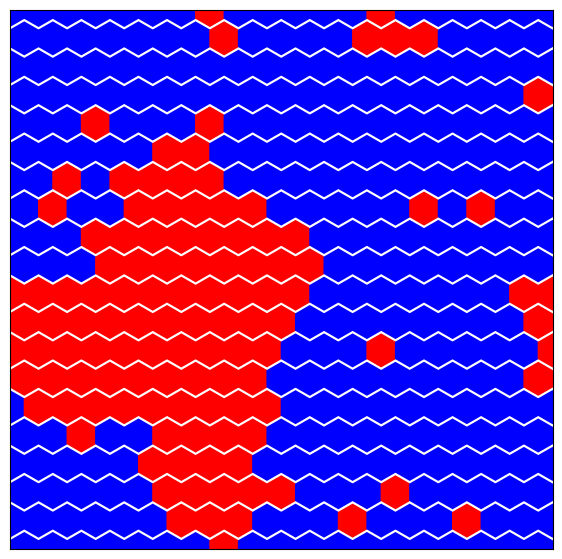

Evaluation 158 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.12it/s]


Completed. Saving
Time (s) to complete simulation 158: 69.63523006439209


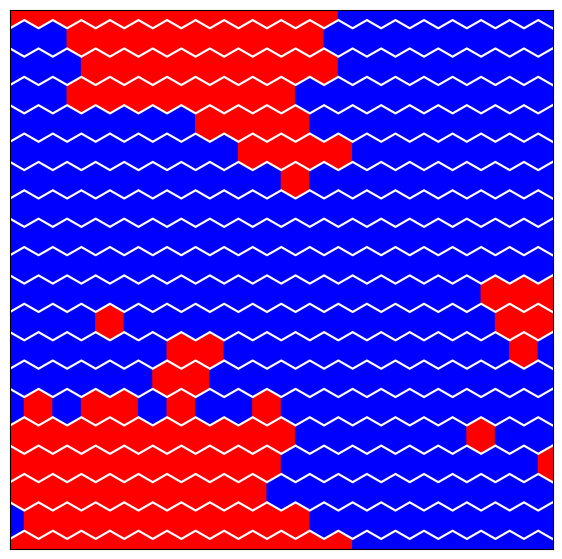

Evaluation 159 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.40it/s]


Completed. Saving
Time (s) to complete simulation 159: 69.5021402835846


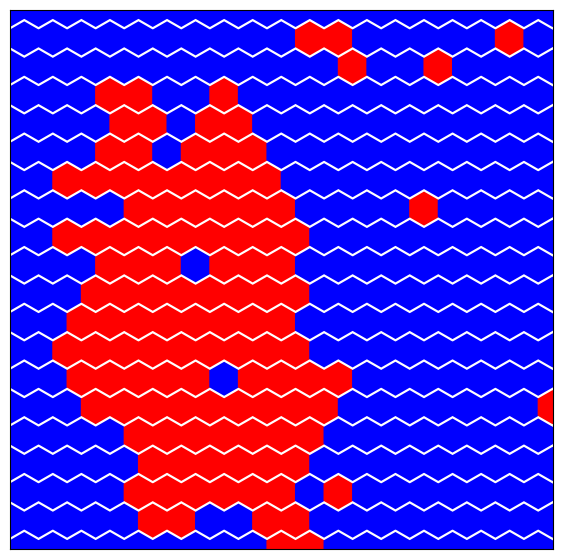

Evaluation 160 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.53it/s]

Completed. Saving
Time (s) to complete simulation 160: 67.70253252983093


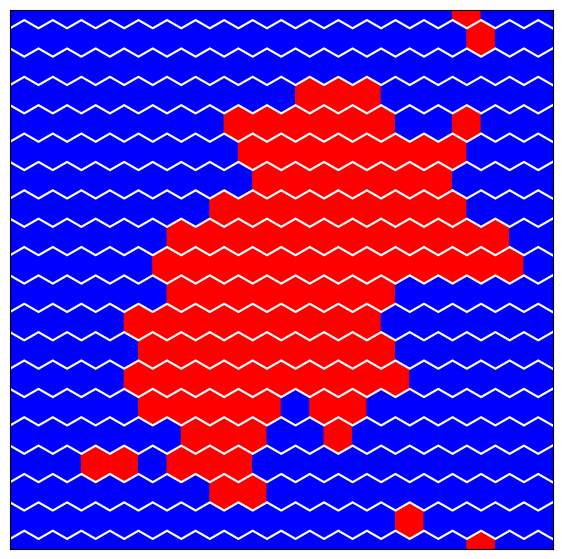

Evaluation 161 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.95it/s]


Completed. Saving
Time (s) to complete simulation 161: 69.65498089790344


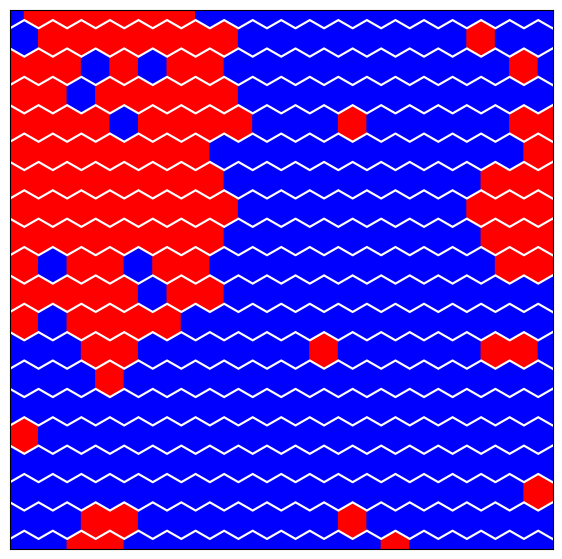

Evaluation 162 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.33it/s]

Completed. Saving
Time (s) to complete simulation 162: 68.82978963851929


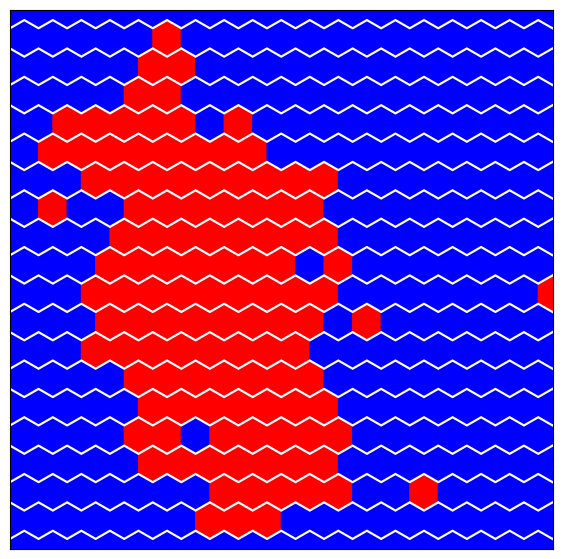

Evaluation 163 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.31it/s]

Completed. Saving
Time (s) to complete simulation 163: 70.24989080429077


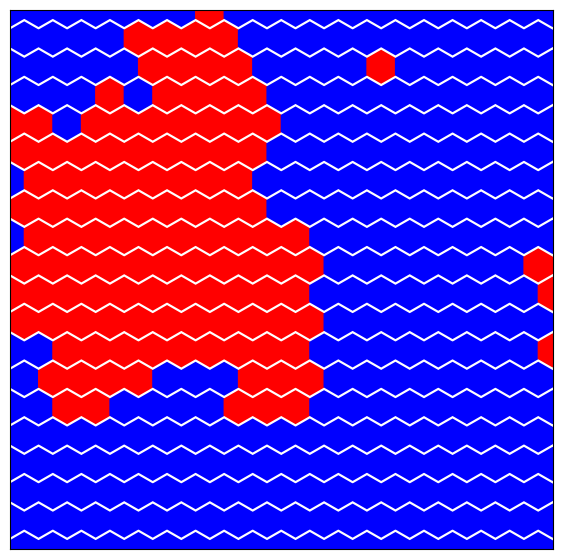

Evaluation 164 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:39<00:00, 12.82it/s]


Completed. Saving
Time (s) to complete simulation 164: 73.09004974365234


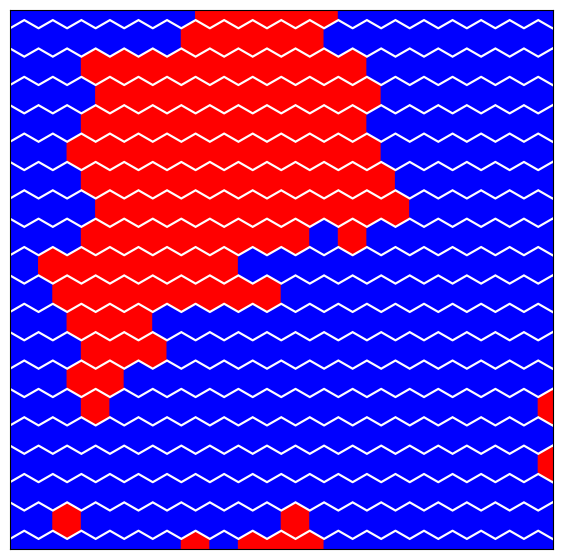

Evaluation 165 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.90it/s]


Completed. Saving
Time (s) to complete simulation 165: 70.91784071922302


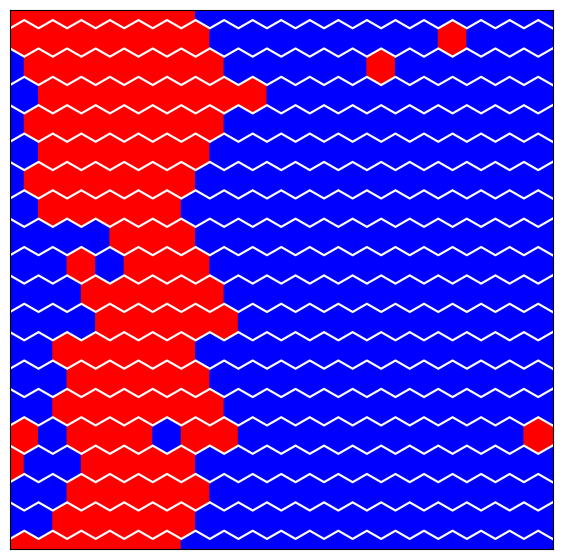

Evaluation 166 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.14it/s]


Completed. Saving
Time (s) to complete simulation 166: 70.07842946052551


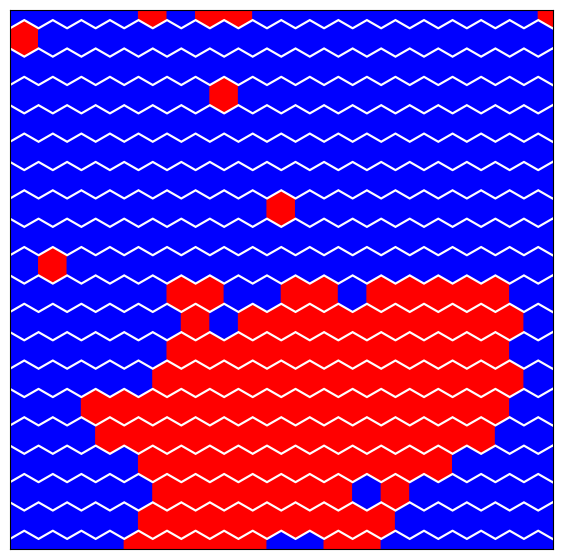

Evaluation 167 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.22it/s]


Completed. Saving
Time (s) to complete simulation 167: 69.85685801506042


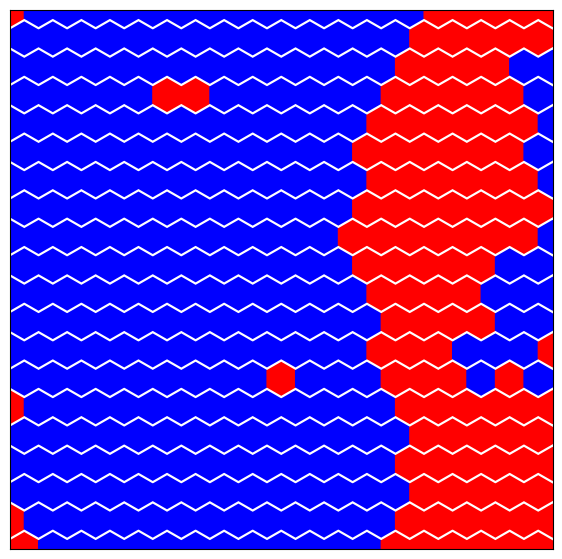

Evaluation 168 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.60it/s]


Completed. Saving
Time (s) to complete simulation 168: 69.33441352844238


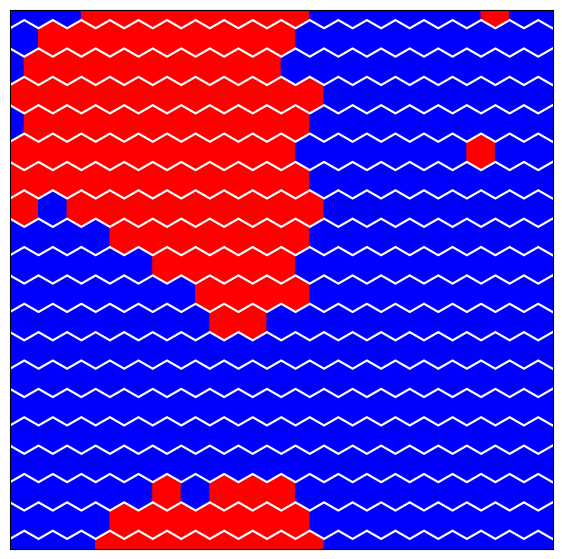

Evaluation 169 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.35it/s]


Completed. Saving
Time (s) to complete simulation 169: 71.57147145271301


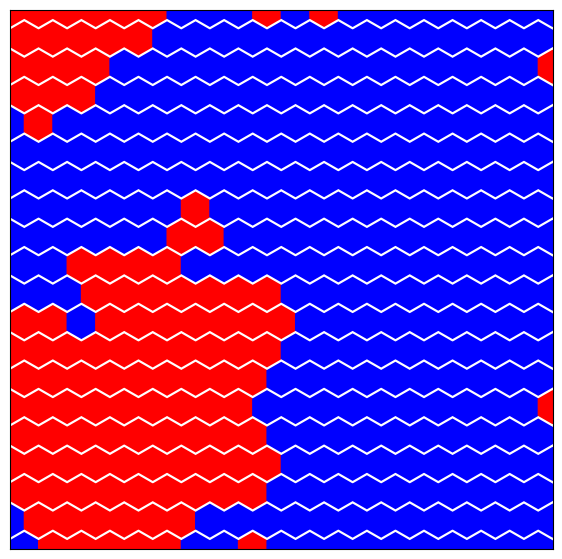

Evaluation 170 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.68it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.59it/s]


Completed. Saving
Time (s) to complete simulation 170: 68.69859981536865


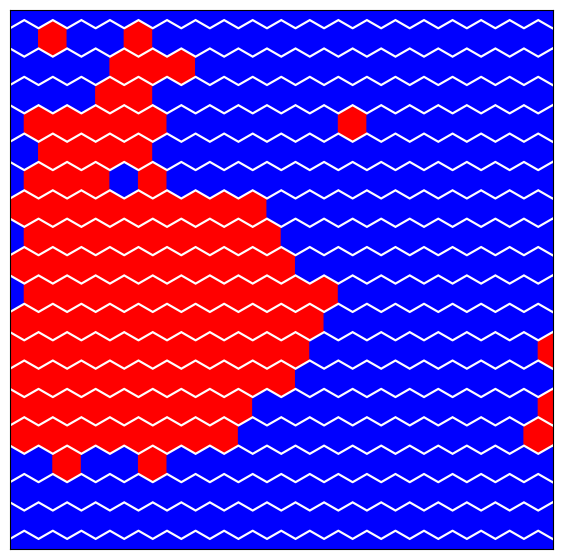

Evaluation 171 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.04it/s]


Completed. Saving
Time (s) to complete simulation 171: 70.159184217453


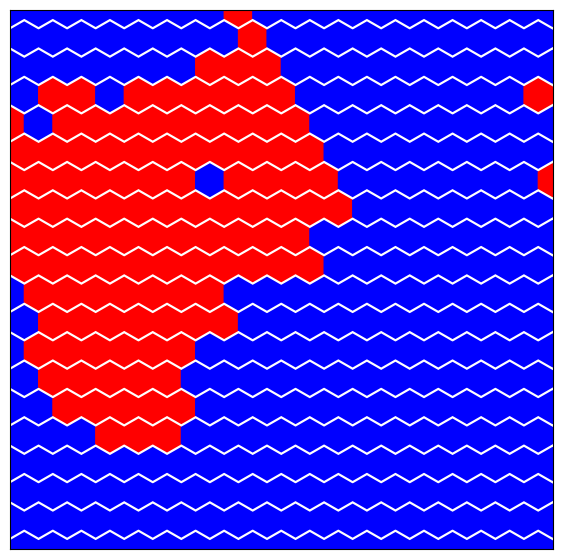

Evaluation 172 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.95it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.37it/s]


Completed. Saving
Time (s) to complete simulation 172: 68.769362449646


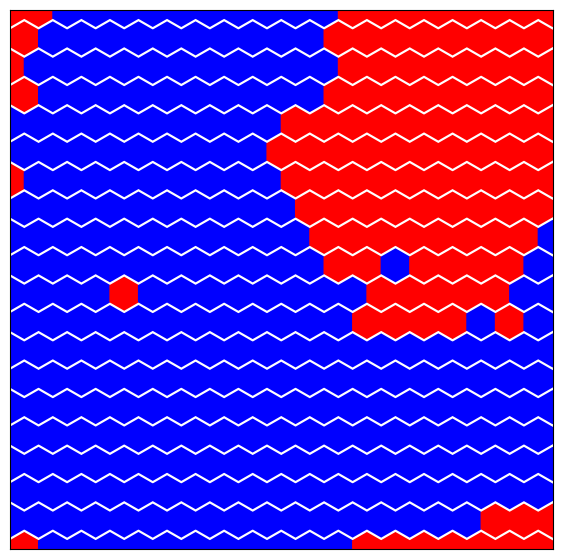

Evaluation 173 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.14it/s]


Completed. Saving
Time (s) to complete simulation 173: 69.51553511619568


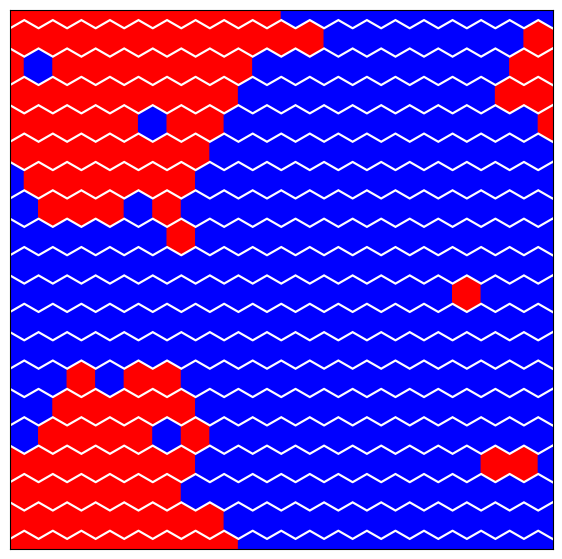

Evaluation 174 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.37it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:39<00:00, 12.79it/s]


Completed. Saving
Time (s) to complete simulation 174: 71.61322522163391


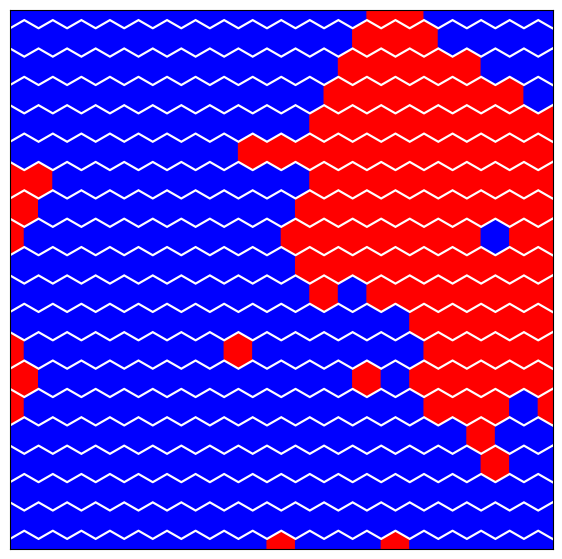

Evaluation 175 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.42it/s]

Completed. Saving
Time (s) to complete simulation 175: 70.56699514389038


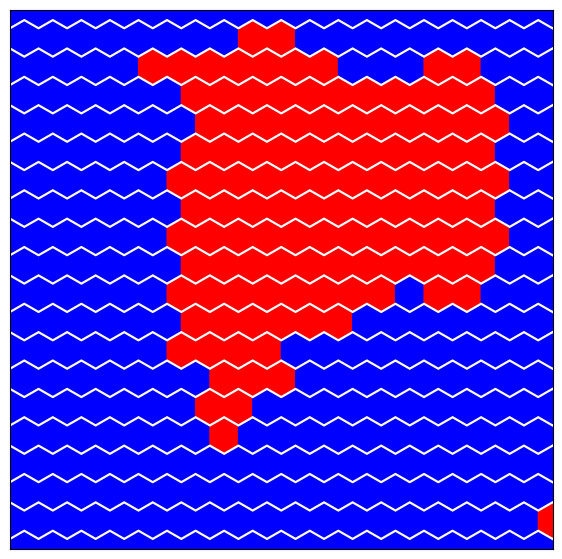

Evaluation 176 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.62it/s]


Completed. Saving
Time (s) to complete simulation 176: 67.03138208389282


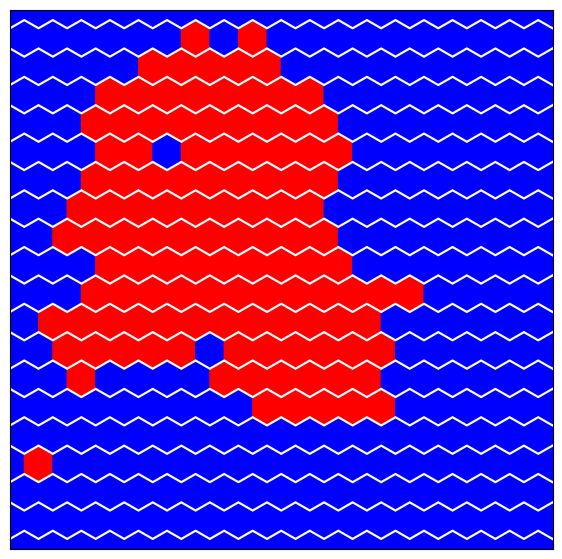

Evaluation 177 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.58it/s]


Completed. Saving
Time (s) to complete simulation 177: 68.75135707855225


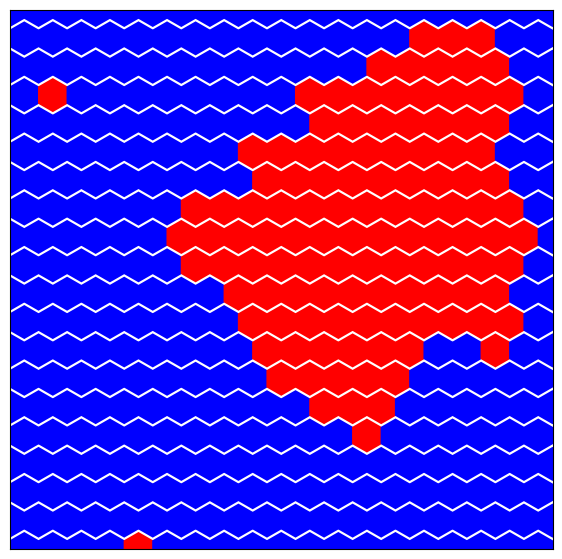

Evaluation 178 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.61it/s]

Completed. Saving
Time (s) to complete simulation 178: 67.65086364746094


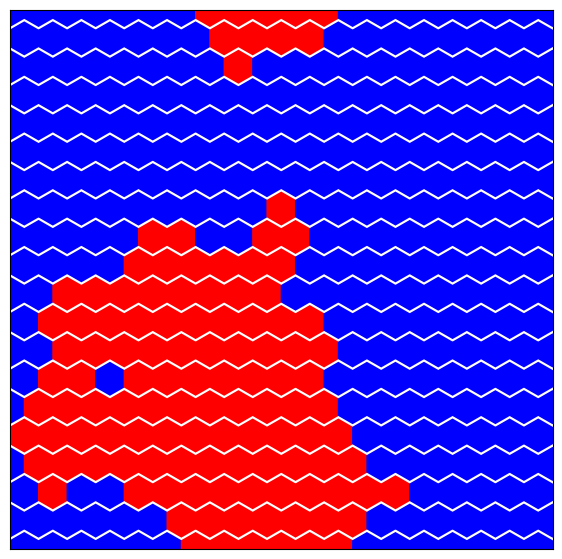

Evaluation 179 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.09it/s]

Completed. Saving
Time (s) to complete simulation 179: 69.2232255935669


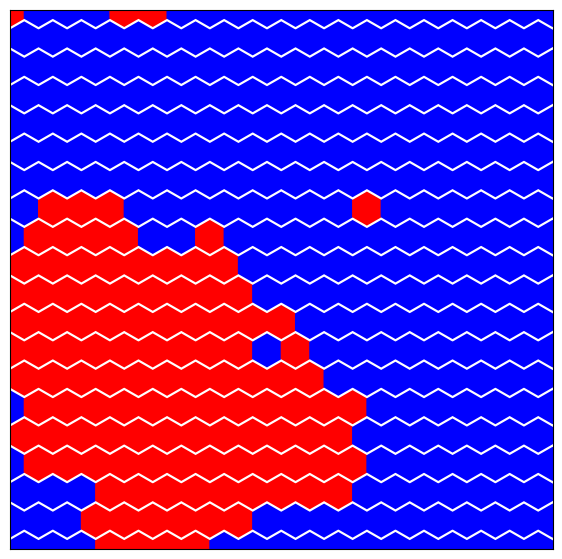

Evaluation 180 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.24it/s]


Completed. Saving
Time (s) to complete simulation 180: 69.15515804290771


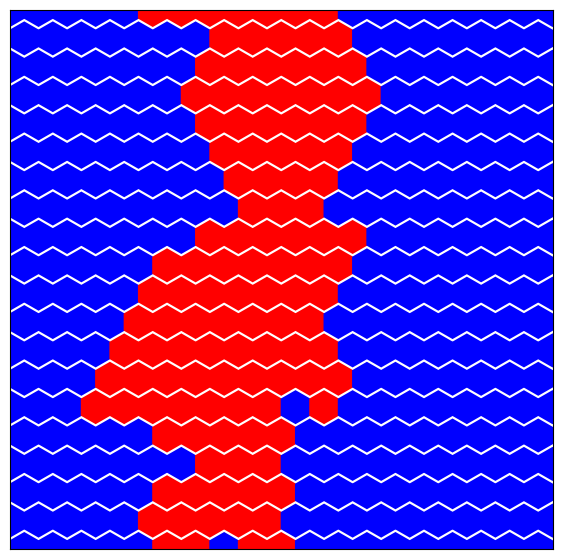

Evaluation 181 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.56it/s]


Completed. Saving
Time (s) to complete simulation 181: 68.70514678955078


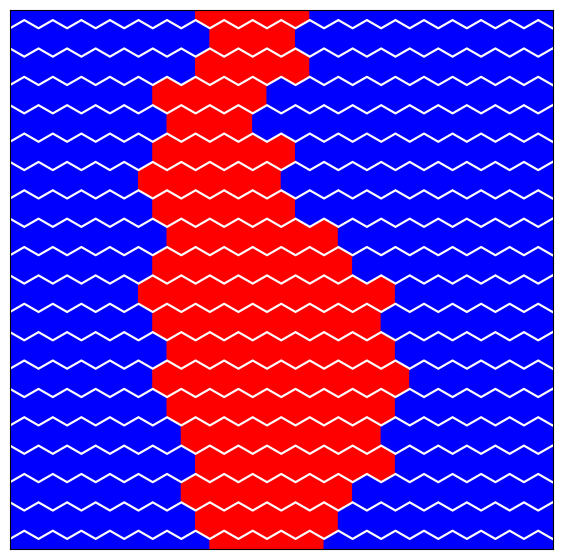

Evaluation 182 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.02it/s]


Completed. Saving
Time (s) to complete simulation 182: 69.6534276008606


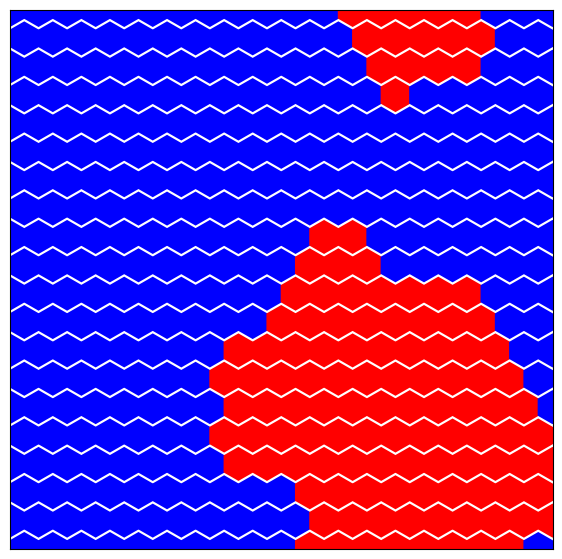

Evaluation 183 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.08it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.21it/s]


Completed. Saving
Time (s) to complete simulation 183: 71.01697850227356


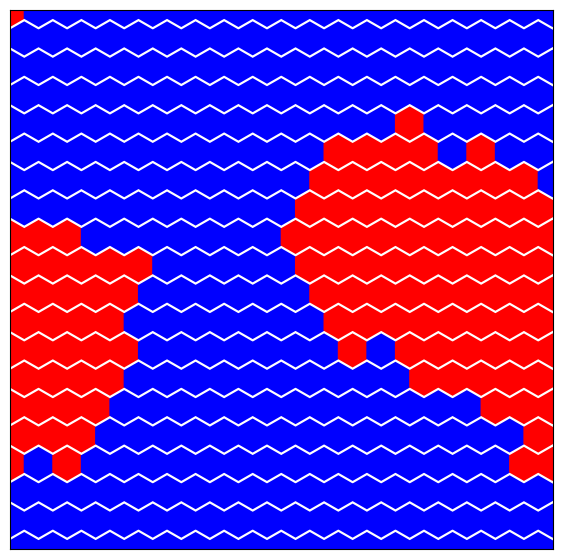

Evaluation 184 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.14it/s]

Completed. Saving
Time (s) to complete simulation 184: 69.71326565742493


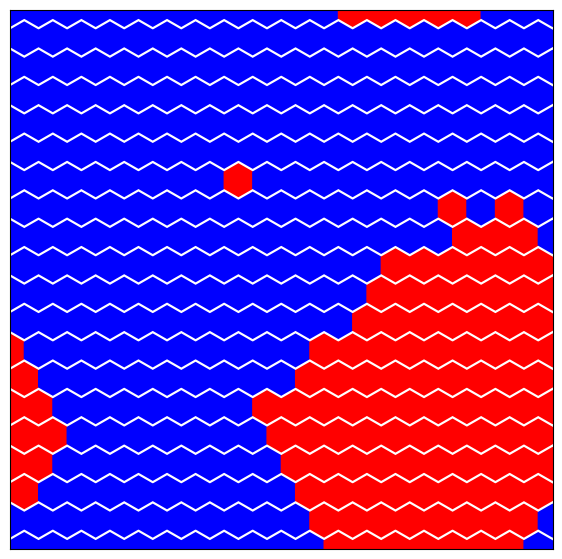

Evaluation 185 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.70it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.41it/s]


Completed. Saving
Time (s) to complete simulation 185: 69.16380834579468


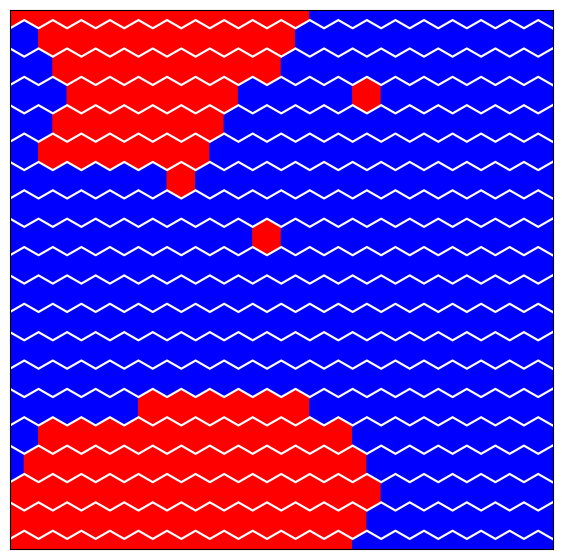

Evaluation 186 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.33it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.19it/s]


Completed. Saving
Time (s) to complete simulation 186: 70.55220627784729


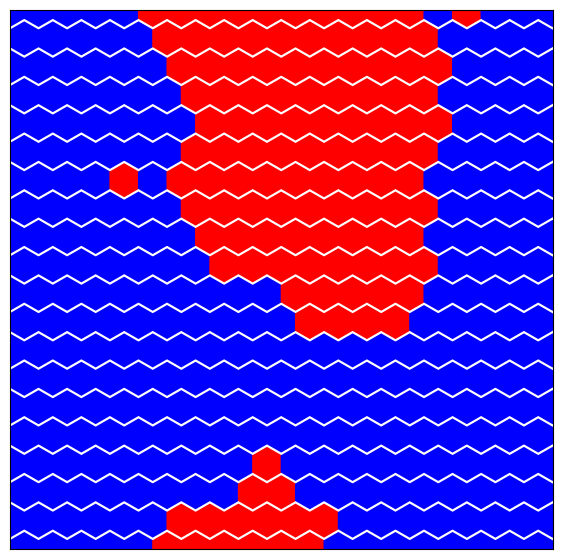

Evaluation 187 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.01it/s]


Completed. Saving
Time (s) to complete simulation 187: 71.76290988922119


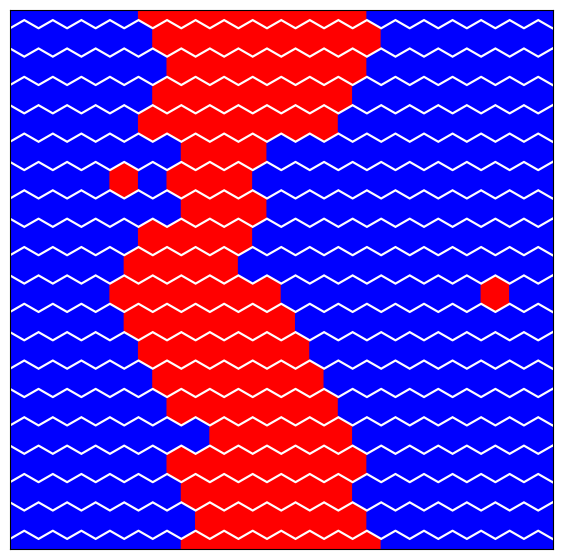

Evaluation 188 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.64it/s]


Completed. Saving
Time (s) to complete simulation 188: 68.04330468177795


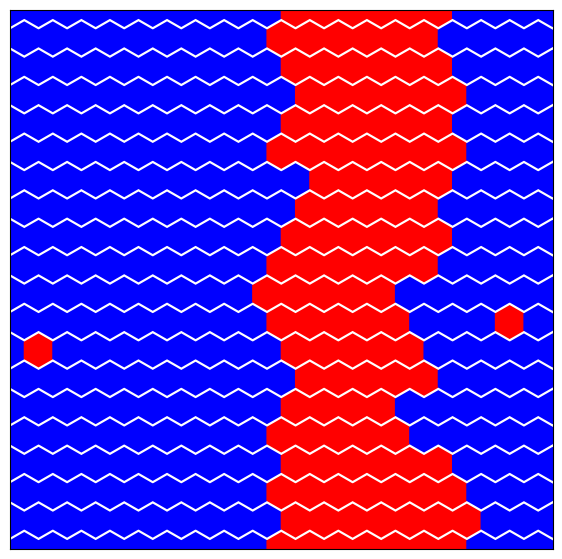

Evaluation 189 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.49it/s]


Completed. Saving
Time (s) to complete simulation 189: 67.71376037597656


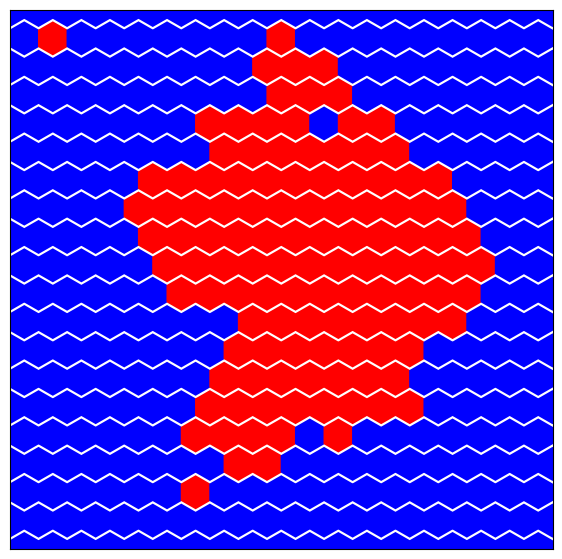

Evaluation 190 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 15.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.29it/s]


Completed. Saving
Time (s) to complete simulation 190: 70.94055485725403


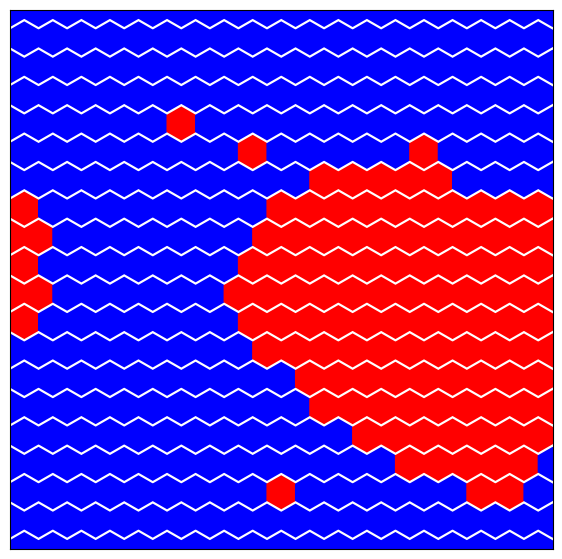

Evaluation 191 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.93it/s]

Completed. Saving
Time (s) to complete simulation 191: 70.43319249153137


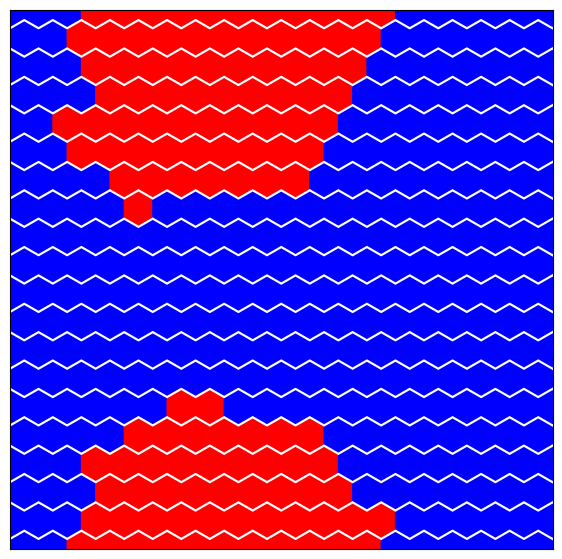

Evaluation 192 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.94it/s]


Completed. Saving
Time (s) to complete simulation 192: 70.98962998390198


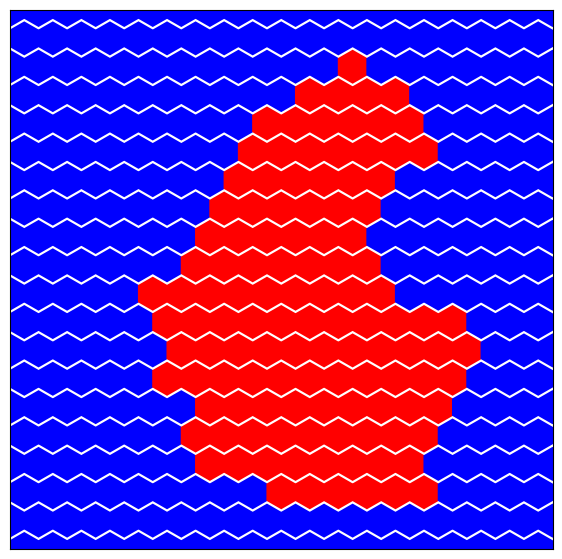

Evaluation 193 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.90it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.22it/s]


Completed. Saving
Time (s) to complete simulation 193: 71.39444327354431


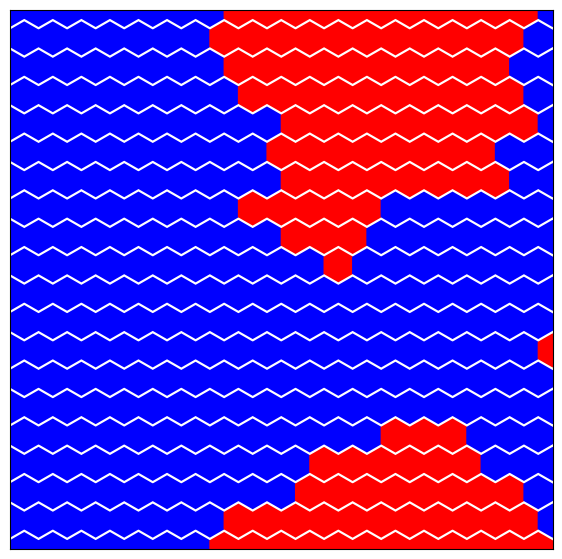

Evaluation 194 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.30it/s]


Completed. Saving
Time (s) to complete simulation 194: 69.52739715576172


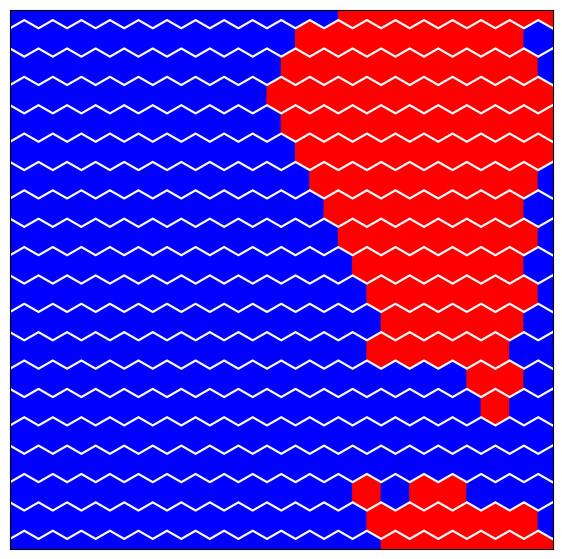

Evaluation 195 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:33<00:00, 14.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.51it/s]

Completed. Saving
Time (s) to complete simulation 195: 70.50743865966797


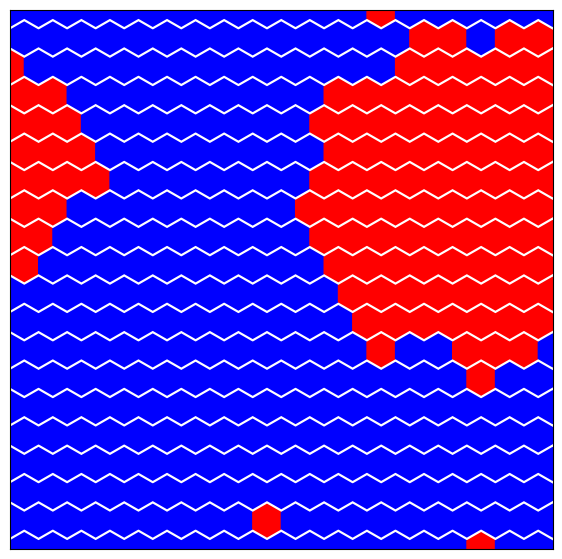

Evaluation 196 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.39it/s]


Completed. Saving
Time (s) to complete simulation 196: 68.07542443275452


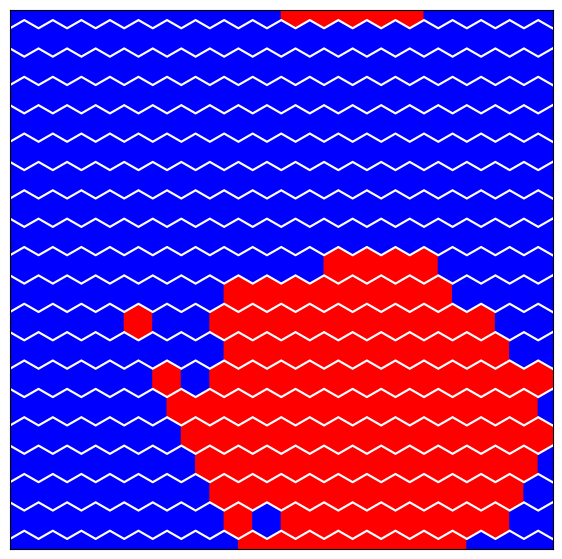

Evaluation 197 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.12it/s]


Completed. Saving
Time (s) to complete simulation 197: 69.19331359863281


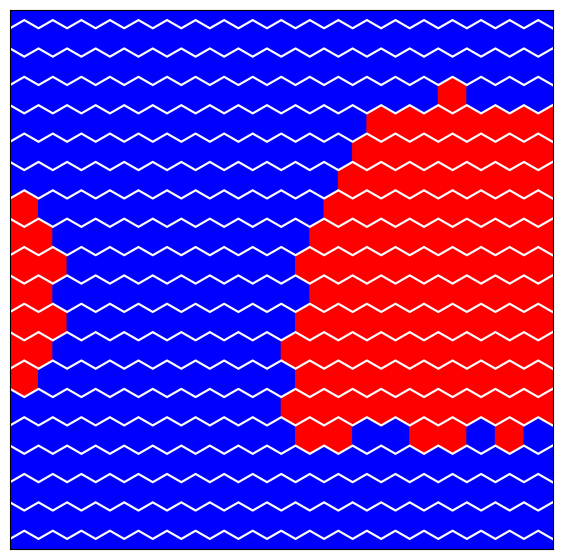

Evaluation 198 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.97it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.51it/s]

Completed. Saving
Time (s) to complete simulation 198: 68.33285999298096


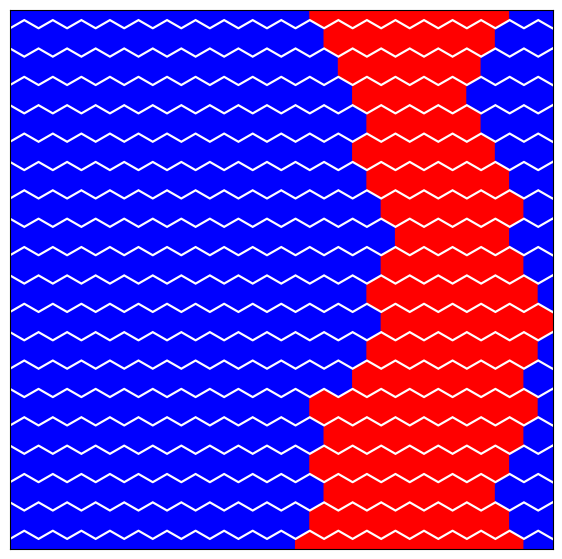

Evaluation 199 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.64it/s]

Completed. Saving
Time (s) to complete simulation 199: 69.14264678955078


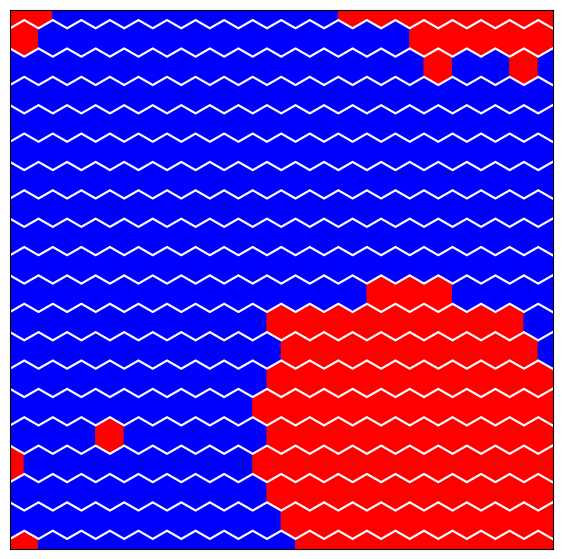

Evaluation 200 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 13.07it/s]


Completed. Saving
Time (s) to complete simulation 200: 71.21290397644043


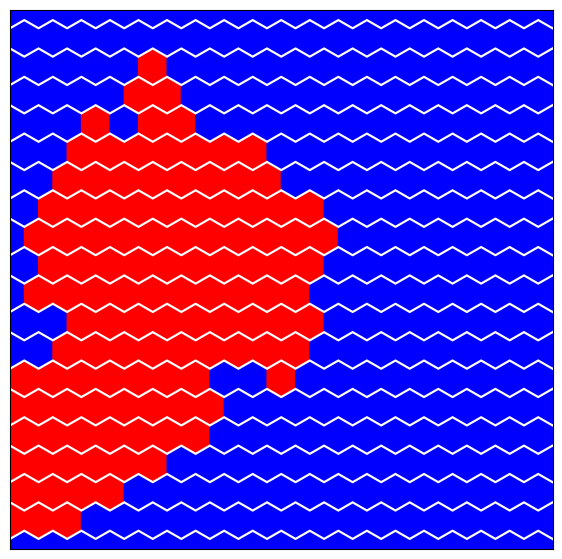

Evaluation 201 of 201

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.09it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.53it/s]


Completed. Saving
Time (s) to complete simulation 201: 68.0533390045166


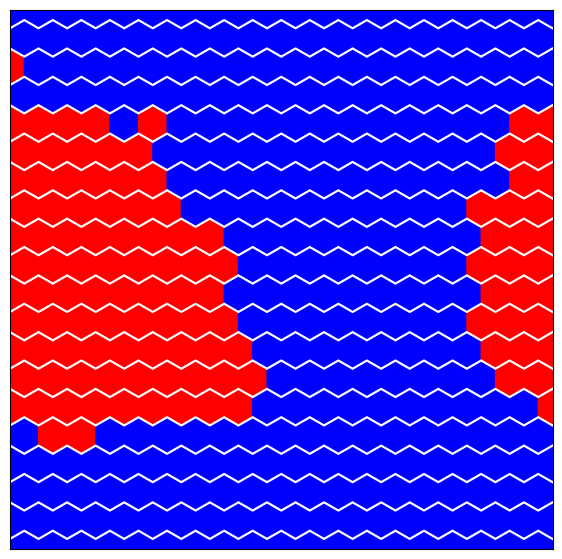

In [ ]:
Jx = xs
results_dict_tri = {}
approx_ys_tri = np.zeros(xs.shape[0])
time_eval = np.zeros(xs.shape[0])
for i in range(0, Jx.shape[0]):
    J_mat = np.array([[0,Jx[i],0,Jx[i],0],
                      [Jx[i],0,0,0,Jx[i]],
                      [0,Jx[i],0,Jx[i],0]])
    print("Evaluation " +str (i+1) +" of " +str(N_total))
    start_time = time.time()
    np.random.seed(0)
    tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                       eqSteps = 500, mcSteps = 500,
                       prop = 0.3)  # Proportion of the sites occupied
    tri_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(time_eval[i]))
    results_dict_tri[i] = {'sim': tri_sim.results,}
    approx_ys_tri[i] = results_dict_tri[i]['sim']['SpecificHeat']
    tri_sim.plot_config(results_dict_tri[i]['sim']['config'][-1])
    plt.show()

In [ ]:
np.save("results_dict_tri.npy", results_dict_tri)


In [ ]:
from google.colab import files
files.download("results_dict_tri.npy")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

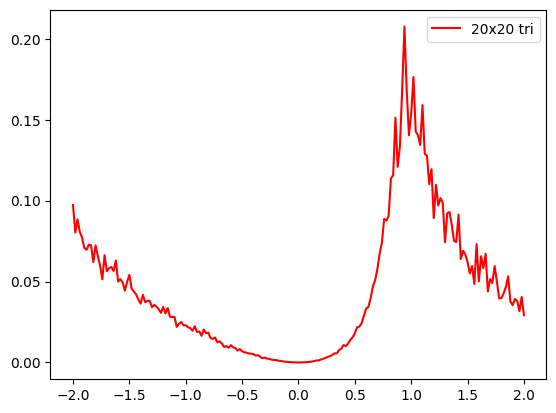

In [ ]:
#plt.plot(xs, approx_ys, "k--", label="20x20 square")
plt.plot(xs, approx_ys_tri, "r", label="20x20 tri")
plt.legend(loc="best")

# Start Analysis

- Lets load the data for 1D Square and triangle Ising model simulation

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [ ]:
!gdown https://drive.google.com/uc?id=1l5N5sXnprA_72pOElc_oFEJn4Y5GZWpk
results_dict_square = np.load("results_dict_square.npy", allow_pickle=True)
results_dict_square = dict(enumerate(results_dict_square.flatten(), 1))

!gdown https://drive.google.com/uc?id=1qZy7vUJabHZLRInhZCkFUk2eYo3w9vB9
results_dict_tri = np.load("results_dict_tri.npy", allow_pickle=True)
results_dict_tri = dict(enumerate(results_dict_tri.flatten(), 1))

Downloading...
From: https://drive.google.com/uc?id=1l5N5sXnprA_72pOElc_oFEJn4Y5GZWpk
To: /content/results_dict_square.npy
100% 323M/323M [00:02<00:00, 152MB/s]
Downloading...
From: https://drive.google.com/uc?id=1qZy7vUJabHZLRInhZCkFUk2eYo3w9vB9
To: /content/results_dict_tri.npy
100% 644M/644M [00:04<00:00, 158MB/s]


In [ ]:
approx_ys_tri = np.zeros(xs.shape[0])
approx_ys_sq = np.zeros(xs.shape[0])
for i in range(0, xs.shape[0]):
    approx_ys_tri[i] = results_dict_tri[1][i]['sim']['SpecificHeat']
    approx_ys_sq[i] = results_dict_square[1][i]['sim']['SpecificHeat']


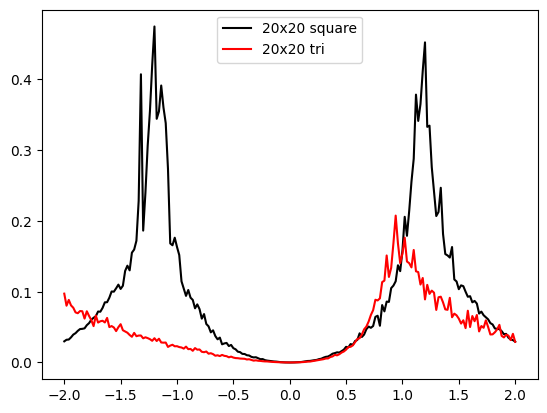

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="20x20 square")
plt.plot(xs, approx_ys_tri, "r", label="20x20 tri")
plt.legend(loc="best")

# 1D Square Model
- Generate few randomly sampled training data

In [ ]:
n = 10

np.random.seed(1)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_x, train_x_norm

(array([[-0.33191198],
        [ 0.88129797],
        [-1.9995425 ],
        [-0.79066971],
        [-1.41297644],
        [-1.63064562],
        [-1.25495915],
        [-0.61775709],
        [-0.4129301 ],
        [ 0.15526694]]),
 array([[4.17022005e-01],
        [7.20324493e-01],
        [1.14374817e-04],
        [3.02332573e-01],
        [1.46755891e-01],
        [9.23385948e-02],
        [1.86260211e-01],
        [3.45560727e-01],
        [3.96767474e-01],
        [5.38816734e-01]]))

- Evaluate randomly sampled training data

<ipython-input-14-e99d9e2fa518>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


Evaluation 1 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 27.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]


Completed. Saving
Time (s) to complete simulation 1: 74.09164047241211


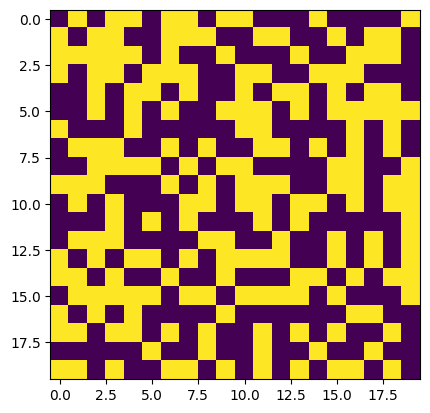

Evaluation 2 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:19<00:00, 25.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.92it/s]


Completed. Saving
Time (s) to complete simulation 2: 75.44325876235962


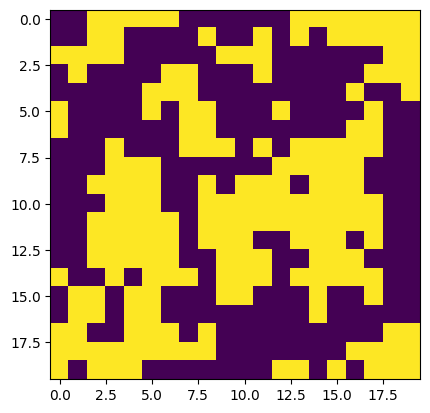

Evaluation 3 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]


Completed. Saving
Time (s) to complete simulation 3: 76.40617203712463


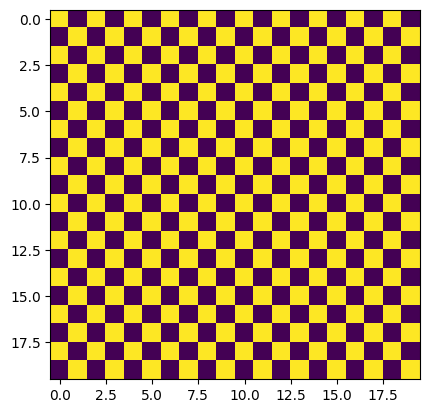

Evaluation 4 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:19<00:00, 26.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.64it/s]


Completed. Saving
Time (s) to complete simulation 4: 77.06189632415771


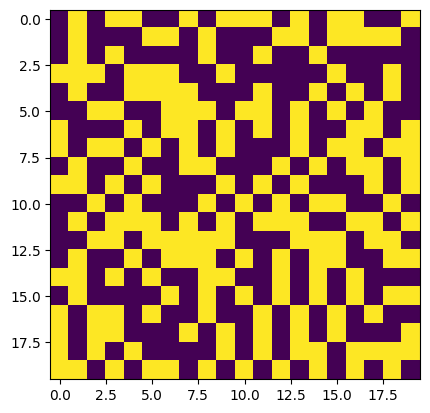

Evaluation 5 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:19<00:00, 26.19it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:58<00:00,  8.62it/s]


Completed. Saving
Time (s) to complete simulation 5: 77.12832593917847


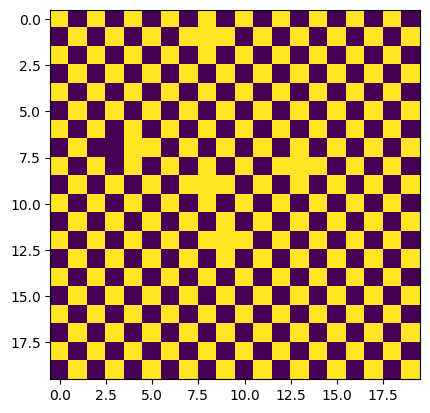

Evaluation 6 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:19<00:00, 26.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.70it/s]


Completed. Saving
Time (s) to complete simulation 6: 76.53481364250183


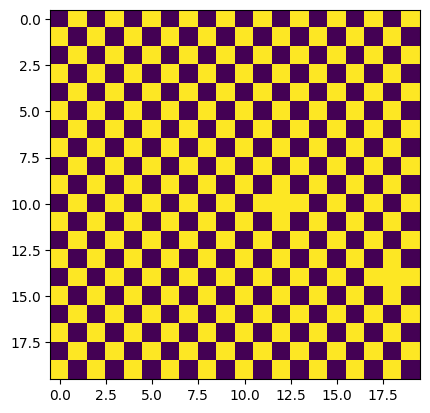

Evaluation 7 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 23.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:01<00:00,  8.11it/s]


Completed. Saving
Time (s) to complete simulation 7: 83.25232076644897


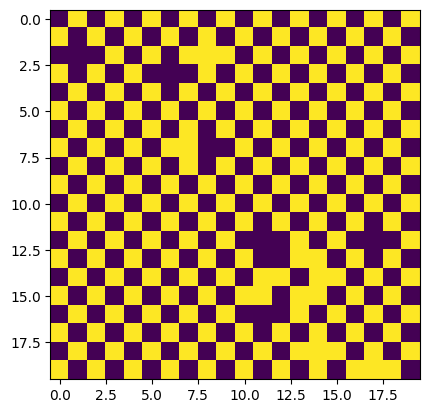

Evaluation 8 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:19<00:00, 25.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.67it/s]


Completed. Saving
Time (s) to complete simulation 8: 77.14933919906616


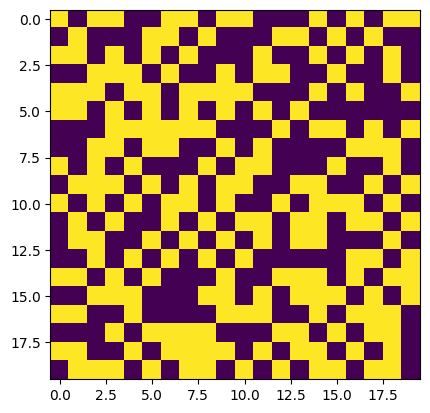

Evaluation 9 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.90it/s]


Completed. Saving
Time (s) to complete simulation 9: 74.98238682746887


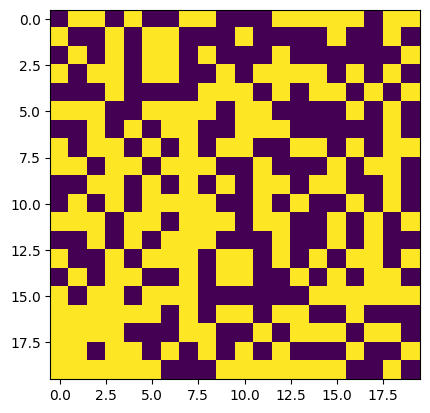

Evaluation 10 of 10

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.85it/s]


Completed. Saving
Time (s) to complete simulation 10: 75.379802942276


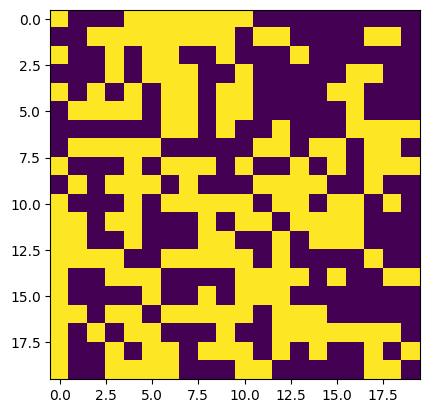

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

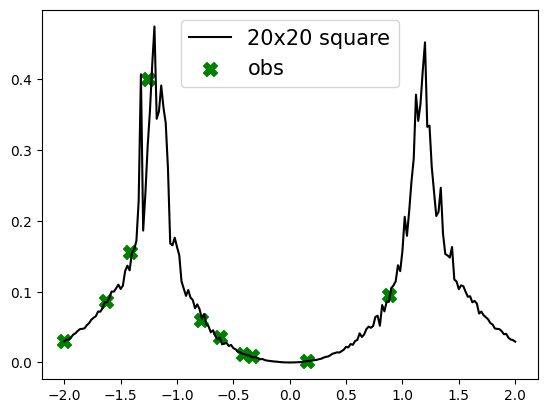

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="20x20 square")
plt.scatter(train_x, train_y, c="g", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

In [ ]:
train_x = train_x[0:n]
train_x_norm = train_x_norm[0:n]
train_y = train_y[0:n]
train_x, train_x_norm, train_y

(array([[-0.33191198],
        [ 0.88129797],
        [-1.9995425 ],
        [-0.79066971],
        [-1.41297644],
        [-1.63064562],
        [-1.25495915],
        [-0.61775709],
        [-0.4129301 ],
        [ 0.15526694]]),
 array([[4.17022005e-01],
        [7.20324493e-01],
        [1.14374817e-04],
        [3.02332573e-01],
        [1.46755891e-01],
        [9.23385948e-02],
        [1.86260211e-01],
        [3.45560727e-01],
        [3.96767474e-01],
        [5.38816734e-01]]),
 array([[0.00865403],
        [0.09505453],
        [0.02968125],
        [0.05988589],
        [0.15605675],
        [0.08751802],
        [0.40115651],
        [0.03599105],
        [0.01219715],
        [0.00151869]]))

In [ ]:
def kernel_prior() -> Dict[str, jnp.ndarray]:
    length = numpyro.sample("k_length", numpyro.distributions.HalfNormal(0.5))
    scale = numpyro.sample("k_scale", numpyro.distributions.HalfNormal(0.5))
    return {"k_length": length, "k_scale": scale}


BO Step:1


sample: 100%|██████████| 4000/4000 [00:34<00:00, 114.92it/s, 15 steps of size 3.71e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.37      0.31      0.26      0.00      0.85    679.67      1.00
   k_scale      0.10      0.15      0.04      0.00      0.29    881.98      1.00
     noise      0.01      0.01      0.01      0.00      0.02    600.83      1.00



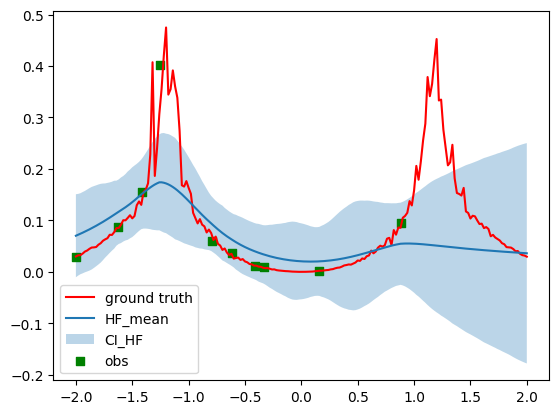

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


39
-1.22 [-1.22]
Evaluation 11 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 27.32it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:55<00:00,  8.99it/s]


Completed. Saving
Time (s) to complete simulation 2: 73.94366717338562


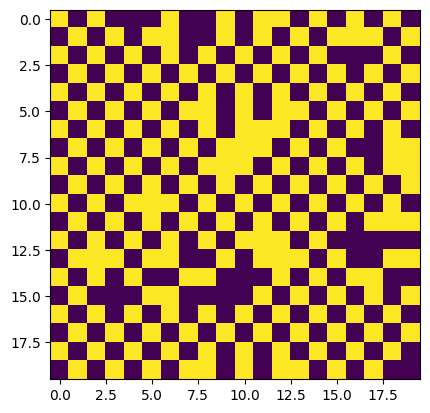

BO Step:2


sample: 100%|██████████| 4000/4000 [00:45<00:00, 88.34it/s, 7 steps of size 2.52e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.16      0.19      0.08      0.01      0.34    405.17      1.00
   k_scale      0.08      0.12      0.04      0.00      0.19    623.26      1.00
     noise      0.01      0.01      0.01      0.00      0.02    493.75      1.00



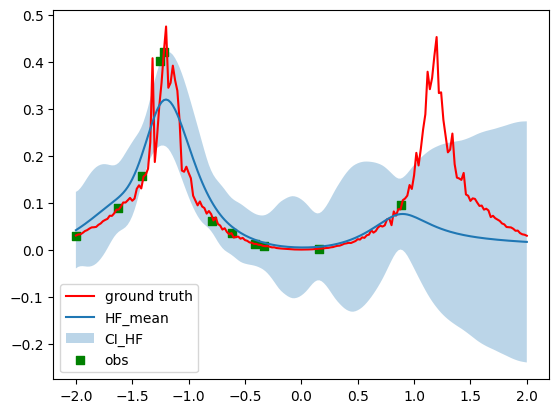

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41]
-1.18 [-1.18]
Evaluation 12 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:55<00:00,  8.94it/s]


Completed. Saving
Time (s) to complete simulation 3: 74.65134263038635


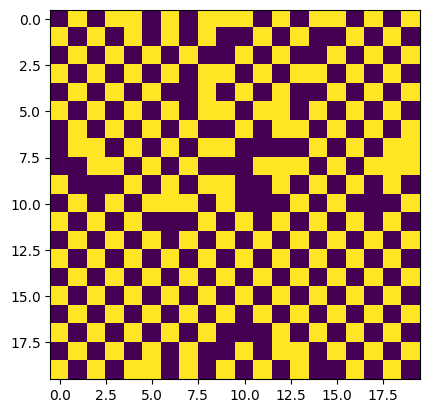

BO Step:3


sample: 100%|██████████| 4000/4000 [00:39<00:00, 100.97it/s, 3 steps of size 3.68e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.11      0.11      0.08      0.01      0.19    453.14      1.00
   k_scale      0.07      0.11      0.04      0.00      0.15    584.21      1.00
     noise      0.01      0.00      0.00      0.00      0.01    732.41      1.00



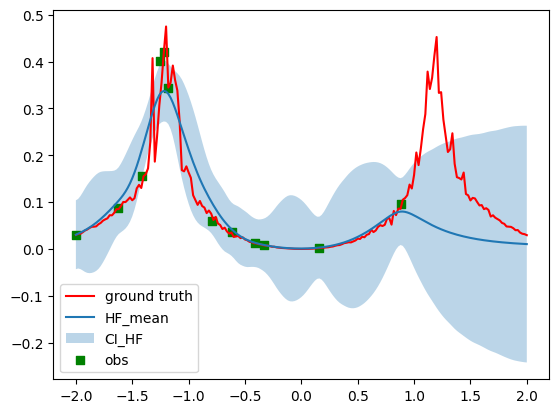

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41 40]
-1.2 [-1.2]
Evaluation 13 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.74it/s]


Completed. Saving
Time (s) to complete simulation 4: 76.09194374084473


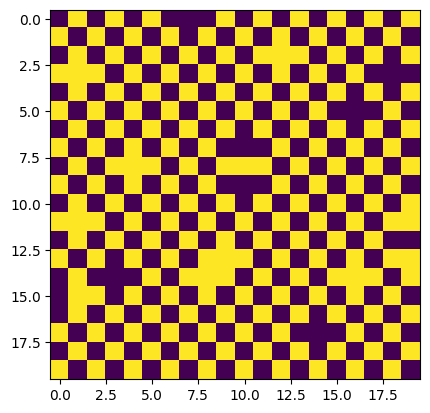

BO Step:4


sample: 100%|██████████| 4000/4000 [00:40<00:00, 98.55it/s, 7 steps of size 3.92e-01. acc. prob=0.94]  



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.08      0.06      0.07      0.02      0.14    550.74      1.00
   k_scale      0.07      0.09      0.04      0.01      0.14    457.96      1.00
     noise      0.01      0.00      0.01      0.00      0.01    785.43      1.00



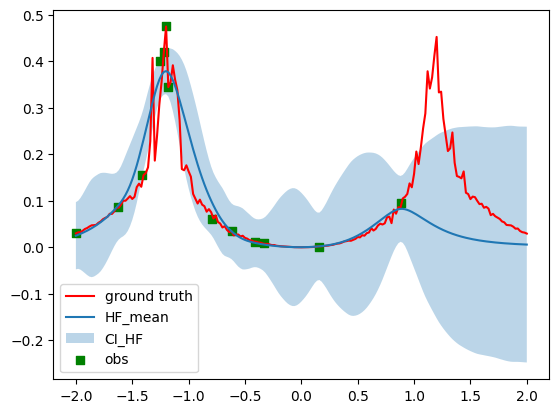

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41 40 42]
-1.1600000000000001 [-1.16]
Evaluation 14 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.87it/s]


Completed. Saving
Time (s) to complete simulation 5: 75.07157635688782


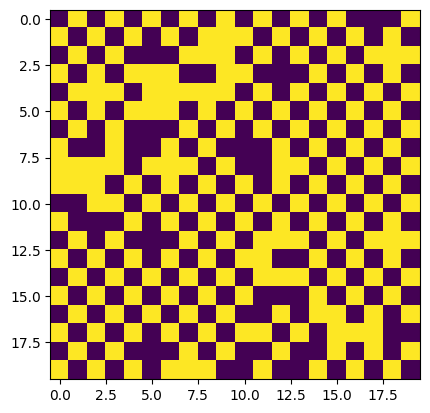

BO Step:5


sample: 100%|██████████| 4000/4000 [00:38<00:00, 103.97it/s, 7 steps of size 4.78e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.08      0.04      0.07      0.03      0.13    731.20      1.00
   k_scale      0.06      0.07      0.04      0.01      0.13    671.11      1.00
     noise      0.01      0.00      0.00      0.00      0.01   1025.04      1.00



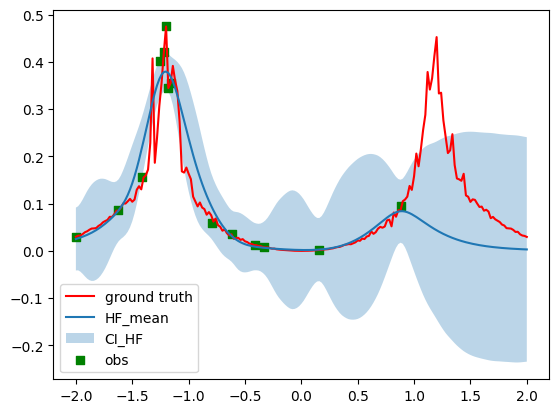

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41 40 42 38]
-1.24 [-1.24]
Evaluation 15 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.92it/s]


Completed. Saving
Time (s) to complete simulation 6: 74.65450549125671


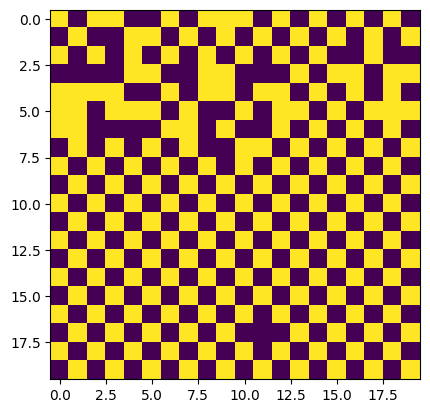

BO Step:6


sample: 100%|██████████| 4000/4000 [00:41<00:00, 96.31it/s, 7 steps of size 4.34e-01. acc. prob=0.93] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.08      0.04      0.07      0.02      0.12    674.47      1.00
   k_scale      0.07      0.08      0.04      0.01      0.14    473.41      1.00
     noise      0.00      0.00      0.00      0.00      0.01    946.42      1.00



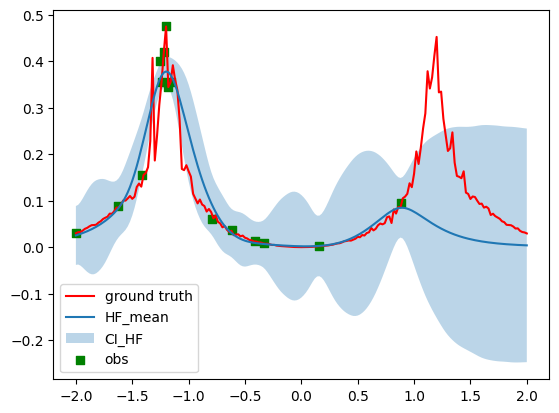

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41 40 42 38 43]
-1.1400000000000001 [-1.14]
Evaluation 16 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.87it/s]


Completed. Saving
Time (s) to complete simulation 7: 75.09725379943848


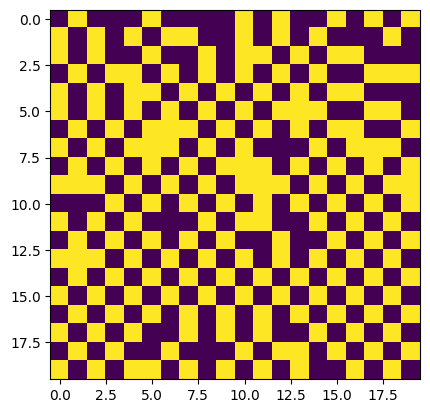

BO Step:7


sample: 100%|██████████| 4000/4000 [00:28<00:00, 141.48it/s, 3 steps of size 4.74e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.03      0.07      0.03      0.11    605.61      1.00
   k_scale      0.06      0.07      0.04      0.01      0.11    714.67      1.00
     noise      0.00      0.00      0.00      0.00      0.01    855.38      1.00



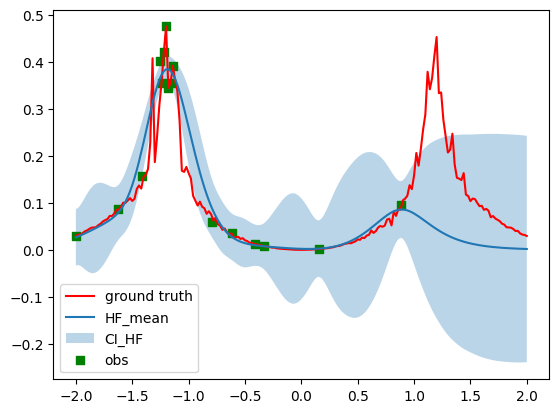

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[39 41 40 42 38 43 44]
-1.12 [-1.12]
Evaluation 17 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:55<00:00,  8.94it/s]


Completed. Saving
Time (s) to complete simulation 8: 74.84067368507385


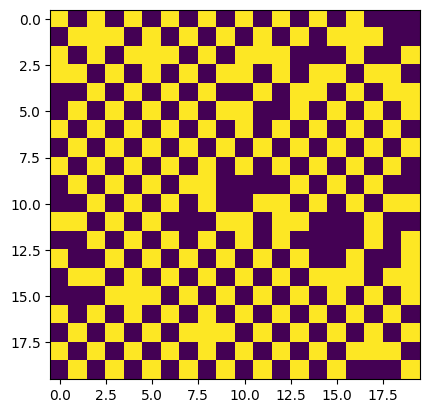

BO Step:8


sample: 100%|██████████| 4000/4000 [00:45<00:00, 88.46it/s, 3 steps of size 4.78e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.03      0.07      0.03      0.11    766.87      1.00
   k_scale      0.06      0.06      0.04      0.01      0.11    756.67      1.00
     noise      0.00      0.00      0.00      0.00      0.01    862.52      1.00



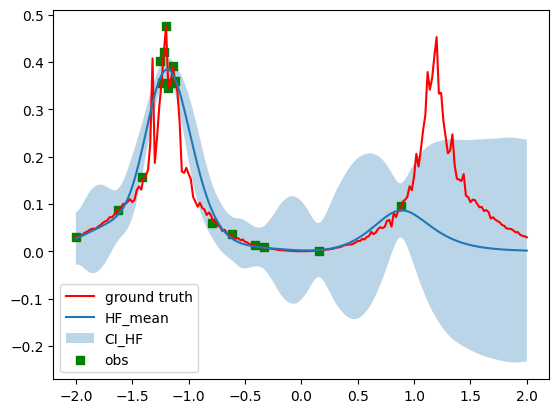

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195]
1.9 [1.9]
Evaluation 18 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.70it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.80it/s]


Completed. Saving
Time (s) to complete simulation 9: 75.56754064559937


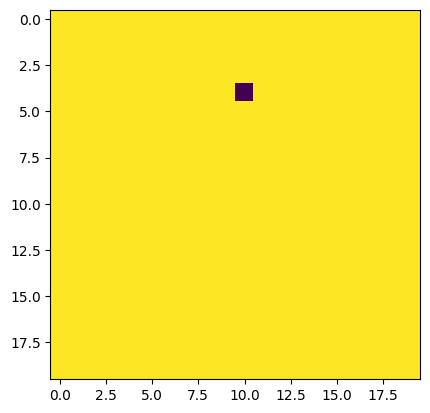

BO Step:9


sample: 100%|██████████| 4000/4000 [00:43<00:00, 92.47it/s, 7 steps of size 5.27e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.06      0.03      0.10    886.46      1.00
   k_scale      0.04      0.04      0.03      0.01      0.08    759.75      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1234.13      1.00



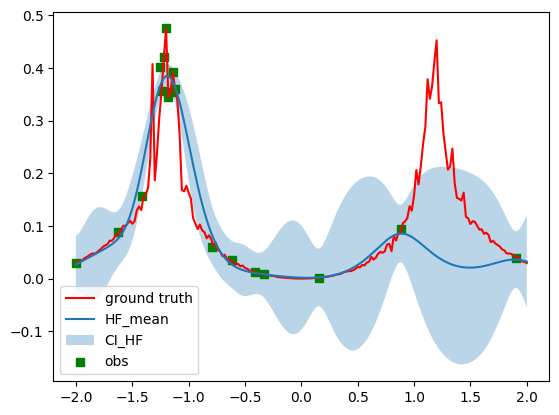

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45]
-1.1 [-1.1]
Evaluation 19 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.35it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.69it/s]


Completed. Saving
Time (s) to complete simulation 10: 76.52007532119751


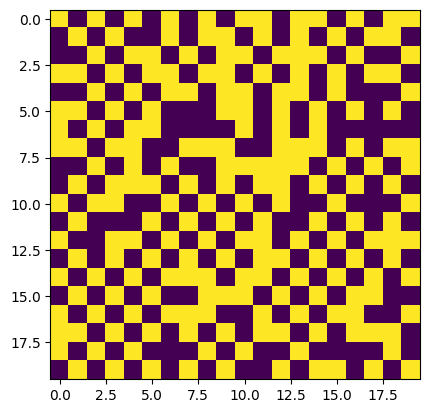

BO Step:10


sample: 100%|██████████| 4000/4000 [00:43<00:00, 91.56it/s, 7 steps of size 6.30e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.06      0.03      0.10    754.67      1.00
   k_scale      0.04      0.05      0.03      0.01      0.08    667.81      1.00
     noise      0.00      0.00      0.00      0.00      0.01    911.89      1.00



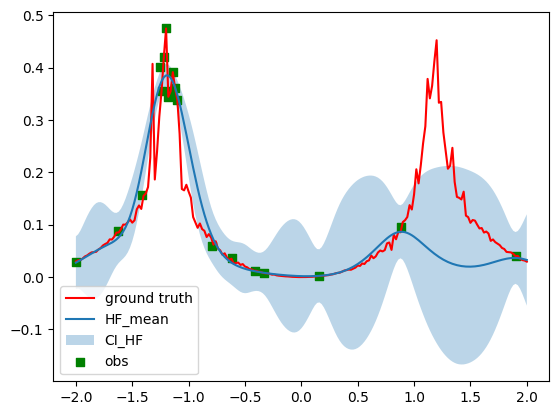

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37]
-1.26 [-1.26]
Evaluation 20 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.88it/s]


Completed. Saving
Time (s) to complete simulation 11: 75.09821724891663


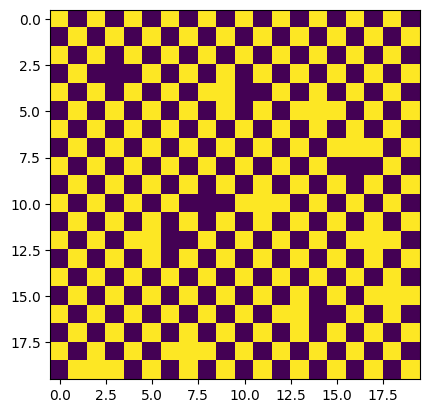

BO Step:11


sample: 100%|██████████| 4000/4000 [00:46<00:00, 85.76it/s, 3 steps of size 5.09e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.06      0.03      0.10    907.51      1.00
   k_scale      0.04      0.03      0.03      0.01      0.07    915.21      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1026.89      1.00



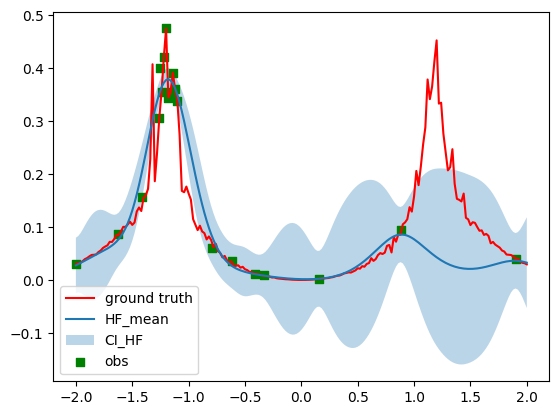

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37 167]
1.3399999999999999 [1.34]
Evaluation 21 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.45it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.80it/s]


Completed. Saving
Time (s) to complete simulation 12: 75.73347854614258


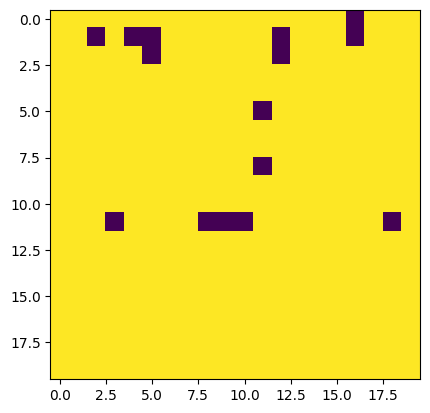

BO Step:12


sample: 100%|██████████| 4000/4000 [00:50<00:00, 78.44it/s, 3 steps of size 5.05e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.07      0.04      0.11    637.93      1.00
   k_scale      0.04      0.04      0.03      0.01      0.08    762.27      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1079.78      1.00



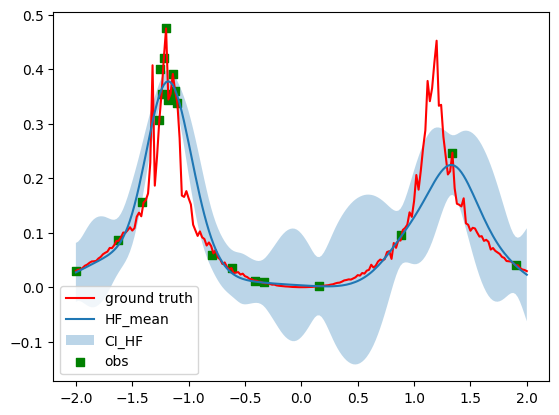

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37 167  46]
-1.08 [-1.08]
Evaluation 22 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:56<00:00,  8.78it/s]


Completed. Saving
Time (s) to complete simulation 13: 75.81235074996948


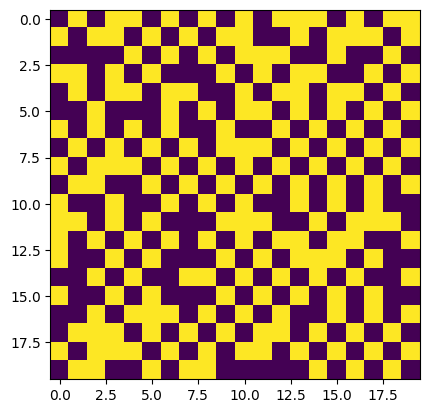

BO Step:13


sample: 100%|██████████| 4000/4000 [00:53<00:00, 74.59it/s, 3 steps of size 4.72e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.03      0.06      0.03      0.11    857.23      1.00
   k_scale      0.04      0.04      0.03      0.01      0.08    631.94      1.00
     noise      0.00      0.00      0.00      0.00      0.01    961.29      1.00



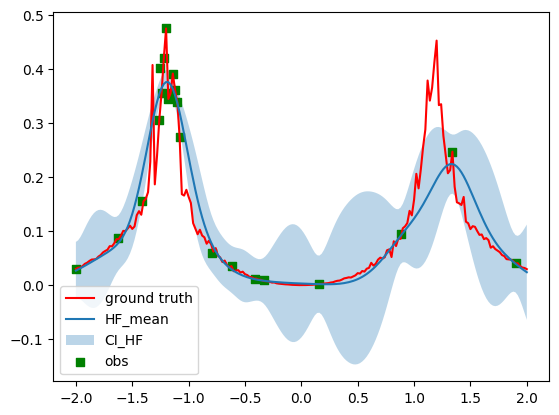

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37 167  46 178]
1.56 [1.56]
Evaluation 23 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.68it/s]


Completed. Saving
Time (s) to complete simulation 14: 76.5179443359375


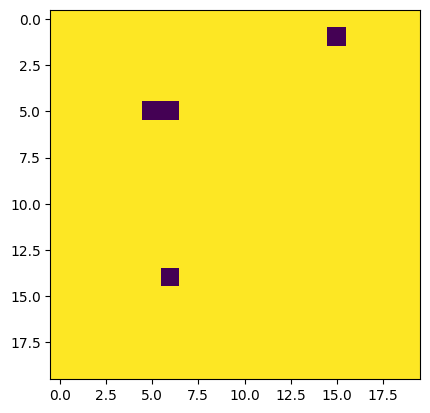

BO Step:14


sample: 100%|██████████| 4000/4000 [00:59<00:00, 67.03it/s, 7 steps of size 4.36e-01. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.03      0.06      0.03      0.11    486.03      1.00
   k_scale      0.04      0.04      0.03      0.01      0.07    573.10      1.00
     noise      0.00      0.00      0.00      0.00      0.01    836.46      1.00



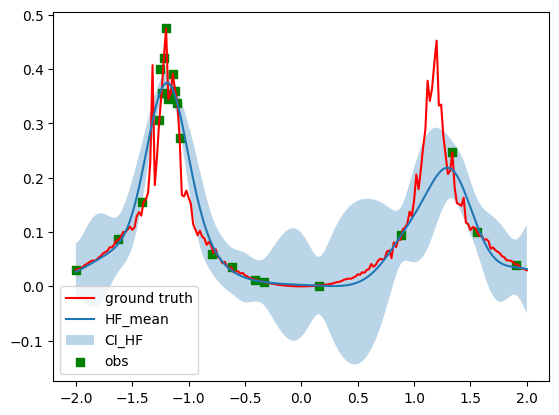

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37 167  46 178 157]
1.1400000000000001 [1.14]
Evaluation 24 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.73it/s]


Completed. Saving
Time (s) to complete simulation 15: 76.22230625152588


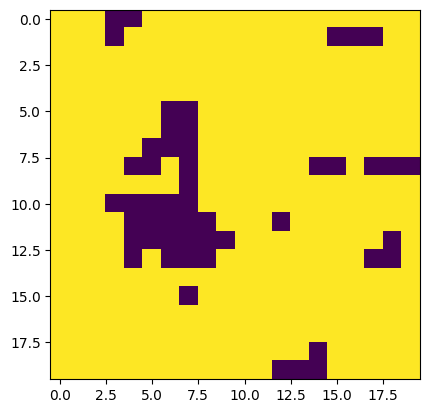

BO Step:15


sample: 100%|██████████| 4000/4000 [00:58<00:00, 68.35it/s, 3 steps of size 4.64e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.07      0.04      0.11    574.90      1.00
   k_scale      0.05      0.04      0.04      0.01      0.09    410.87      1.00
     noise      0.00      0.00      0.00      0.00      0.01   1024.63      1.00



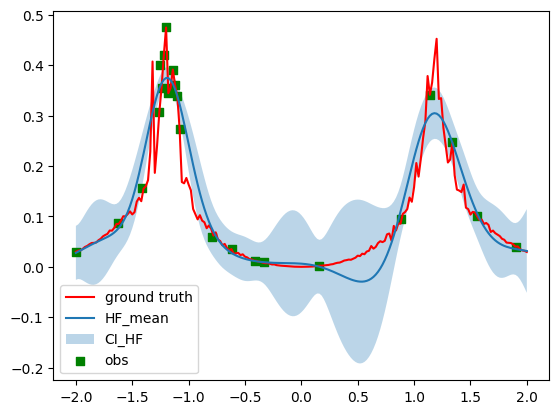

<ipython-input-30-547d4b9c6196>:64: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


[ 39  41  40  42  38  43  44 195  45  37 167  46 178 157 159]
1.1800000000000002 [1.18]
Evaluation 25 of 25

---Performing Equlibration---



100%|██████████| 500/500 [00:18<00:00, 26.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:57<00:00,  8.75it/s]


Completed. Saving
Time (s) to complete simulation 16: 75.88772654533386


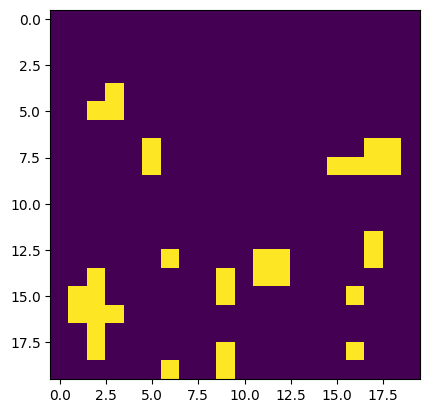

In [ ]:
N = 15
X_test =xs
X_test_full = xs
X_test_norm = (X_test-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("BO Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel='RBF', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.01)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_norm, train_y, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm, noiseless=True)
        plt.plot(xs, approx_ys_sq, label="ground truth", c="r")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )
        plt.scatter(train_x, train_y, c="g", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]

    acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test_norm, maximize=True, noiseless=True)
    acq=np.array(acq)
    acq[idx] = 0
    next_point_idx = acq.argmax()
    next_point_val = acq.max()
    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x = np.vstack((train_x, next_point))
        train_x_norm = np.vstack((train_x_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)
        Jx=train_x
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))
    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

sample: 100%|██████████| 4000/4000 [00:59<00:00, 66.97it/s, 3 steps of size 4.90e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
  k_length      0.07      0.02      0.06      0.04      0.10    993.87      1.00
   k_scale      0.05      0.04      0.04      0.01      0.09    990.28      1.00
     noise      0.00      0.00      0.00      0.00      0.00   1039.25      1.00



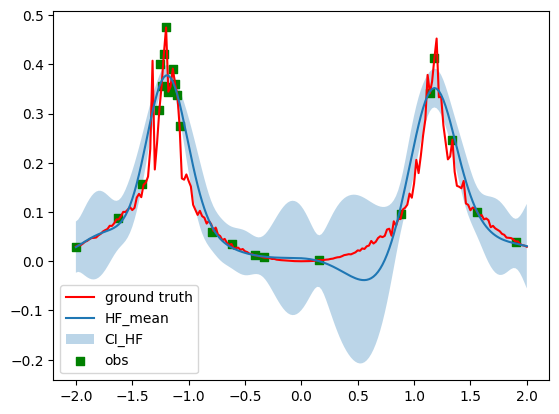

In [ ]:
gp_model = gpax.ExactGP(1, kernel='RBF', kernel_prior = kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.01)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_norm, train_y, num_chains=1)


if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
    y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm, noiseless=True)
    plt.plot(xs, approx_ys, label="ground truth", c="r")
    pred_lower = y_pred - y_sampled.std(axis=(0,1))
    pred_upper = y_pred + y_sampled.std(axis=(0,1))
    plt.plot(xs, y_pred, label="HF_mean")
    plt.fill_between(
        xs.flatten(),
        pred_lower,
        pred_upper,
        alpha=0.3,
        label="CI_HF",
    )
    plt.scatter(train_x, train_y, c="g", marker="s", label="obs")

    plt.legend(loc="best")
    plt.show()

# Multi-fidelity Bayesian Optimization

Considering square low and high fid models -- Correct models

Initial Sampling- 10 samples

In [ ]:
n = 10

np.random.seed(1)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]))

<ipython-input-14-8de86ade8ab9>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 22.35it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:15<00:00,  6.62it/s]


Completed. Saving
Time (s) to complete simulation 1: 97.95450091362


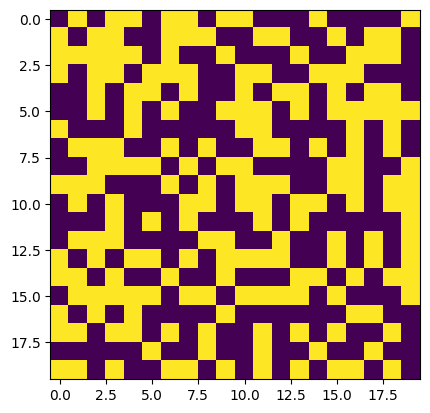

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:12<00:00,  2.59it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:30<00:00,  1.14s/it]


Completed. Saving
Time (s) to complete simulation 2: 763.4348618984222


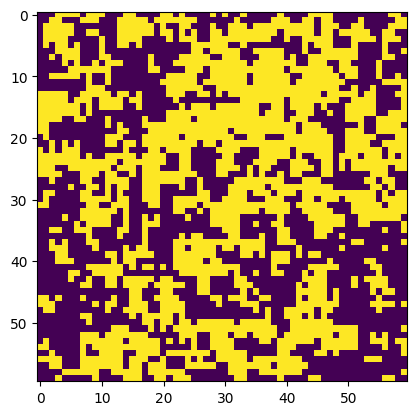

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 22.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:05<00:00,  7.58it/s]


Completed. Saving
Time (s) to complete simulation 3: 87.82010293006897


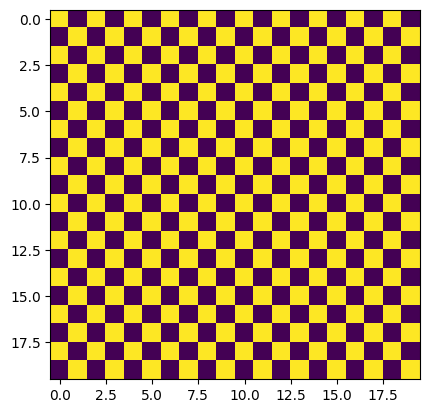

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 22.83it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:05<00:00,  7.58it/s]


Completed. Saving
Time (s) to complete simulation 4: 87.85633420944214


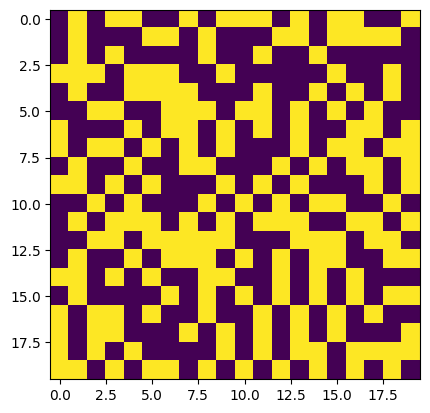

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:10<00:00,  2.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:26<00:00,  1.13s/it]

Completed. Saving
Time (s) to complete simulation 5: 756.6564724445343


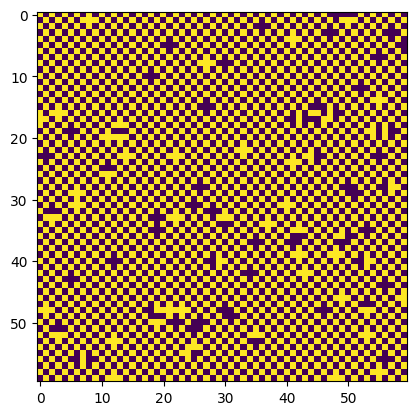

Evaluation 6 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 23.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:05<00:00,  7.66it/s]


Completed. Saving
Time (s) to complete simulation 6: 86.61354684829712


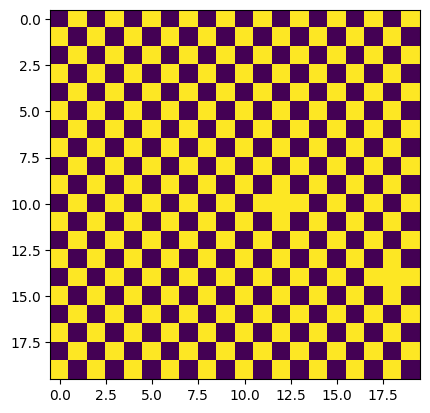

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 23.30it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:05<00:00,  7.65it/s]


Completed. Saving
Time (s) to complete simulation 7: 86.82828068733215


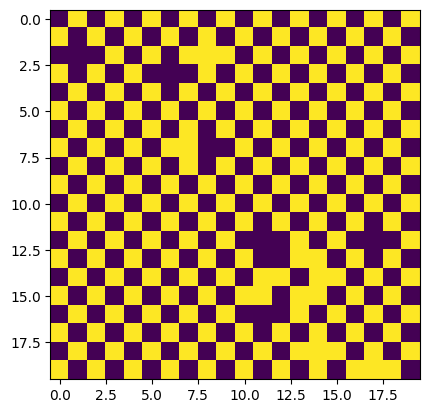

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 23.13it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:05<00:00,  7.67it/s]


Completed. Saving
Time (s) to complete simulation 8: 86.85750651359558


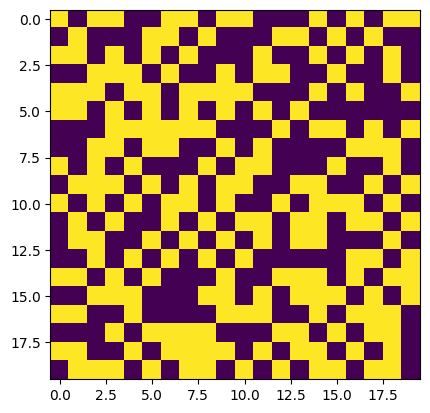

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:11<00:00,  2.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:34<00:00,  1.15s/it]


Completed. Saving
Time (s) to complete simulation 9: 765.9792070388794


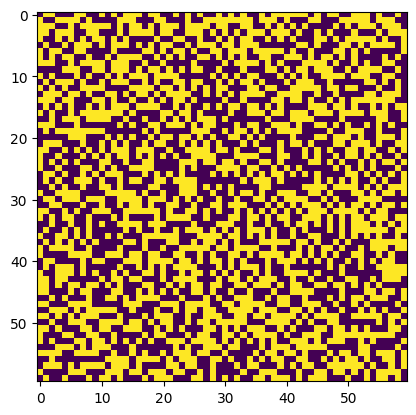

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 22.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:06<00:00,  7.52it/s]


Completed. Saving
Time (s) to complete simulation 10: 88.51999282836914


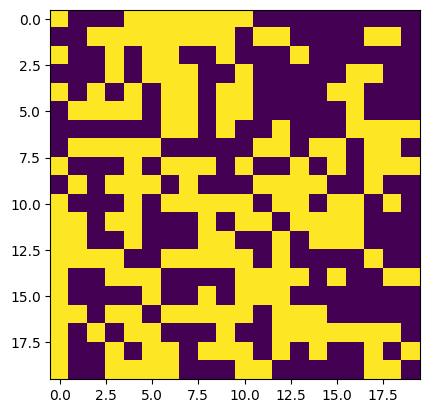

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

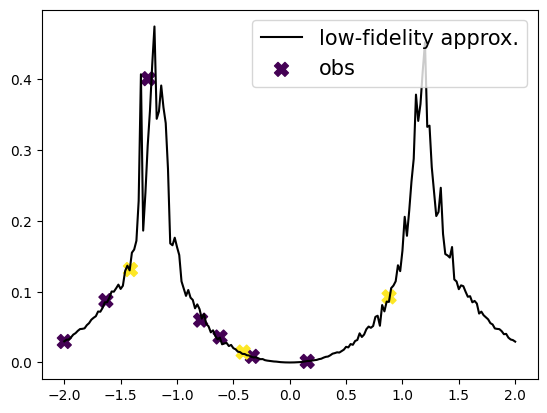

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

Run BO- 25 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]),
 array([[0.00865403],
        [0.09279848],
        [0.02968125],
        [0.05988589],
        [0.13141094],
        [0.08751802],
        [0.40115651],
        [0.03599105],
        [0.01471007],
        [0.0015186

Step:1


sample: 100%|██████████| 4000/4000 [00:37<00:00, 107.03it/s, 7 steps of size 6.35e-01. acc. prob=0.86]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.57      0.28      0.59      0.16      1.00   1833.03      1.00
  k_length      0.07      0.01      0.06      0.05      0.08   1826.01      1.00
   k_scale      0.07      0.01      0.07      0.05      0.09   1955.11      1.00
     noise      1.72      2.37      1.05      0.05      3.68   1714.00      1.00



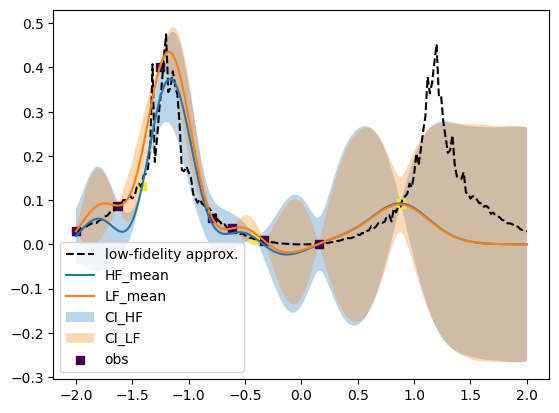

(402,)


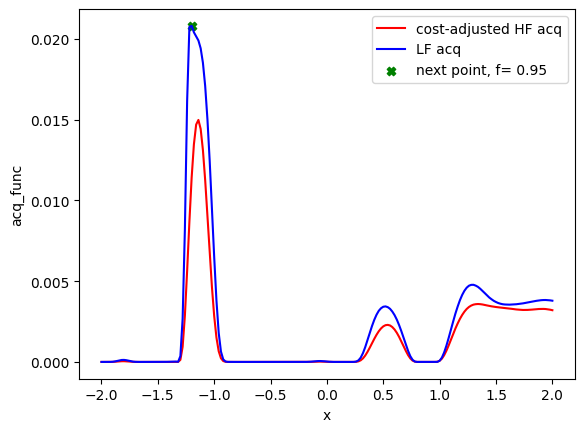

40
[-1.2   0.95] -1.2
Evaluation 11 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 60.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.65it/s]


Completed. Saving
Time (s) to complete simulation 2: 28.514975786209106


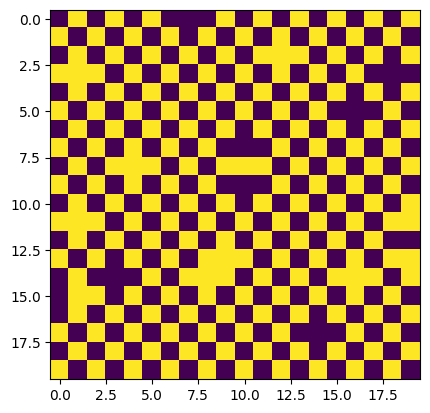

Step:2


sample: 100%|██████████| 4000/4000 [00:45<00:00, 88.35it/s, 7 steps of size 5.40e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.39      0.28      0.35      0.00      0.81   2063.40      1.00
  k_length      0.06      0.01      0.06      0.05      0.07   1450.31      1.00
   k_scale      0.07      0.01      0.07      0.05      0.09   1590.05      1.00
     noise      1.67      2.14      1.01      0.03      3.65   1858.63      1.00



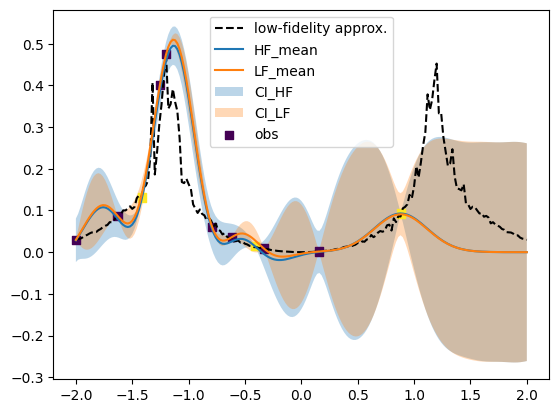

(402,)


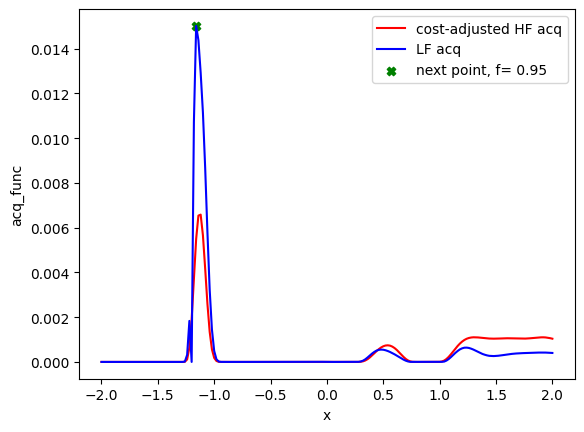

[40 42]
[-1.16  0.95] -1.1600000000000001
Evaluation 12 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.22it/s]


Completed. Saving
Time (s) to complete simulation 3: 28.99613881111145


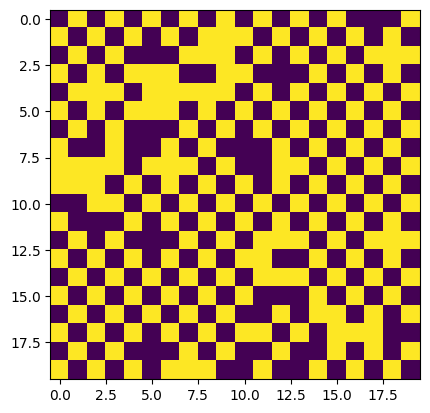

Step:3


sample: 100%|██████████| 4000/4000 [00:44<00:00, 90.42it/s, 7 steps of size 4.93e-01. acc. prob=0.93] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.94      0.05      0.96      0.87      1.00   1936.44      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2493.20      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2109.98      1.00
     noise      1.78      2.56      1.05      0.07      3.88   1403.39      1.00



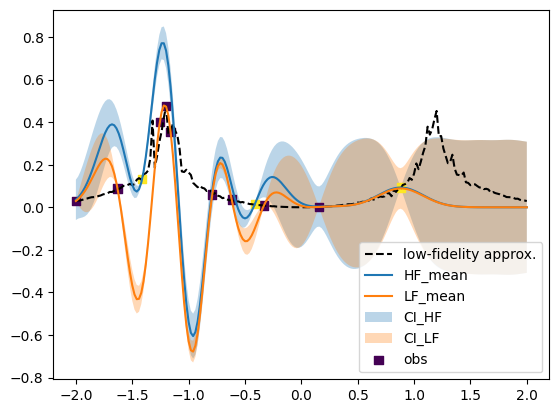

(402,)


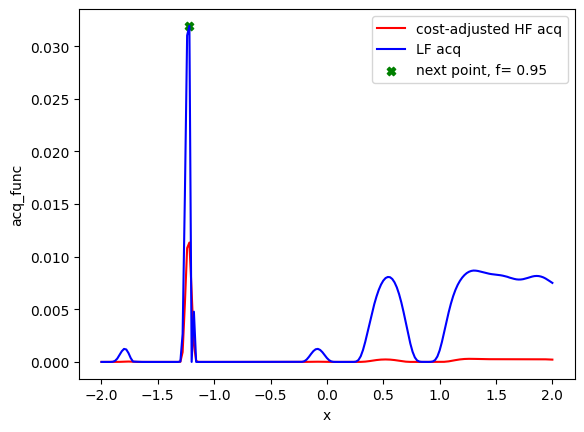

[40 42 39]
[-1.22  0.95] -1.22
Evaluation 13 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 60.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.45it/s]


Completed. Saving
Time (s) to complete simulation 4: 28.72758460044861


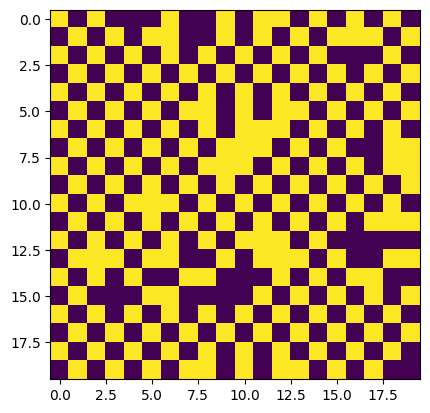

Step:4


sample: 100%|██████████| 4000/4000 [00:44<00:00, 89.45it/s, 7 steps of size 5.15e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.81      0.15      0.85      0.60      1.00   2253.32      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2218.30      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1834.60      1.00
     noise      1.75      2.63      1.04      0.04      3.63   1476.92      1.00



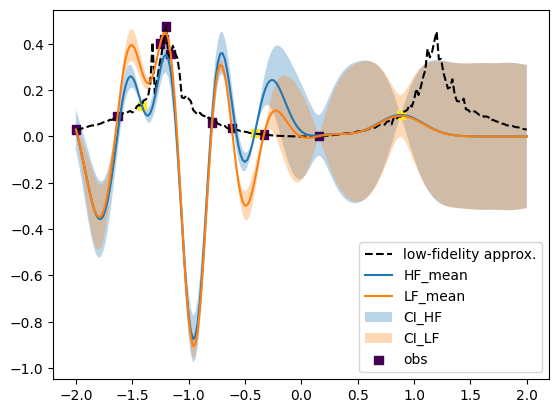

(402,)


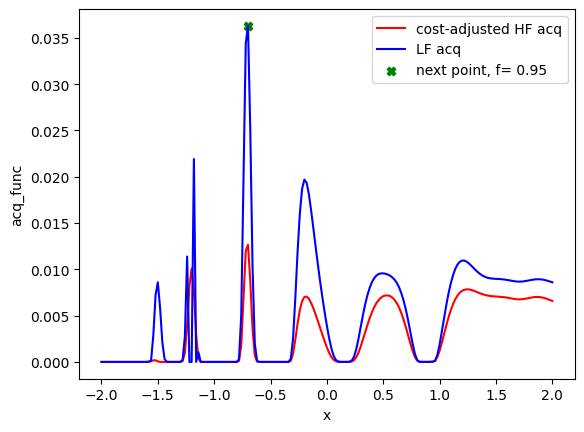

[40 42 39 65]
[-0.7   0.95] -0.7
Evaluation 14 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 57.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.97it/s]


Completed. Saving
Time (s) to complete simulation 5: 29.556790351867676


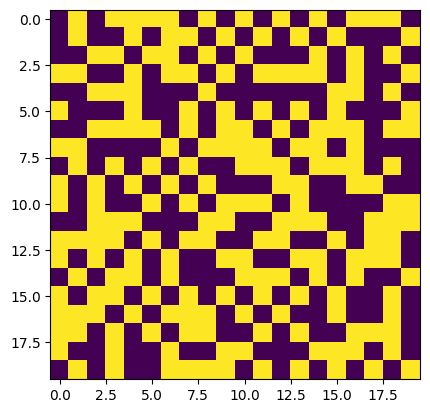

Step:5


sample: 100%|██████████| 4000/4000 [00:46<00:00, 86.87it/s, 7 steps of size 5.08e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.78      0.16      0.81      0.55      1.00   2231.53      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1923.54      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1999.97      1.00
     noise      1.77      2.65      1.01      0.04      3.75   1439.71      1.00



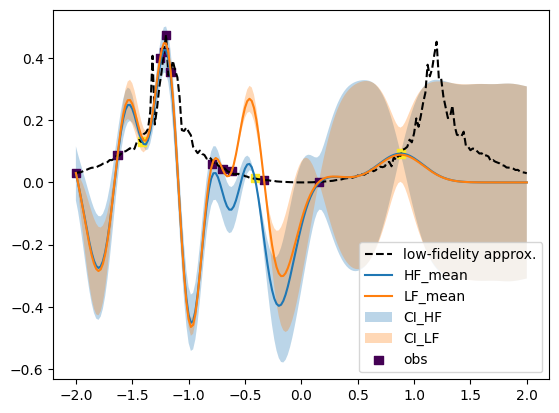

(402,)


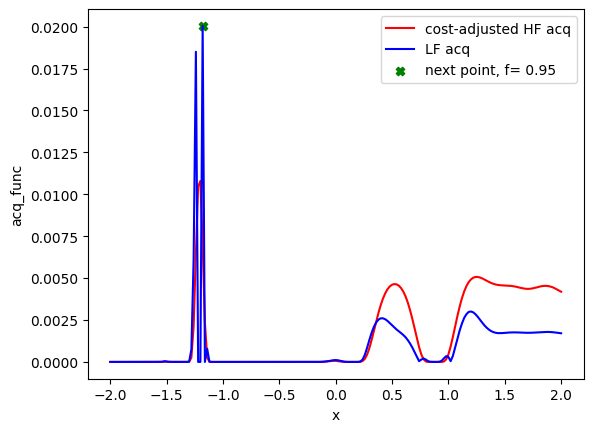

[40 42 39 65 41]
[-1.18  0.95] -1.18
Evaluation 15 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.88it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.38it/s]


Completed. Saving
Time (s) to complete simulation 6: 29.01368236541748


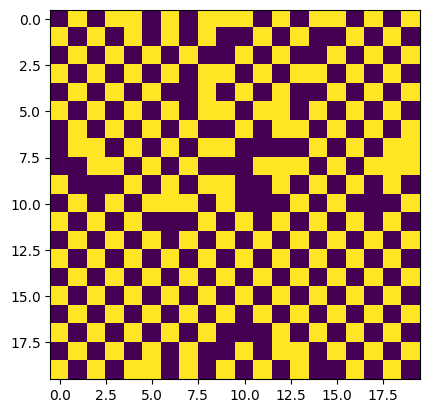

Step:6


sample: 100%|██████████| 4000/4000 [00:47<00:00, 83.83it/s, 7 steps of size 5.32e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.93      0.07      0.95      0.83      1.00   1944.74      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2148.25      1.00
   k_scale      0.10      0.00      0.10      0.09      0.10   2065.36      1.00
     noise      1.70      2.55      1.01      0.03      3.74   1950.20      1.00



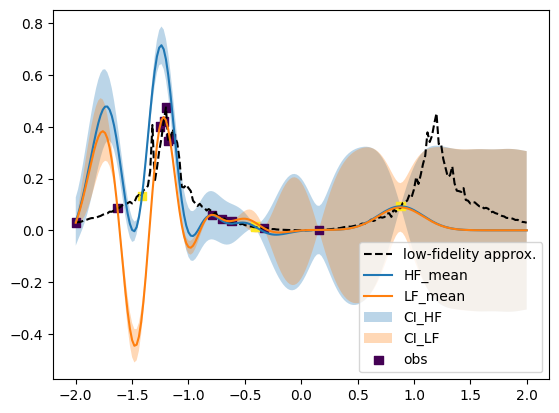

(402,)


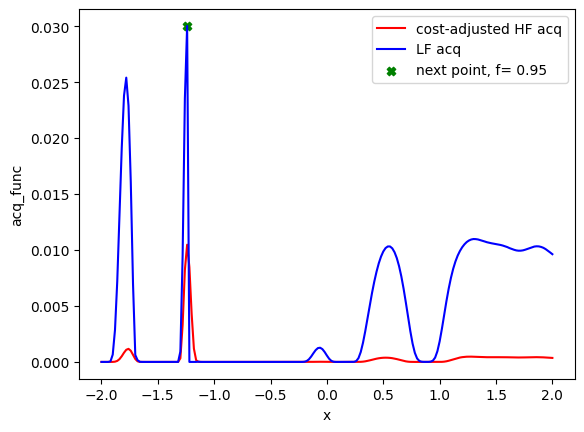

[40 42 39 65 41 38]
[-1.24  0.95] -1.24
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.80it/s]


Completed. Saving
Time (s) to complete simulation 7: 29.482277870178223


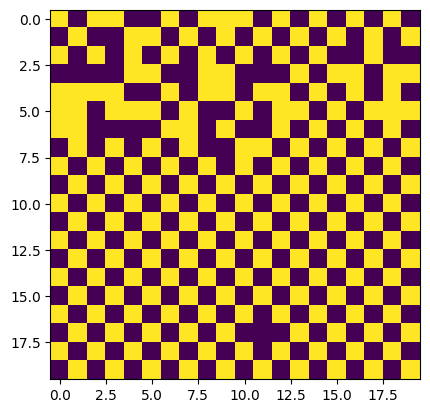

Step:7


sample: 100%|██████████| 4000/4000 [00:35<00:00, 111.44it/s, 7 steps of size 5.71e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.67      0.22      0.70      0.35      1.00   1966.20      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2230.51      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2652.26      1.00
     noise      1.76      2.51      1.06      0.03      3.76   1480.82      1.00



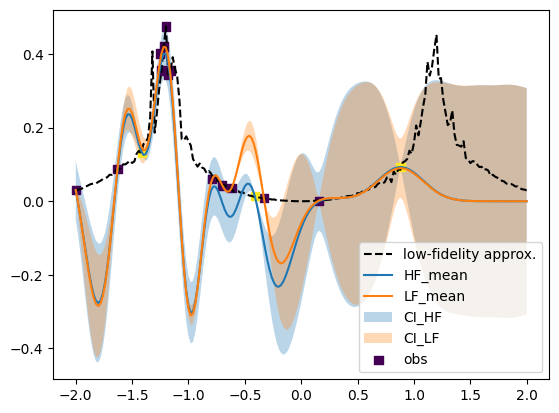

(402,)


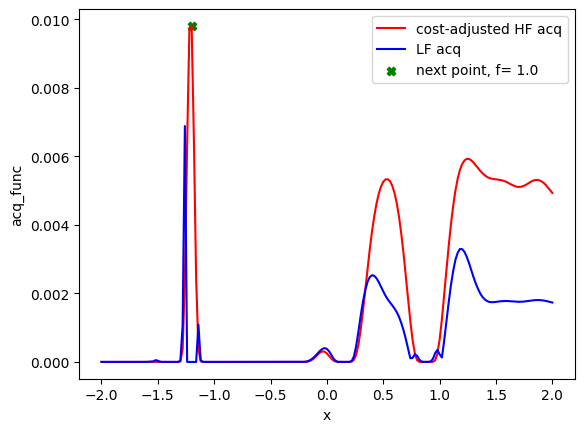

[ 40  42  39  65  41  38 241]
[-1.2  1. ] -1.2
Evaluation 17 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:14<00:00,  6.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:57<00:00,  2.81it/s]


Completed. Saving
Time (s) to complete simulation 8: 252.22096180915833


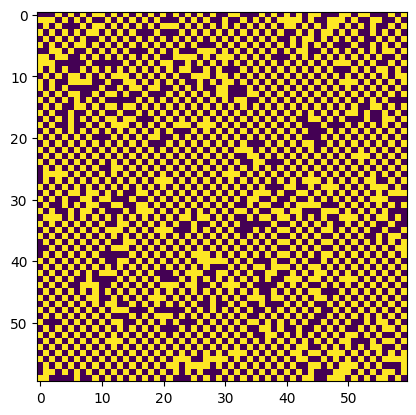

Step:8


sample: 100%|██████████| 4000/4000 [00:53<00:00, 74.90it/s, 7 steps of size 5.07e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.69      0.20      0.72      0.41      1.00   2071.06      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2285.24      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1954.31      1.00
     noise      1.74      2.32      1.04      0.07      3.82   1605.16      1.00



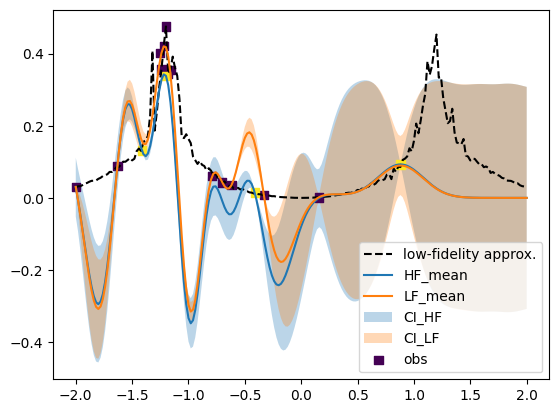

(402,)


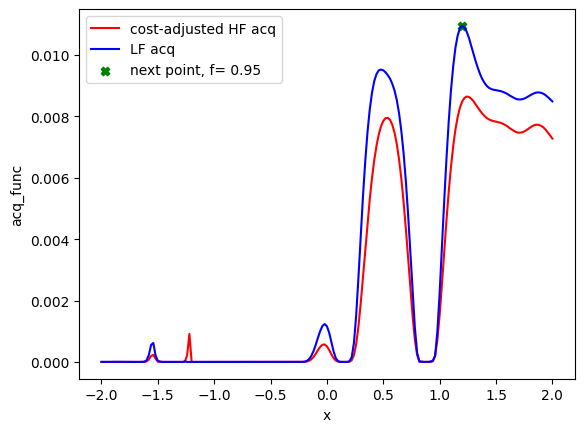

[ 40  42  39  65  41  38 241 160]
[1.2  0.95] 1.2000000000000002
Evaluation 18 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.23it/s]


Completed. Saving
Time (s) to complete simulation 9: 30.087111711502075


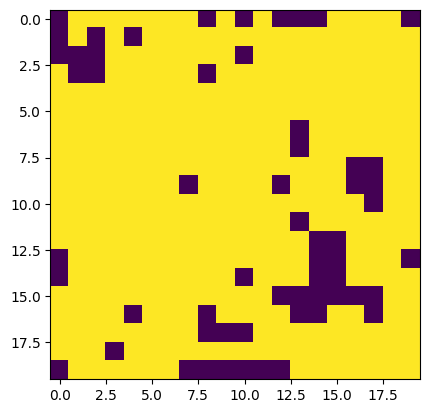

Step:9


sample: 100%|██████████| 4000/4000 [00:54<00:00, 73.53it/s, 7 steps of size 4.91e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.69      0.20      0.72      0.41      1.00   2129.28      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2314.01      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1630.03      1.00
     noise      1.76      2.46      1.04      0.05      3.84   1707.35      1.00



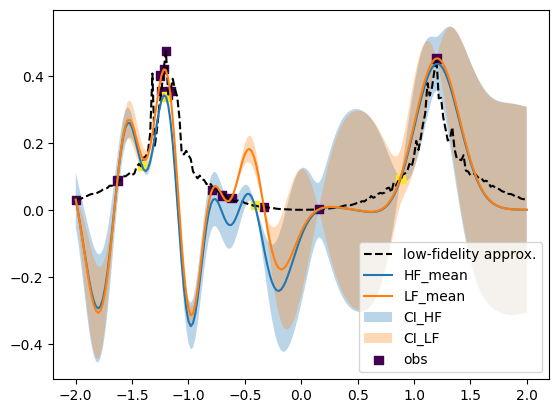

(402,)


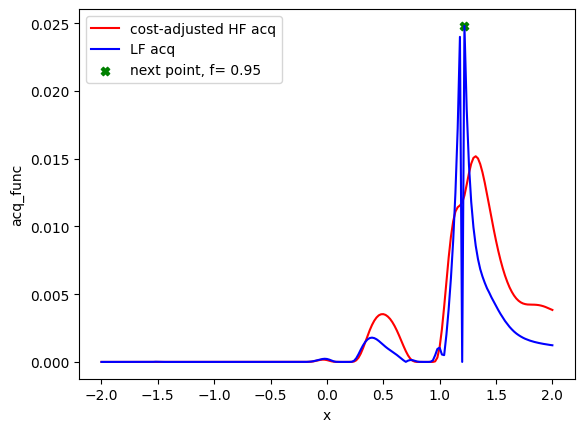

[ 40  42  39  65  41  38 241 160 161]
[1.22 0.95] 1.2200000000000002
Evaluation 19 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.81it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.66it/s]


Completed. Saving
Time (s) to complete simulation 10: 29.501753330230713


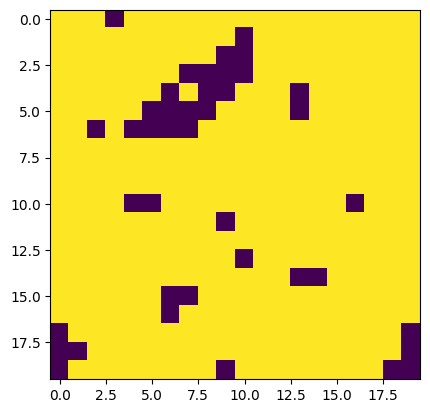

Step:10


sample: 100%|██████████| 4000/4000 [00:56<00:00, 70.29it/s, 7 steps of size 5.10e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.70      0.20      0.73      0.41      1.00   1853.60      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2439.00      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1751.69      1.00
     noise      1.70      2.22      1.01      0.05      3.61   1542.69      1.00



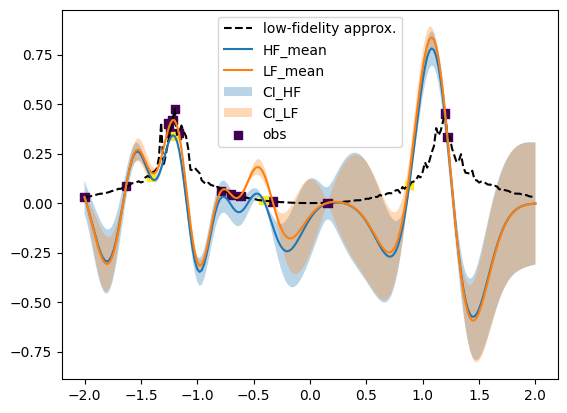

(402,)


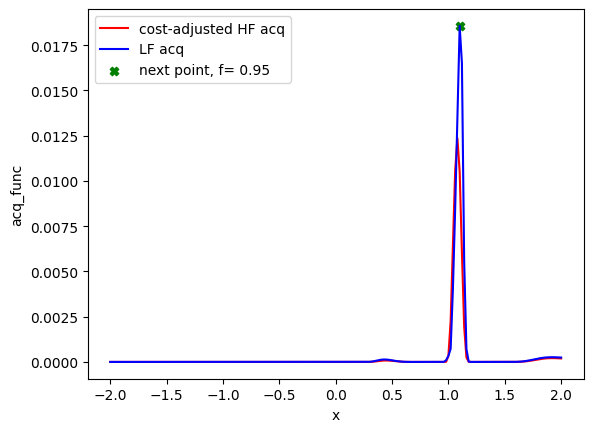

[ 40  42  39  65  41  38 241 160 161 155]
[1.1  0.95] 1.1
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.43it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.61it/s]


Completed. Saving
Time (s) to complete simulation 11: 29.747561931610107


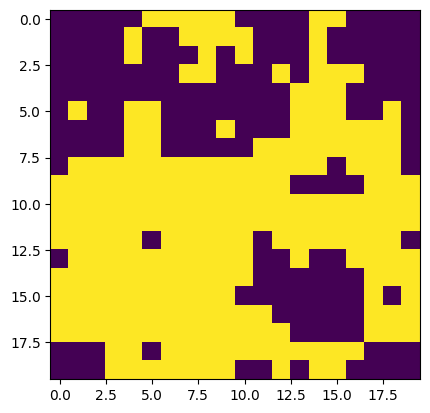

Step:11


sample: 100%|██████████| 4000/4000 [00:57<00:00, 69.27it/s, 7 steps of size 5.30e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.88      0.11      0.91      0.73      1.00   2262.23      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2161.38      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2242.36      1.00
     noise      1.77      2.52      1.06      0.04      3.76   1711.14      1.00



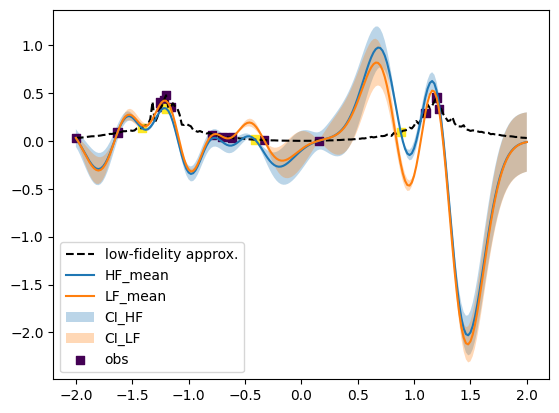

(402,)


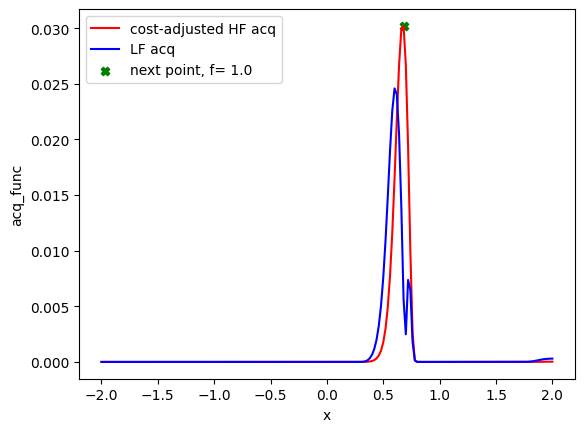

[ 40  42  39  65  41  38 241 160 161 155 335]
[0.68 1.  ] 0.6800000000000002
Evaluation 21 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:16<00:00,  6.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [03:01<00:00,  2.75it/s]

Completed. Saving
Time (s) to complete simulation 12: 258.57729268074036


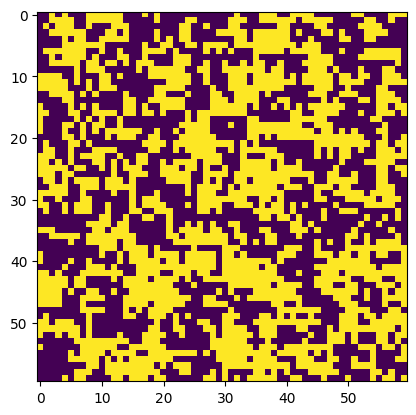

Step:12


sample: 100%|██████████| 4000/4000 [01:03<00:00, 63.24it/s, 7 steps of size 5.40e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.92      0.07      0.94      0.82      1.00   2059.83      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2342.43      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2035.83      1.00
     noise      1.71      2.53      1.03      0.03      3.54   1660.83      1.00



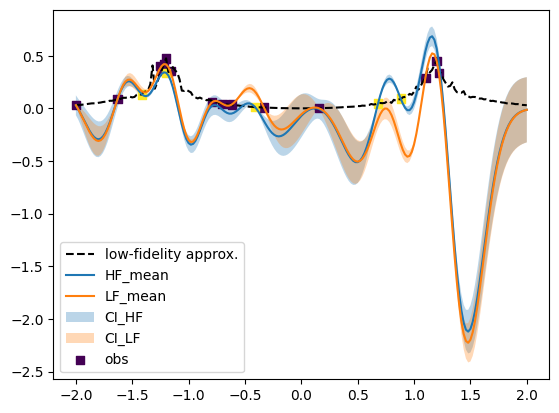

(402,)


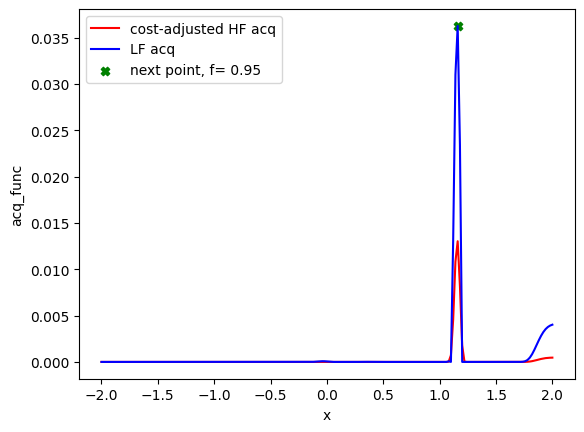

[ 40  42  39  65  41  38 241 160 161 155 335 158]
[1.16 0.95] 1.1600000000000001
Evaluation 22 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:10<00:00, 47.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:24<00:00, 20.53it/s]


Completed. Saving
Time (s) to complete simulation 13: 34.963584661483765


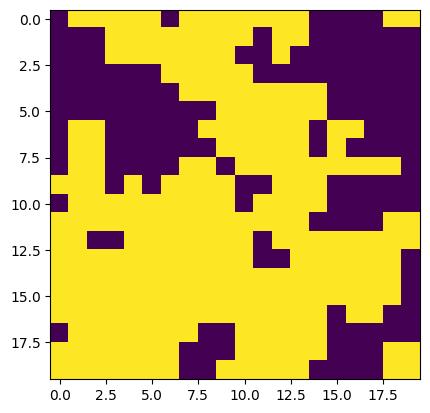

Step:13


sample: 100%|██████████| 4000/4000 [01:03<00:00, 62.89it/s, 7 steps of size 4.80e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.99      0.01      0.99      0.98      1.00   2186.62      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2597.54      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1517.32      1.00
     noise      1.87      2.82      1.04      0.05      4.01   1564.01      1.00



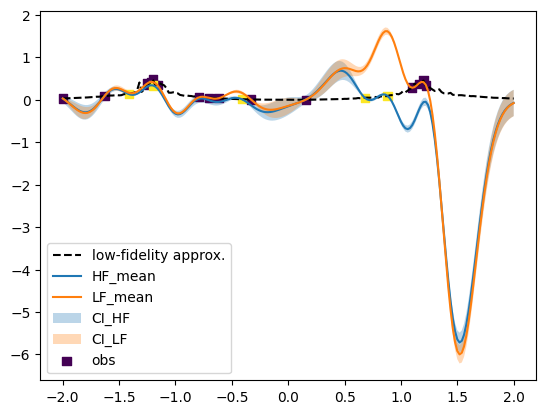

(402,)


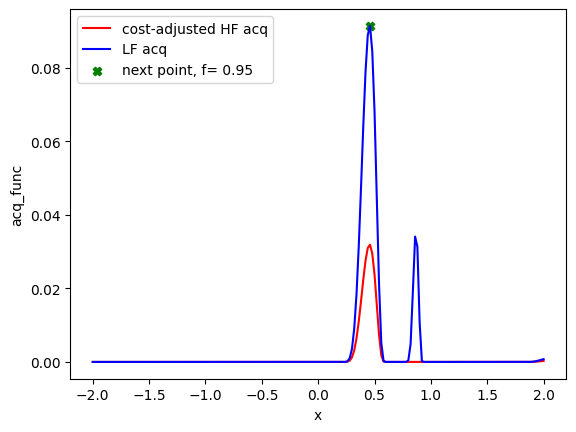

[ 40  42  39  65  41  38 241 160 161 155 335 158 123]
[0.46 0.95] 0.45999999999999996
Evaluation 23 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:09<00:00, 53.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.51it/s]


Completed. Saving
Time (s) to complete simulation 14: 30.55586266517639


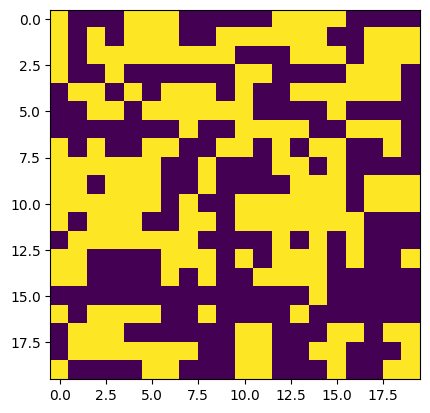

Step:14


sample: 100%|██████████| 4000/4000 [01:07<00:00, 59.58it/s, 7 steps of size 5.20e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.99      0.01      0.99      0.98      1.00   1930.28      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2422.33      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1730.31      1.00
     noise      1.78      2.59      1.07      0.04      3.83   1542.93      1.00



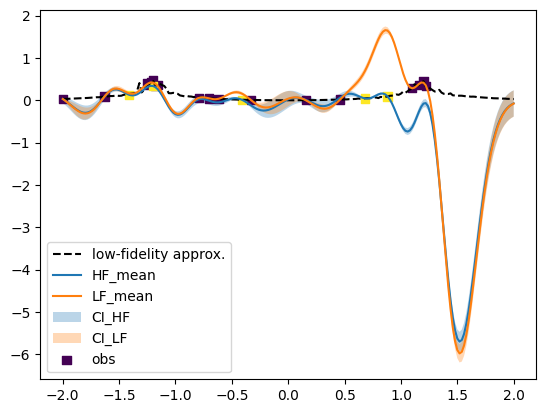

(402,)


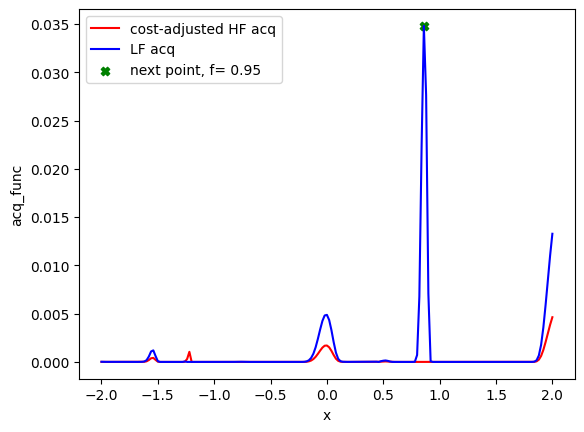

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143]
[0.86 0.95] 0.8599999999999999
Evaluation 24 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 57.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.51it/s]


Completed. Saving
Time (s) to complete simulation 15: 30.049674034118652


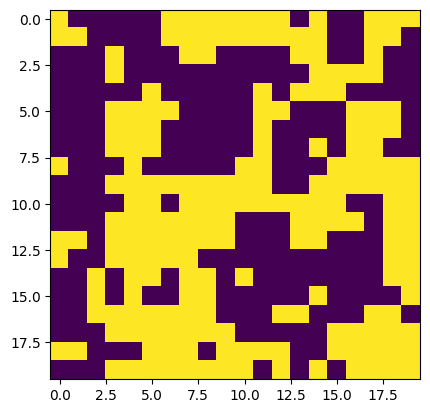

Step:15


sample: 100%|██████████| 4000/4000 [01:06<00:00, 60.04it/s, 7 steps of size 5.57e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.97      0.03      0.98      0.92      1.00   1667.14      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2509.26      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2212.23      1.00
     noise      1.66      2.38      1.01      0.04      3.50   1733.26      1.00



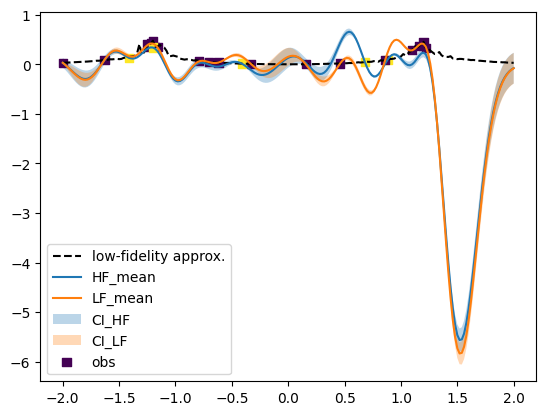

(402,)


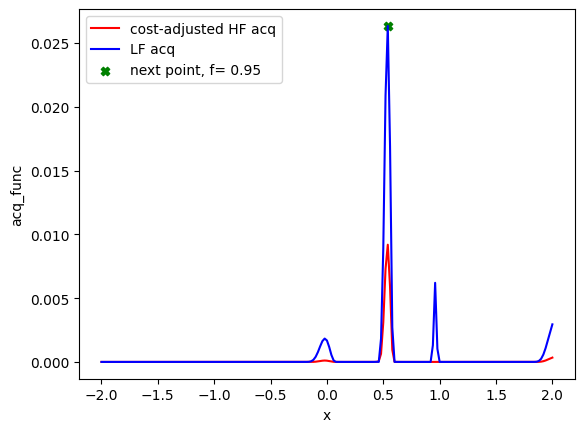

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127]
[0.54 0.95] 0.54
Evaluation 25 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 57.41it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.23it/s]


Completed. Saving
Time (s) to complete simulation 16: 30.245145797729492


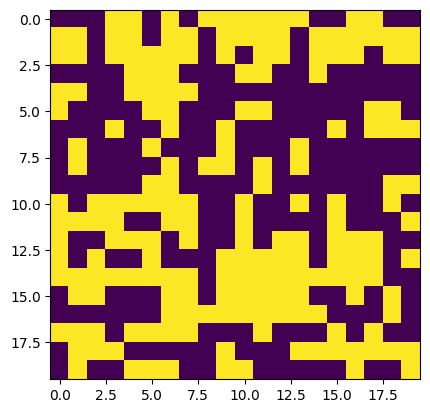

Step:16


sample: 100%|██████████| 4000/4000 [01:14<00:00, 54.04it/s, 15 steps of size 4.58e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.98      0.02      0.98      0.95      1.00   2318.97      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2049.53      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1665.33      1.00
     noise      1.68      2.30      1.02      0.05      3.62   1716.88      1.00



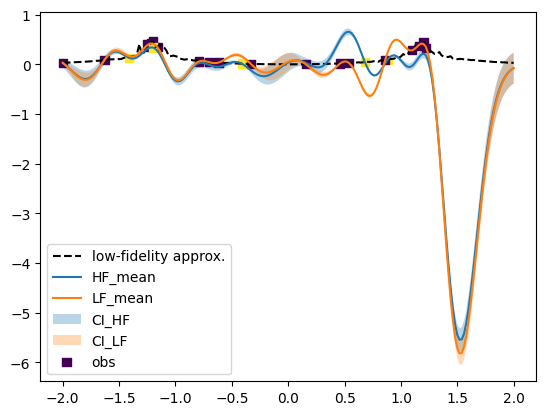

(402,)


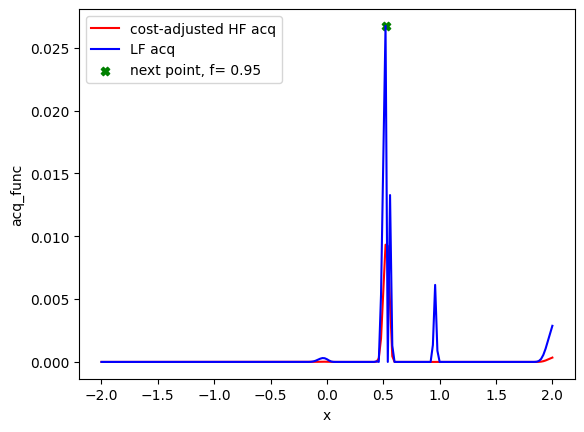

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126]
[0.52 0.95] 0.52
Evaluation 26 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:09<00:00, 55.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.23it/s]


Completed. Saving
Time (s) to complete simulation 17: 30.63128685951233


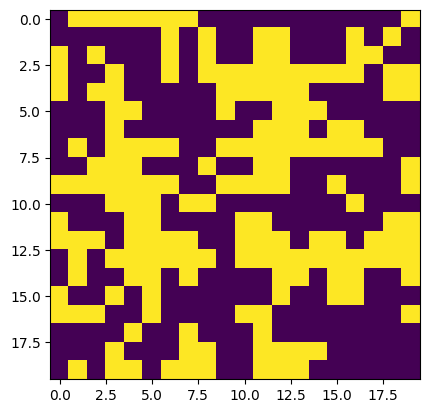

Step:17


sample: 100%|██████████| 4000/4000 [01:13<00:00, 54.45it/s, 7 steps of size 5.21e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.93      0.06      0.95      0.84      1.00   2077.14      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2243.92      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1653.11      1.00
     noise      1.81      2.69      1.06      0.03      3.83   1682.53      1.00



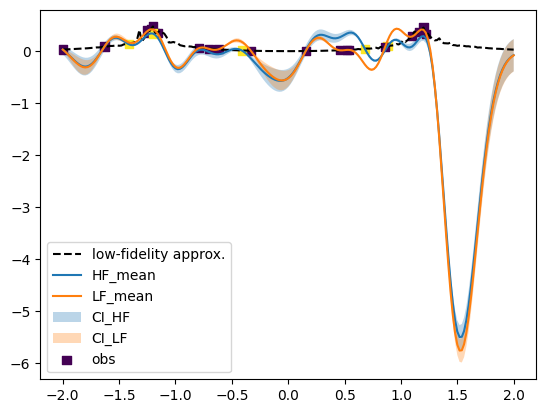

(402,)


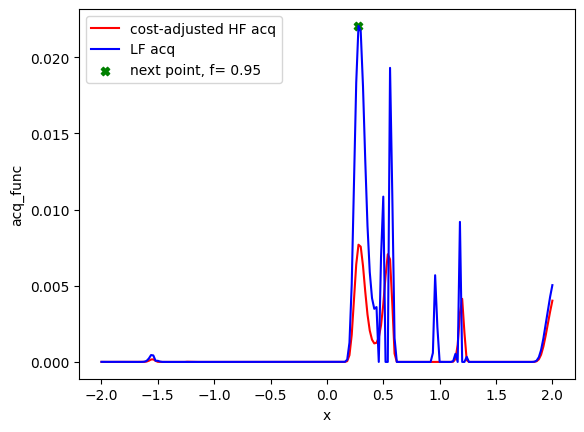

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114]
[0.28 0.95] 0.28000000000000025
Evaluation 27 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 55.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.03it/s]


Completed. Saving
Time (s) to complete simulation 18: 30.668147325515747


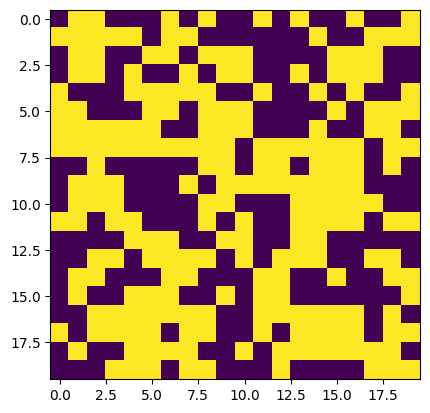

Step:18


sample: 100%|██████████| 4000/4000 [01:15<00:00, 53.17it/s, 7 steps of size 6.02e-01. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.91      0.07      0.93      0.81      1.00   1766.36      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2089.33      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2043.49      1.00
     noise      1.80      2.66      1.04      0.06      3.82   1485.08      1.00



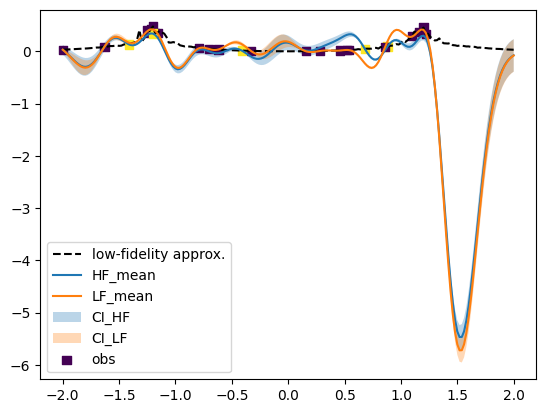

(402,)


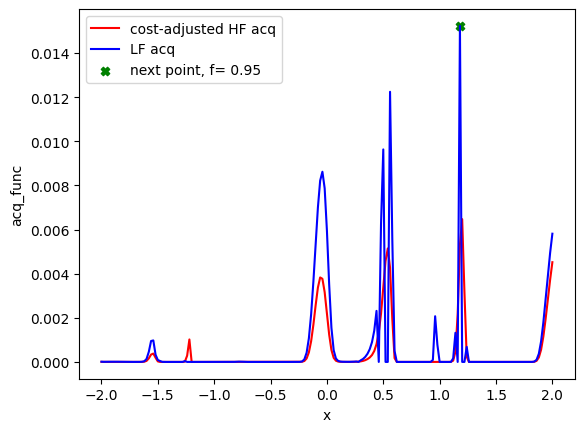

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159]
[1.18 0.95] 1.1800000000000002
Evaluation 28 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.06it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.31it/s]


Completed. Saving
Time (s) to complete simulation 19: 30.082759380340576


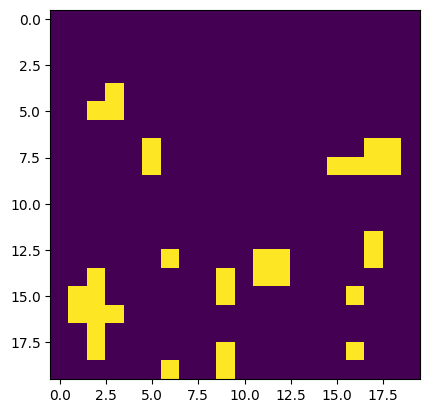

Step:19


sample: 100%|██████████| 4000/4000 [01:18<00:00, 50.97it/s, 7 steps of size 4.96e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.92      0.07      0.94      0.81      1.00   1830.23      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2449.56      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1577.94      1.00
     noise      1.79      2.56      1.04      0.05      3.93   1625.63      1.00



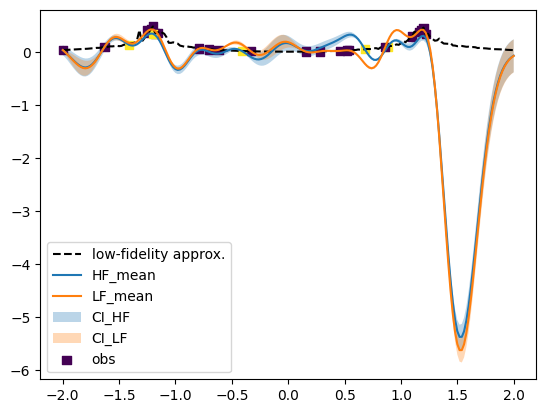

(402,)


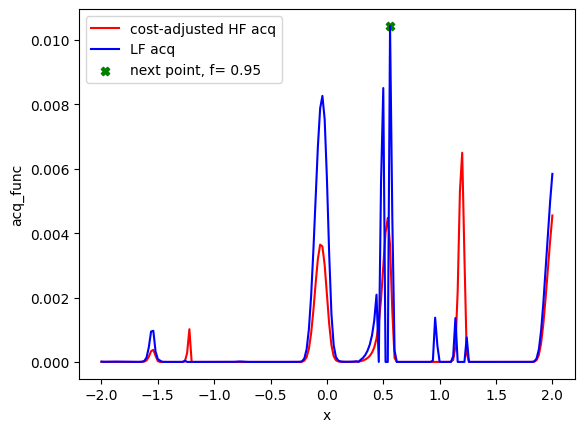

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128]
[0.56 0.95] 0.56
Evaluation 29 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 56.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.28it/s]


Completed. Saving
Time (s) to complete simulation 20: 30.39924168586731


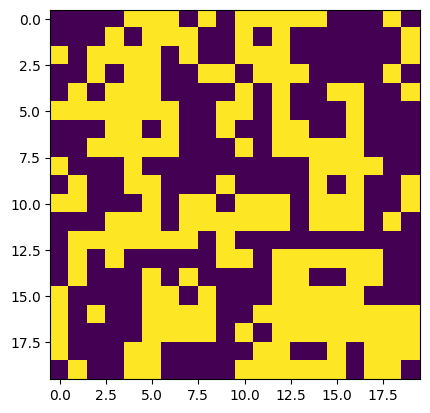

Step:20


sample: 100%|██████████| 4000/4000 [01:23<00:00, 47.92it/s, 7 steps of size 5.12e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.88      0.10      0.90      0.74      1.00   2115.89      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2317.27      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   2087.02      1.00
     noise      1.79      2.64      1.03      0.04      3.81   1316.83      1.00



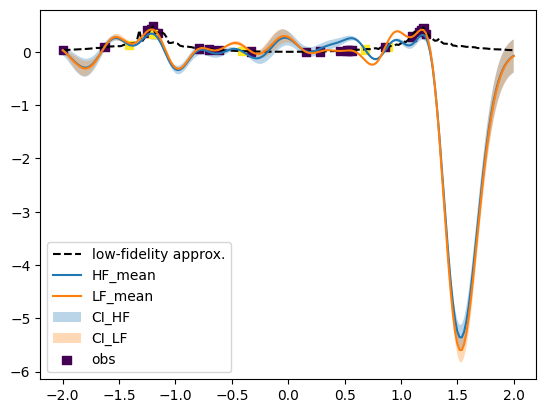

(402,)


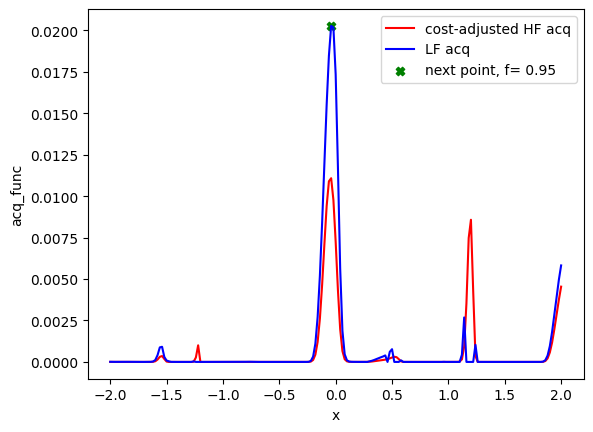

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98]
[-0.04  0.95] -0.040000000000000036
Evaluation 30 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 55.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.38it/s]


Completed. Saving
Time (s) to complete simulation 21: 30.390774250030518


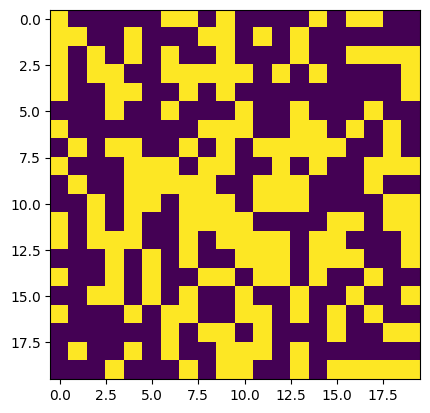

Step:21


sample: 100%|██████████| 4000/4000 [01:24<00:00, 47.27it/s, 7 steps of size 4.84e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.88      0.10      0.91      0.75      1.00   2208.59      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2091.97      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1817.71      1.00
     noise      1.77      2.55      1.05      0.05      3.84   1591.84      1.00



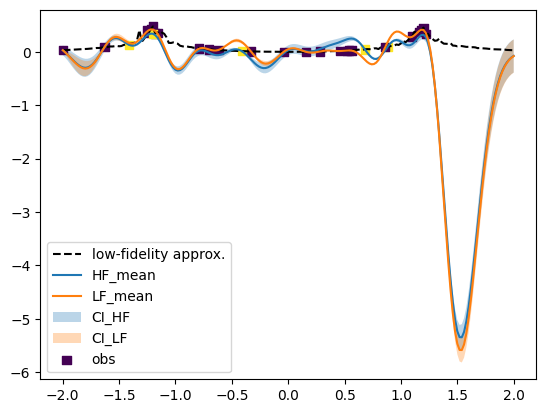

(402,)


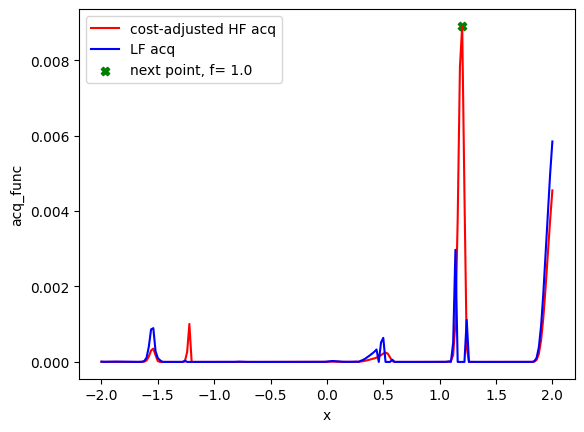

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98 361]
[1.2 1. ] 1.2000000000000002
Evaluation 31 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:14<00:00,  6.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:58<00:00,  2.81it/s]

Completed. Saving
Time (s) to complete simulation 22: 252.69819140434265


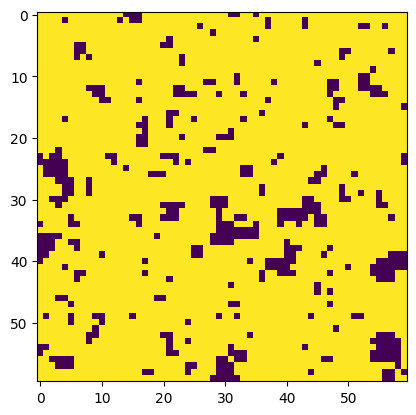

Step:22


sample: 100%|██████████| 4000/4000 [01:32<00:00, 43.12it/s, 15 steps of size 4.41e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.87      0.10      0.90      0.73      1.00   2186.45      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1820.06      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1820.10      1.00
     noise      1.75      2.46      1.04      0.06      3.73   1412.93      1.00



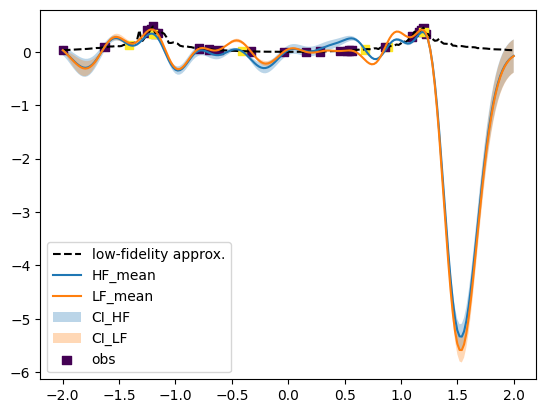

(402,)


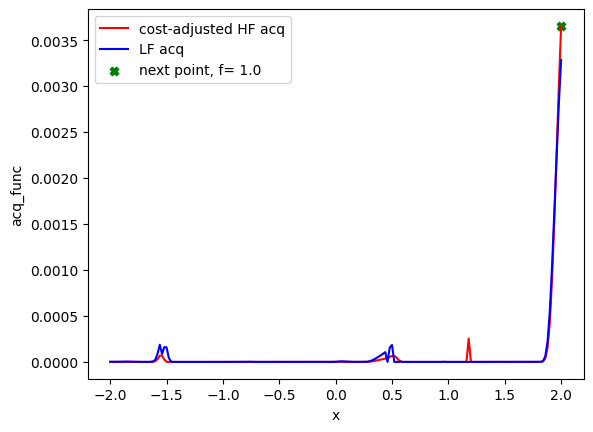

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98 361 401]
[2. 1.] 2.0
Evaluation 32 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:13<00:00,  6.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Completed. Saving
Time (s) to complete simulation 23: 252.94183135032654


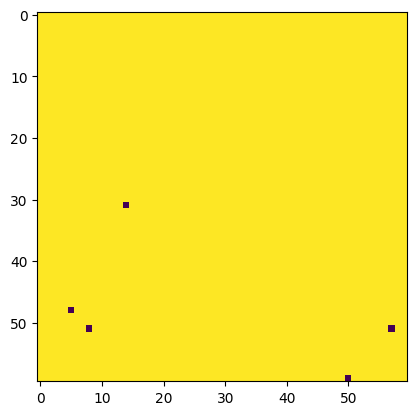

Step:23


sample: 100%|██████████| 4000/4000 [00:36<00:00, 108.16it/s, 7 steps of size 4.64e-01. acc. prob=0.92]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.88      0.10      0.90      0.74      1.00   1849.70      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2417.48      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1640.25      1.00
     noise      1.79      2.63      1.02      0.05      3.94   1593.16      1.00



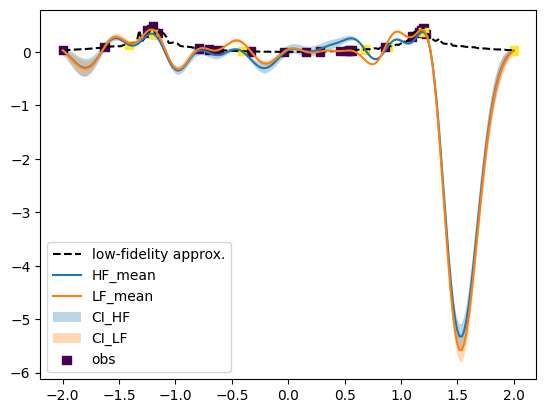

(402,)


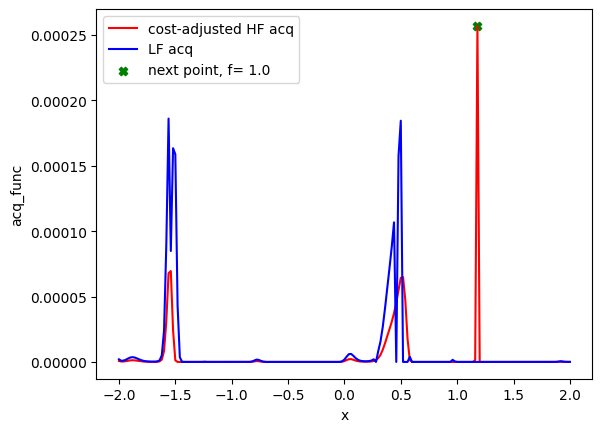

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98 361 401 360]
[1.18 1.  ] 1.1800000000000002
Evaluation 33 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:17<00:00,  6.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [03:06<00:00,  2.67it/s]

Completed. Saving
Time (s) to complete simulation 24: 264.03535079956055


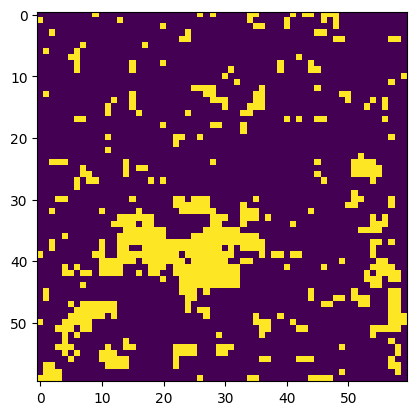

Step:24


sample: 100%|██████████| 4000/4000 [00:41<00:00, 96.86it/s, 15 steps of size 4.74e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      1.00      0.00      1.00      0.99      1.00   2169.97      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2045.08      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1637.49      1.00
     noise      1.81      2.67      1.04      0.05      3.90   1560.12      1.00



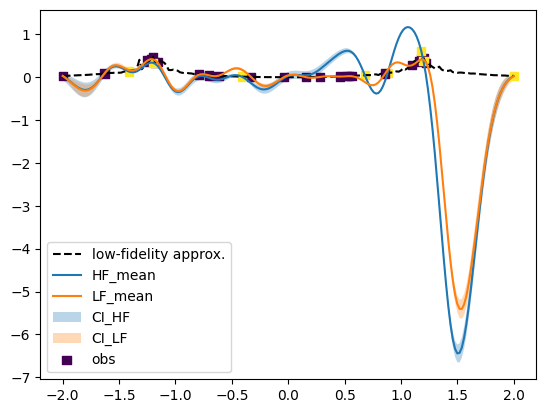

(402,)


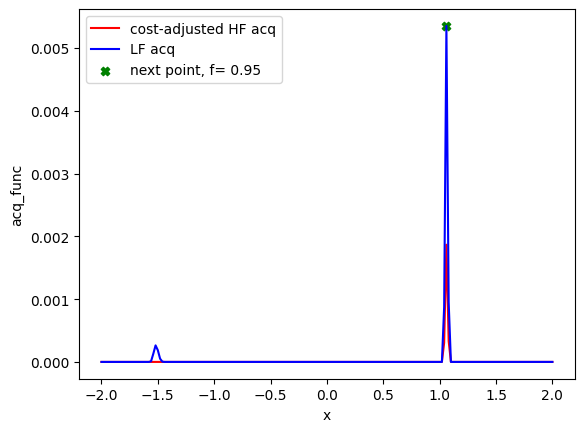

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98 361 401 360 153]
[1.06 0.95] 1.06
Evaluation 34 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.65it/s]


Completed. Saving
Time (s) to complete simulation 25: 29.776517391204834


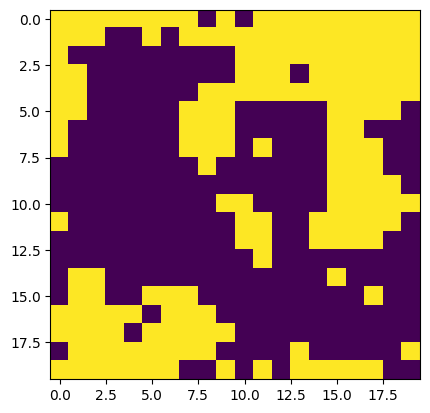

Step:25


sample: 100%|██████████| 4000/4000 [00:41<00:00, 97.15it/s, 15 steps of size 4.93e-01. acc. prob=0.94]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      1.00      0.00      1.00      0.99      1.00   2210.80      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1974.96      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1925.96      1.00
     noise      1.78      2.68      1.04      0.05      3.78   1692.66      1.00



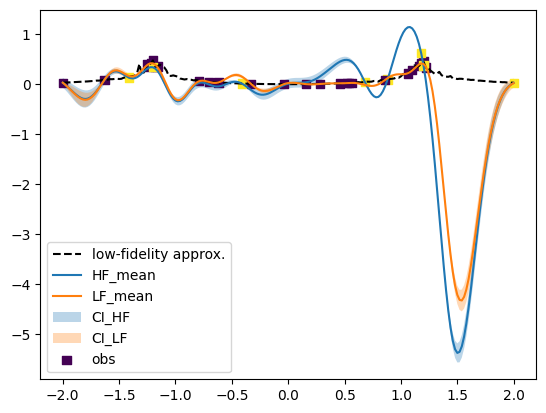

(402,)


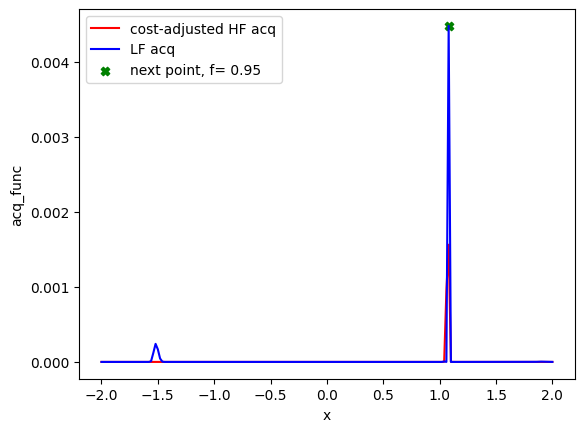

[ 40  42  39  65  41  38 241 160 161 155 335 158 123 143 127 126 114 159
 128  98 361 401 360 153 154]
[1.08 0.95] 1.08
Evaluation 35 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.22it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.89it/s]


Completed. Saving
Time (s) to complete simulation 26: 29.533787727355957


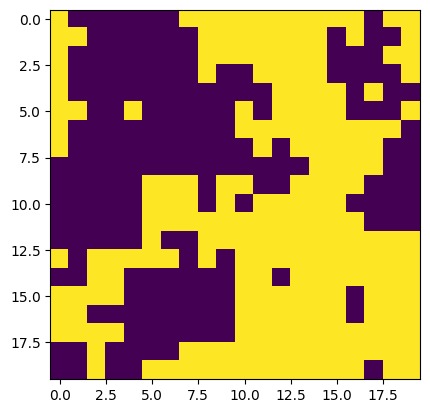

In [ ]:
N = 25
cost_ratio = 8.6/3 #time complexities
f = np.array([1.0, 2.0])
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_hf, X_test_lf))
X_test_full = np.vstack((X_test_hf, X_test_lf))
X_test_norm = np.vstack((X_test_hf, X_test_lf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.LogNormal(0, 1)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

#Final GP prediction

sample: 100%|██████████| 4000/4000 [00:40<00:00, 99.25it/s, 15 steps of size 5.00e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      1.00      0.00      1.00      0.99      1.00   2328.59      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1997.33      1.00
   k_scale      0.10      0.00      0.10      0.10      0.10   1706.68      1.00
     noise      1.77      2.59      1.01      0.05      3.92   1766.60      1.00



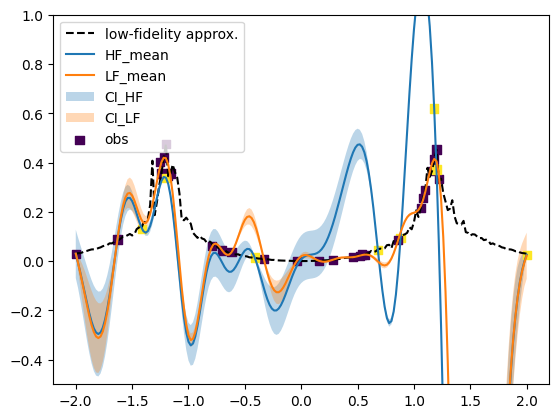

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.LogNormal(0, 1)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, approx_ys_sq, "k--", label="low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")
plt.ylim(-0.5, 1)

plt.legend(loc="best")
plt.show()

In [ ]:
train_x_full

array([[-0.33191198,  0.95      ],
       [ 0.88129797,  1.        ],
       [-1.9995425 ,  0.95      ],
       [-0.79066971,  0.95      ],
       [-1.41297644,  1.        ],
       [-1.63064562,  0.95      ],
       [-1.25495915,  0.95      ],
       [-0.61775709,  0.95      ],
       [-0.4129301 ,  1.        ],
       [ 0.15526694,  0.95      ],
       [-1.2       ,  0.95      ],
       [-1.16      ,  0.95      ],
       [-1.22      ,  0.95      ],
       [-0.7       ,  0.95      ],
       [-1.18      ,  0.95      ],
       [-1.24      ,  0.95      ],
       [-1.2       ,  1.        ],
       [ 1.2       ,  0.95      ],
       [ 1.22      ,  0.95      ],
       [ 1.1       ,  0.95      ],
       [ 0.68      ,  1.        ],
       [ 1.16      ,  0.95      ],
       [ 0.46      ,  0.95      ],
       [ 0.86      ,  0.95      ],
       [ 0.54      ,  0.95      ],
       [ 0.52      ,  0.95      ],
       [ 0.28      ,  0.95      ],
       [ 1.18      ,  0.95      ],
       [ 0.56      ,

# Multi-fidelity BO

Considering triangle low and square high fid models -- Wrong low-fidelity model

In [ ]:
n = 10

np.random.seed(1)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]))

<ipython-input-15-ce1dd9d4cae2>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],
<ipython-input-15-ce1dd9d4cae2>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,Jx[i],0,Jx[i],0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:17<00:00,  6.46it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:24<00:00,  5.94it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 1: 161.55673050880432


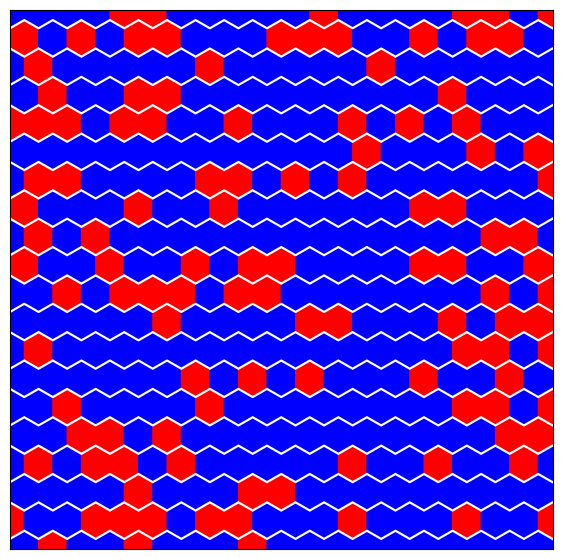

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:42<00:00,  3.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [08:03<00:00,  1.03it/s]

Completed. Saving
Time (s) to complete simulation 2: 646.6162750720978


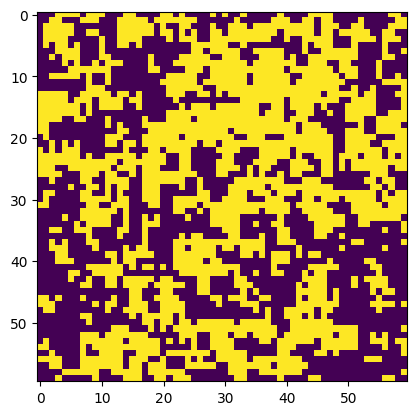

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:20<00:00,  6.18it/s]


Completed. Saving
Time (s) to complete simulation 3: 147.28506207466125


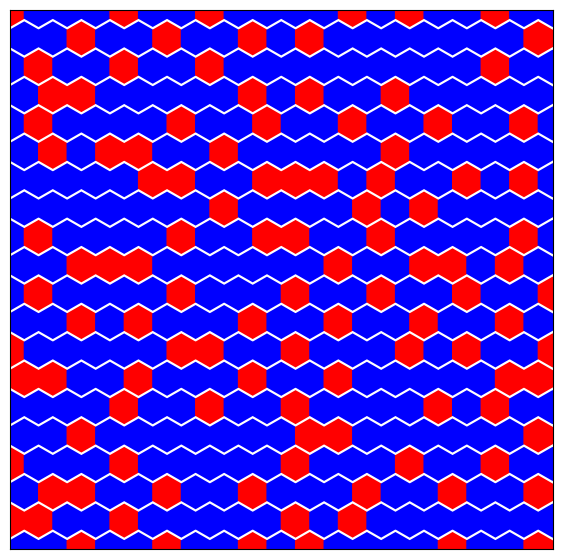

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:05<00:00,  7.58it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:19<00:00,  6.28it/s]


Completed. Saving
Time (s) to complete simulation 4: 145.61364912986755


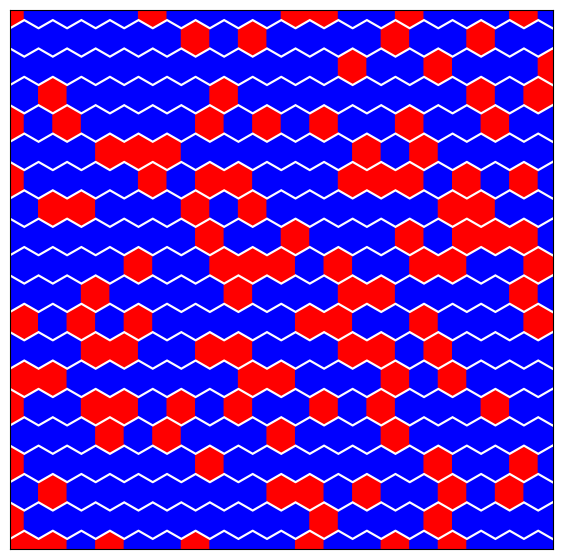

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:40<00:00,  3.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:50<00:00,  1.06it/s]

Completed. Saving
Time (s) to complete simulation 5: 630.7931218147278


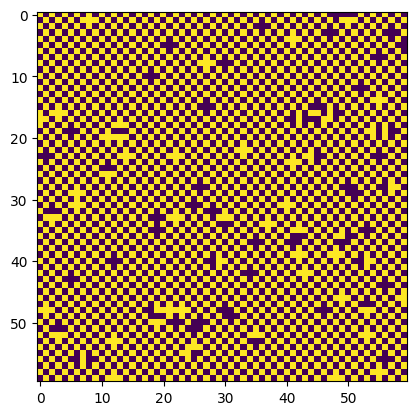

Evaluation 6 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:20<00:00,  6.21it/s]


Completed. Saving
Time (s) to complete simulation 6: 147.05569887161255


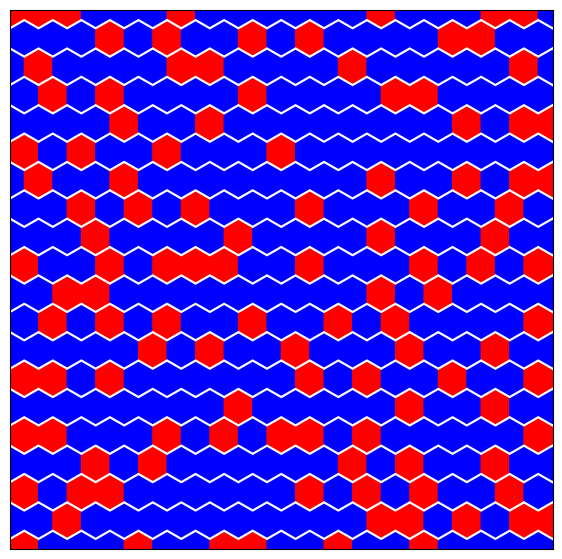

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:20<00:00,  6.20it/s]


Completed. Saving
Time (s) to complete simulation 7: 146.7887978553772


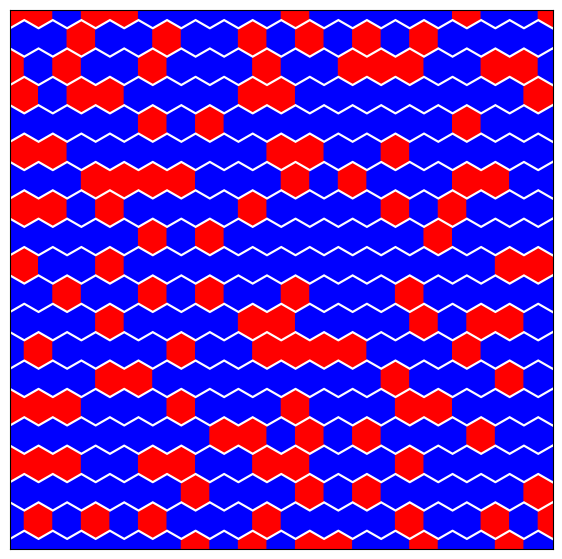

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:19<00:00,  6.26it/s]


Completed. Saving
Time (s) to complete simulation 8: 145.8643832206726


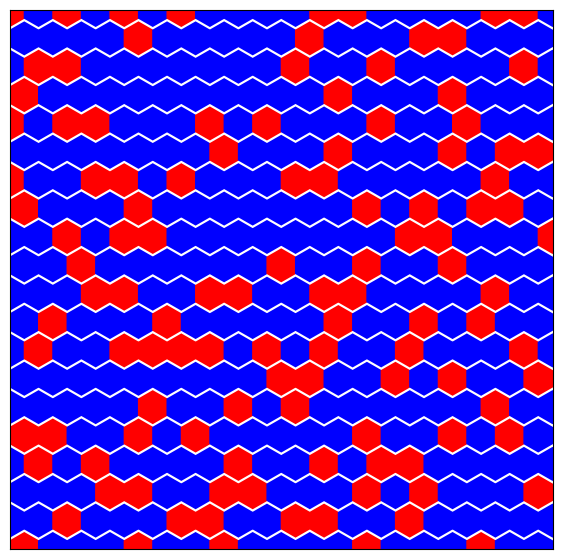

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [02:40<00:00,  3.11it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [07:51<00:00,  1.06it/s]

Completed. Saving
Time (s) to complete simulation 9: 632.1116862297058


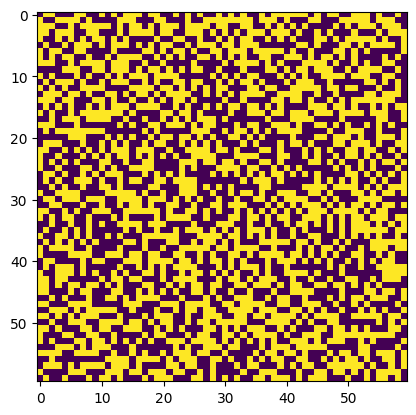

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:22<00:00,  6.08it/s]


Completed. Saving
Time (s) to complete simulation 10: 149.03154039382935


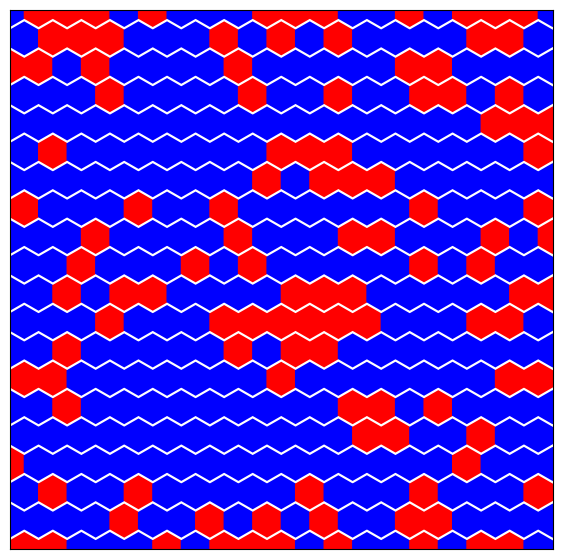

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        J_mat = np.array([[0,Jx[i],0,Jx[i],0],
                  [Jx[i],0,0,0,Jx[i]],
                  [0,Jx[i],0,Jx[i],0]])
        tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
        sq_sim = tri_sim

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    if train_x_full[i,1] == 1: #High fidelity
        plt.imshow(resultsBO_dict[i]['sim']['config'][-1])

    else: #Low fidelity
        sq_sim.plot_config(resultsBO_dict[i]['sim']['config'][-1])



    plt.show()

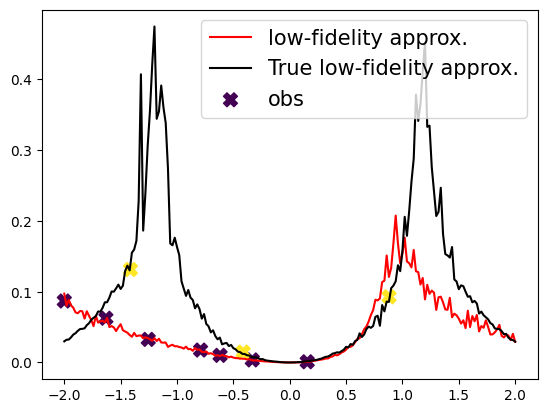

In [ ]:
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")

plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

Run BO -25 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]),
 array([[0.00362316],
        [0.09279848],
        [0.0868945 ],
        [0.01756174],
        [0.13141094],
        [0.06255309],
        [0.03263018],
        [0.01008332],
        [0.01471007],
        [0.0009922

Step:1


sample: 100%|██████████| 4000/4000 [00:34<00:00, 117.64it/s, 7 steps of size 5.12e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.56      0.25      0.56      0.21      1.00   1334.58      1.00
  k_length      0.28      0.04      0.28      0.21      0.35   1318.20      1.00
   k_scale      0.17      0.16      0.11      0.05      0.38   1088.50      1.00
     noise      1.75      2.57      1.05      0.06      3.70   1622.47      1.00



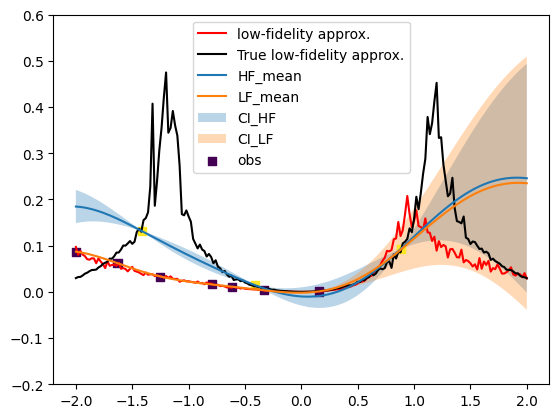

(402,)


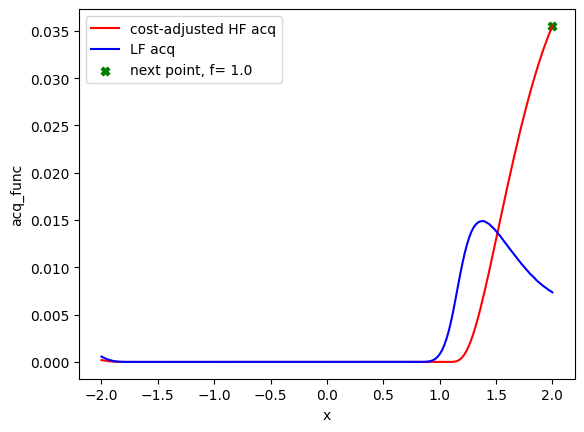

401
[2. 1.] 2.0
Evaluation 11 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:00<00:00,  8.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:29<00:00,  3.35it/s]

Completed. Saving
Time (s) to complete simulation 2: 210.0944118499756


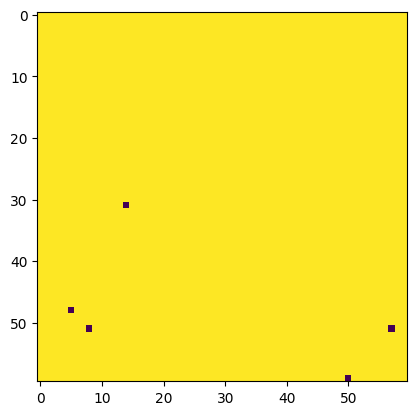

Step:2


sample: 100%|██████████| 4000/4000 [00:38<00:00, 104.31it/s, 7 steps of size 5.08e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.23      0.61      0.27      1.00   1341.46      1.00
  k_length      0.26      0.03      0.26      0.20      0.32   1089.92      1.00
   k_scale      0.13      0.12      0.09      0.05      0.25   1024.60      1.00
     noise      1.73      2.53      1.03      0.03      3.62   1546.99      1.00



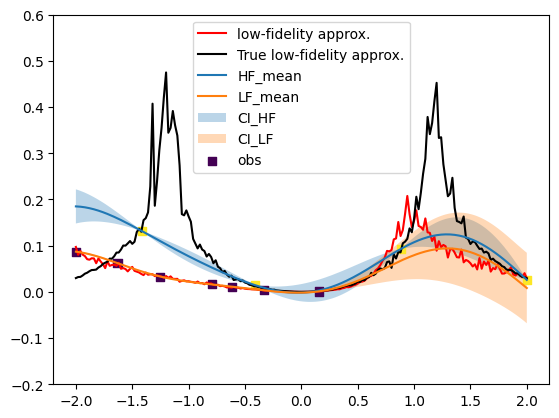

(402,)


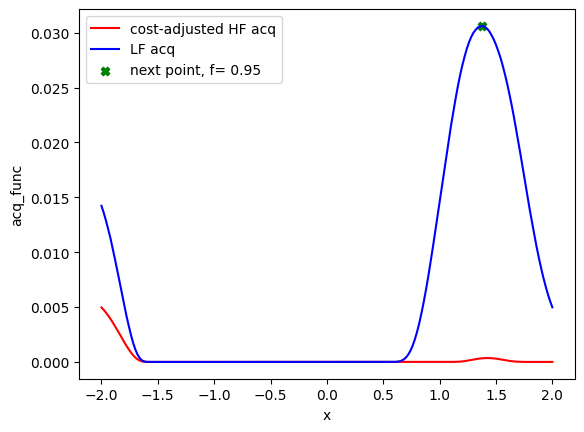

[401 169]
[1.38 0.95] 1.38
Evaluation 12 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.47it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 3: 53.65818428993225


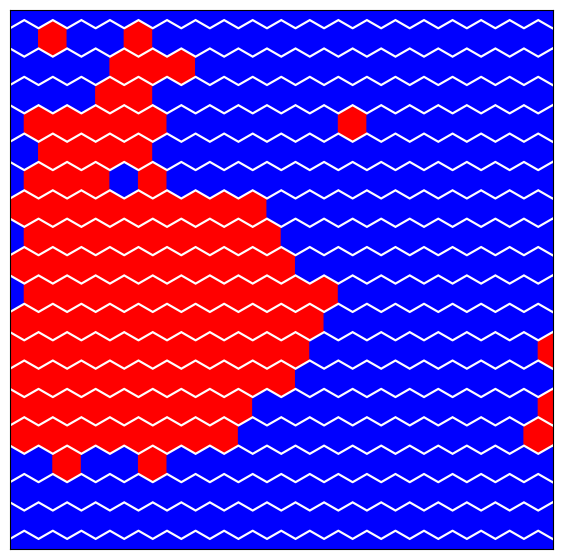

Step:3


sample: 100%|██████████| 4000/4000 [00:40<00:00, 99.61it/s, 7 steps of size 4.57e-01. acc. prob=0.92] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.59      0.23      0.60      0.28      1.00   1482.25      1.00
  k_length      0.26      0.03      0.26      0.21      0.32   1035.09      1.00
   k_scale      0.13      0.11      0.09      0.05      0.23   1023.29      1.00
     noise      1.72      2.47      1.01      0.03      3.60   1583.27      1.00



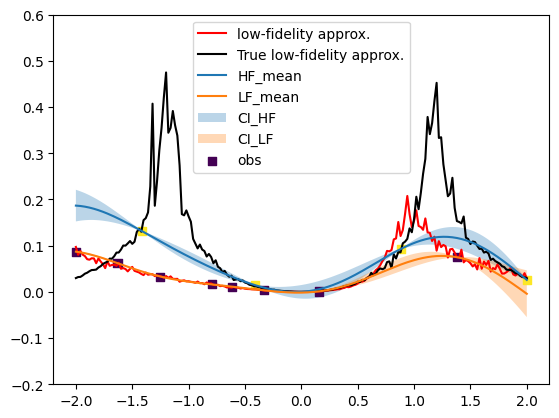

(402,)


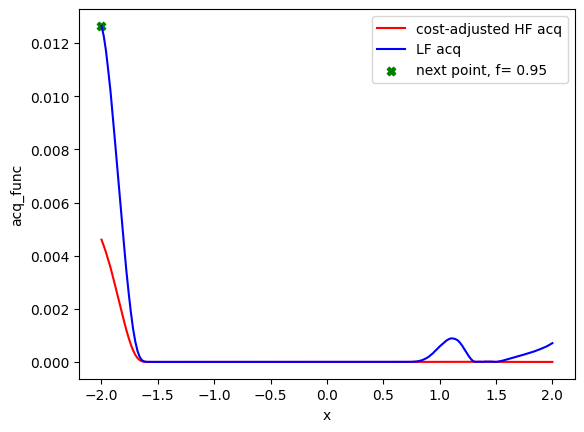

[401 169   0]
[-2.    0.95] -2.0
Evaluation 13 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.25it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:28<00:00, 17.30it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 4: 53.60578918457031


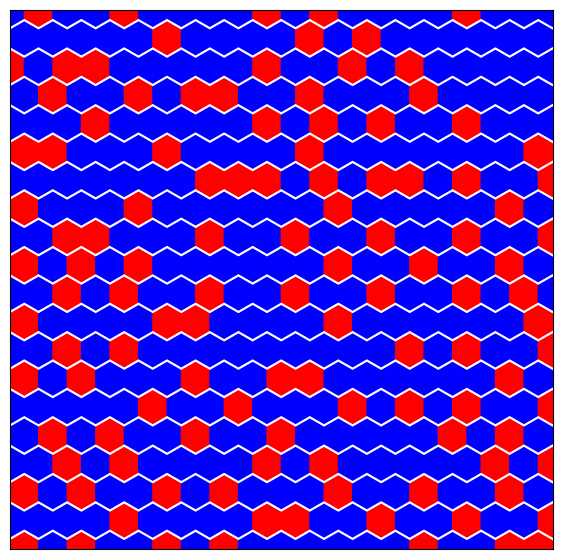

Step:4


sample: 100%|██████████| 4000/4000 [00:42<00:00, 94.75it/s, 7 steps of size 5.11e-01. acc. prob=0.89] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.61      0.23      0.62      0.29      1.00   1423.09      1.00
  k_length      0.28      0.03      0.27      0.22      0.33   1415.06      1.00
   k_scale      0.13      0.12      0.09      0.05      0.25    997.91      1.00
     noise      1.76      2.72      1.01      0.03      3.76   1731.23      1.00



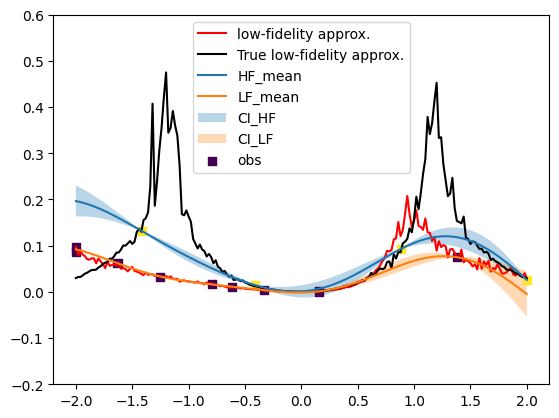

(402,)


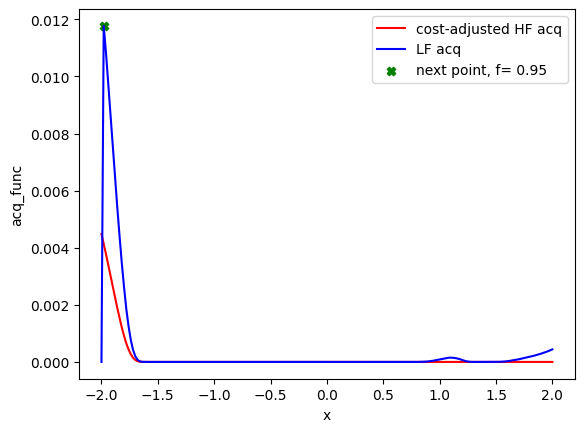

[401 169   0   1]
[-1.98  0.95] -1.98
Evaluation 14 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.98it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.93it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 5: 54.58189415931702


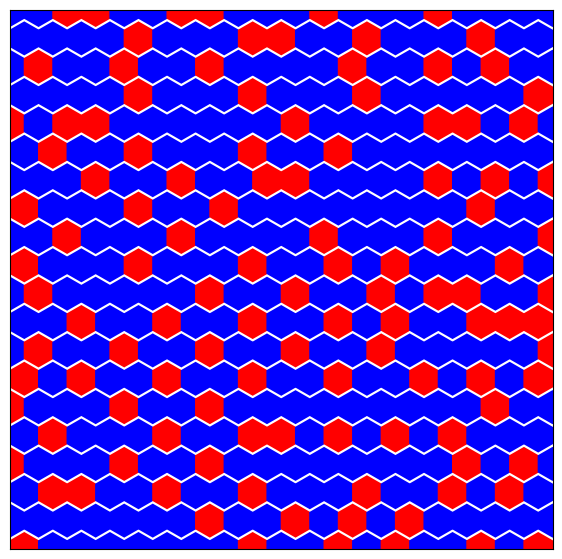

Step:5


sample: 100%|██████████| 4000/4000 [00:55<00:00, 72.47it/s, 7 steps of size 3.82e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.49      0.26      0.46      0.08      0.92   1181.17      1.00
  k_length      0.09      0.02      0.09      0.07      0.12    847.65      1.00
   k_scale      0.08      0.04      0.06      0.05      0.11    536.96      1.00
     noise      1.77      2.70      1.01      0.08      3.82   1278.10      1.00



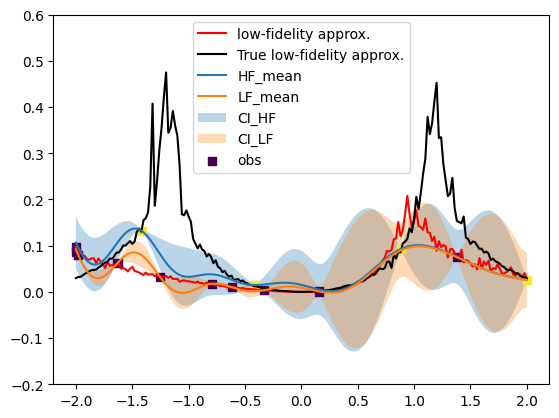

(402,)


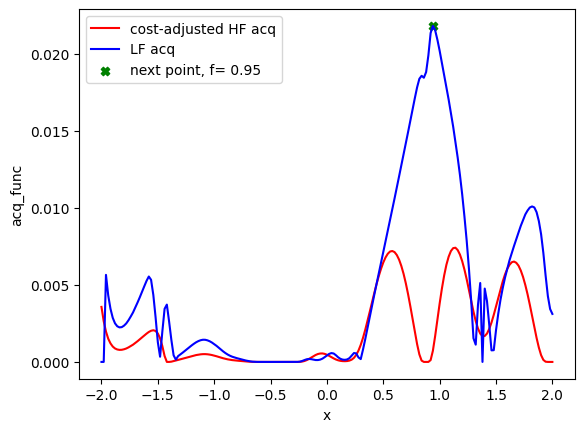

[401 169   0   1 147]
[0.94 0.95] 0.94
Evaluation 15 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.89it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 17.11it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 6: 54.37570929527283


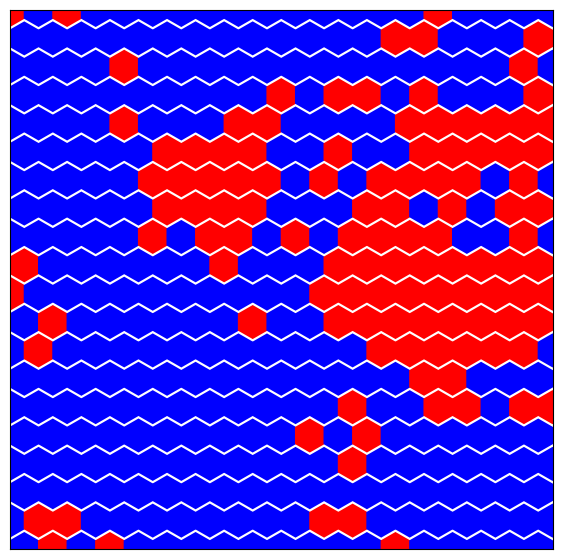

Step:6


sample: 100%|██████████| 4000/4000 [01:00<00:00, 65.76it/s, 7 steps of size 3.67e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.59      0.25      0.61      0.24      1.00   1200.75      1.00
  k_length      0.09      0.02      0.09      0.06      0.12    752.46      1.00
   k_scale      0.08      0.05      0.07      0.05      0.12    477.25      1.00
     noise      1.69      2.33      1.02      0.05      3.66   1509.32      1.00



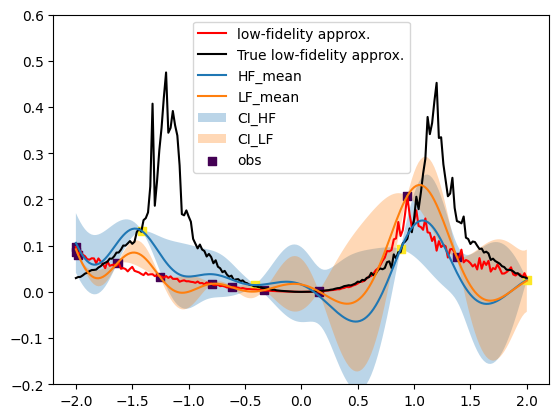

(402,)


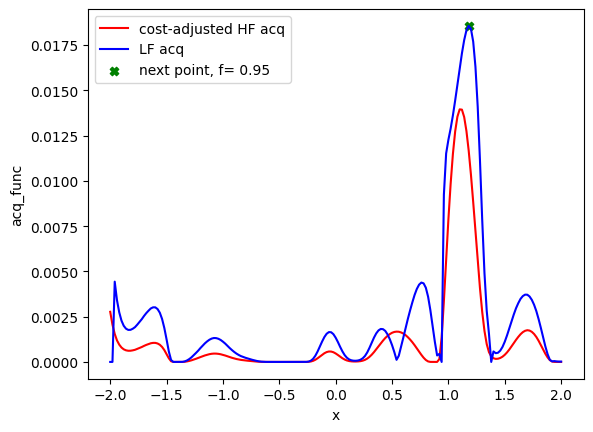

[401 169   0   1 147 159]
[1.18 0.95] 1.1800000000000002
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.91it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 7: 54.55001759529114


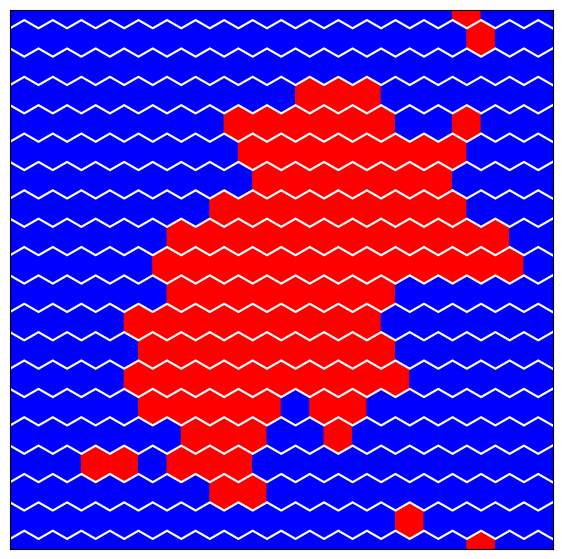

Step:7


sample: 100%|██████████| 4000/4000 [00:36<00:00, 109.82it/s, 7 steps of size 3.96e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.66      0.22      0.67      0.36      1.00   1213.05      1.00
  k_length      0.10      0.01      0.10      0.07      0.12    547.18      1.00
   k_scale      0.09      0.06      0.07      0.05      0.13    498.49      1.00
     noise      1.66      2.37      0.98      0.05      3.49   1417.59      1.00



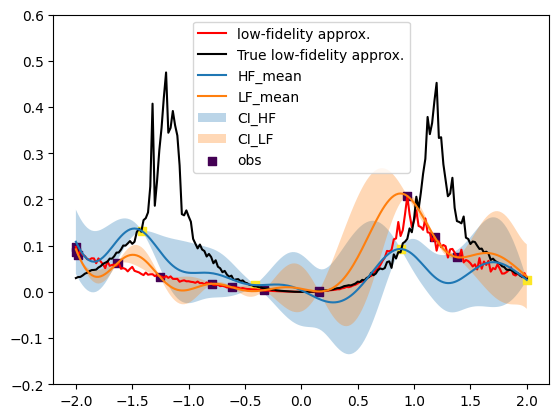

(402,)


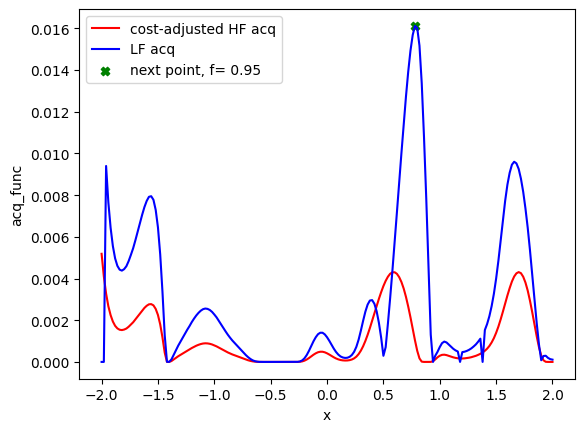

[401 169   0   1 147 159 139]
[0.78 0.95] 0.7800000000000002
Evaluation 17 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:24<00:00, 20.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.92it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 8: 54.50445914268494


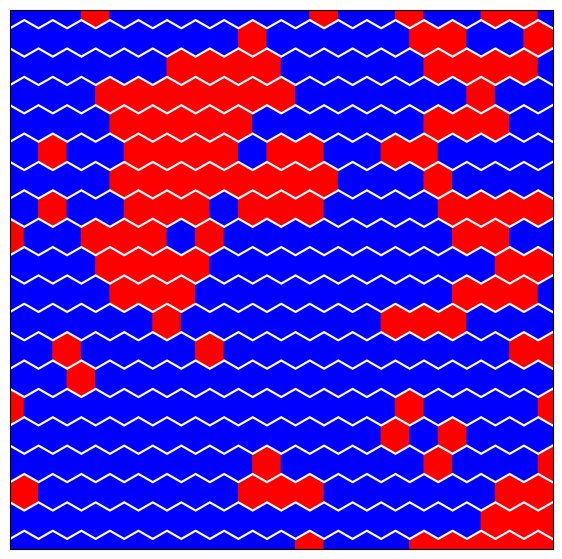

Step:8


sample: 100%|██████████| 4000/4000 [00:54<00:00, 72.95it/s, 7 steps of size 4.44e-01. acc. prob=0.83]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.23      0.60      0.29      1.00   1356.61      1.00
  k_length      0.08      0.01      0.08      0.06      0.09    517.74      1.00
   k_scale      0.07      0.03      0.06      0.05      0.10    685.71      1.00
     noise      1.87      2.58      1.09      0.07      4.13   1284.11      1.00



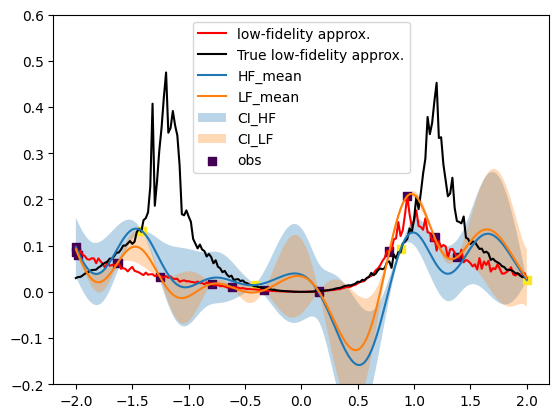

(402,)


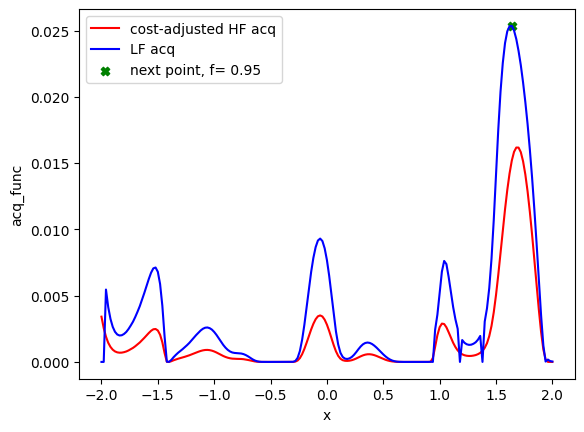

[401 169   0   1 147 159 139 182]
[1.64 0.95] 1.6400000000000001
Evaluation 18 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.73it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.93it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 9: 54.88848638534546


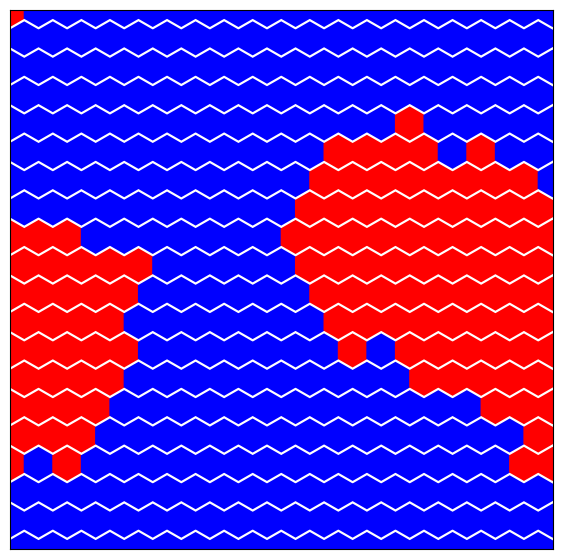

Step:9


sample: 100%|██████████| 4000/4000 [00:59<00:00, 67.73it/s, 7 steps of size 3.84e-01. acc. prob=0.89] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.22      0.60      0.29      1.00   1322.77      1.00
  k_length      0.07      0.01      0.07      0.06      0.09    521.45      1.00
   k_scale      0.07      0.02      0.06      0.05      0.09   1127.71      1.00
     noise      1.78      2.65      1.02      0.05      3.68   1459.90      1.00



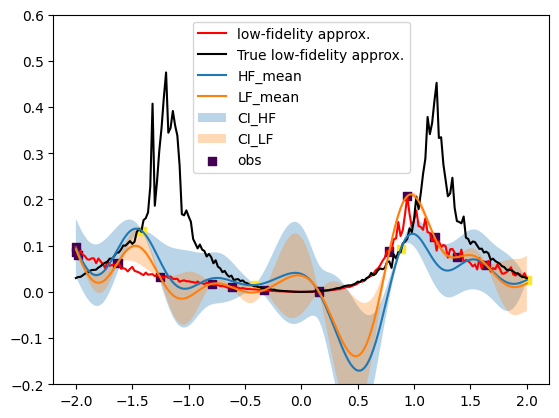

(402,)


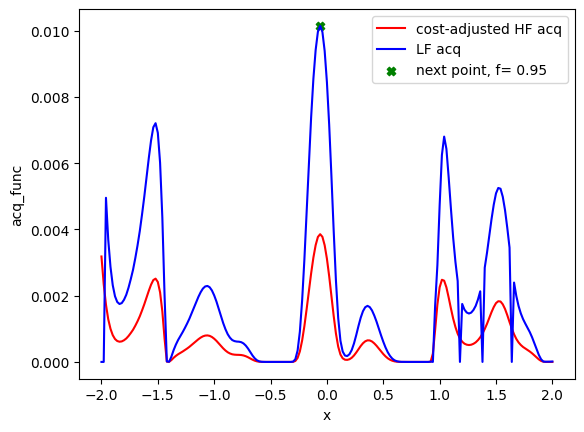

[401 169   0   1 147 159 139 182  97]
[-0.06  0.95] -0.06000000000000005
Evaluation 19 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.90it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 10: 55.04337167739868


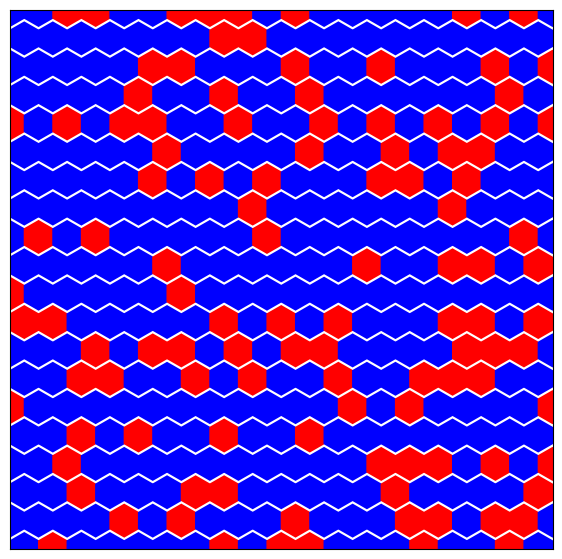

Step:10


sample: 100%|██████████| 4000/4000 [01:01<00:00, 64.98it/s, 3 steps of size 4.30e-01. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.60      0.23      0.61      0.30      1.00   1538.34      1.00
  k_length      0.07      0.01      0.07      0.06      0.09    434.00      1.00
   k_scale      0.07      0.02      0.06      0.05      0.09   1095.01      1.00
     noise      1.81      2.71      1.04      0.05      3.80   1586.30      1.00



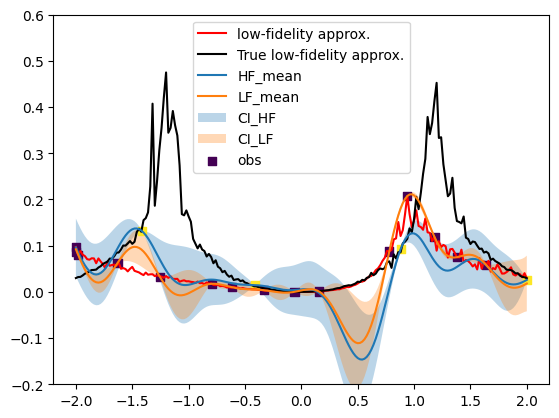

(402,)


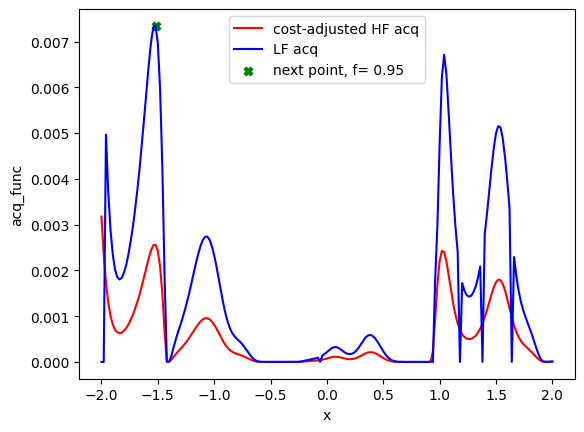

[401 169   0   1 147 159 139 182  97  24]
[-1.52  0.95] -1.52
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.89it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 11: 55.0690643787384


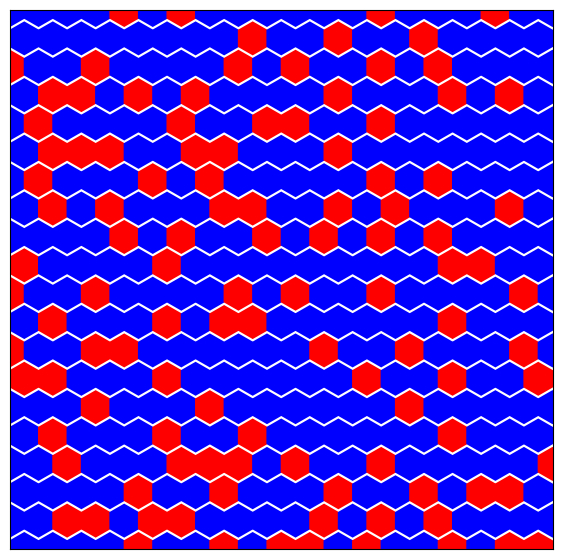

Step:11


sample: 100%|██████████| 4000/4000 [00:58<00:00, 68.69it/s, 7 steps of size 5.42e-01. acc. prob=0.76]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.68      0.20      0.70      0.39      1.00   1117.54      1.00
  k_length      0.07      0.01      0.08      0.06      0.09    711.37      1.00
   k_scale      0.07      0.02      0.06      0.05      0.10    925.15      1.00
     noise      1.62      2.22      0.98      0.03      3.48   1456.29      1.00



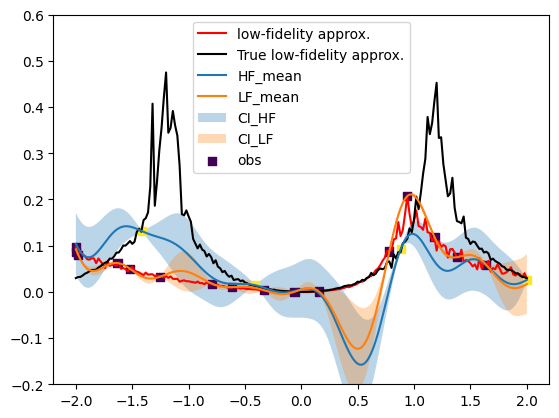

(402,)


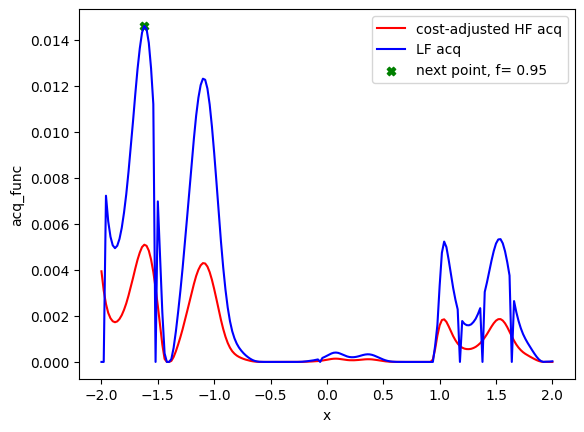

[401 169   0   1 147 159 139 182  97  24  19]
[-1.62  0.95] -1.62
Evaluation 21 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.64it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.73it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 12: 55.36336612701416


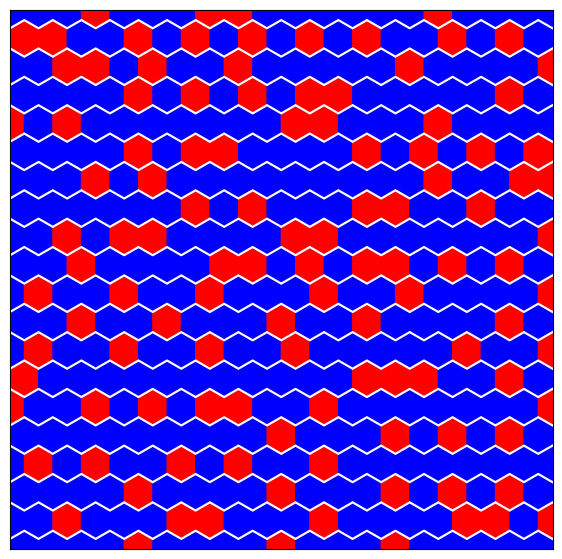

Step:12


sample: 100%|██████████| 4000/4000 [01:11<00:00, 55.74it/s, 7 steps of size 4.00e-01. acc. prob=0.90] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.68      0.21      0.70      0.38      1.00   1184.06      1.01
  k_length      0.07      0.01      0.08      0.06      0.09    344.23      1.00
   k_scale      0.07      0.03      0.06      0.05      0.10    937.44      1.00
     noise      1.68      2.44      1.00      0.04      3.54   1701.33      1.00



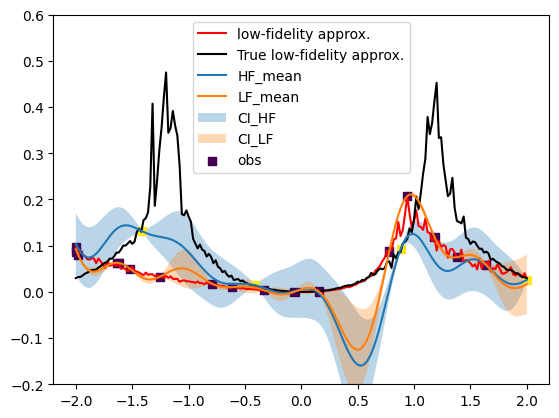

(402,)


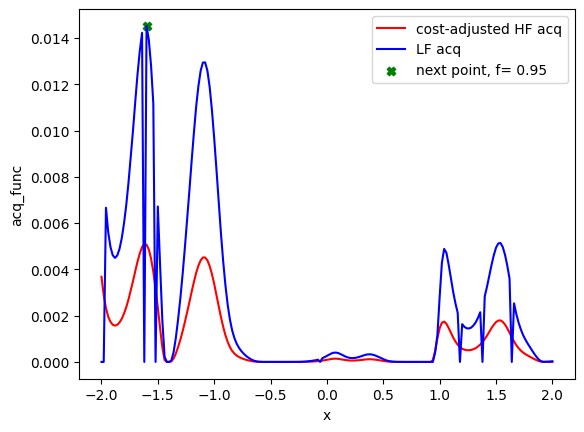

[401 169   0   1 147 159 139 182  97  24  19  20]
[-1.6   0.95] -1.6
Evaluation 22 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.92it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 13: 54.93166637420654


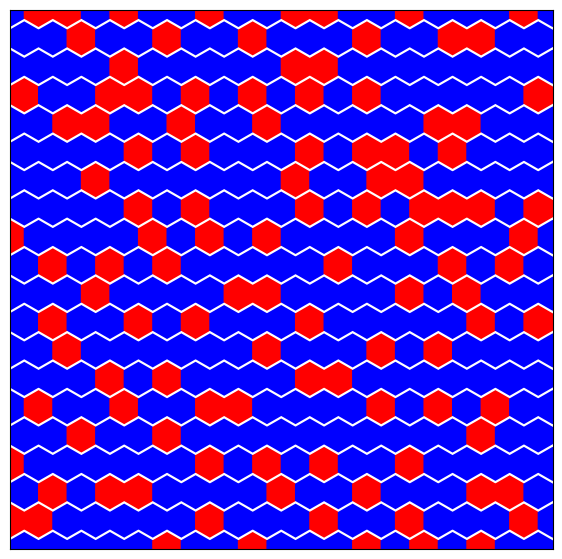

Step:13


sample: 100%|██████████| 4000/4000 [00:57<00:00, 69.57it/s, 3 steps of size 5.71e-01. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.57      0.23      0.57      0.22      0.96   1190.80      1.00
  k_length      0.05      0.00      0.05      0.05      0.06   1007.78      1.00
   k_scale      0.06      0.02      0.06      0.05      0.08   1435.58      1.00
     noise      1.65      2.28      0.98      0.05      3.57   1482.98      1.00



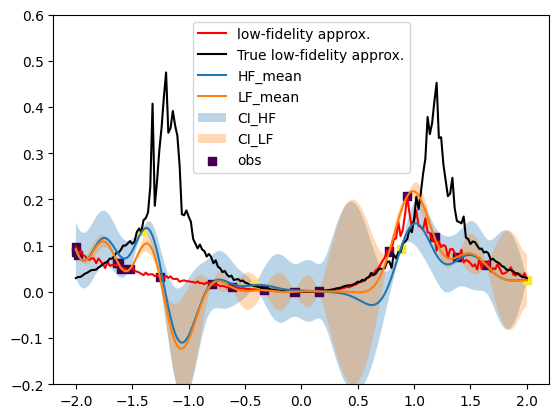

(402,)


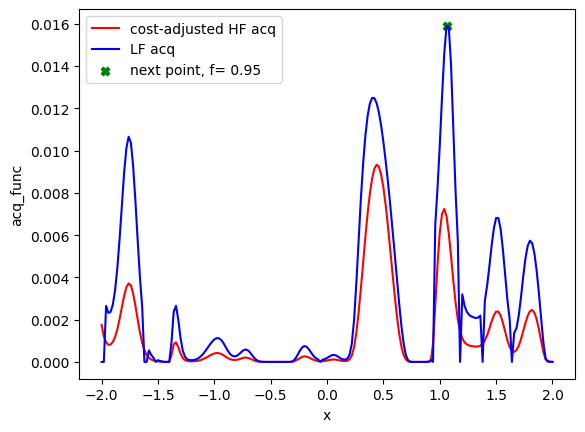

[401 169   0   1 147 159 139 182  97  24  19  20 153]
[1.06 0.95] 1.06
Evaluation 23 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.19it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 14: 56.51332235336304


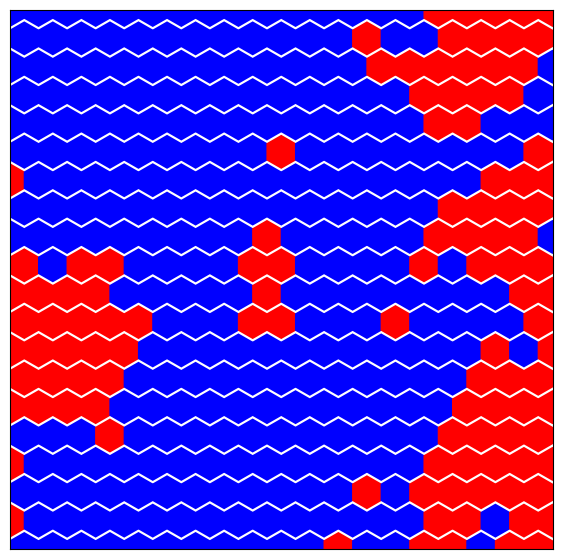

Step:14


sample: 100%|██████████| 4000/4000 [01:04<00:00, 62.10it/s, 7 steps of size 4.46e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.65      0.21      0.66      0.36      1.00   1387.34      1.00
  k_length      0.05      0.00      0.05      0.05      0.06   1020.92      1.00
   k_scale      0.07      0.02      0.06      0.05      0.09   1307.79      1.00
     noise      1.80      2.61      1.04      0.05      3.94   1354.36      1.00



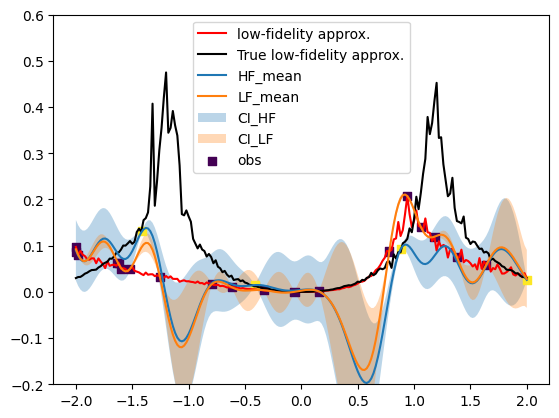

(402,)


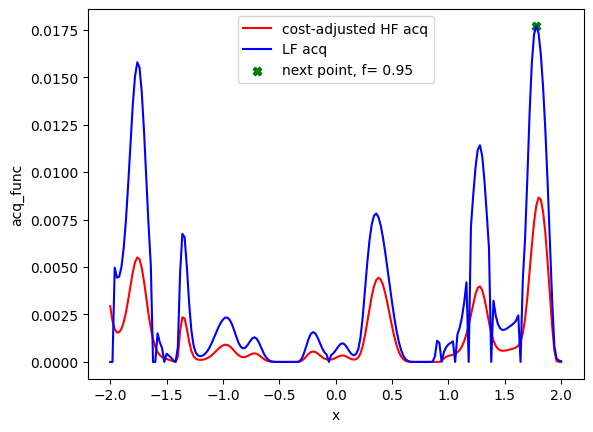

[401 169   0   1 147 159 139 182  97  24  19  20 153 189]
[1.78 0.95] 1.7800000000000002
Evaluation 24 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.71it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.79it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 15: 55.16523480415344


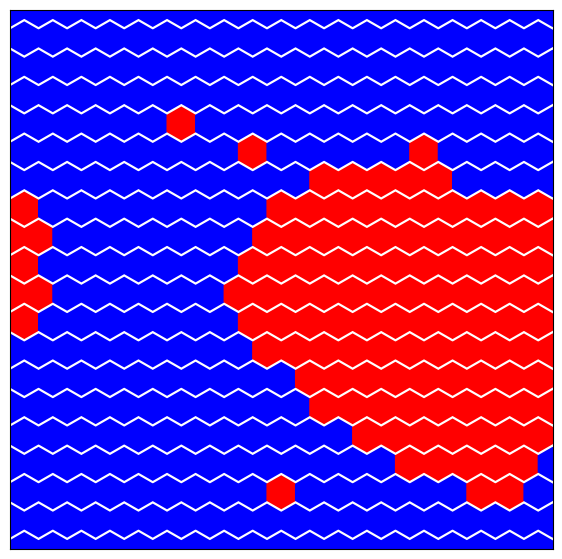

Step:15


sample: 100%|██████████| 4000/4000 [01:10<00:00, 56.64it/s, 7 steps of size 3.92e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.65      0.21      0.66      0.35      1.00   1452.84      1.00
  k_length      0.05      0.00      0.05      0.05      0.06   1098.39      1.00
   k_scale      0.07      0.02      0.06      0.05      0.09   1066.88      1.00
     noise      1.75      2.53      1.03      0.07      3.69   1573.53      1.00



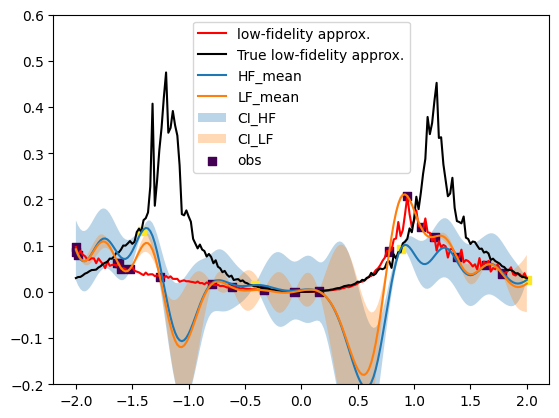

(402,)


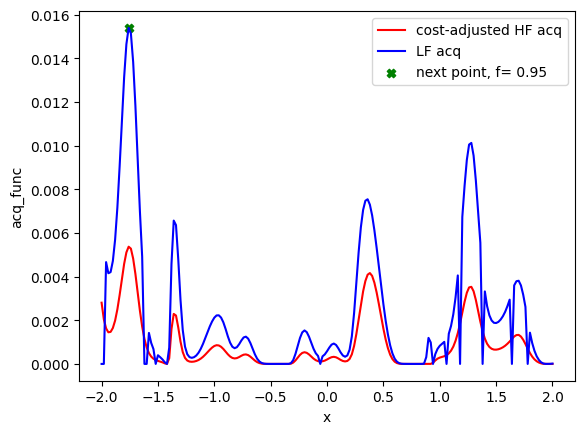

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12]
[-1.76  0.95] -1.76
Evaluation 25 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.77it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.56it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 16: 56.86057734489441


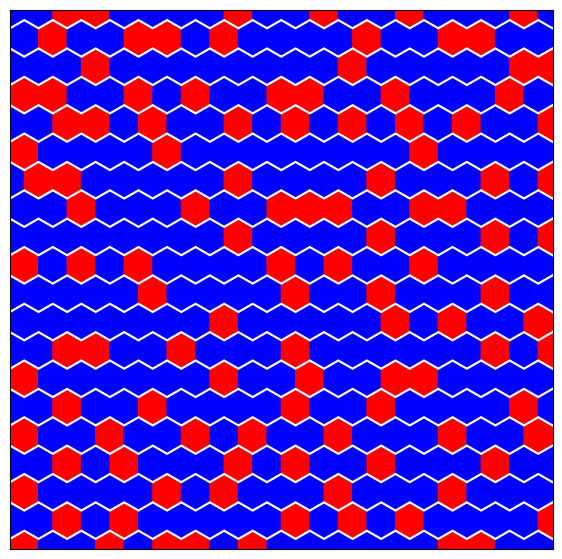

Step:16


sample: 100%|██████████| 4000/4000 [01:05<00:00, 60.75it/s, 7 steps of size 5.33e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.62      0.22      0.64      0.32      1.00   1532.41      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1899.11      1.00
   k_scale      0.08      0.03      0.07      0.05      0.11   1614.26      1.00
     noise      1.73      2.50      1.03      0.04      3.70   1451.50      1.00



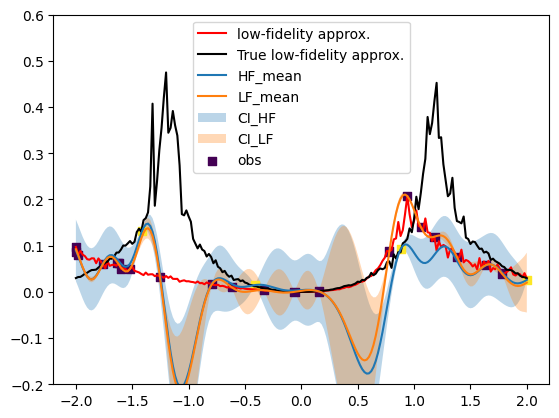

(402,)


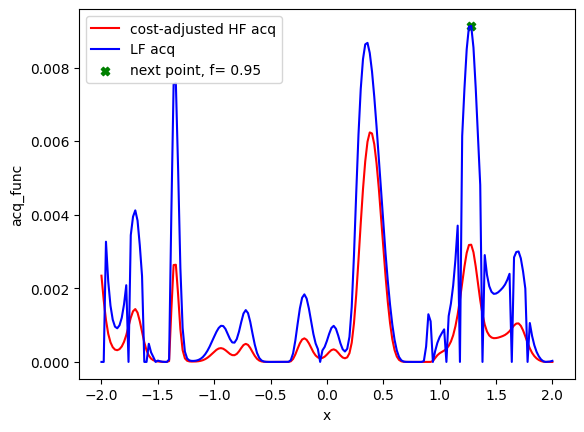

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164]
[1.28 0.95] 1.2800000000000002
Evaluation 26 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.50it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 17: 56.42752432823181


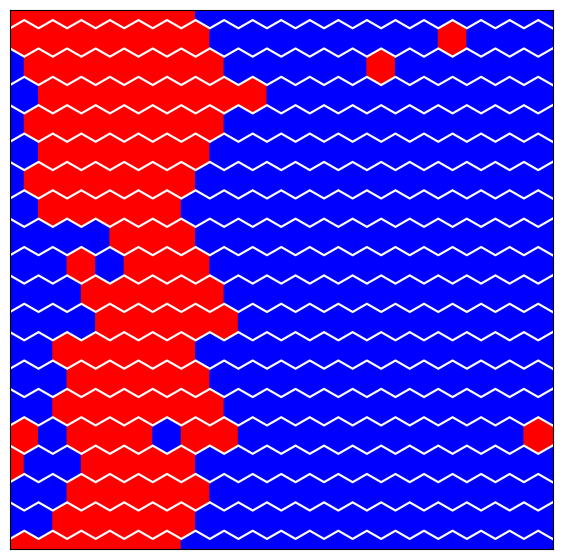

Step:17


sample: 100%|██████████| 4000/4000 [01:06<00:00, 59.82it/s, 3 steps of size 5.84e-01. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.64      0.21      0.66      0.34      1.00   1729.94      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1711.44      1.00
   k_scale      0.08      0.03      0.07      0.05      0.11   1447.76      1.00
     noise      1.71      2.40      1.03      0.04      3.66   1600.82      1.00



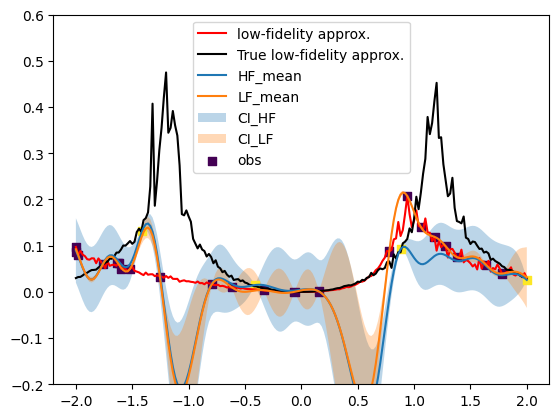

(402,)


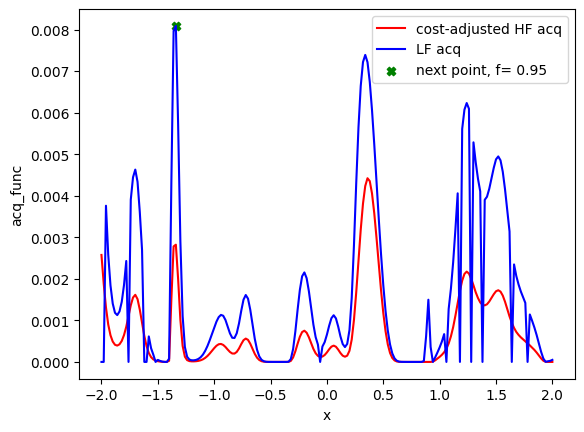

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33]
[-1.34  0.95] -1.3399999999999999
Evaluation 27 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.35it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 18: 57.24695301055908


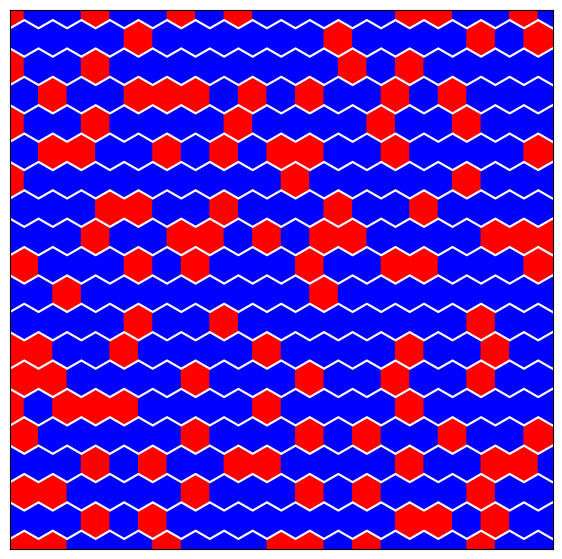

Step:18


sample: 100%|██████████| 4000/4000 [01:10<00:00, 56.74it/s, 7 steps of size 4.84e-01. acc. prob=0.93]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.66      0.22      0.68      0.35      1.00   1333.15      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2207.23      1.00
   k_scale      0.10      0.05      0.09      0.05      0.16   1518.28      1.00
     noise      1.73      2.51      1.01      0.04      3.73   1256.16      1.00



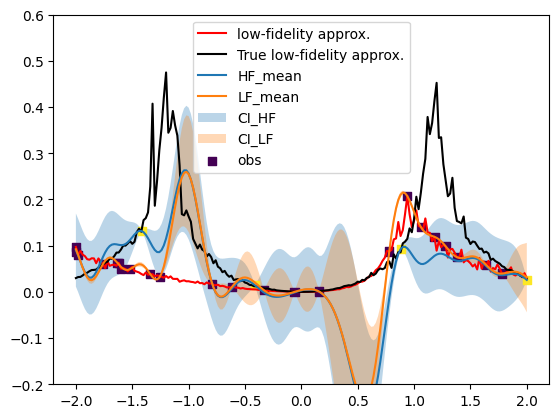

(402,)


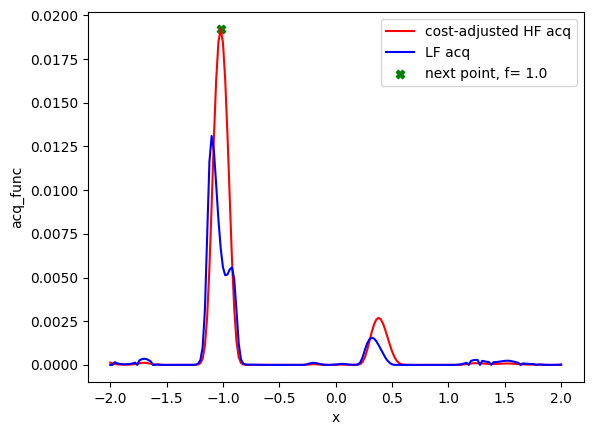

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250]
[-1.02  1.  ] -1.02
Evaluation 28 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:06<00:00,  7.54it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:34<00:00,  3.23it/s]

Completed. Saving
Time (s) to complete simulation 19: 221.1771686077118


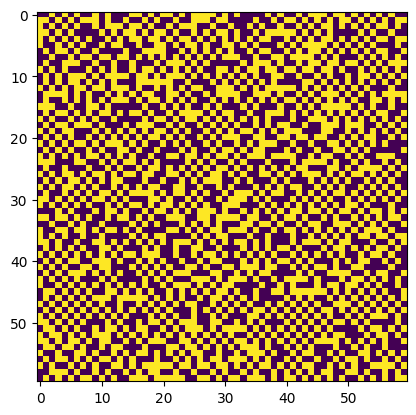

Step:19


sample: 100%|██████████| 4000/4000 [01:08<00:00, 58.07it/s, 7 steps of size 5.58e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.67      0.21      0.69      0.37      1.00   1497.56      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2236.77      1.00
   k_scale      0.09      0.04      0.08      0.05      0.14   1707.50      1.00
     noise      1.80      2.70      1.04      0.04      3.77   1467.11      1.00



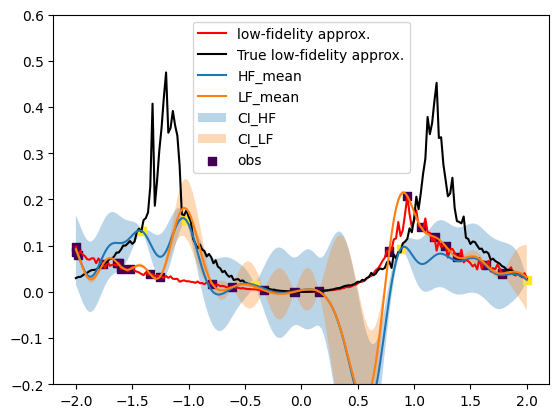

(402,)


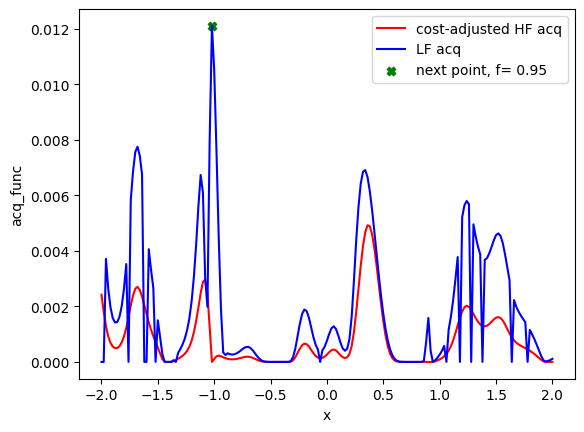

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49]
[-1.02  0.95] -1.02
Evaluation 29 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 18.92it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.24it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 20: 57.21717357635498


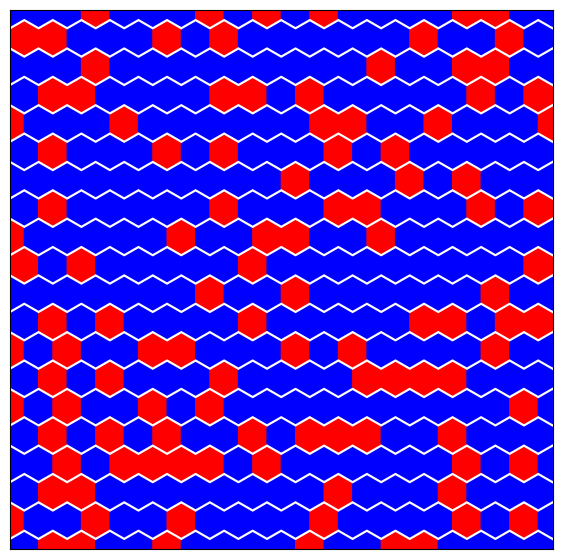

Step:20


sample: 100%|██████████| 4000/4000 [01:15<00:00, 52.95it/s, 3 steps of size 5.75e-01. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.72      0.19      0.75      0.44      1.00   1351.67      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2099.35      1.00
   k_scale      0.10      0.05      0.09      0.05      0.16   1168.88      1.00
     noise      1.80      2.59      1.05      0.05      3.82   1695.65      1.00



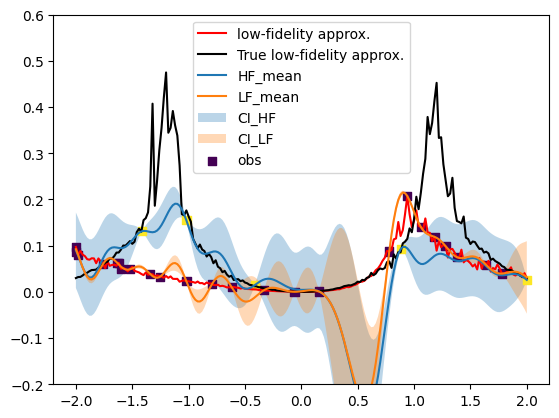

(402,)


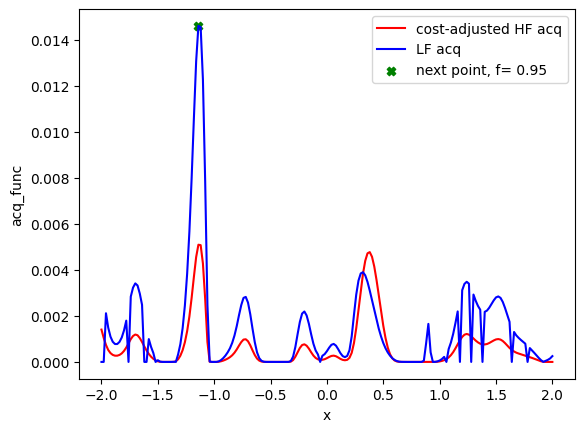

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43]
[-1.14  0.95] -1.1400000000000001
Evaluation 30 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.45it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 21: 56.69476079940796


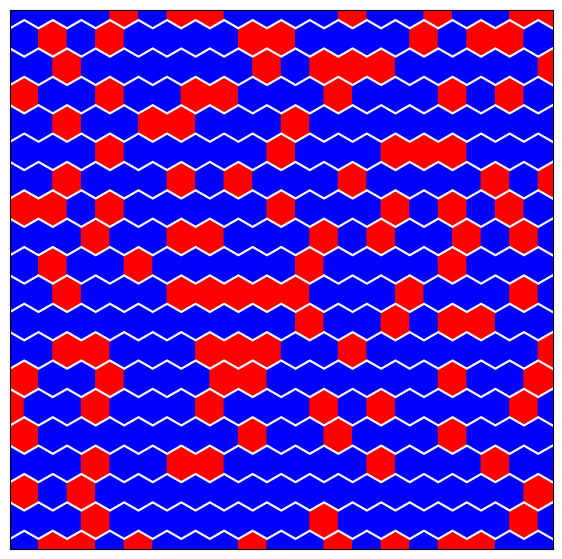

Step:21


sample: 100%|██████████| 4000/4000 [01:18<00:00, 51.22it/s, 7 steps of size 5.07e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.76      0.17      0.78      0.51      1.00   1458.83      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1741.50      1.00
   k_scale      0.08      0.03      0.07      0.05      0.11   1511.61      1.00
     noise      1.78      2.52      1.05      0.05      3.89   1385.63      1.00



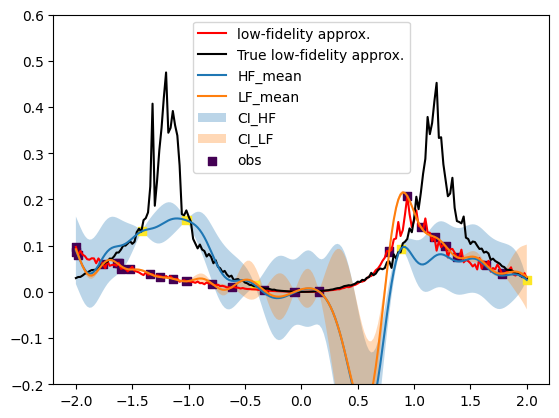

(402,)


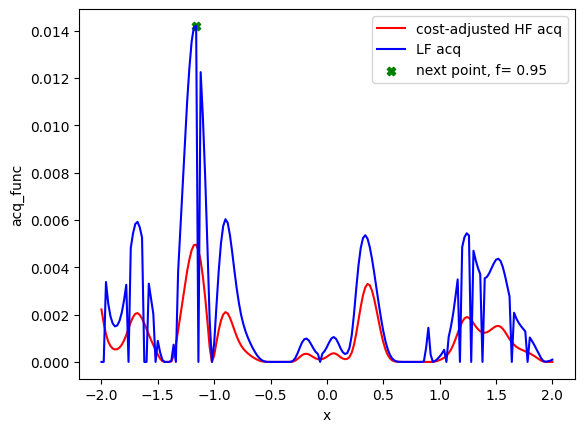

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43  42]
[-1.16  0.95] -1.1600000000000001
Evaluation 31 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.66it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 22: 55.512020111083984


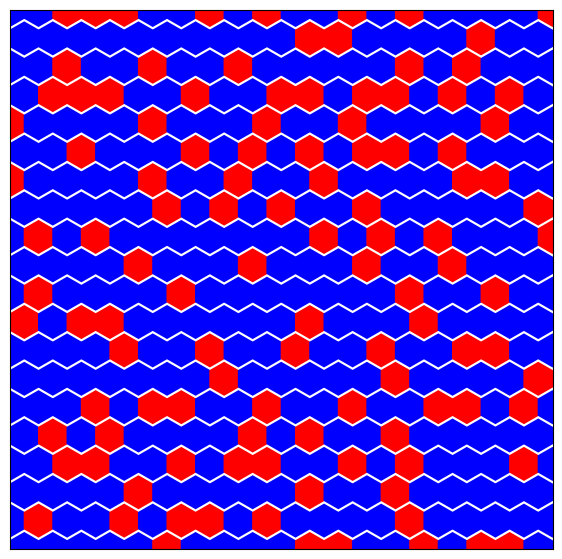

Step:22


sample: 100%|██████████| 4000/4000 [01:30<00:00, 44.39it/s, 7 steps of size 4.03e-01. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.73      0.19      0.76      0.46      1.00   1471.18      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1823.11      1.00
   k_scale      0.10      0.06      0.08      0.05      0.17   1489.74      1.00
     noise      1.68      2.45      0.96      0.05      3.51   1616.25      1.00



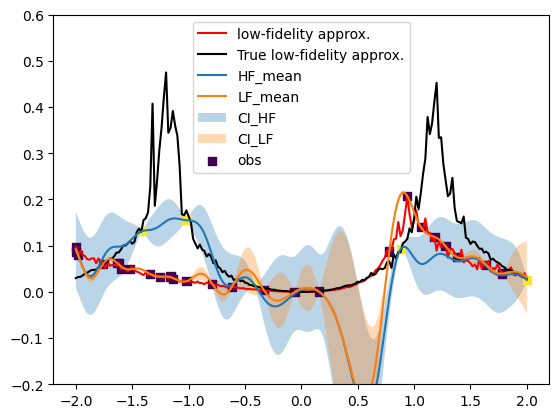

(402,)


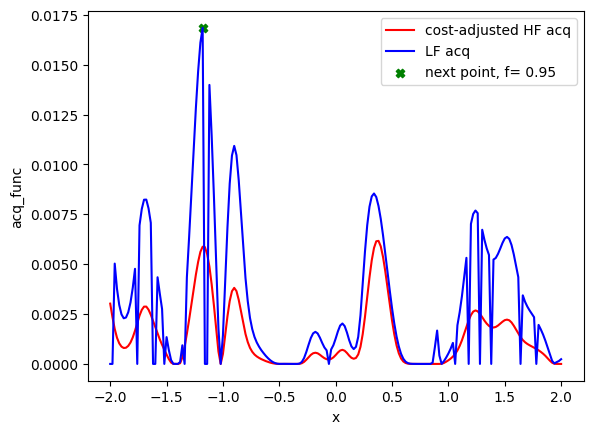

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43  42  41]
[-1.18  0.95] -1.18
Evaluation 32 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.66it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 23: 56.11423945426941


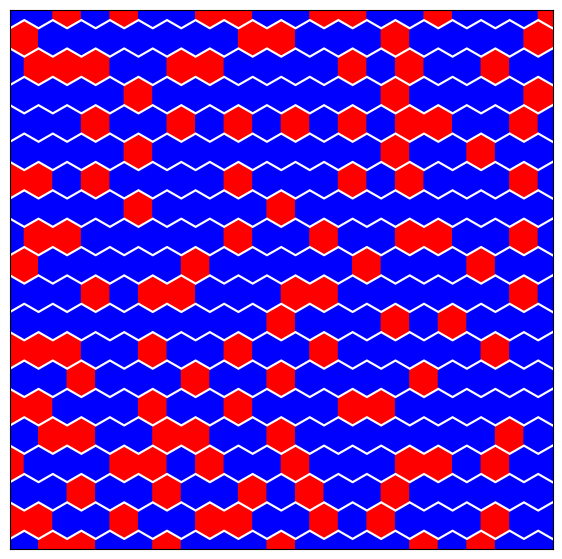

Step:23


sample: 100%|██████████| 4000/4000 [00:32<00:00, 124.85it/s, 7 steps of size 5.52e-01. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.78      0.51      1.00   1553.03      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2096.02      1.00
   k_scale      0.08      0.03      0.07      0.05      0.11   1697.17      1.00
     noise      1.75      2.38      1.05      0.04      3.75   1593.15      1.00



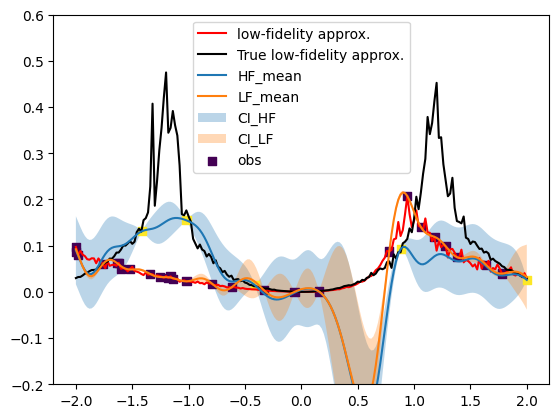

(402,)


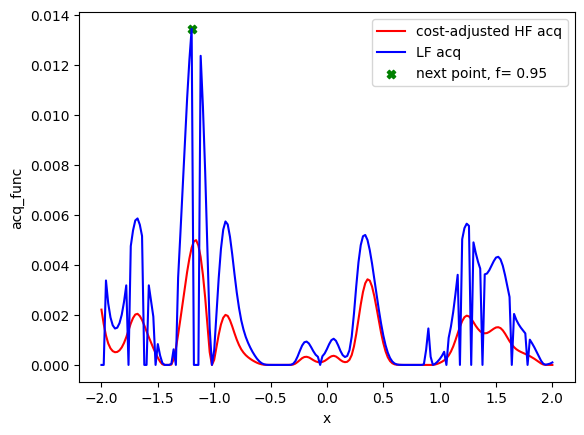

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43  42  41  40]
[-1.2   0.95] -1.2
Evaluation 33 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.72it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 24: 56.06507968902588


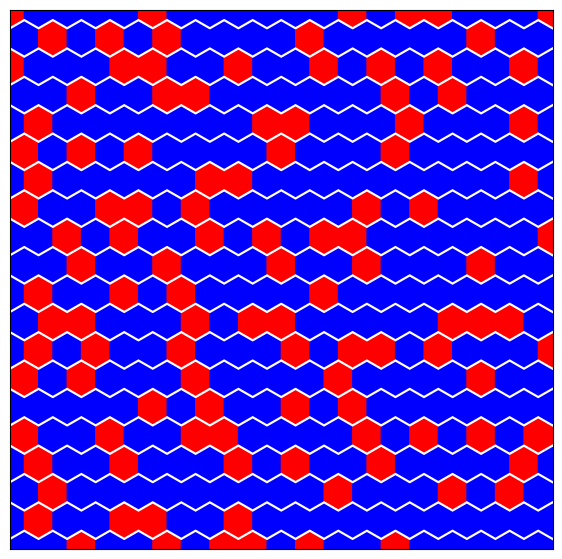

Step:24


sample: 100%|██████████| 4000/4000 [00:35<00:00, 113.54it/s, 3 steps of size 6.69e-01. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.74      0.18      0.77      0.49      1.00   1417.22      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   1893.08      1.00
   k_scale      0.09      0.04      0.08      0.05      0.13   1433.48      1.00
     noise      1.79      2.43      1.05      0.07      3.99   1754.88      1.00



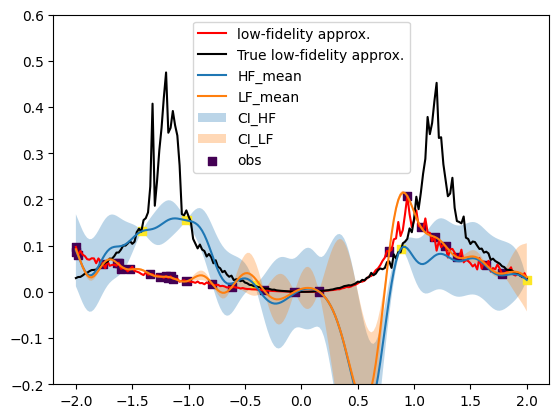

(402,)


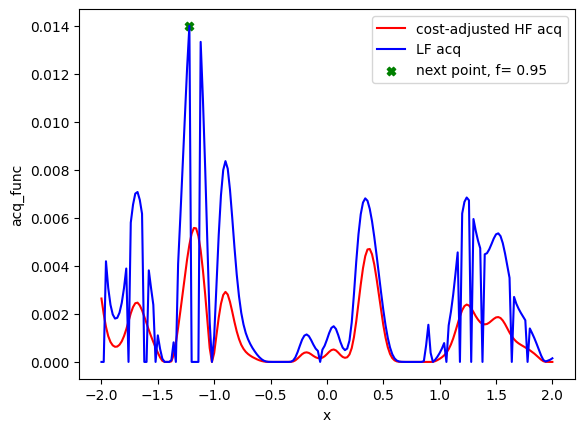

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43  42  41  40  39]
[-1.22  0.95] -1.22
Evaluation 34 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:25<00:00, 19.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:29<00:00, 16.84it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 25: 55.12332034111023


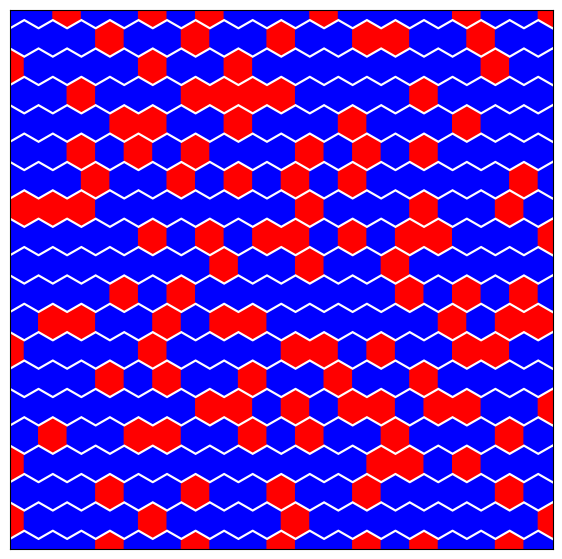

Step:25


sample: 100%|██████████| 4000/4000 [00:35<00:00, 111.42it/s, 7 steps of size 5.26e-01. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.18      0.77      0.49      1.00   1647.38      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2213.60      1.00
   k_scale      0.08      0.03      0.07      0.05      0.12   1651.43      1.00
     noise      1.72      2.34      1.02      0.03      3.83   1478.74      1.00



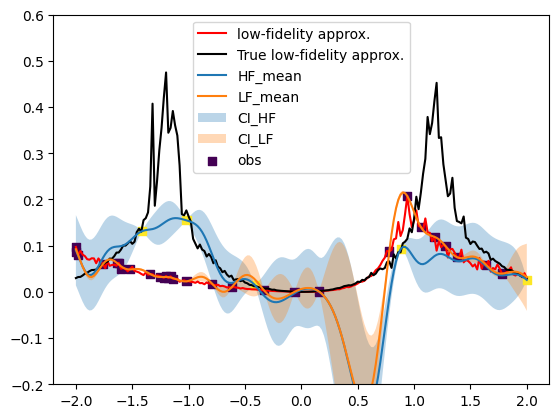

(402,)


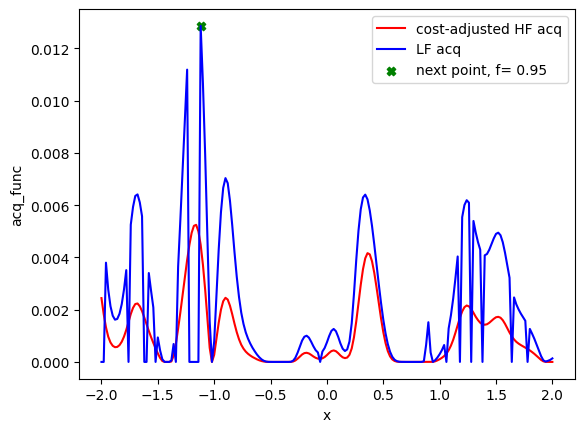

[401 169   0   1 147 159 139 182  97  24  19  20 153 189  12 164  33 250
  49  43  42  41  40  39  44]
[-1.12  0.95] -1.12
Evaluation 35 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:26<00:00, 19.03it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:30<00:00, 16.46it/s]
<ipython-input-5-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 26: 56.66647171974182


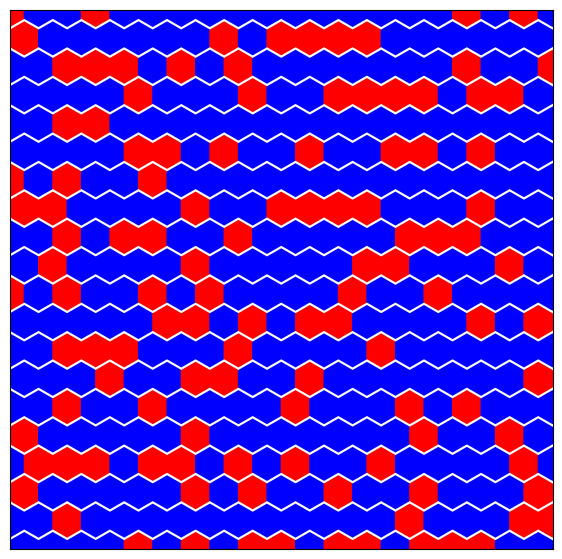

In [ ]:
N = 25
cost_ratio = 8.6/3 #time complexities
f = np.array([1.0, 2.0])
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_hf, X_test_lf))
X_test_full = np.vstack((X_test_hf, X_test_lf))
X_test_norm = np.vstack((X_test_hf, X_test_lf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.LogNormal(0, 1)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")
        plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs, y_pred, label="HF_mean")
        plt.plot(xs, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")
        plt.ylim(-0.2, 0.6)
        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            J_mat = np.array([[0,Jx[-1],0,Jx[-1],0],
                      [Jx[-1],0,0,0,Jx[-1]],
                      [0,Jx[-1],0,Jx[-1],0]])
            tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
            sq_sim = tri_sim

        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        if train_x_full[-1,1] == 1: #High fidelity
            plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])

        else: #Low fidelity
            sq_sim.plot_config(resultsBO_dict[n+i]['sim']['config'][-1])

        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

sample: 100%|██████████| 4000/4000 [00:34<00:00, 117.37it/s, 7 steps of size 5.75e-01. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
     delta      0.75      0.17      0.77      0.50      1.00   1566.04      1.00
  k_length      0.05      0.00      0.05      0.05      0.05   2252.75      1.00
   k_scale      0.08      0.03      0.07      0.05      0.12   1540.59      1.00
     noise      1.77      2.63      1.05      0.06      3.84   1418.12      1.00



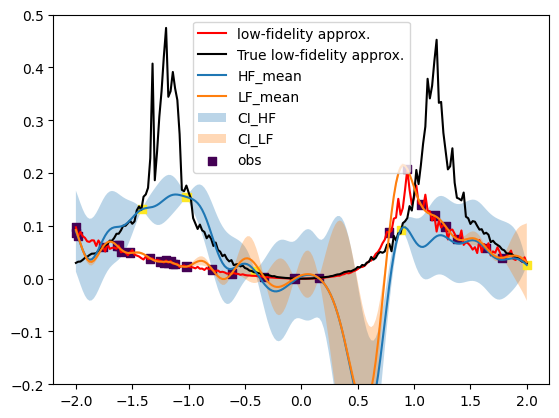

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior, noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.LogNormal(0, 1)))
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)

y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")
plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")
pred_lower = y_pred - y_sampled.std(axis=(0,1))
pred_upper = y_pred + y_sampled.std(axis=(0,1))
pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
plt.plot(xs, y_pred, label="HF_mean")
plt.plot(xs, y_pred_lf, label="LF_mean")
plt.fill_between(
    xs.flatten(),
    pred_lower,
    pred_upper,
    alpha=0.3,
    label="CI_HF",
)

plt.fill_between(
    xs.flatten(),
    pred_lower_lf,
    pred_upper_lf,
    alpha=0.3,
    label="CI_LF",
)

plt.scatter(train_x_full[:, 0], train_y, c=train_x_full[:, 1], cmap="viridis", marker="s", label="obs")
plt.ylim(-0.2, 0.5)

plt.legend(loc="best")
plt.show()

In [ ]:
train_x_full

array([[-0.33191198,  0.95      ],
       [ 0.88129797,  1.        ],
       [-1.9995425 ,  0.95      ],
       [-0.79066971,  0.95      ],
       [-1.41297644,  1.        ],
       [-1.63064562,  0.95      ],
       [-1.25495915,  0.95      ],
       [-0.61775709,  0.95      ],
       [-0.4129301 ,  1.        ],
       [ 0.15526694,  0.95      ],
       [ 2.        ,  1.        ],
       [ 1.38      ,  0.95      ],
       [-2.        ,  0.95      ],
       [-1.98      ,  0.95      ],
       [ 0.94      ,  0.95      ],
       [ 1.18      ,  0.95      ],
       [ 0.78      ,  0.95      ],
       [ 1.64      ,  0.95      ],
       [-0.06      ,  0.95      ],
       [-1.52      ,  0.95      ],
       [-1.62      ,  0.95      ],
       [-1.6       ,  0.95      ],
       [ 1.06      ,  0.95      ],
       [ 1.78      ,  0.95      ],
       [-1.76      ,  0.95      ],
       [ 1.28      ,  0.95      ],
       [-1.34      ,  0.95      ],
       [-1.02      ,  1.        ],
       [-1.02      ,

# MFBO with structured GP

- Correct models

In [ ]:
n = 10

np.random.seed(1)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]))

<ipython-input-46-8de86ade8ab9>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:23<00:00, 21.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:18<00:00,  6.39it/s]


Completed. Saving
Time (s) to complete simulation 1: 101.738778591156


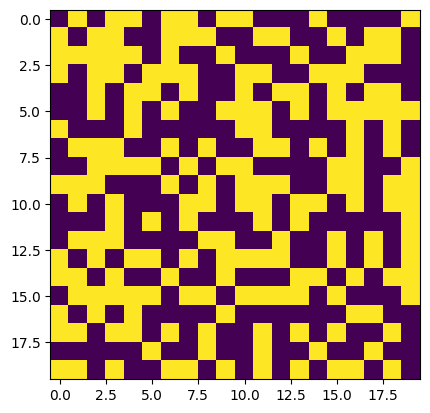

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:18<00:00,  2.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:41<00:00,  1.16s/it]


Completed. Saving
Time (s) to complete simulation 2: 779.9239275455475


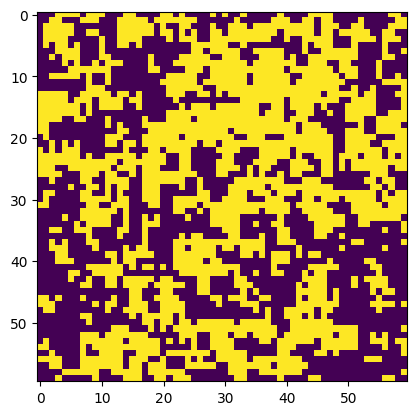

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 22.75it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:06<00:00,  7.48it/s]


Completed. Saving
Time (s) to complete simulation 3: 88.80508279800415


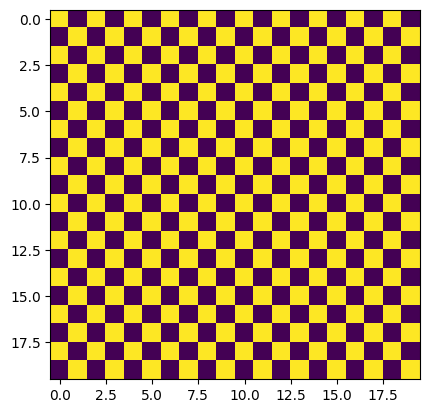

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 22.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:07<00:00,  7.44it/s]


Completed. Saving
Time (s) to complete simulation 4: 89.31434917449951


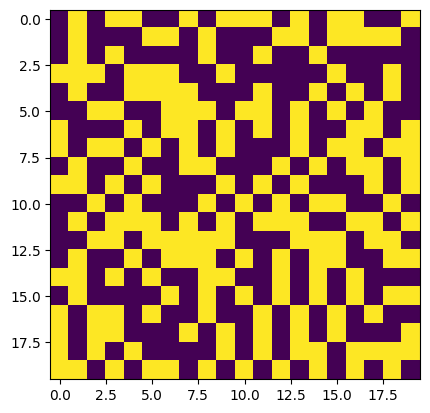

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:19<00:00,  2.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:38<00:00,  1.16s/it]


Completed. Saving
Time (s) to complete simulation 5: 778.8746349811554


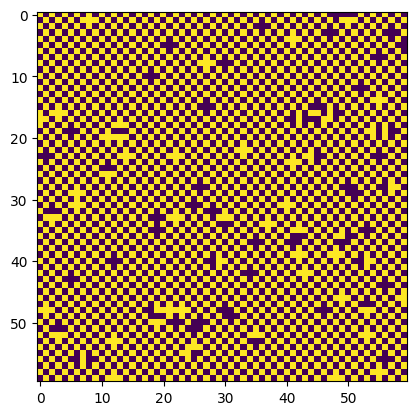

Evaluation 6 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 23.15it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:06<00:00,  7.56it/s]


Completed. Saving
Time (s) to complete simulation 6: 87.71559619903564


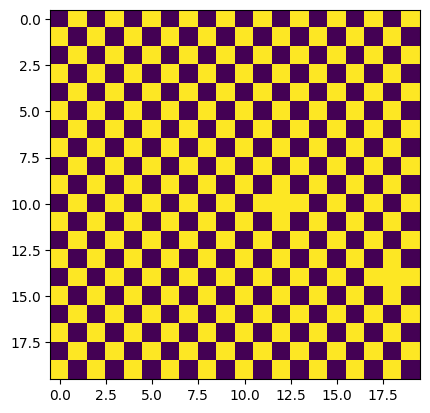

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 22.86it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:06<00:00,  7.57it/s]


Completed. Saving
Time (s) to complete simulation 7: 87.95620656013489


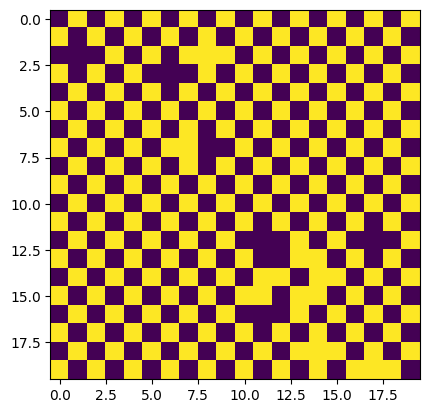

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:21<00:00, 22.74it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:06<00:00,  7.54it/s]


Completed. Saving
Time (s) to complete simulation 8: 88.29163813591003


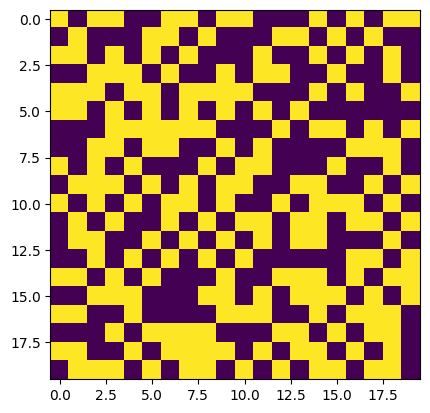

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:14<00:00,  2.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:42<00:00,  1.16s/it]


Completed. Saving
Time (s) to complete simulation 9: 776.4622428417206


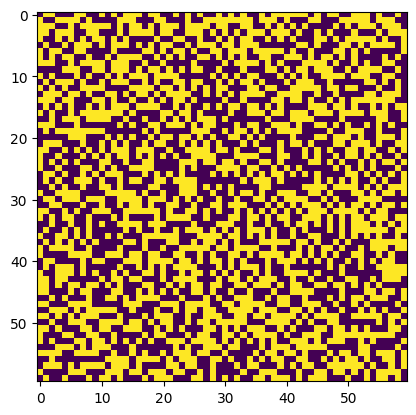

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:22<00:00, 22.36it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:07<00:00,  7.44it/s]


Completed. Saving
Time (s) to complete simulation 10: 89.5661096572876


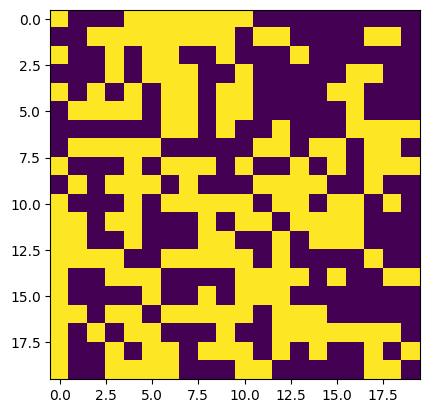

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    plt.imshow(resultsBO_dict[i]['sim']['config'][-1])
    plt.show()

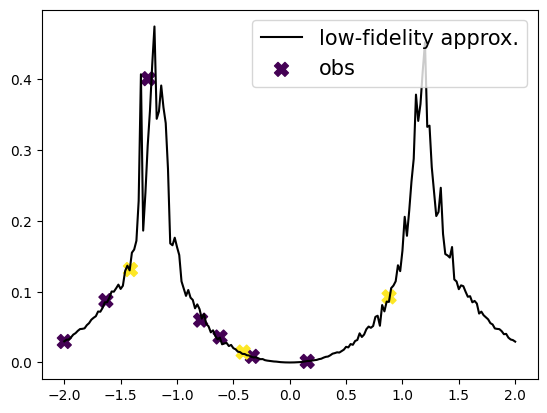

In [ ]:
plt.plot(xs, approx_ys_sq, "k", label="low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

# GP mean function
- Prioir information about peaks and power function

In [ ]:
@jit
def mean_func2(x: jnp.ndarray, params: Dict[str, float]) -> jnp.ndarray:

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    lb = -2
    ub = 2
    # x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)

    return jnp.piecewise(
            x_data, [x_data < params["t1"], params["t1"] <= x_data <params["t2"],  x_data >=params["t2"]],
            [lambda x_data: x_data**params["alpha1"],
             lambda x_data: x_data**params["alpha2"],
             lambda x_data: x_data**params["alpha3"]])

def mf_priors2():
    # Sample model parameters
    t1 = numpyro.sample("t1", numpyro.distributions.Uniform(0.0, 0.49))
    t2 = numpyro.sample("t2", numpyro.distributions.Uniform(0.51, 1.0))
    alpha1 = numpyro.sample("alpha1", numpyro.distributions.Normal(2, 1))
    alpha2 = numpyro.sample("alpha2", numpyro.distributions.Normal(2, 1))
    alpha3 = numpyro.sample("alpha3", numpyro.distributions.Normal(2, 1))


    # Return sampled parameters as a dictionary
    return {"t1": t1, "t2": t2, "alpha1": alpha1, "alpha2": alpha2, "alpha3": alpha3}


In [ ]:
@jit
def mean_func(x: jnp.ndarray, params: Dict[str, float]) -> jnp.ndarray:

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    #lb = -2
    #ub = 2
    #x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)

    return jnp.piecewise(
        x_data, [x_data < params["t"], x_data >= params["t"]],
        [lambda x_data: x_data**params["alpha1"], lambda x_data: -x_data**params["alpha2"]])


def mf_priors():
    # Sample model parameters
    t = numpyro.sample("t", numpyro.distributions.Uniform(0.5, 1.0))
    alpha1 = numpyro.sample("alpha1", numpyro.distributions.HalfNormal(2))
    alpha2 = numpyro.sample("alpha2", numpyro.distributions.HalfNormal(2))
    # Return sampled parameters as a dictionary
    return {"t": t, "alpha1": alpha1, "alpha2": alpha2}


Run BO 25 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]),
 array([[0.00865403],
        [0.09279848],
        [0.02968125],
        [0.05988589],
        [0.13141094],
        [0.08751802],
        [0.40115651],
        [0.03599105],
        [0.01471007],
        [0.0015186

Step:1


sample: 100%|██████████| 4000/4000 [00:18<00:00, 216.95it/s, 63 steps of size 3.60e-02. acc. prob=0.80] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.39      1.31      3.34      1.24      5.44    589.73      1.00
    alpha2      1.78      1.32      1.52      0.01      3.66    819.36      1.00
     delta      0.90      0.64      0.79      0.00      1.78    688.18      1.00
  k_length      0.05      0.03      0.05      0.01      0.10    321.90      1.01
   k_scale      0.09      0.10      0.05      0.01      0.18    509.22      1.00
     noise      0.01      0.01      0.01      0.00      0.02    887.27      1.00
         t      0.83      0.11      0.84      0.71      1.00    621.18      1.00



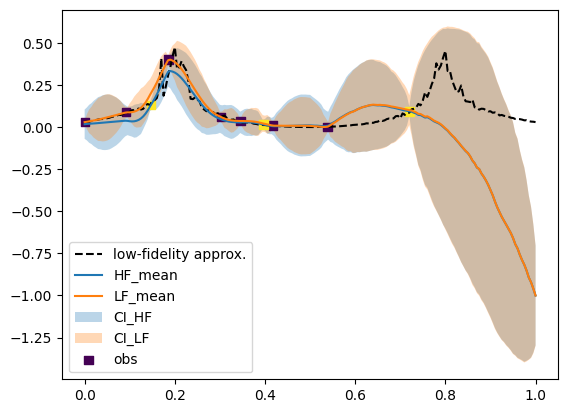

(402,)


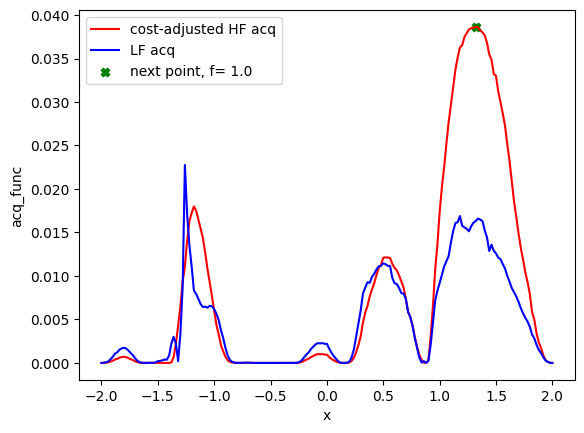

367
[1.32 1.  ] 1.3200000000000003
Evaluation 11 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:14<00:00,  6.70it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Completed. Saving
Time (s) to complete simulation 2: 253.75308918952942


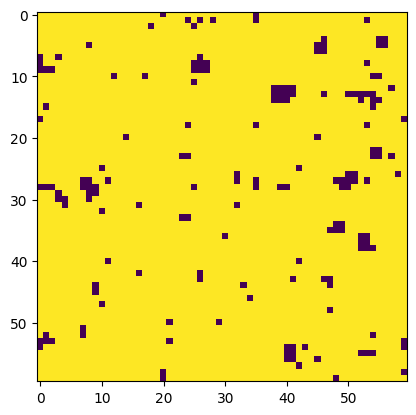

Step:2


sample: 100%|██████████| 4000/4000 [01:01<00:00, 65.11it/s, 1023 steps of size 1.57e-03. acc. prob=0.83]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.74      1.36      3.72      1.39      5.83    187.23      1.00
    alpha2      1.83      1.29      1.55      0.01      3.72    370.77      1.00
     delta      0.96      0.59      0.85      0.04      1.82    443.95      1.00
  k_length      0.06      0.03      0.06      0.02      0.10    181.45      1.00
   k_scale      0.10      0.10      0.06      0.01      0.21    180.54      1.01
     noise      0.01      0.01      0.01      0.00      0.02    208.87      1.00
         t      0.89      0.09      0.90      0.83      1.00     59.85      1.00



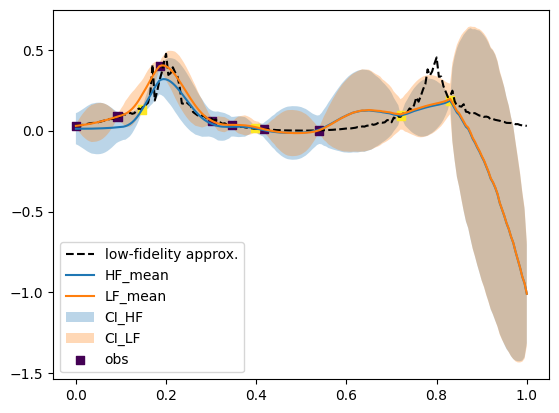

(402,)


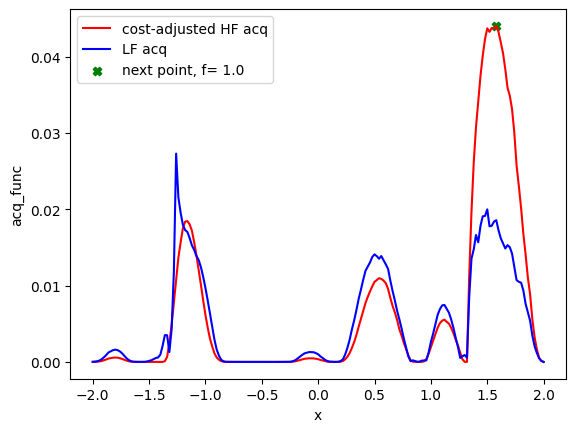

[367 380]
[1.58 1.  ] 1.58
Evaluation 12 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:12<00:00,  6.87it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:56<00:00,  2.83it/s]


Completed. Saving
Time (s) to complete simulation 3: 249.75241231918335


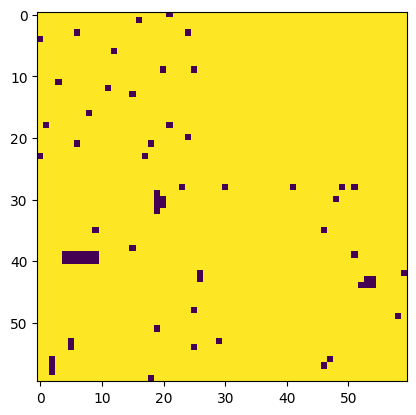

Step:3


sample: 100%|██████████| 4000/4000 [00:57<00:00, 69.85it/s, 1023 steps of size 1.06e-03. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.98      1.38      2.82      0.81      5.20     33.44      1.02
    alpha2      2.39      1.38      2.21      0.14      4.36     94.59      1.01
     delta      0.94      0.55      0.82      0.13      1.75    291.10      1.01
  k_length      0.08      0.02      0.09      0.05      0.12     29.51      1.00
   k_scale      0.21      0.19      0.16      0.02      0.40     94.94      1.00
     noise      0.01      0.01      0.01      0.00      0.02    135.85      1.00
         t      0.79      0.17      0.82      0.56      1.00     13.92      1.05



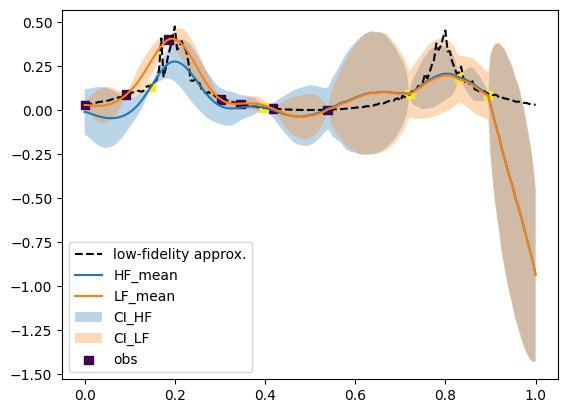

(402,)


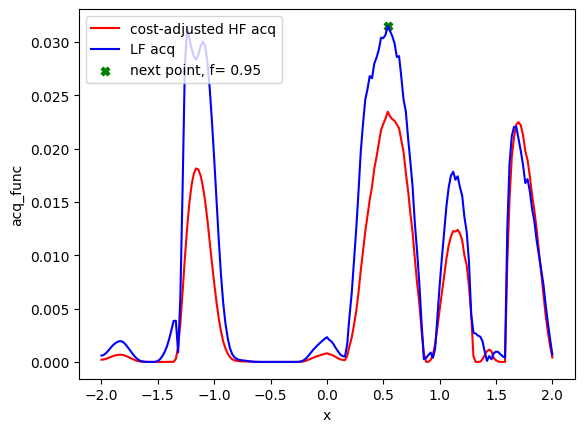

[367 380 127]
[0.54 0.95] 0.54
Evaluation 13 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 56.26it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.89it/s]


Completed. Saving
Time (s) to complete simulation 4: 29.83510112762451


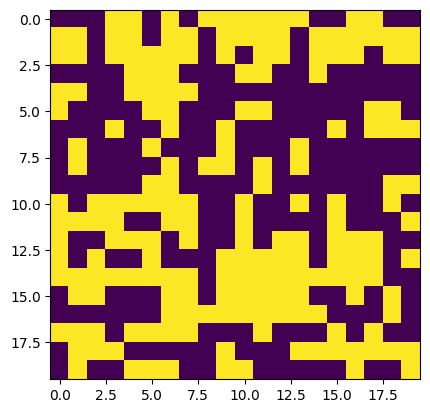

Step:4


sample: 100%|██████████| 4000/4000 [01:11<00:00, 56.22it/s, 1023 steps of size 1.81e-03. acc. prob=0.84]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.52      1.46      3.38      1.04      5.62    190.11      1.00
    alpha2      2.05      1.47      1.75      0.01      4.05     48.28      1.01
     delta      0.94      0.57      0.84      0.04      1.75    806.26      1.00
  k_length      0.08      0.02      0.08      0.04      0.12    101.81      1.01
   k_scale      0.15      0.14      0.11      0.02      0.30    152.65      1.01
     noise      0.01      0.01      0.01      0.00      0.02    481.23      1.00
         t      0.88      0.14      0.93      0.59      1.00     11.27      1.08



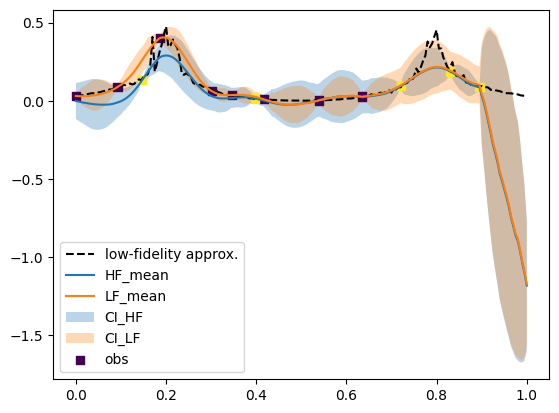

(402,)


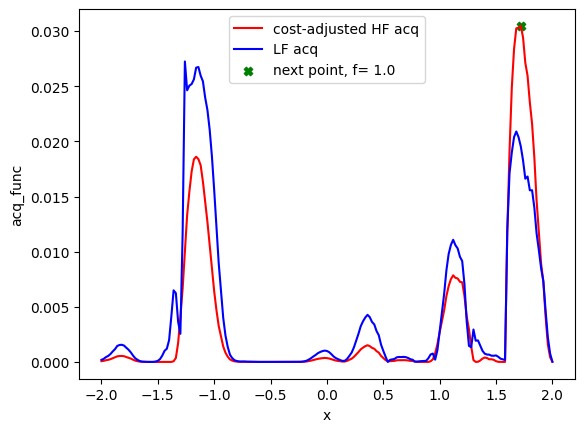

[367 380 127 387]
[1.72 1.  ] 1.7200000000000002
Evaluation 14 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:13<00:00,  6.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:57<00:00,  2.82it/s]


Completed. Saving
Time (s) to complete simulation 5: 251.00495600700378


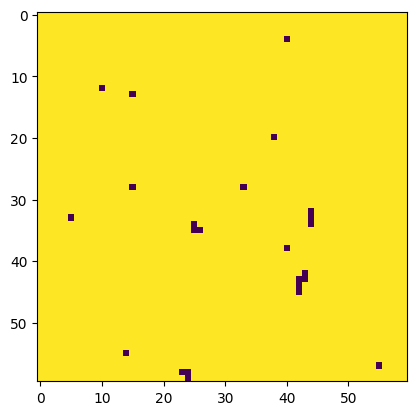

Step:5


sample: 100%|██████████| 4000/4000 [01:19<00:00, 50.40it/s, 1023 steps of size 2.52e-04. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.84      1.06      2.79      1.09      4.34     18.73      1.02
    alpha2      3.40      0.92      3.26      2.04      4.90     18.54      1.00
     delta      0.84      0.43      0.76      0.18      1.44     32.80      1.00
  k_length      0.10      0.01      0.10      0.08      0.13     13.68      1.13
   k_scale      0.32      0.22      0.25      0.08      0.63     12.43      1.22
     noise      0.01      0.01      0.01      0.00      0.02     53.51      1.00
         t      0.60      0.07      0.59      0.50      0.69     16.74      1.07



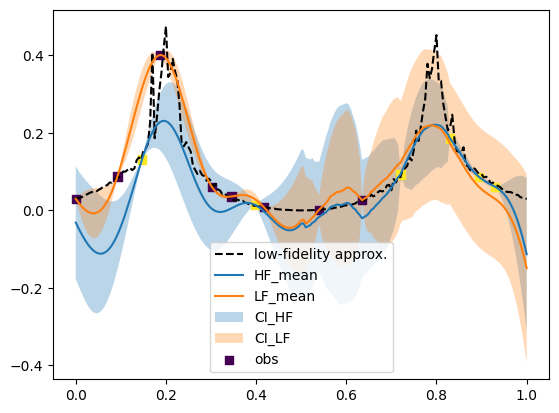

(402,)


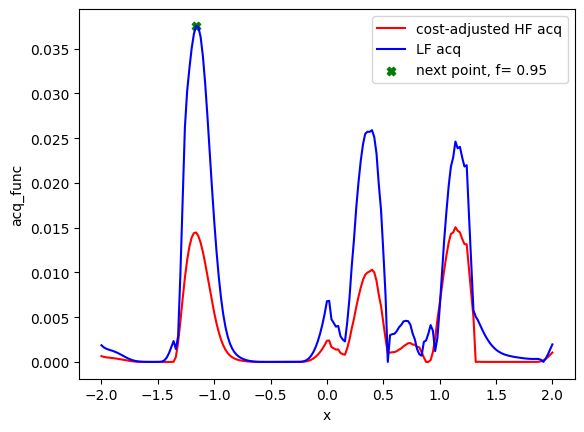

[367 380 127 387  42]
[-1.16  0.95] -1.1600000000000001
Evaluation 15 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.93it/s]


Completed. Saving
Time (s) to complete simulation 6: 29.49717378616333


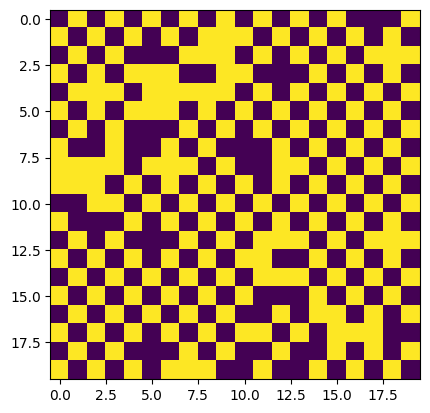

Step:6


sample: 100%|██████████| 4000/4000 [01:32<00:00, 43.24it/s, 1023 steps of size 3.07e-05. acc. prob=0.99]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.30      0.51      5.28      4.14      5.86      7.31      1.40
    alpha2      4.48      0.35      4.56      3.98      4.97      3.17      1.91
     delta      0.86      0.08      0.87      0.71      0.98      8.58      1.02
  k_length      0.11      0.00      0.11      0.10      0.12      6.43      1.16
   k_scale      0.24      0.03      0.24      0.21      0.31      6.91      1.05
     noise      0.02      0.00      0.02      0.02      0.02      7.91      1.26
         t      0.69      0.05      0.68      0.64      0.82      5.50      1.07



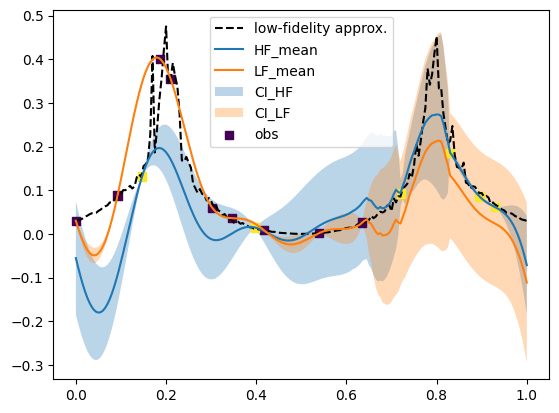

(402,)


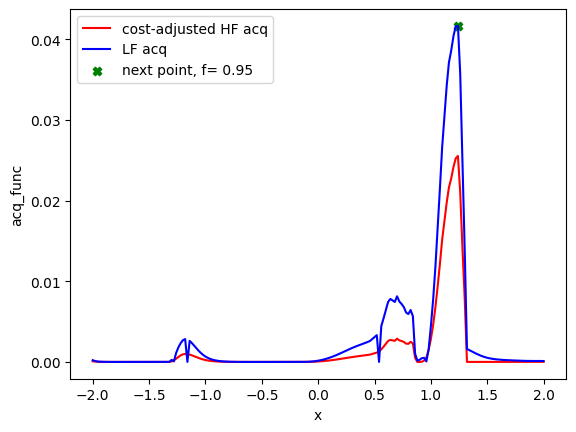

[367 380 127 387  42 162]
[1.24 0.95] 1.2400000000000002
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.51it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.94it/s]


Completed. Saving
Time (s) to complete simulation 7: 29.300453901290894


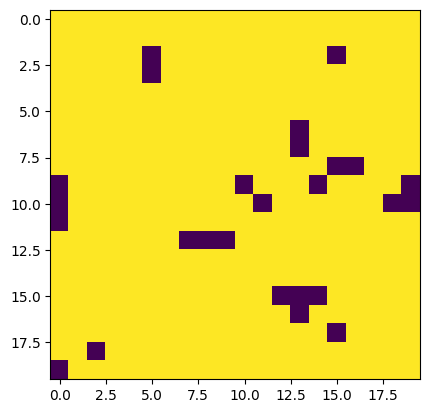

Step:7


sample: 100%|██████████| 4000/4000 [01:24<00:00, 47.24it/s, 1023 steps of size 2.26e-05. acc. prob=0.99]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.29      0.30      5.29      4.88      5.79      8.86      1.14
    alpha2      4.65      0.32      4.76      4.19      5.06      2.86      2.27
     delta      0.59      0.04      0.60      0.52      0.67      7.73      1.00
  k_length      0.11      0.00      0.11      0.11      0.12      6.54      1.10
   k_scale      0.27      0.03      0.27      0.24      0.32      6.87      1.04
     noise      0.02      0.00      0.02      0.02      0.03      3.55      1.79
         t      0.71      0.04      0.70      0.68      0.80      4.95      1.14



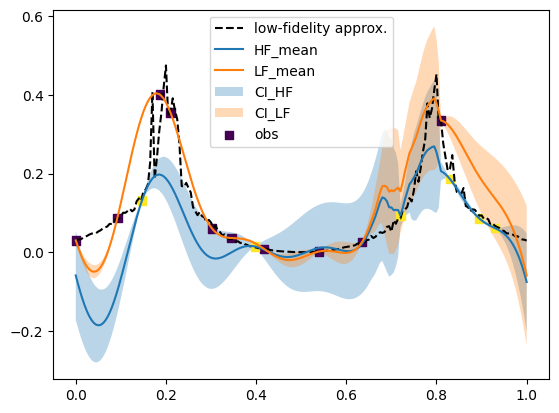

(402,)


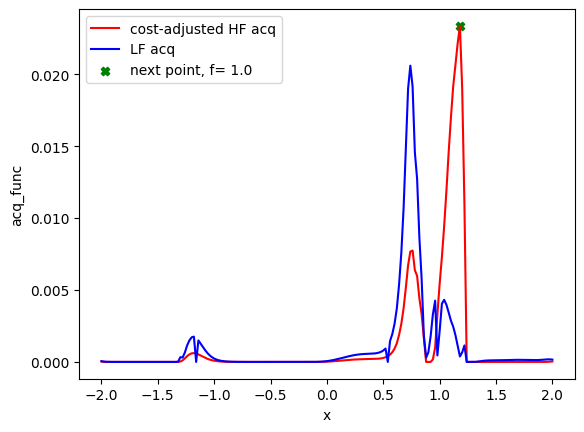

[367 380 127 387  42 162 360]
[1.18 1.  ] 1.1800000000000002
Evaluation 17 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:15<00:00,  6.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:58<00:00,  2.80it/s]


Completed. Saving
Time (s) to complete simulation 8: 253.7592749595642


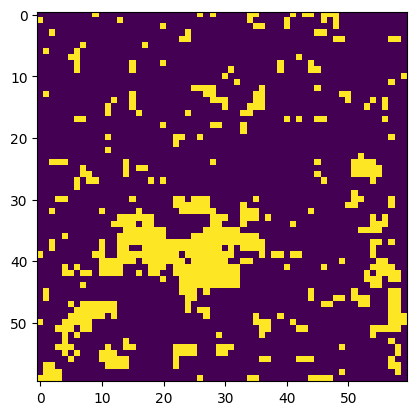

Step:8


sample: 100%|██████████| 4000/4000 [01:32<00:00, 43.04it/s, 1023 steps of size 2.40e-03. acc. prob=0.74]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.85      1.28      3.77      1.72      5.91    259.62      1.00
    alpha2      1.74      1.27      1.45      0.03      3.49    278.45      1.00
     delta      0.83      0.53      0.74      0.05      1.59    735.42      1.00
  k_length      0.04      0.01      0.04      0.02      0.06    179.35      1.01
   k_scale      0.13      0.11      0.10      0.03      0.22    163.17      1.01
     noise      0.01      0.01      0.01      0.00      0.02    375.87      1.01
         t      0.95      0.06      0.96      0.93      1.00     51.44      1.02



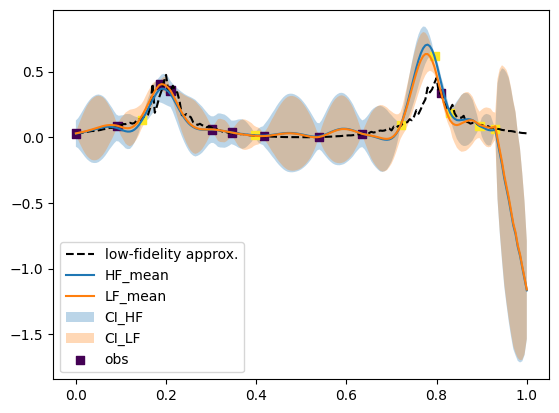

(402,)


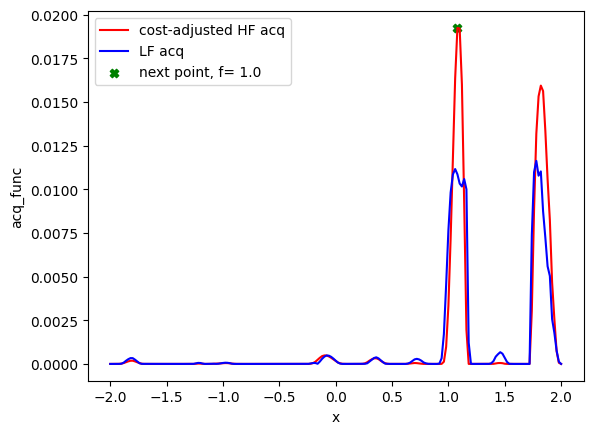

[367 380 127 387  42 162 360 355]
[1.08 1.  ] 1.08
Evaluation 18 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:15<00:00,  6.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:58<00:00,  2.80it/s]

Completed. Saving
Time (s) to complete simulation 9: 254.1155984401703


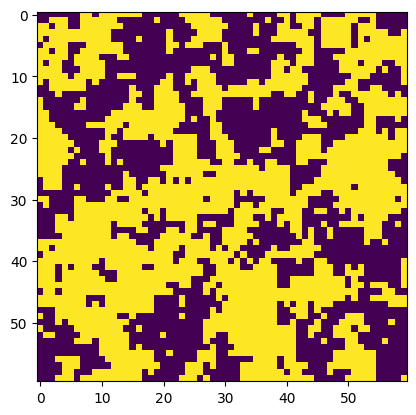

Step:9


sample: 100%|██████████| 4000/4000 [01:25<00:00, 46.77it/s, 1023 steps of size 1.58e-03. acc. prob=0.72]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.66      1.25      4.62      2.59      6.68    188.56      1.00
    alpha2      1.87      1.40      1.56      0.03      3.75    185.16      1.01
     delta      0.92      0.60      0.81      0.02      1.78    286.31      1.01
  k_length      0.02      0.01      0.02      0.00      0.03    173.77      1.01
   k_scale      0.10      0.05      0.08      0.03      0.16    174.18      1.00
     noise      0.01      0.01      0.01      0.00      0.02    209.37      1.00
         t      0.95      0.04      0.96      0.93      1.00    138.83      1.01



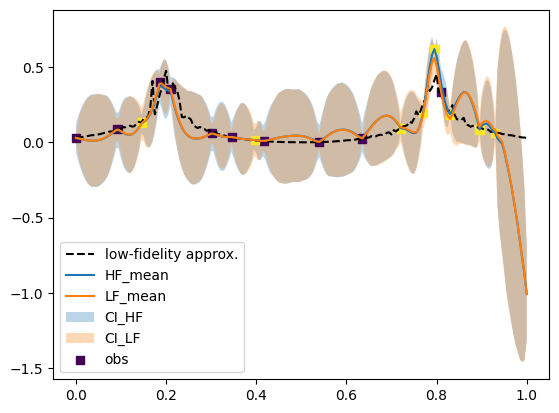

(402,)


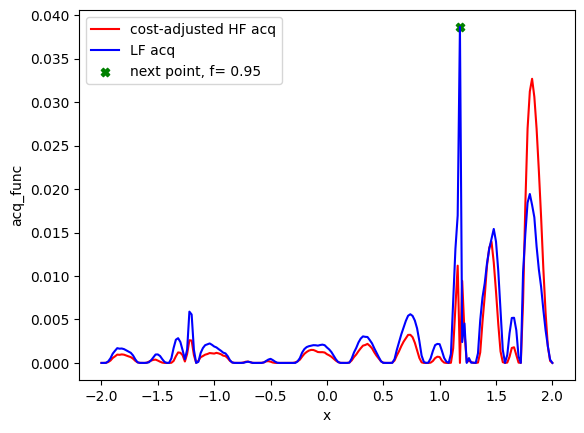

[367 380 127 387  42 162 360 355 159]
[1.18 0.95] 1.1800000000000002
Evaluation 19 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.88it/s]


Completed. Saving
Time (s) to complete simulation 10: 29.35377526283264


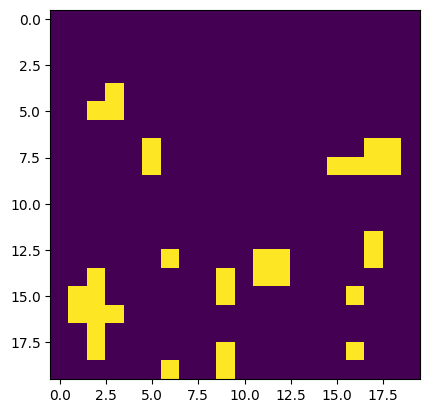

Step:10


sample: 100%|██████████| 4000/4000 [01:59<00:00, 33.45it/s, 1023 steps of size 1.28e-03. acc. prob=0.83]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.39      1.32      4.35      2.09      6.62    118.70      1.00
    alpha2      1.75      1.21      1.50      0.01      3.48    294.52      1.00
     delta      1.37      0.57      1.29      0.56      2.33    210.57      1.00
  k_length      0.03      0.01      0.03      0.02      0.04    135.33      1.01
   k_scale      0.12      0.07      0.10      0.05      0.21     92.21      1.00
     noise      0.01      0.01      0.01      0.00      0.02    272.40      1.00
         t      0.96      0.03      0.96      0.93      1.00    130.81      1.00



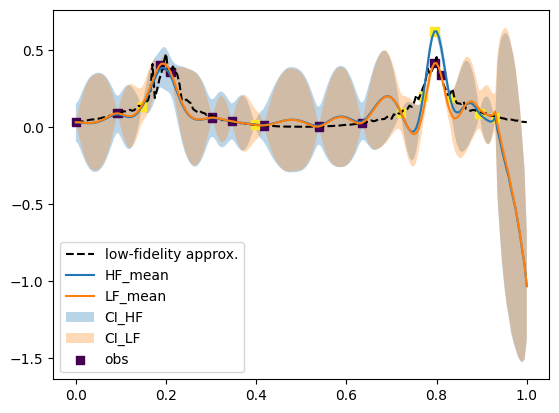

(402,)


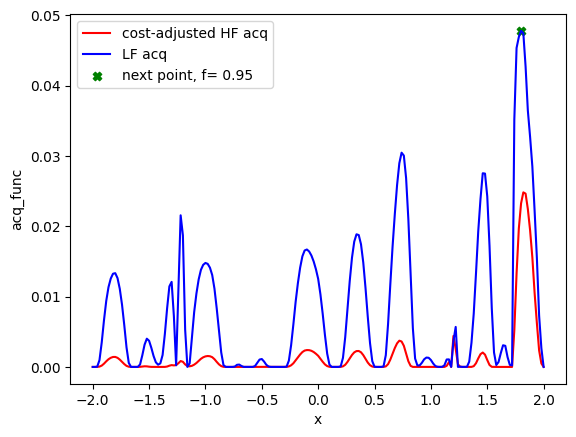

[367 380 127 387  42 162 360 355 159 190]
[1.8  0.95] 1.8000000000000003
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.94it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.81it/s]


Completed. Saving
Time (s) to complete simulation 11: 29.49921727180481


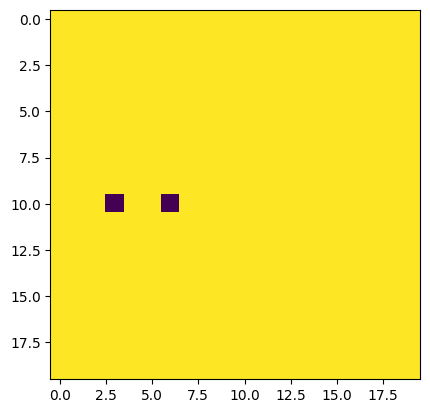

Step:11


sample: 100%|██████████| 4000/4000 [02:02<00:00, 32.53it/s, 1023 steps of size 9.88e-04. acc. prob=0.72]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.08      1.34      2.84      1.16      5.07     21.06      1.02
    alpha2      3.02      1.64      2.86      0.31      5.29     38.49      1.00
     delta      1.12      0.50      1.05      0.36      1.91     99.07      1.02
  k_length      0.04      0.01      0.04      0.02      0.05     21.61      1.02
   k_scale      0.21      0.12      0.18      0.06      0.38     29.48      1.01
     noise      0.01      0.01      0.01      0.00      0.02    104.32      1.00
         t      0.78      0.15      0.75      0.56      1.00     10.52      1.04



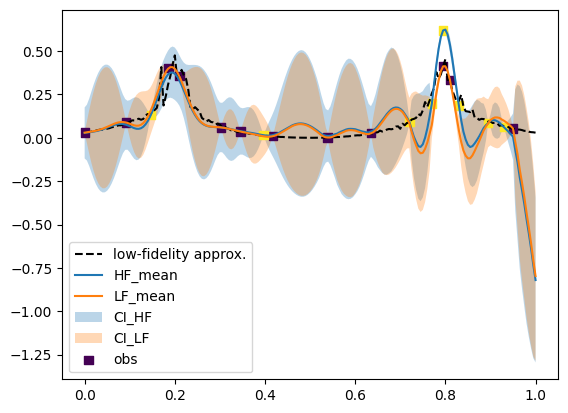

(402,)


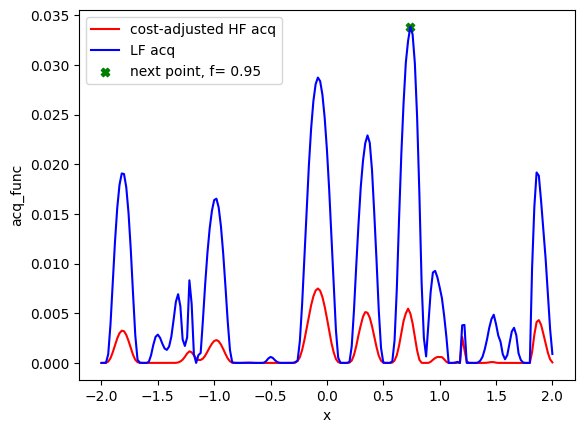

[367 380 127 387  42 162 360 355 159 190 137]
[0.74 0.95] 0.7400000000000002
Evaluation 21 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 56.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.34it/s]


Completed. Saving
Time (s) to complete simulation 12: 30.35670042037964


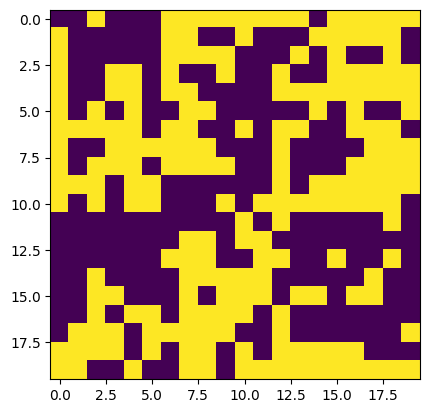

Step:12


sample: 100%|██████████| 4000/4000 [02:05<00:00, 31.89it/s, 1023 steps of size 4.23e-03. acc. prob=0.62]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.87      1.51      3.81      1.35      6.17     17.55      1.10
    alpha2      2.01      1.50      1.69      0.04      4.13     46.69      1.08
     delta      1.16      0.54      1.09      0.27      1.97    184.91      1.02
  k_length      0.03      0.01      0.03      0.02      0.05     12.89      1.14
   k_scale      0.17      0.11      0.14      0.04      0.31     19.63      1.10
     noise      0.01      0.01      0.01      0.00      0.02    375.55      1.00
         t      0.91      0.11      0.96      0.74      1.00      5.68      1.36



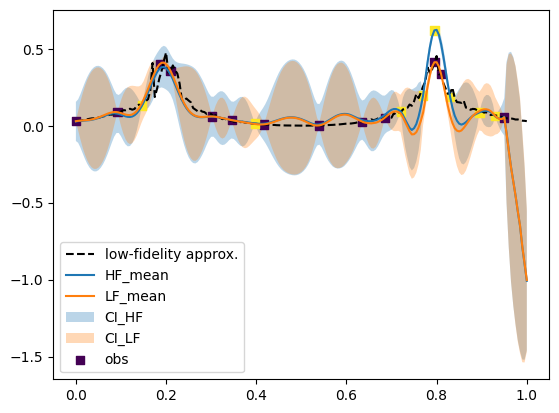

(402,)


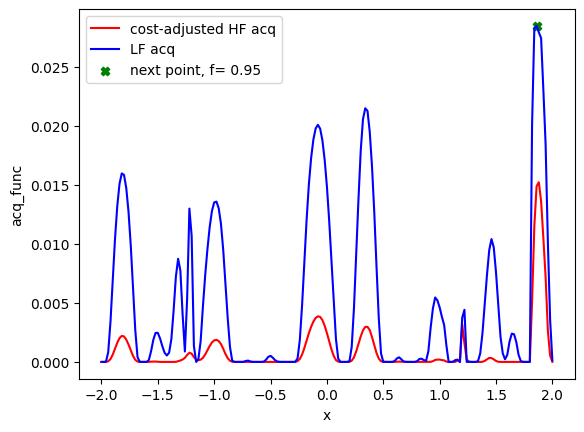

[367 380 127 387  42 162 360 355 159 190 137 193]
[1.86 0.95] 1.8599999999999999
Evaluation 22 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.56it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.12it/s]


Completed. Saving
Time (s) to complete simulation 13: 29.283093452453613


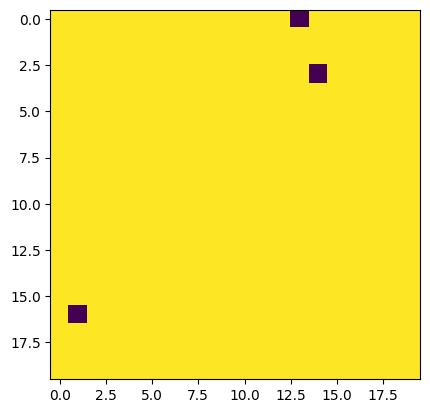

Step:13


sample: 100%|██████████| 4000/4000 [02:31<00:00, 26.39it/s, 1023 steps of size 7.65e-05. acc. prob=0.97]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.71      0.93      2.54      1.41      3.49      7.92      1.44
    alpha2      2.35      0.59      2.56      1.48      3.14      3.20      1.98
     delta      0.71      0.18      0.73      0.39      0.94      5.53      1.28
  k_length      0.05      0.00      0.05      0.04      0.05      7.21      1.00
   k_scale      0.34      0.06      0.32      0.26      0.44      6.92      1.32
     noise      0.01      0.00      0.01      0.00      0.01      7.15      1.60
         t      0.74      0.01      0.74      0.72      0.77     18.05      1.12



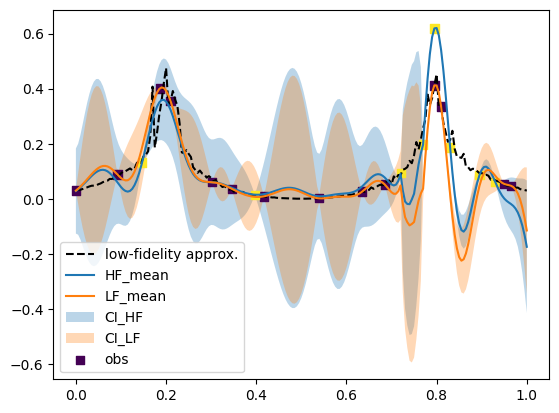

(402,)


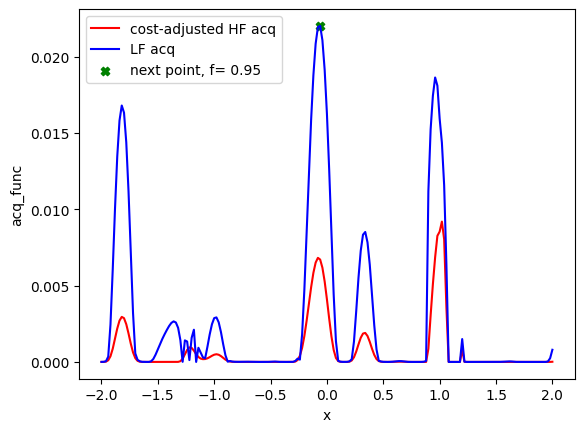

[367 380 127 387  42 162 360 355 159 190 137 193  97]
[-0.06  0.95] -0.06000000000000005
Evaluation 23 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:09<00:00, 55.40it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.09it/s]


Completed. Saving
Time (s) to complete simulation 14: 30.691335201263428


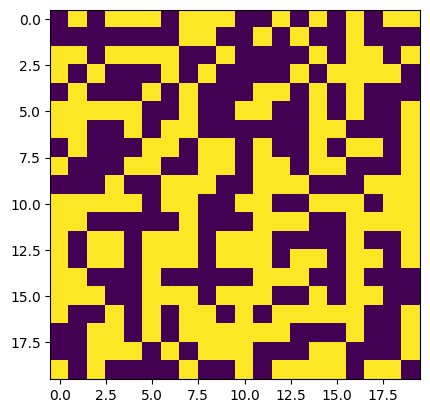

Step:14


sample: 100%|██████████| 4000/4000 [02:39<00:00, 25.00it/s, 1023 steps of size 7.74e-05. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.77      0.68      2.62      1.62      3.48     11.17      1.19
    alpha2      2.56      0.64      2.59      1.63      3.48      4.21      1.58
     delta      0.81      0.19      0.82      0.46      1.06      5.52      1.36
  k_length      0.05      0.00      0.05      0.04      0.05      4.97      1.42
   k_scale      0.32      0.10      0.29      0.19      0.47      4.10      1.76
     noise      0.00      0.00      0.00      0.00      0.01      4.05      2.00
         t      0.75      0.01      0.75      0.72      0.77     57.17      1.02



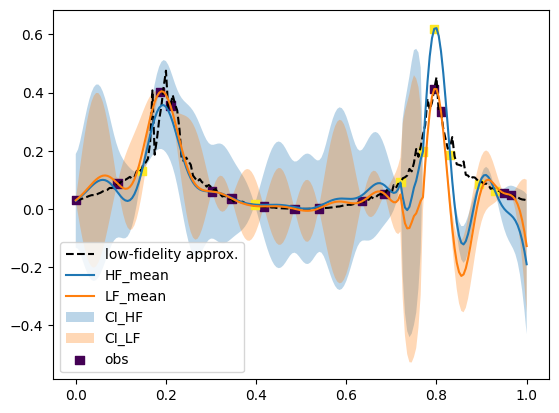

(402,)


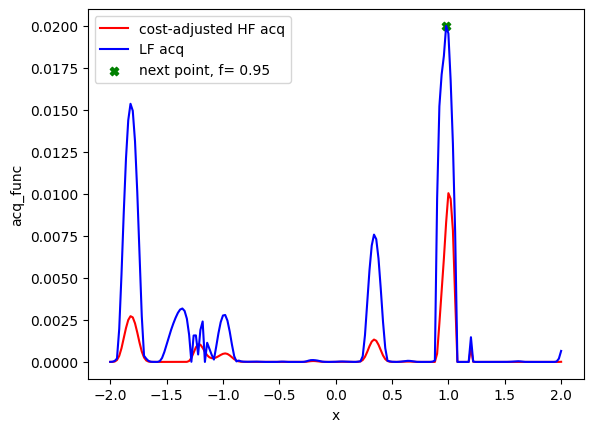

[367 380 127 387  42 162 360 355 159 190 137 193  97 149]
[0.98 0.95] 0.98
Evaluation 24 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 57.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 24.11it/s]


Completed. Saving
Time (s) to complete simulation 15: 29.522101402282715


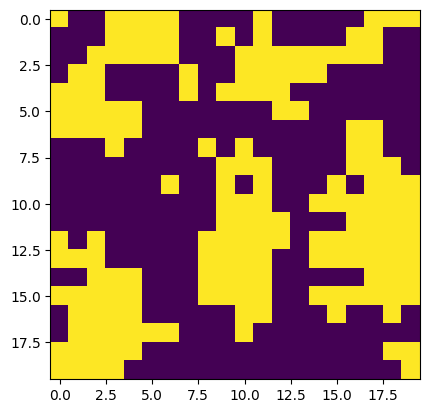

Step:15


sample: 100%|██████████| 4000/4000 [02:43<00:00, 24.41it/s, 1023 steps of size 2.40e-05. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.98      0.21      4.98      4.67      5.32     10.59      1.04
    alpha2      4.35      0.53      4.52      3.60      5.03      2.97      2.13
     delta      1.60      0.10      1.62      1.41      1.73      6.29      1.14
  k_length      0.03      0.00      0.04      0.03      0.04      6.24      1.18
   k_scale      0.14      0.01      0.14      0.13      0.16      6.73      1.16
     noise      0.02      0.00      0.02      0.02      0.02      8.18      1.26
         t      0.88      0.01      0.88      0.88      0.89      5.21      1.00



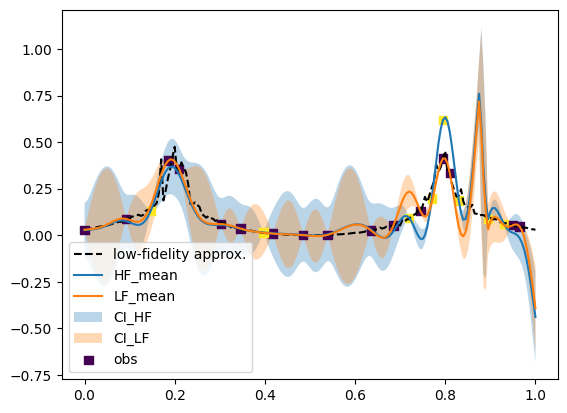

(402,)


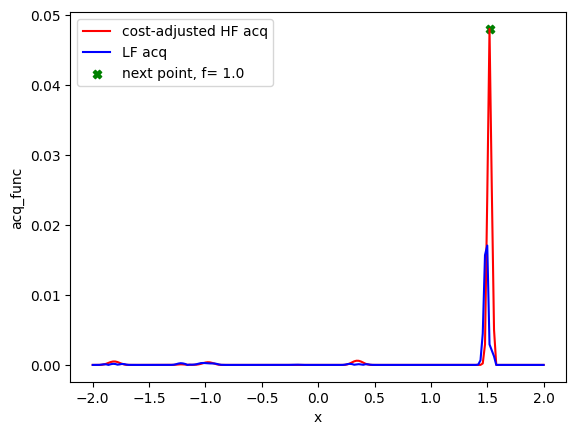

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377]
[1.52 1.  ] 1.52
Evaluation 25 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:15<00:00,  6.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Completed. Saving
Time (s) to complete simulation 16: 254.80090403556824


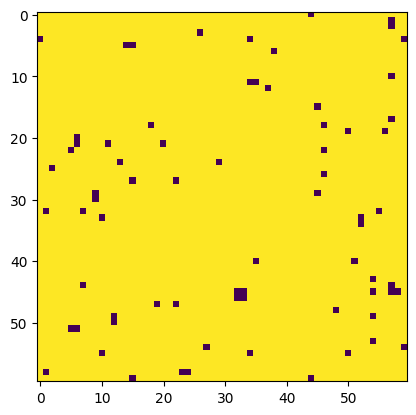

Step:16


sample: 100%|██████████| 4000/4000 [03:03<00:00, 21.80it/s, 1023 steps of size 8.76e-05. acc. prob=0.99]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.42      0.53      3.31      2.40      4.10     11.84      1.31
    alpha2      4.19      0.60      4.26      3.31      5.10      4.23      1.50
     delta      1.15      0.37      1.12      0.53      1.76      3.70      1.80
  k_length      0.04      0.00      0.04      0.04      0.04      6.89      1.19
   k_scale      0.20      0.05      0.19      0.13      0.28      5.67      1.46
     noise      0.01      0.00      0.01      0.01      0.02     13.23      1.13
         t      0.76      0.01      0.75      0.75      0.77      5.06      1.10



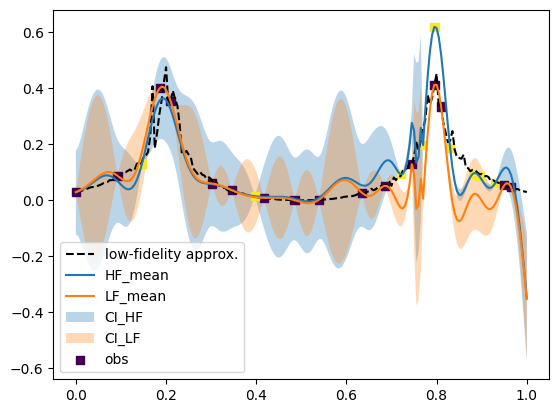

(402,)


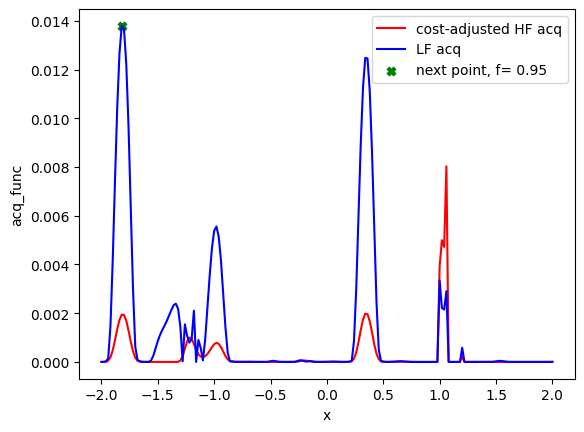

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9]
[-1.82  0.95] -1.82
Evaluation 26 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.01it/s]


Completed. Saving
Time (s) to complete simulation 17: 30.339114665985107


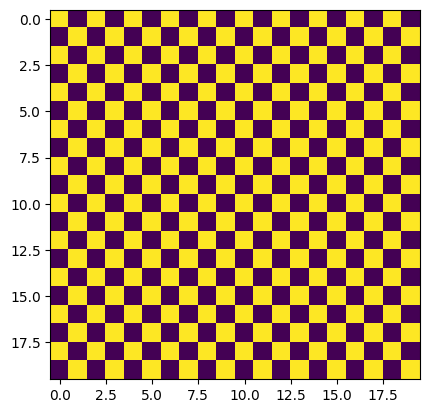

Step:17


sample: 100%|██████████| 4000/4000 [03:21<00:00, 19.88it/s, 1023 steps of size 1.28e-03. acc. prob=0.88]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.34      0.99      3.19      1.84      5.02    221.48      1.00
    alpha2      4.23      1.25      4.14      2.09      6.02    204.56      1.00
     delta      0.96      0.47      0.87      0.28      1.66    233.63      1.00
  k_length      0.04      0.00      0.04      0.03      0.04     90.37      1.01
   k_scale      0.19      0.09      0.17      0.08      0.31     88.89      1.01
     noise      0.01      0.01      0.01      0.00      0.02    234.16      1.00
         t      0.76      0.01      0.76      0.75      0.77    167.77      1.00



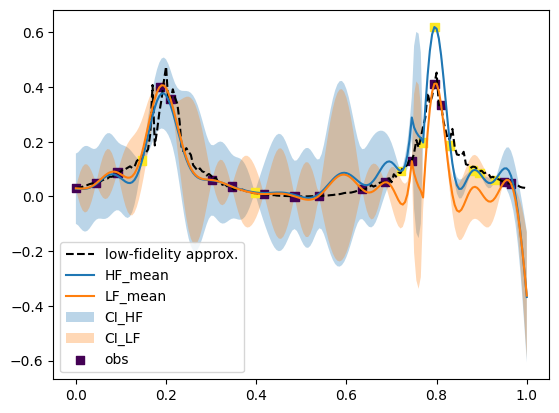

(402,)


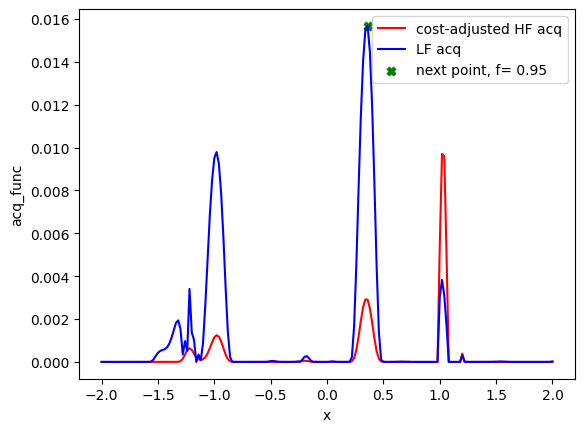

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118]
[0.36 0.95] 0.3599999999999999
Evaluation 27 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:09<00:00, 55.14it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 22.93it/s]


Completed. Saving
Time (s) to complete simulation 18: 30.88848304748535


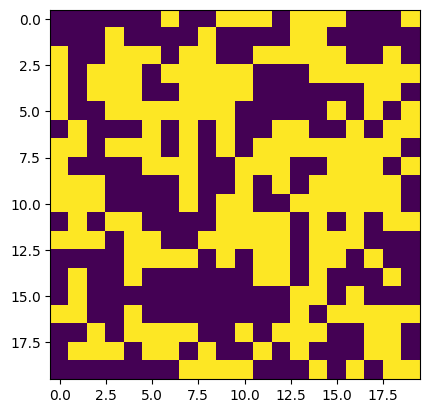

Step:18


sample: 100%|██████████| 4000/4000 [03:39<00:00, 18.20it/s, 1023 steps of size 1.11e-03. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.21      0.99      3.21      1.51      4.86     26.20      1.00
    alpha2      4.18      1.07      4.10      2.43      5.72     24.74      1.00
     delta      0.91      0.38      0.84      0.30      1.45     39.06      1.01
  k_length      0.04      0.00      0.04      0.03      0.05     10.52      1.09
   k_scale      0.20      0.10      0.17      0.08      0.34     16.92      1.10
     noise      0.01      0.01      0.01      0.00      0.02     56.69      1.00
         t      0.76      0.01      0.76      0.75      0.77    103.21      1.01



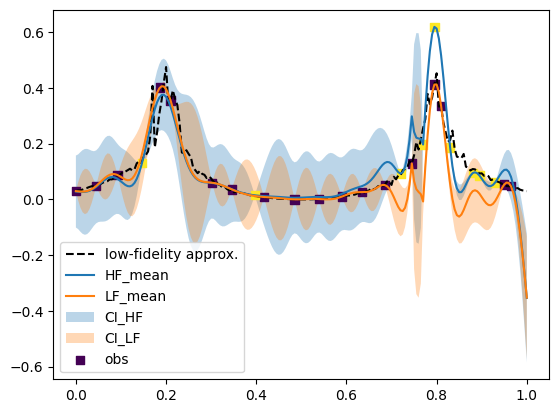

(402,)


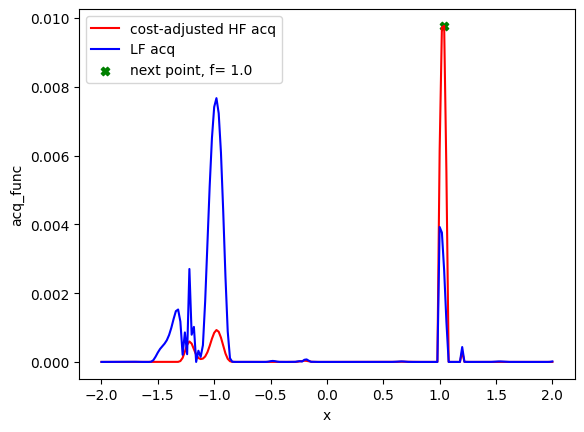

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353]
[1.04 1.  ] 1.04
Evaluation 28 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:17<00:00,  6.44it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [03:00<00:00,  2.78it/s]


Completed. Saving
Time (s) to complete simulation 19: 257.76778769493103


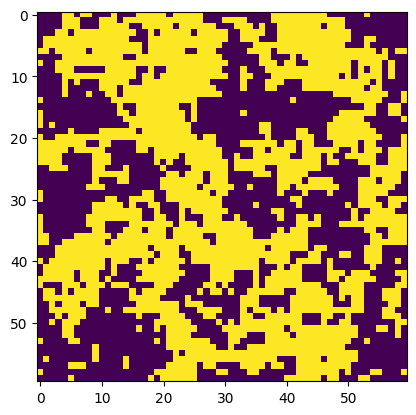

Step:19


sample: 100%|██████████| 4000/4000 [03:46<00:00, 17.65it/s, 1023 steps of size 2.66e-05. acc. prob=0.98]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      7.24      0.38      7.19      6.37      7.68      9.37      1.23
    alpha2      7.01      0.63      7.08      6.00      7.90      3.82      1.33
     delta      1.04      0.07      1.06      0.93      1.16      6.26      1.00
  k_length      0.03      0.00      0.03      0.03      0.03      5.77      1.14
   k_scale      0.15      0.01      0.15      0.14      0.16      6.25      1.32
     noise      0.01      0.00      0.01      0.00      0.01      8.65      1.41
         t      0.80      0.00      0.80      0.80      0.81      8.86      1.34



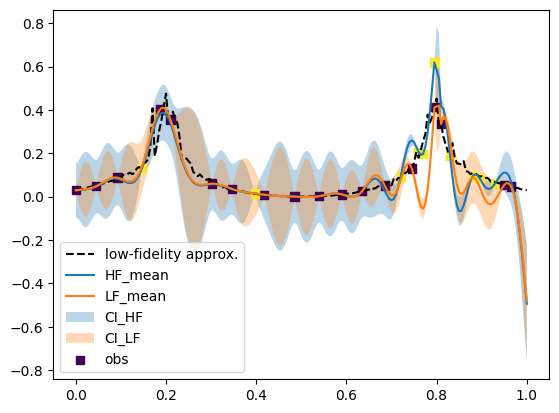

(402,)


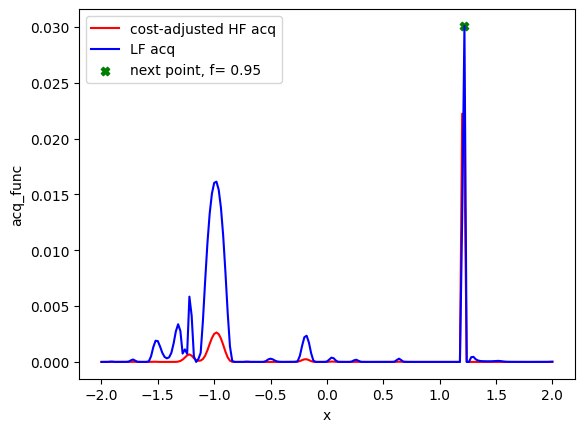

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161]
[1.22 0.95] 1.2200000000000002
Evaluation 29 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.60it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.77it/s]


Completed. Saving
Time (s) to complete simulation 20: 29.58253240585327


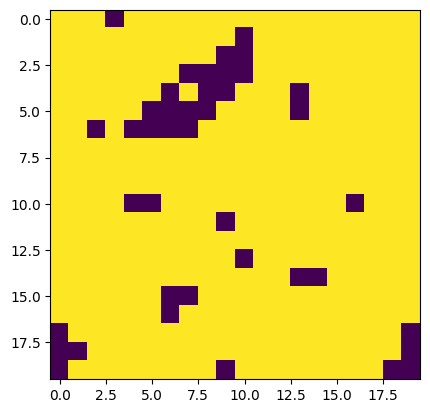

Step:20


sample: 100%|██████████| 4000/4000 [04:07<00:00, 16.13it/s, 1023 steps of size 1.19e-03. acc. prob=0.80]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.37      1.29      5.36      2.86      7.29     78.40      1.00
    alpha2      1.81      1.26      1.52      0.01      3.56    192.92      1.00
     delta      1.55      0.56      1.50      0.55      2.34    175.46      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    119.50      1.02
   k_scale      0.09      0.04      0.09      0.05      0.14     63.69      1.00
     noise      0.01      0.01      0.01      0.00      0.02    129.43      1.00
         t      0.98      0.02      0.98      0.97      1.00     62.42      1.00



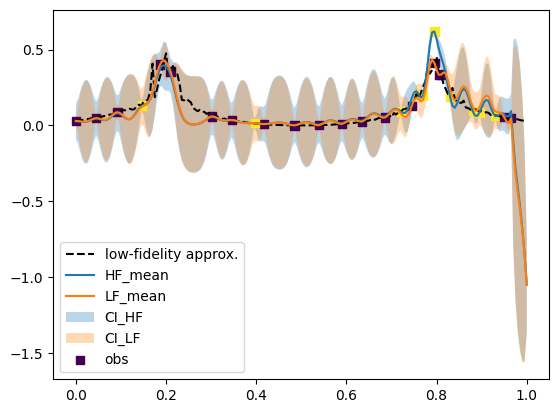

(402,)


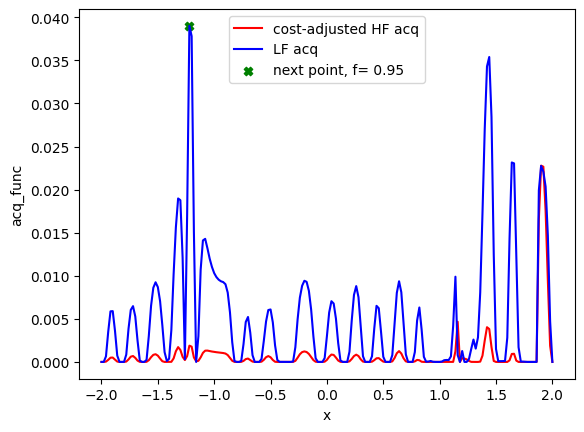

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39]
[-1.22  0.95] -1.22
Evaluation 30 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 57.28it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.86it/s]


Completed. Saving
Time (s) to complete simulation 21: 29.705466270446777


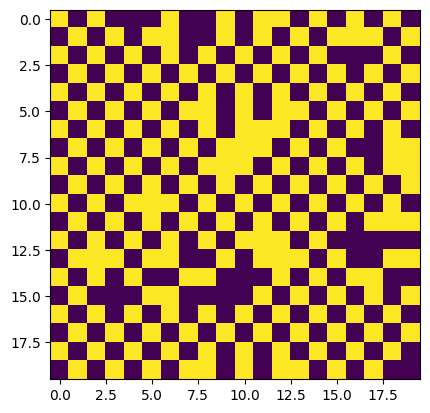

Step:21


sample: 100%|██████████| 4000/4000 [04:24<00:00, 15.10it/s, 1023 steps of size 1.32e-06. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.04      0.00      3.04      3.03      3.05      8.04      1.06
    alpha2      7.92      0.07      7.95      7.82      8.00      2.73      2.52
     delta      2.40      0.01      2.40      2.39      2.41      6.90      1.05
  k_length      0.02      0.00      0.02      0.02      0.02      4.39      1.54
   k_scale      0.11      0.00      0.11      0.11      0.11      5.98      1.29
     noise      0.01      0.00      0.01      0.01      0.01      6.34      1.48
         t      0.83      0.00      0.83      0.83      0.83      5.24      1.00



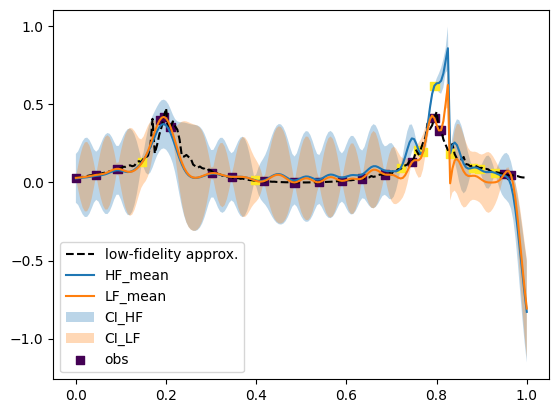

(402,)


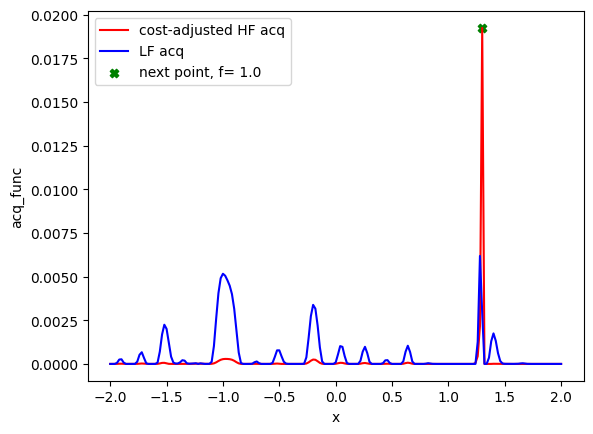

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39 366]
[1.3 1. ] 1.3000000000000003
Evaluation 31 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:14<00:00,  6.72it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:59<00:00,  2.79it/s]


Completed. Saving
Time (s) to complete simulation 22: 253.93506288528442


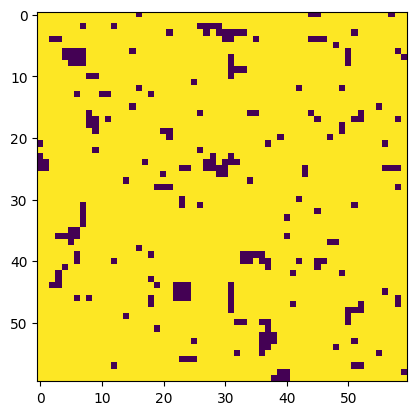

Step:22


sample: 100%|██████████| 4000/4000 [04:43<00:00, 14.09it/s, 1023 steps of size 8.52e-04. acc. prob=0.85]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.33      1.31      5.31      3.26      7.69     65.88      1.02
    alpha2      1.81      1.17      1.60      0.04      3.42    134.35      1.02
     delta      1.75      0.52      1.72      0.97      2.60     56.29      1.01
  k_length      0.02      0.00      0.02      0.01      0.02     25.04      1.05
   k_scale      0.09      0.03      0.08      0.05      0.14     23.75      1.03
     noise      0.01      0.01      0.01      0.00      0.02     97.57      1.01
         t      0.98      0.02      0.98      0.97      1.00     39.18      1.04



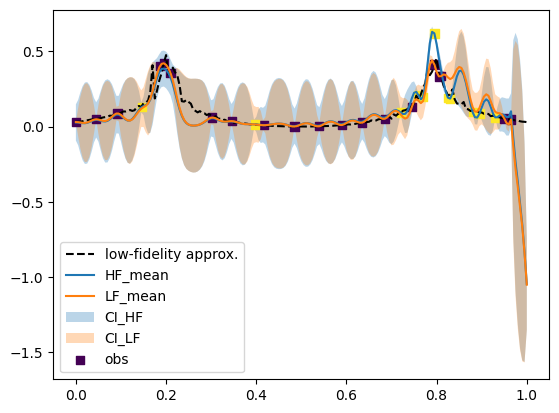

(402,)


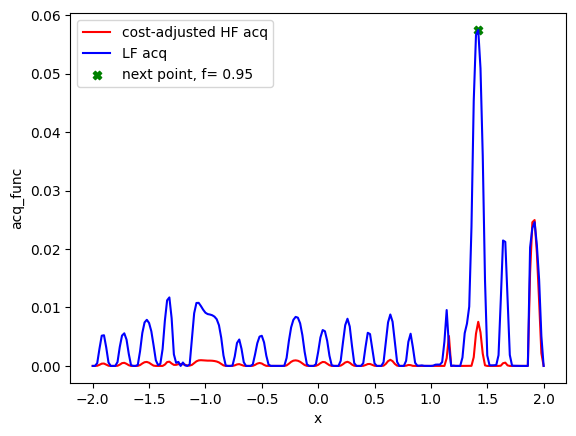

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39 366 171]
[1.42 0.95] 1.42
Evaluation 32 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 58.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.91it/s]


Completed. Saving
Time (s) to complete simulation 23: 29.480811834335327


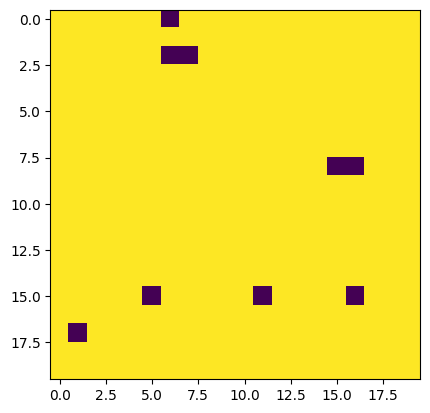

Step:23


sample: 100%|██████████| 4000/4000 [10:08<00:00,  6.58it/s, 1023 steps of size 5.47e-03. acc. prob=0.67]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.61      1.26      5.55      3.57      7.63    509.32      1.00
    alpha2      1.70      1.25      1.46      0.01      3.40    842.78      1.00
     delta      1.73      0.62      1.67      0.70      2.68    417.03      1.00
  k_length      0.01      0.00      0.01      0.01      0.02    535.25      1.00
   k_scale      0.09      0.03      0.08      0.04      0.13    585.26      1.00
     noise      0.01      0.01      0.01      0.00      0.02    443.36      1.00
         t      0.98      0.01      0.98      0.97      1.00    306.71      1.00



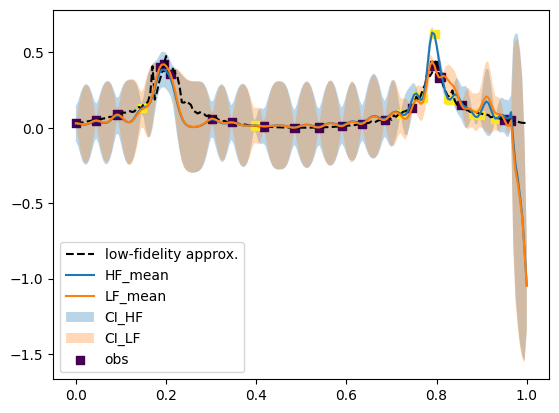

(402,)


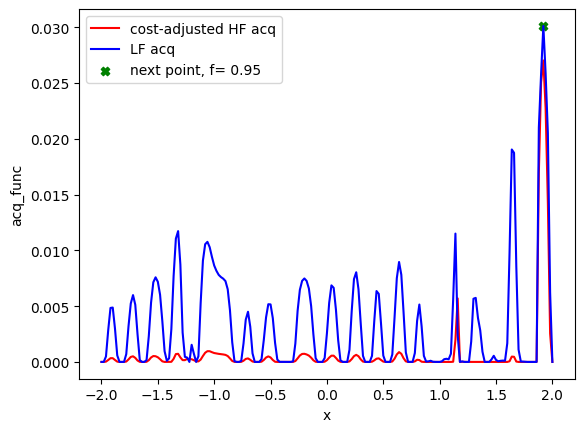

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39 366 171 196]
[1.92 0.95] 1.92
Evaluation 33 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.80it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 23.27it/s]


Completed. Saving
Time (s) to complete simulation 24: 29.86646580696106


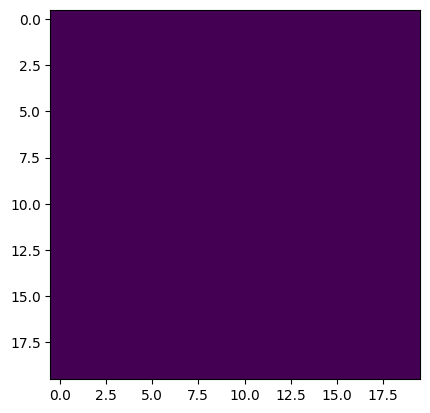

Step:24


sample: 100%|██████████| 4000/4000 [12:39<00:00,  5.26it/s, 1023 steps of size 2.79e-03. acc. prob=0.68]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.24      1.24      5.20      3.25      7.28    401.62      1.00
    alpha2      1.67      1.24      1.41      0.02      3.38    369.99      1.00
     delta      1.69      0.59      1.62      0.75      2.63    424.69      1.00
  k_length      0.02      0.00      0.02      0.01      0.02    421.70      1.00
   k_scale      0.10      0.04      0.10      0.05      0.16    264.54      1.00
     noise      0.01      0.01      0.01      0.00      0.02    526.60      1.01
         t      0.99      0.02      0.99      0.98      1.00     57.16      1.00



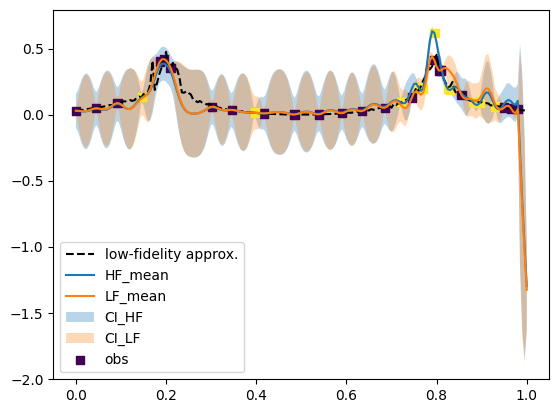

(402,)


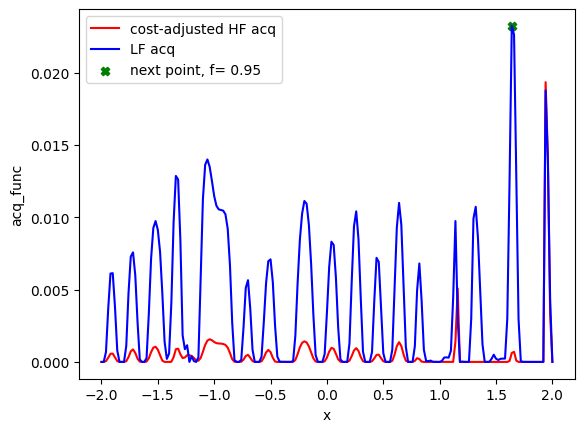

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39 366 171 196 182]
[1.64 0.95] 1.6400000000000001
Evaluation 34 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 59.91it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:20<00:00, 23.99it/s]


Completed. Saving
Time (s) to complete simulation 25: 29.207013845443726


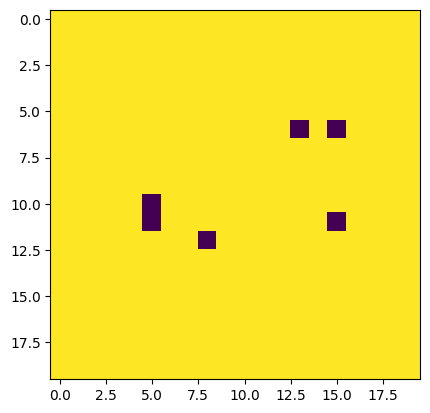

Step:25


sample: 100%|██████████| 4000/4000 [14:18<00:00,  4.66it/s, 1023 steps of size 1.52e-05. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      8.34      0.18      8.32      8.05      8.64      8.69      1.26
    alpha2      7.52      0.23      7.62      7.20      7.80      2.77      2.44
     delta      1.21      0.04      1.22      1.15      1.26      7.15      1.03
  k_length      0.02      0.00      0.02      0.01      0.02      3.71      1.69
   k_scale      0.09      0.00      0.09      0.09      0.10      5.90      1.31
     noise      0.02      0.00      0.02      0.02      0.02      6.94      1.31
         t      0.82      0.00      0.82      0.82      0.82      5.25      1.00



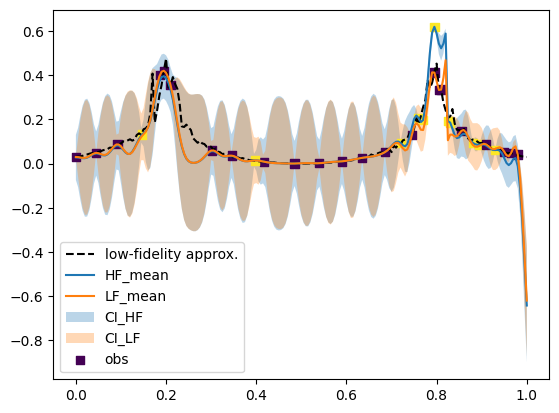

(402,)


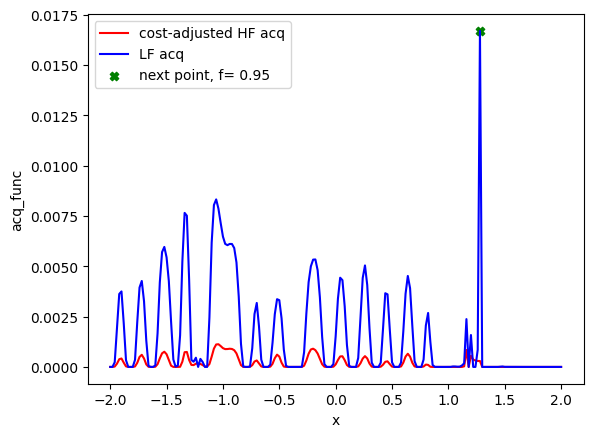

[367 380 127 387  42 162 360 355 159 190 137 193  97 149 377   9 118 353
 161  39 366 171 196 182 164]
[1.28 0.95] 1.2800000000000002
Evaluation 35 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:08<00:00, 55.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:21<00:00, 22.88it/s]


Completed. Saving
Time (s) to complete simulation 26: 30.861594438552856


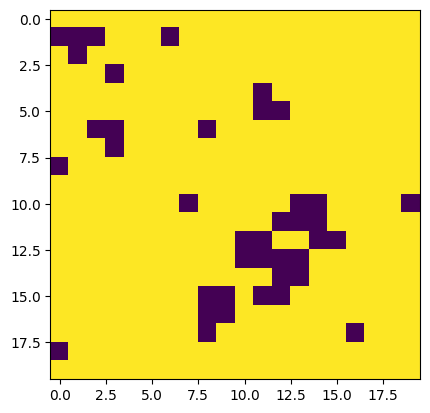

In [ ]:
N = 25
cost_ratio = 8.6/3 #time complexities
f = np.array([1.0, 2.0])
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_hf, X_test_lf))
X_test_full = np.vstack((X_test_hf, X_test_lf))
X_test_norm = np.vstack((X_test_hf, X_test_lf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior2, mean_fn=mean_func, mean_fn_prior=mf_priors,
                            noise_prior = lambda: numpyro.sample("noise", numpyro.distributions.HalfNormal(0.01)))
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs_norm, approx_ys_sq, "k--", label="low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs_norm, y_pred, label="HF_mean")
        plt.plot(xs_norm, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs_norm.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs_norm.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full_norm[:, 0], train_y, c=train_x_full_norm[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])
        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

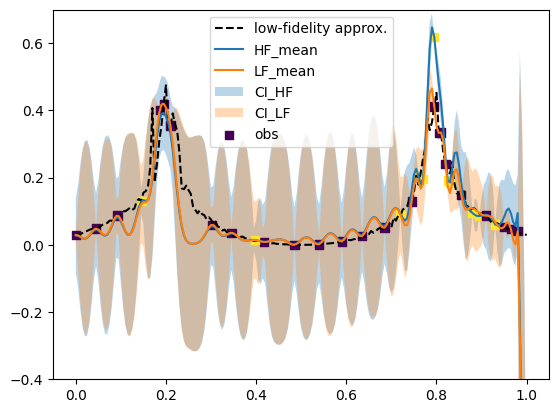

In [ ]:
if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
    y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
    y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
    plt.plot(xs_norm, approx_ys_sq, "k--", label="low-fidelity approx.")
    pred_lower = y_pred - y_sampled.std(axis=(0,1))
    pred_upper = y_pred + y_sampled.std(axis=(0,1))
    pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
    pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
    plt.plot(xs_norm, y_pred, label="HF_mean")
    plt.plot(xs_norm, y_pred_lf, label="LF_mean")
    plt.fill_between(
        xs_norm.flatten(),
        pred_lower,
        pred_upper,
        alpha=0.3,
        label="CI_HF",
    )

    plt.fill_between(
        xs_norm.flatten(),
        pred_lower_lf,
        pred_upper_lf,
        alpha=0.3,
        label="CI_LF",
    )

    plt.scatter(train_x_full_norm[:, 0], train_y, c=train_x_full_norm[:, 1], cmap="viridis", marker="s", label="obs")
    plt.ylim(-0.4, 0.7)
    plt.legend(loc="best")
    plt.show()

In [ ]:
train_x_full

array([[-0.33191198,  0.95      ],
       [ 0.88129797,  1.        ],
       [-1.9995425 ,  0.95      ],
       [-0.79066971,  0.95      ],
       [-1.41297644,  1.        ],
       [-1.63064562,  0.95      ],
       [-1.25495915,  0.95      ],
       [-0.61775709,  0.95      ],
       [-0.4129301 ,  1.        ],
       [ 0.15526694,  0.95      ],
       [ 1.32      ,  1.        ],
       [ 1.58      ,  1.        ],
       [ 0.54      ,  0.95      ],
       [ 1.72      ,  1.        ],
       [-1.16      ,  0.95      ],
       [ 1.24      ,  0.95      ],
       [ 1.18      ,  1.        ],
       [ 1.08      ,  1.        ],
       [ 1.18      ,  0.95      ],
       [ 1.8       ,  0.95      ],
       [ 0.74      ,  0.95      ],
       [ 1.86      ,  0.95      ],
       [-0.06      ,  0.95      ],
       [ 0.98      ,  0.95      ],
       [ 1.52      ,  1.        ],
       [-1.82      ,  0.95      ],
       [ 0.36      ,  0.95      ],
       [ 1.04      ,  1.        ],
       [ 1.22      ,

# MFBO with structured GP
- Wrong low-fid model

In [ ]:
n = 10

np.random.seed(1)
train_x = bounds[0] + (bounds[1] - bounds[0]) * np.random.rand(n, 1)
train_x_norm = (train_x-bounds[0])/(bounds[1]-bounds[0])
train_f = fidelities[np.random.randint(0, 2, (n, 1))]  # mixed fidelity
#train_f = torch.ones_like(train_x) * fidelities[0]  # only the low fidelity
train_x_full = np.concatenate((train_x, train_f), axis=1)
train_x_full_norm = np.concatenate((train_x_norm, train_f), axis=1)
train_x_full, train_x_full_norm

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]))

<ipython-input-8-ce1dd9d4cae2>:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,0,0,0,0],
<ipython-input-8-ce1dd9d4cae2>:18: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  J_mat = np.array([[0,Jx[i],0,Jx[i],0],


Evaluation 1 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:28<00:00,  5.66it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:41<00:00,  4.95it/s]


Completed. Saving
Time (s) to complete simulation 1: 189.5023593902588


<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


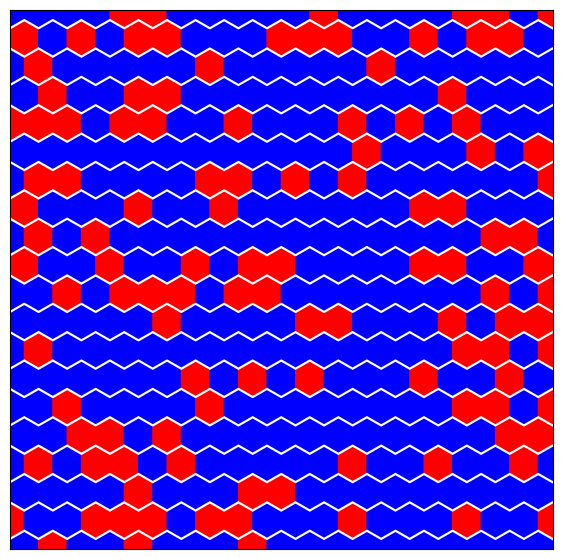

Evaluation 2 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:20<00:00,  2.49it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:56<00:00,  1.19s/it]


Completed. Saving
Time (s) to complete simulation 2: 797.1746935844421


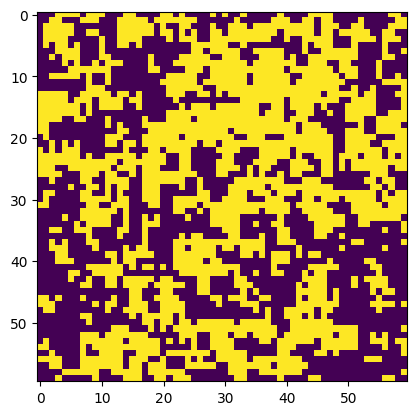

Evaluation 3 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:22<00:00,  6.07it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:39<00:00,  5.03it/s]


Completed. Saving
Time (s) to complete simulation 3: 181.75542497634888


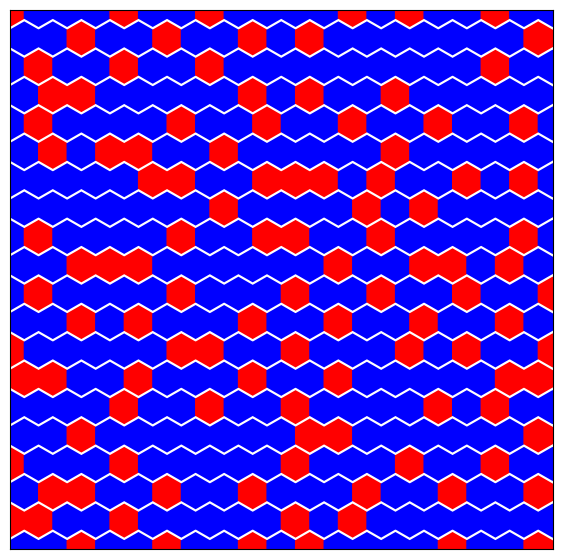

Evaluation 4 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:20<00:00,  6.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:37<00:00,  5.14it/s]


Completed. Saving
Time (s) to complete simulation 4: 178.01333570480347


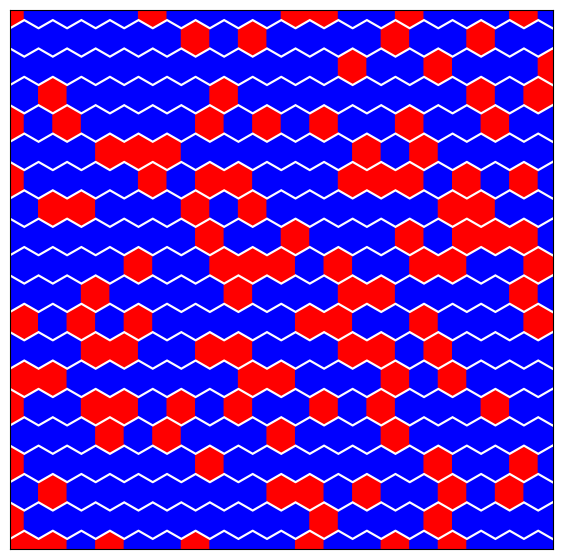

Evaluation 5 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:09<00:00,  2.63it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:31<00:00,  1.14s/it]


Completed. Saving
Time (s) to complete simulation 5: 761.4585726261139


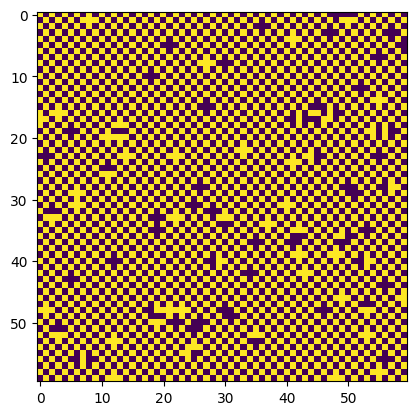

Evaluation 6 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:20<00:00,  6.21it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:37<00:00,  5.12it/s]


Completed. Saving
Time (s) to complete simulation 6: 178.13710713386536


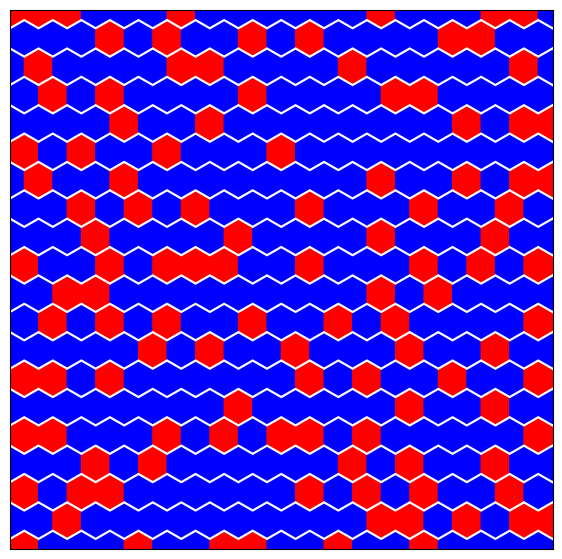

Evaluation 7 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:19<00:00,  6.27it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:37<00:00,  5.15it/s]


Completed. Saving
Time (s) to complete simulation 7: 176.89577984809875


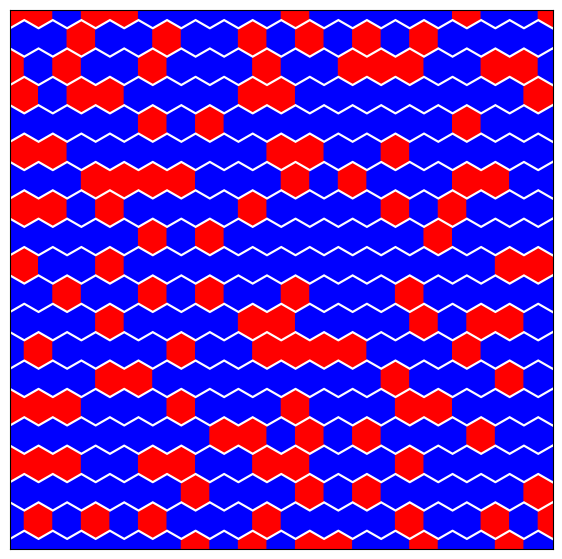

Evaluation 8 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:20<00:00,  6.18it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:38<00:00,  5.10it/s]


Completed. Saving
Time (s) to complete simulation 8: 179.07836484909058


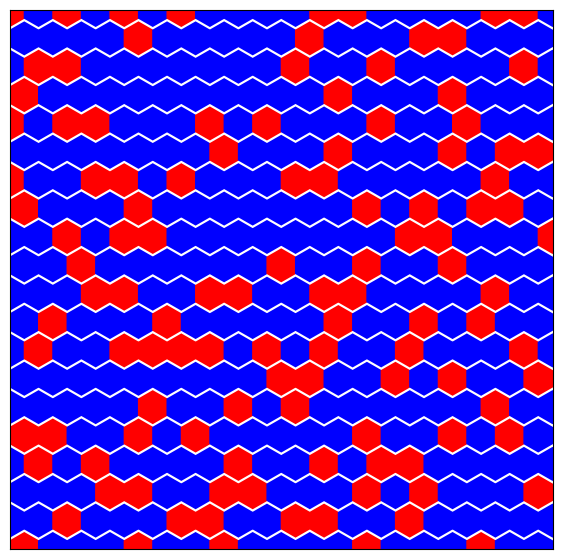

Evaluation 9 of 10
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [03:11<00:00,  2.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [09:31<00:00,  1.14s/it]

Completed. Saving
Time (s) to complete simulation 9: 763.4814057350159


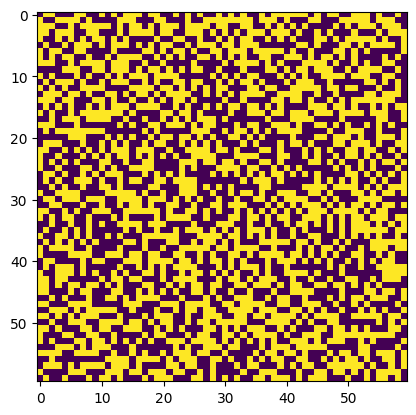

Evaluation 10 of 10
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [01:21<00:00,  6.10it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [01:40<00:00,  5.00it/s]

Completed. Saving
Time (s) to complete simulation 10: 182.01996994018555


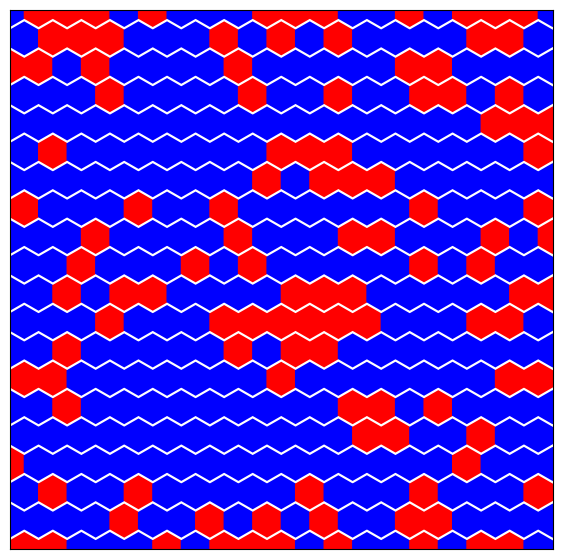

In [ ]:
train_y = np.zeros(train_x.shape)
Jx=train_x
resultsBO_dict = {}
for i in range(0, train_x.shape[0]):
    J_mat = np.array([[0,0,0,0,0],
                      [0,0,Jx[i],0,0],
                      [0,Jx[i],0,Jx[i],0],
                      [0,0,Jx[i],0,0],
                      [0,0,0,0,0]])
    print("Evaluation " +str (i+1) +" of " +str(n))
    start_time = time.time()
    np.random.seed(0)
    if train_x_full[i,1] == 1: #High fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
    else: #Low fidelity
        print("Evaluation for fidelity: "+str(train_x_full[i,1]))
        J_mat = np.array([[0,Jx[i],0,Jx[i],0],
                  [Jx[i],0,0,0,Jx[i]],
                  [0,Jx[i],0,Jx[i],0]])
        tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
        sq_sim = tri_sim

    sq_sim.performIsingSim()   # Running the sim
    end_time = time.time()
    #time_eval[i]= end_time-start_time
    print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
    resultsBO_dict[i] = {'sim': sq_sim.results,}
    train_y[i] = resultsBO_dict[i]['sim']['SpecificHeat']
    if train_x_full[i,1] == 1: #High fidelity
        plt.imshow(resultsBO_dict[i]['sim']['config'][-1])

    else: #Low fidelity
        sq_sim.plot_config(resultsBO_dict[i]['sim']['config'][-1])



    plt.show()

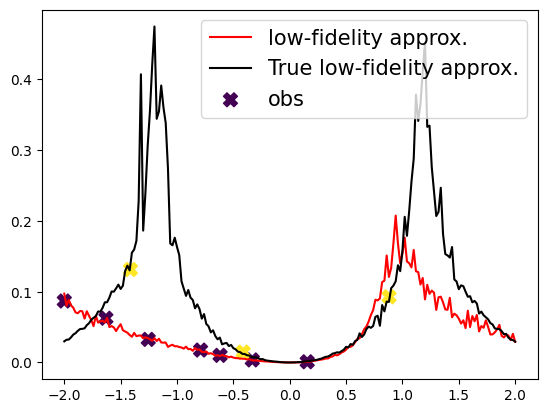

In [ ]:
plt.plot(xs, approx_ys_tri, "r", label="low-fidelity approx.")

plt.plot(xs, approx_ys_sq, "k", label="True low-fidelity approx.")

plt.scatter(train_x, train_y, c=train_x_full[:, 1], cmap="viridis", marker="X", label="obs", s=100)

plt.legend(fontsize=15);

# Run BO 25 iterations

In [ ]:
train_x_full = train_x_full[0:n]
train_x_full_norm = train_x_full_norm[0:n]
train_y = train_y[0:n]
train_x_full, train_x_full_norm, train_y

(array([[-0.33191198,  0.95      ],
        [ 0.88129797,  1.        ],
        [-1.9995425 ,  0.95      ],
        [-0.79066971,  0.95      ],
        [-1.41297644,  1.        ],
        [-1.63064562,  0.95      ],
        [-1.25495915,  0.95      ],
        [-0.61775709,  0.95      ],
        [-0.4129301 ,  1.        ],
        [ 0.15526694,  0.95      ]]),
 array([[4.17022005e-01, 9.50000000e-01],
        [7.20324493e-01, 1.00000000e+00],
        [1.14374817e-04, 9.50000000e-01],
        [3.02332573e-01, 9.50000000e-01],
        [1.46755891e-01, 1.00000000e+00],
        [9.23385948e-02, 9.50000000e-01],
        [1.86260211e-01, 9.50000000e-01],
        [3.45560727e-01, 9.50000000e-01],
        [3.96767474e-01, 1.00000000e+00],
        [5.38816734e-01, 9.50000000e-01]]),
 array([[0.00362316],
        [0.09279848],
        [0.0868945 ],
        [0.01756174],
        [0.13141094],
        [0.06255309],
        [0.03263018],
        [0.01008332],
        [0.01471007],
        [0.0009922

# GP mean function
- Prioir information about peaks and power function

In [ ]:
@jit
def mean_func(x: jnp.ndarray, params: Dict[str, float]) -> jnp.ndarray:

    x_data = x[:,0]
    #jax.debug.print("x_norm: {}", x_data)
    #lb = -2
    #ub = 2
    #x_data = x_data*(ub-lb) + lb
    #jax.debug.print("x: {}", x_data)

    return jnp.piecewise(
        x_data, [x_data < params["t"], x_data >= params["t"]],
        [lambda x_data: x_data**params["alpha1"], lambda x_data: -x_data**params["alpha2"]])


def mf_priors():
    # Sample model parameters
    t = numpyro.sample("t", numpyro.distributions.Uniform(0.5, 1))
    alpha1 = numpyro.sample("alpha1", numpyro.distributions.HalfNormal(2))
    alpha2 = numpyro.sample("alpha2", numpyro.distributions.HalfNormal(2))
    # Return sampled parameters as a dictionary
    return {"t": t, "alpha1": alpha1, "alpha2": alpha2}

Step:1


sample: 100%|██████████| 4000/4000 [00:15<00:00, 253.55it/s, 31 steps of size 1.18e-01. acc. prob=0.79] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.69      1.47      2.67      0.71      4.73     88.66      1.00
    alpha2      1.54      1.20      1.28      0.00      3.36    688.42      1.00
     delta      0.85      0.55      0.76      0.03      1.64    463.12      1.00
  k_length      0.30      0.08      0.29      0.17      0.42     92.33      1.00
   k_scale      0.24      0.33      0.10      0.00      0.63    142.20      1.00
     noise      1.68      2.47      0.99      0.05      3.59    673.86      1.00
         t      0.86      0.08      0.86      0.75      0.99    457.92      1.00



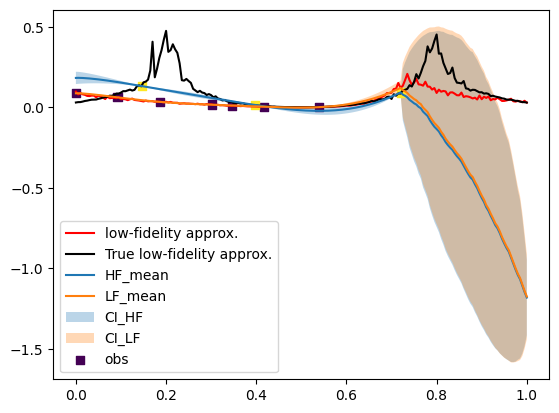

(402,)


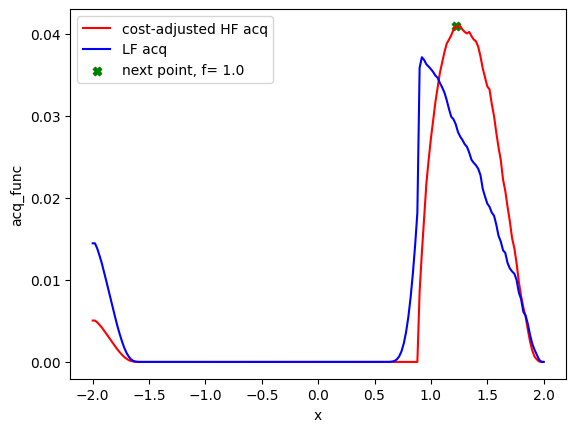

362
[1.22 1.  ] 1.2200000000000002
Evaluation 11 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:13<00:00,  6.82it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:58<00:00,  2.80it/s]


Completed. Saving
Time (s) to complete simulation 2: 251.82546639442444


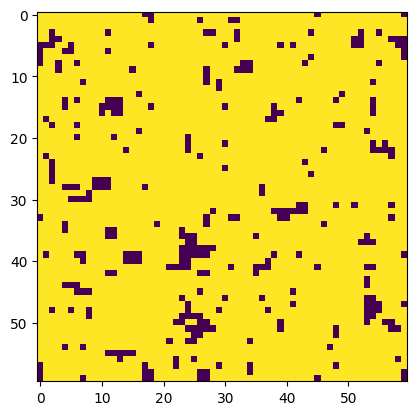

Step:2


sample: 100%|██████████| 4000/4000 [00:25<00:00, 158.63it/s, 31 steps of size 1.59e-02. acc. prob=0.77] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.68      1.22      2.61      0.73      4.42    423.22      1.00
    alpha2      1.63      1.21      1.38      0.00      3.40    654.09      1.00
     delta      0.87      0.57      0.75      0.09      1.73    503.58      1.00
  k_length      0.25      0.07      0.24      0.15      0.36    266.80      1.02
   k_scale      0.33      0.36      0.20      0.01      0.79    398.13      1.01
     noise      1.59      1.85      0.96      0.06      3.62    631.00      1.00
         t      0.90      0.06      0.90      0.82      1.00    412.72      1.00



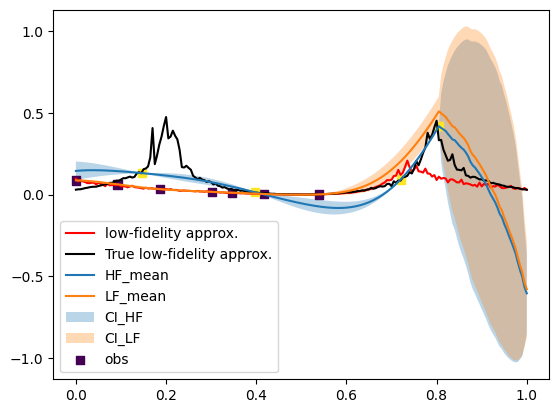

(402,)


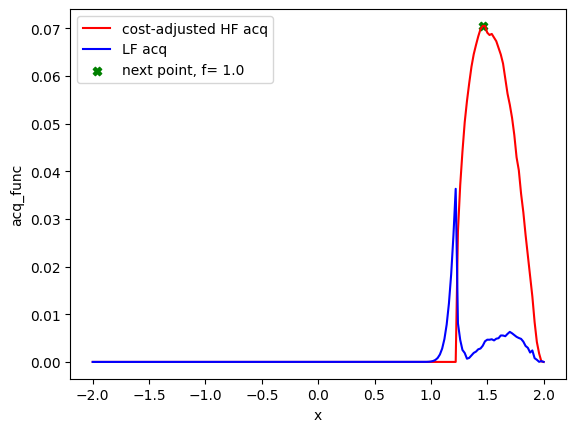

[362 374]
[1.46 1.  ] 1.46
Evaluation 12 of 35
Evaluation for fidelity: 1.0

---Performing Equlibration---



100%|██████████| 500/500 [01:13<00:00,  6.84it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [02:59<00:00,  2.79it/s]

Completed. Saving
Time (s) to complete simulation 3: 252.55117201805115


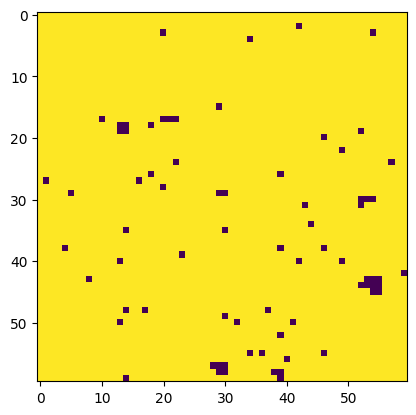

Step:3


sample: 100%|██████████| 4000/4000 [00:52<00:00, 75.84it/s, 1023 steps of size 2.58e-05. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.25      0.29      3.21      2.77      3.72      8.85      1.26
    alpha2      2.51      0.33      2.59      2.06      2.97      3.16      1.99
     delta      0.38      0.05      0.39      0.30      0.45      7.71      1.00
  k_length      0.15      0.01      0.15      0.14      0.16      6.77      1.08
   k_scale      0.21      0.03      0.21      0.18      0.26      7.38      1.00
     noise      3.65      0.33      3.63      3.06      4.21     18.57      1.00
         t      0.67      0.02      0.67      0.65      0.71      5.30      1.00



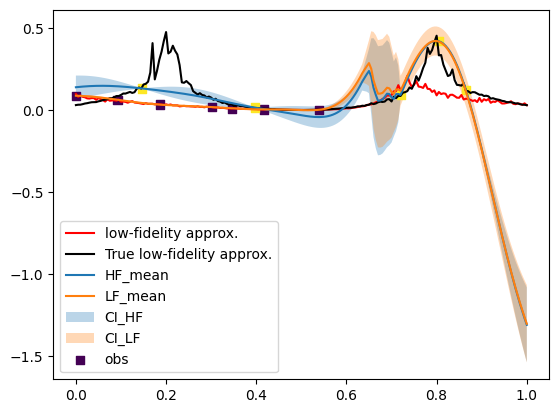

(402,)


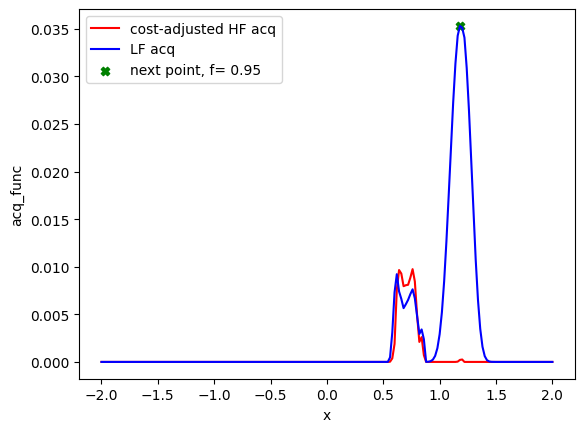

[362 374 159]
[1.18 0.95] 1.1800000000000002
Evaluation 13 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.12it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:34<00:00, 14.40it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 4: 65.75384831428528


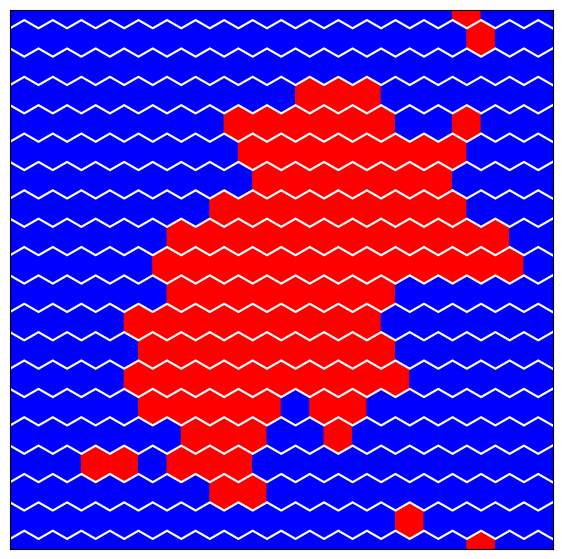

Step:4


sample: 100%|██████████| 4000/4000 [01:05<00:00, 60.93it/s, 1023 steps of size 2.84e-04. acc. prob=0.97]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      1.72      0.92      1.60      0.28      2.98     29.62      1.00
    alpha2      2.00      0.95      1.93      0.36      3.22     26.42      1.00
     delta      0.89      0.39      0.81      0.28      1.48     20.58      1.01
  k_length      0.16      0.02      0.16      0.13      0.18      9.21      1.11
   k_scale      0.59      0.37      0.48      0.14      1.09     15.13      1.10
     noise      1.57      1.45      1.20      0.11      3.02     54.11      1.02
         t      0.63      0.05      0.62      0.54      0.70      9.89      1.31



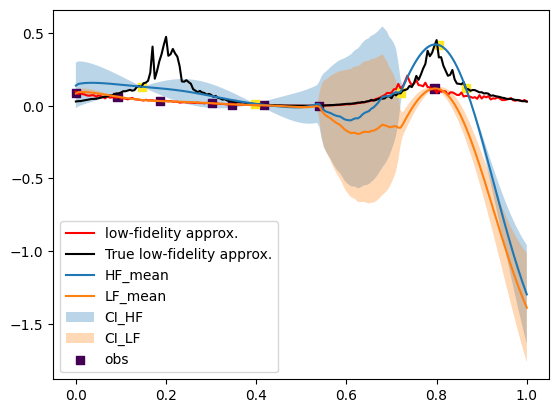

(402,)


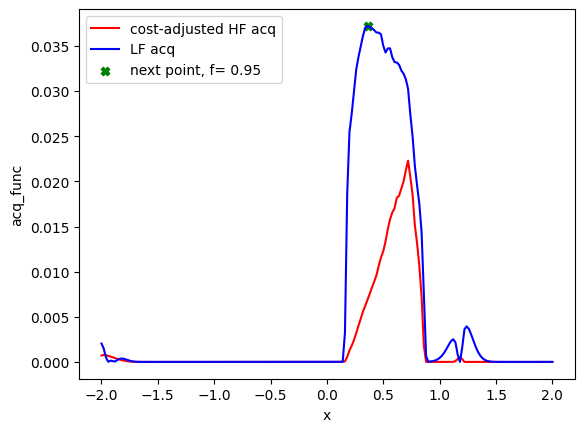

[362 374 159 118]
[0.36 0.95] 0.3599999999999999
Evaluation 14 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.23it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.93it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 5: 66.72789931297302


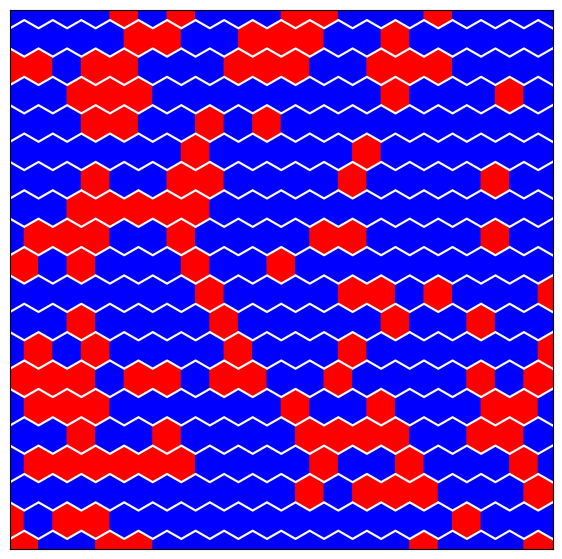

Step:5


sample: 100%|██████████| 4000/4000 [01:17<00:00, 51.55it/s, 1023 steps of size 2.99e-05. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.37      0.17      2.38      2.06      2.59      9.05      1.00
    alpha2      4.41      0.41      4.44      3.86      5.04      3.47      1.67
     delta      1.10      0.10      1.12      0.90      1.22      6.70      1.11
  k_length      0.16      0.00      0.16      0.15      0.17      7.86      1.00
   k_scale      0.37      0.05      0.36      0.31      0.47      7.27      1.01
     noise      1.54      0.18      1.53      1.27      1.89     10.94      1.25
         t      0.66      0.03      0.65      0.63      0.71      5.32      1.00



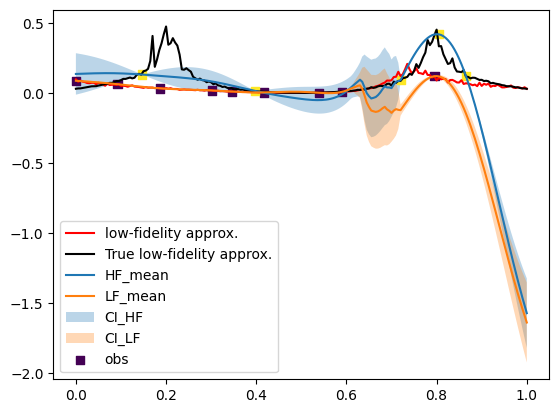

(402,)


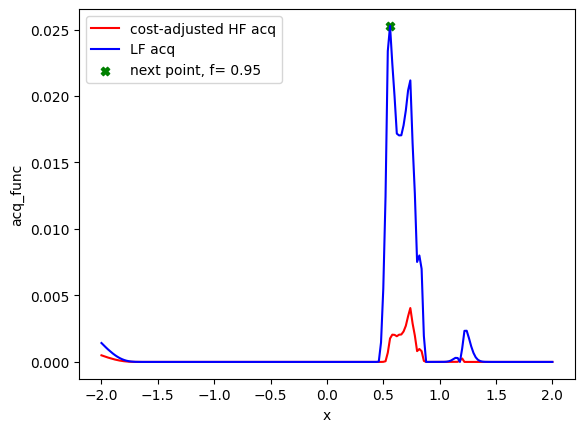

[362 374 159 118 128]
[0.56 0.95] 0.56
Evaluation 15 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.62it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.76it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 6: 68.38347387313843


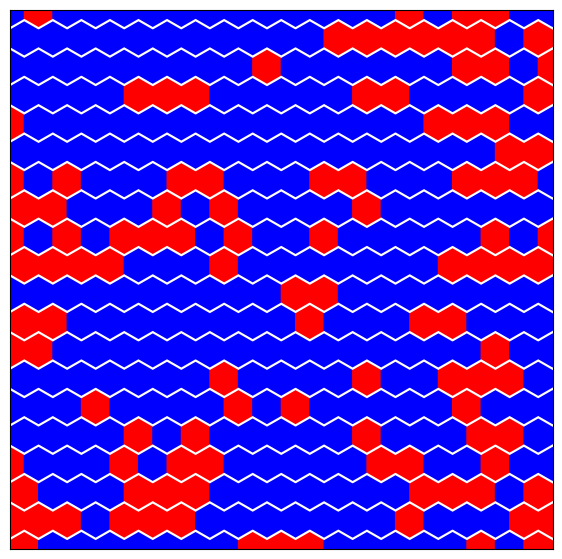

Step:6


sample: 100%|██████████| 4000/4000 [01:31<00:00, 43.63it/s, 1023 steps of size 1.65e-05. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      5.07      0.08      5.08      4.92      5.17      9.62      1.01
    alpha2      4.41      0.44      4.36      3.80      5.13      3.92      1.36
     delta      1.30      0.12      1.32      1.06      1.45      6.36      1.15
  k_length      0.12      0.01      0.12      0.11      0.13     16.14      1.01
   k_scale      0.22      0.02      0.21      0.20      0.24      5.85      1.27
     noise      0.87      0.06      0.86      0.78      0.98      6.72      1.47
         t      0.68      0.02      0.67      0.65      0.72      5.30      1.01



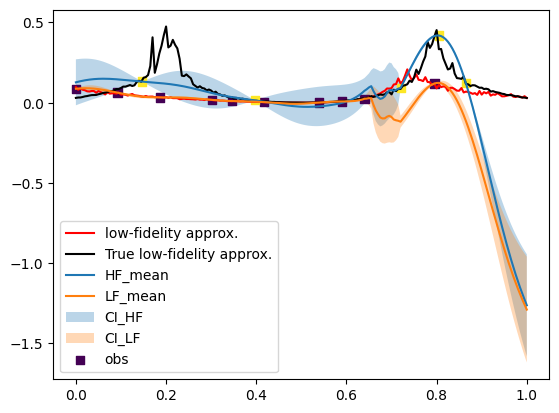

(402,)


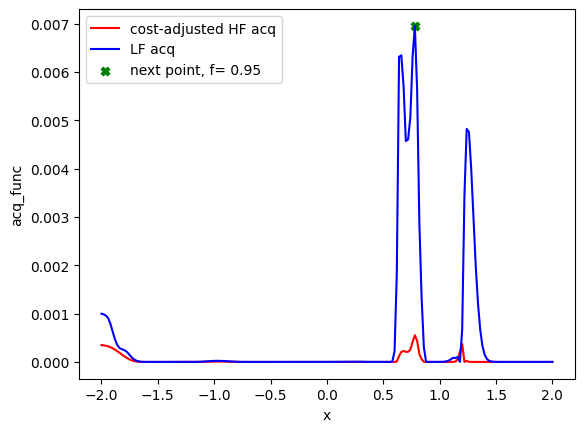

[362 374 159 118 128 139]
[0.78 0.95] 0.7800000000000002
Evaluation 16 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:30<00:00, 16.16it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.94it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 7: 66.8250584602356


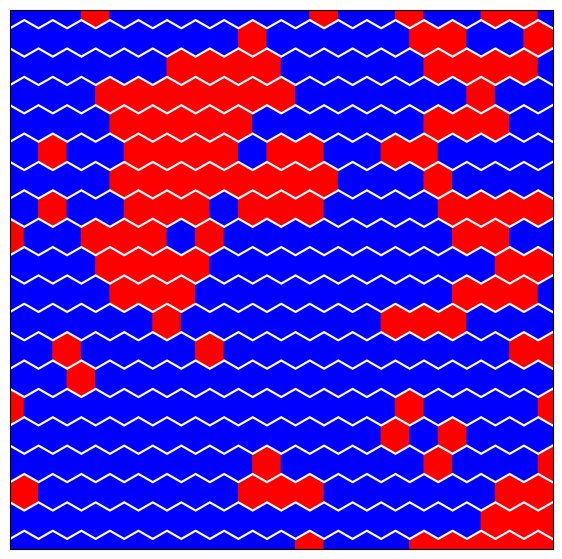

Step:7


sample: 100%|██████████| 4000/4000 [01:22<00:00, 48.76it/s, 1023 steps of size 2.41e-03. acc. prob=0.78]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.07      2.32      4.01      0.58      7.22      3.43      2.20
    alpha2      1.89      1.24      1.60      0.14      3.66     77.97      1.00
     delta      1.11      0.63      1.05      0.02      1.96     14.62      1.20
  k_length      0.07      0.06      0.10      0.00      0.15      2.81      3.13
   k_scale      0.40      0.47      0.25      0.00      1.07      4.78      1.75
     noise      1.58      1.90      0.96      0.04      3.63    482.64      1.00
         t      0.93      0.04      0.93      0.87      0.98    362.05      1.00



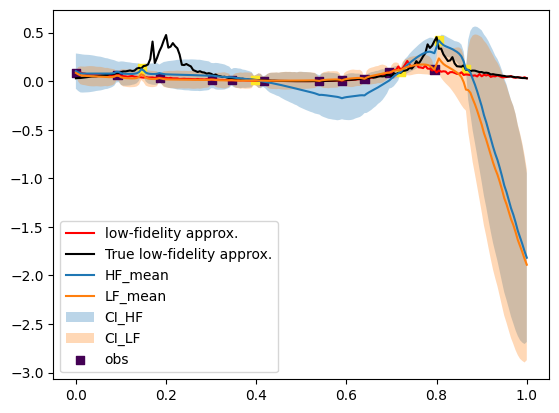

(402,)


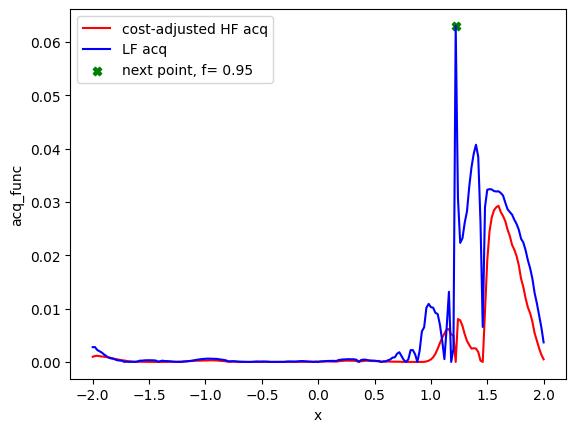

[362 374 159 118 128 139 161]
[1.22 0.95] 1.2200000000000002
Evaluation 17 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.61it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.30it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 8: 69.65640878677368


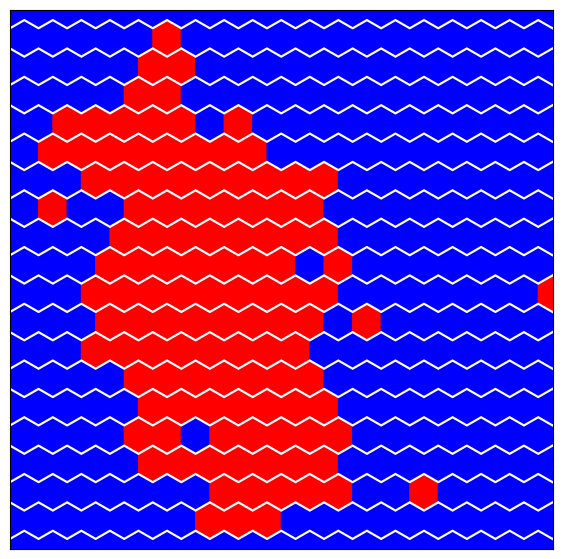

Step:8


sample: 100%|██████████| 4000/4000 [01:42<00:00, 39.12it/s, 1023 steps of size 4.14e-04. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.67      1.03      2.56      1.02      4.22     28.13      1.10
    alpha2      3.48      0.99      3.36      2.00      5.01     50.04      1.01
     delta      1.68      0.55      1.60      0.84      2.57     35.37      1.01
  k_length      0.10      0.02      0.10      0.08      0.13      6.77      1.18
   k_scale      0.32      0.30      0.22      0.06      0.67     15.57      1.17
     noise      1.79      2.37      1.12      0.06      3.41     68.87      1.00
         t      0.52      0.01      0.52      0.50      0.53     14.60      1.17



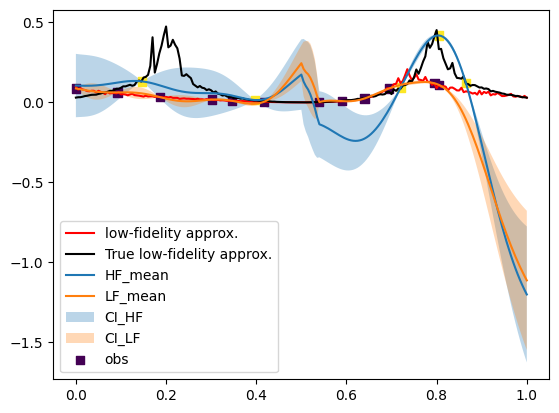

(402,)


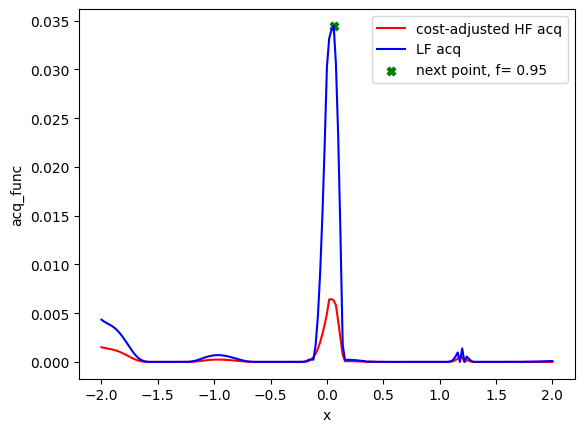

[362 374 159 118 128 139 161 103]
[0.06 0.95] 0.06000000000000005
Evaluation 18 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.02it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 13.91it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 9: 67.18008732795715


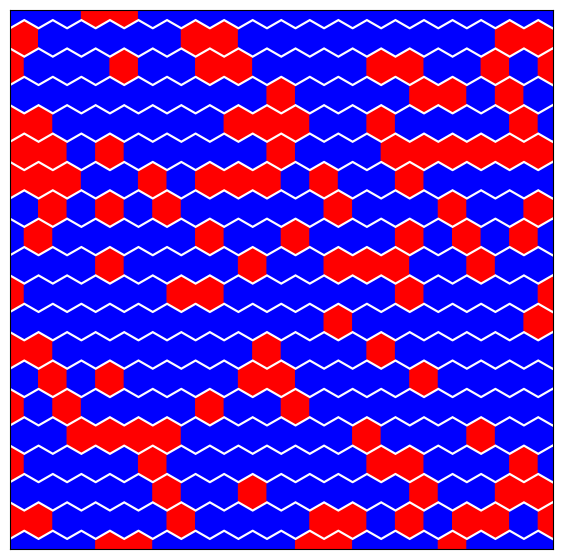

Step:9


sample: 100%|██████████| 4000/4000 [01:27<00:00, 45.71it/s, 1023 steps of size 1.90e-04. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.84      1.10      3.64      2.02      5.60     12.23      1.38
    alpha2      4.58      0.70      4.50      3.47      5.81     18.08      1.01
     delta      1.58      0.38      1.54      0.86      2.17     15.14      1.05
  k_length      0.08      0.01      0.08      0.07      0.10      7.80      1.17
   k_scale      0.20      0.13      0.15      0.06      0.40      4.98      1.63
     noise      1.58      0.94      1.43      0.34      2.82     34.92      1.00
         t      0.52      0.03      0.51      0.50      0.55     10.22      1.09



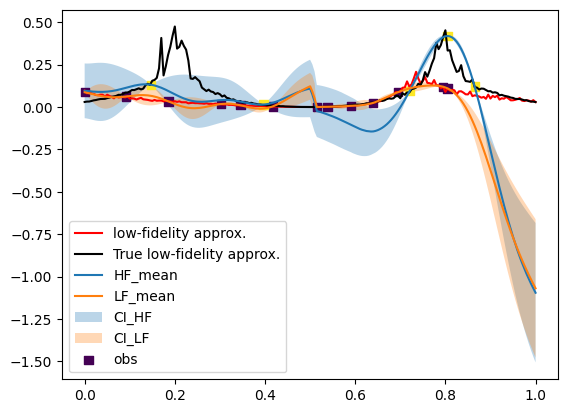

(402,)


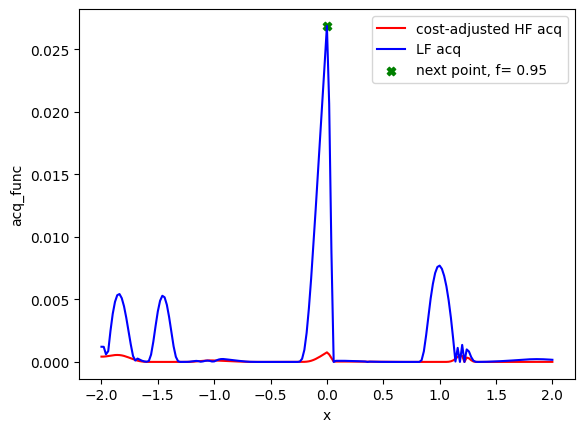

[362 374 159 118 128 139 161 103 100]
[0.   0.95] 0.0
Evaluation 19 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:34<00:00, 14.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.59it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 10: 71.29090189933777


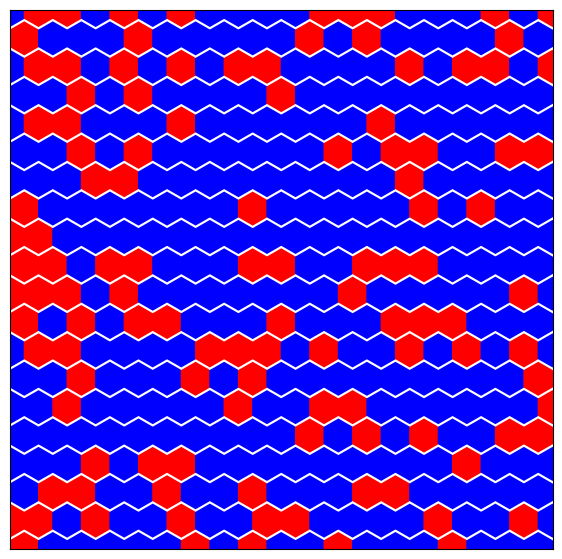

Step:10


sample: 100%|██████████| 4000/4000 [02:02<00:00, 32.65it/s, 1023 steps of size 9.61e-06. acc. prob=1.00]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      8.88      0.10      8.88      8.74      9.03     10.20      1.08
    alpha2      6.24      0.09      6.28      6.11      6.35      2.73      2.51
     delta      1.45      0.03      1.46      1.39      1.50      7.45      1.01
  k_length      0.09      0.00      0.09      0.08      0.09      3.90      1.64
   k_scale      0.07      0.00      0.07      0.07      0.08      6.09      1.28
     noise      5.90      0.19      5.89      5.60      6.23     11.44      1.23
         t      0.72      0.00      0.72      0.72      0.72      5.24      1.00



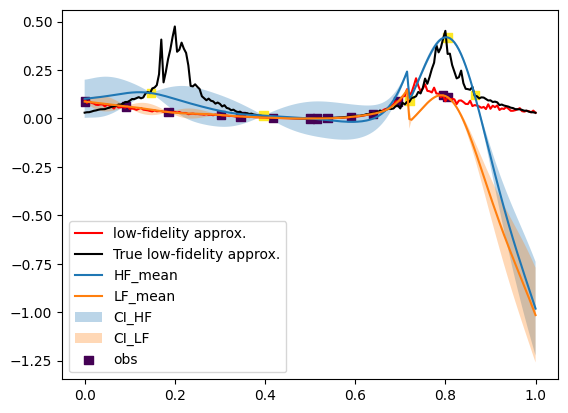

(402,)


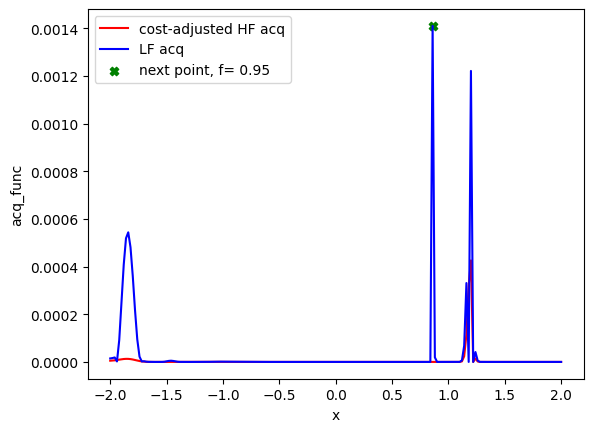

[362 374 159 118 128 139 161 103 100 143]
[0.86 0.95] 0.8599999999999999
Evaluation 20 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.79it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.67it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 11: 68.2603189945221


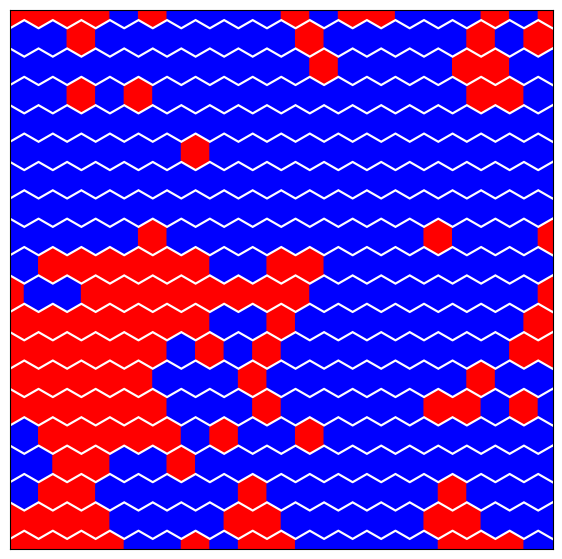

Step:11


sample: 100%|██████████| 4000/4000 [00:35<00:00, 111.63it/s, 63 steps of size 2.12e-02. acc. prob=0.74] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      6.79      0.94      6.74      5.34      8.11     68.54      1.00
    alpha2      6.98      1.00      6.84      5.21      8.53     69.35      1.00
     delta      1.65      0.60      1.61      0.62      2.62    190.25      1.00
  k_length      0.09      0.01      0.09      0.08      0.11    154.36      1.01
   k_scale      0.15      0.12      0.11      0.03      0.30    118.61      1.02
     noise      1.40      1.76      0.89      0.03      2.93    178.00      1.00
         t      0.73      0.02      0.72      0.72      0.76     73.20      1.02



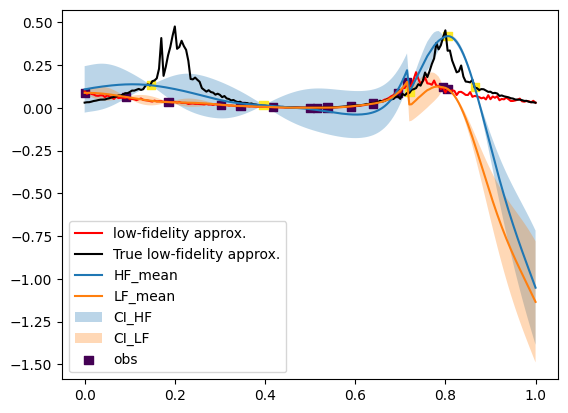

(402,)


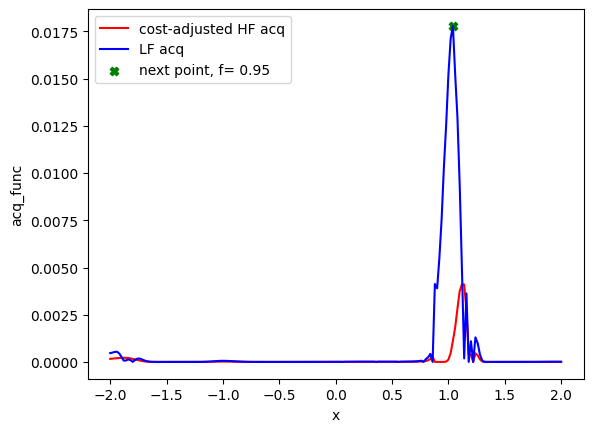

[362 374 159 118 128 139 161 103 100 143 152]
[1.04 0.95] 1.04
Evaluation 21 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.17it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.51it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 12: 69.98903131484985


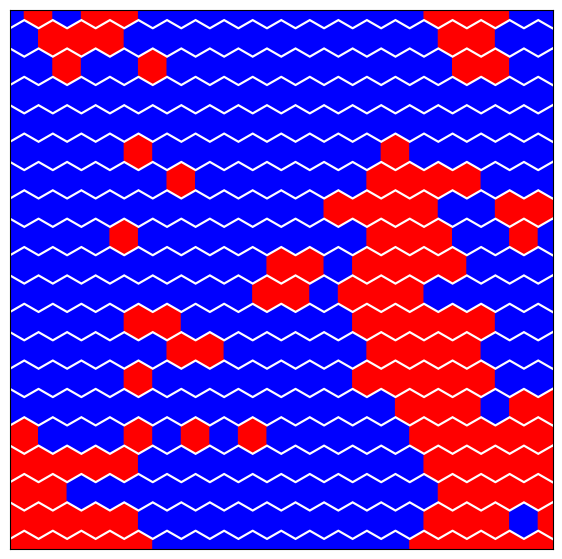

Step:12


sample: 100%|██████████| 4000/4000 [01:48<00:00, 36.86it/s, 1023 steps of size 4.29e-03. acc. prob=0.82]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.75      1.15      4.75      2.74      6.55     37.29      1.09
    alpha2      5.57      1.16      5.56      3.60      7.39    263.97      1.03
     delta      1.82      0.59      1.78      0.81      2.76    612.13      1.00
  k_length      0.06      0.01      0.06      0.05      0.07     27.62      1.10
   k_scale      0.11      0.06      0.09      0.03      0.18    659.63      1.00
     noise      1.58      2.35      0.95      0.05      3.33    706.09      1.00
         t      0.63      0.05      0.65      0.55      0.69      4.86      1.66



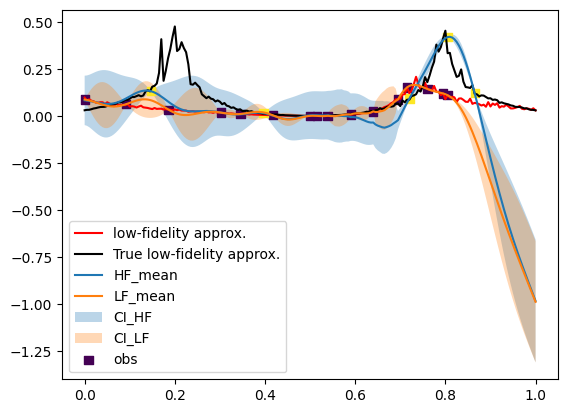

(402,)


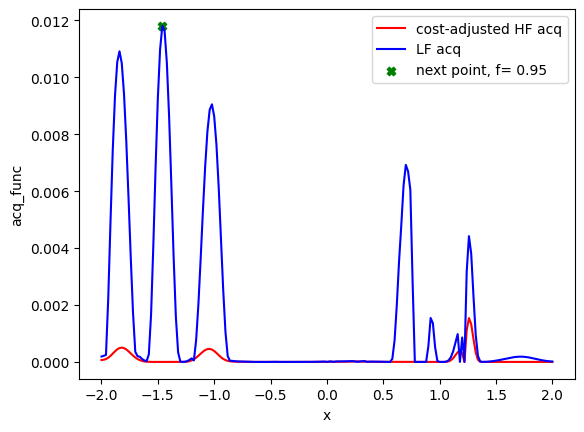

[362 374 159 118 128 139 161 103 100 143 152  27]
[-1.46  0.95] -1.46
Evaluation 22 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.00it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.69it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 13: 67.78271627426147


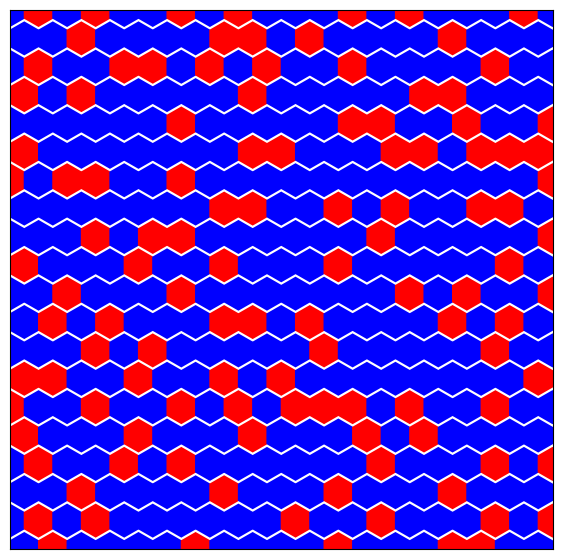

Step:13


sample: 100%|██████████| 4000/4000 [01:27<00:00, 45.57it/s, 1023 steps of size 5.78e-03. acc. prob=0.73]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.27      1.24      4.22      2.27      6.27    461.04      1.00
    alpha2      1.60      1.19      1.33      0.01      3.30    878.98      1.00
     delta      2.01      0.64      1.95      0.96      2.99    425.51      1.00
  k_length      0.05      0.01      0.05      0.04      0.06    327.87      1.00
   k_scale      0.08      0.05      0.07      0.02      0.14    348.95      1.00
     noise      1.55      2.03      0.94      0.05      3.41    480.05      1.00
         t      0.93      0.04      0.93      0.87      0.98    318.30      1.00



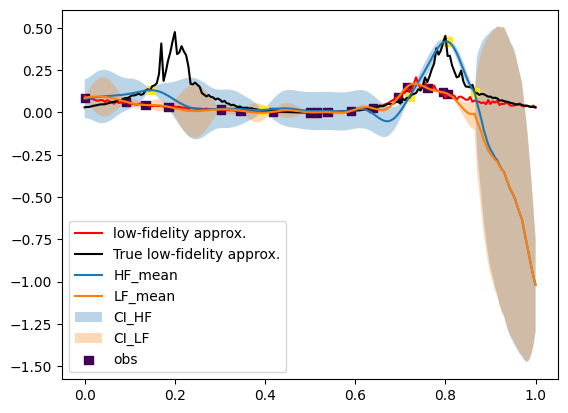

(402,)


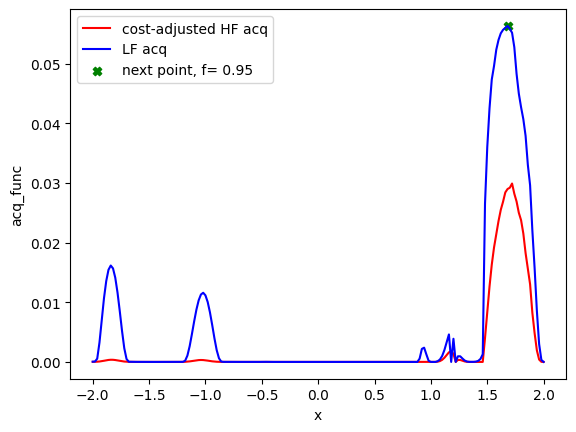

[362 374 159 118 128 139 161 103 100 143 152  27 184]
[1.68 0.95] 1.6800000000000002
Evaluation 23 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.01it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:35<00:00, 14.01it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 14: 66.95211553573608


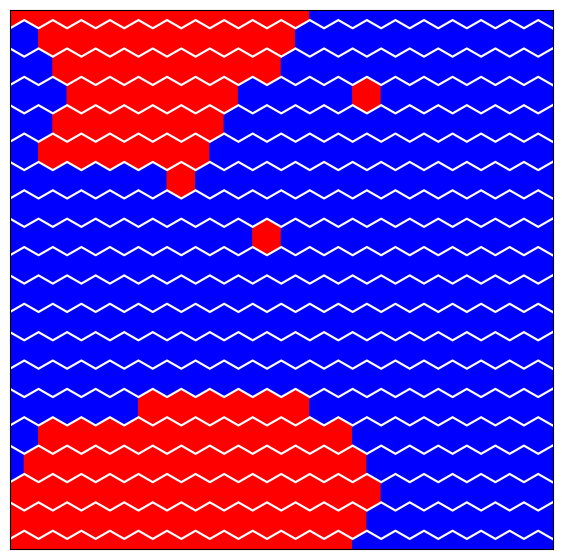

Step:14


sample: 100%|██████████| 4000/4000 [02:32<00:00, 26.18it/s, 1023 steps of size 3.82e-05. acc. prob=0.99]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      6.29      0.54      6.41      5.20      6.83      3.32      1.99
    alpha2      6.62      0.17      6.57      6.40      6.92      5.61      1.12
     delta      1.43      0.11      1.46      1.26      1.60      7.35      1.01
  k_length      0.06      0.00      0.07      0.06      0.07      5.40      1.30
   k_scale      0.14      0.01      0.14      0.13      0.17      6.32      1.26
     noise      1.04      0.12      1.03      0.86      1.26     11.90      1.22
         t      0.67      0.02      0.66      0.64      0.69      5.04      1.19



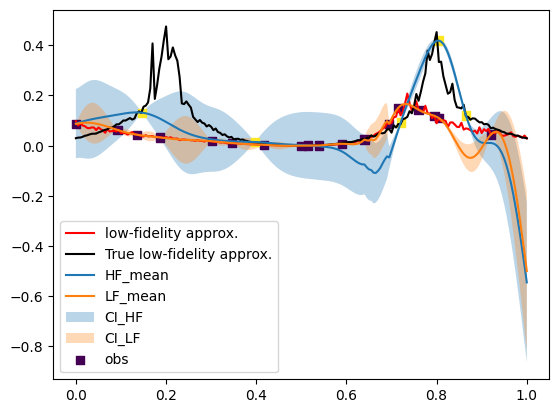

(402,)


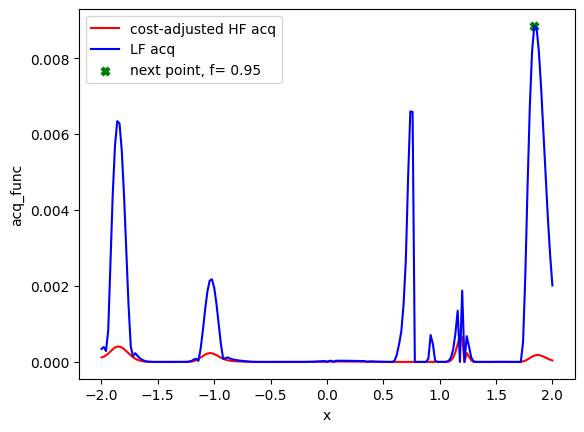

[362 374 159 118 128 139 161 103 100 143 152  27 184 192]
[1.84 0.95] 1.8399999999999999
Evaluation 24 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 16.05it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.63it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 15: 67.86844968795776


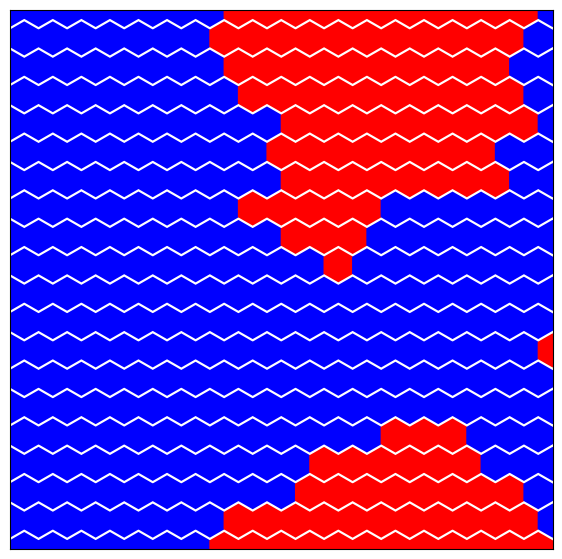

Step:15


sample: 100%|██████████| 4000/4000 [01:52<00:00, 35.50it/s, 1023 steps of size 5.06e-03. acc. prob=0.75]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.74      1.13      4.75      3.09      6.82    126.11      1.00
    alpha2      5.46      1.18      5.42      3.56      7.38    152.05      1.00
     delta      1.59      0.57      1.52      0.65      2.47    448.16      1.00
  k_length      0.06      0.01      0.06      0.05      0.07     74.23      1.00
   k_scale      0.15      0.07      0.14      0.05      0.25    343.67      1.00
     noise      1.54      1.77      1.02      0.04      3.35    701.35      1.00
         t      0.63      0.05      0.65      0.55      0.69     22.46      1.01



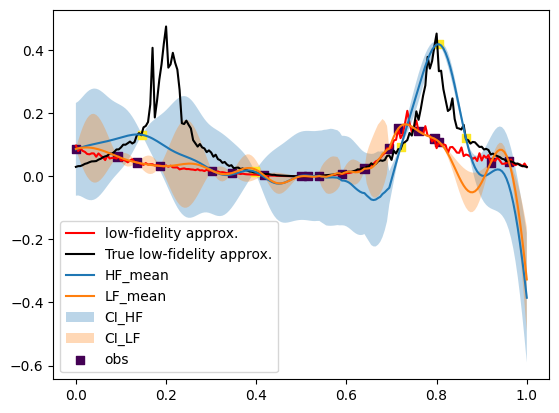

(402,)


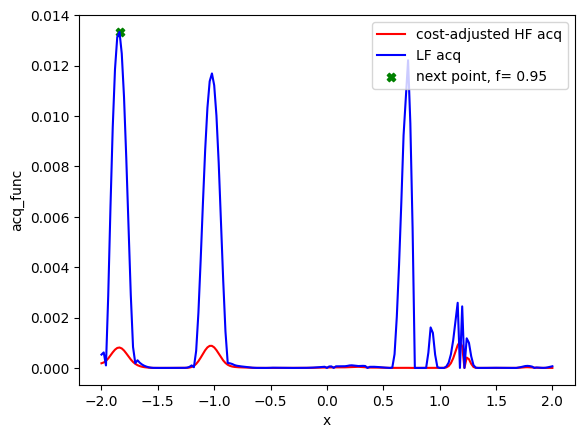

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8]
[-1.84  0.95] -1.84
Evaluation 25 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.93it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.75it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 16: 67.77528119087219


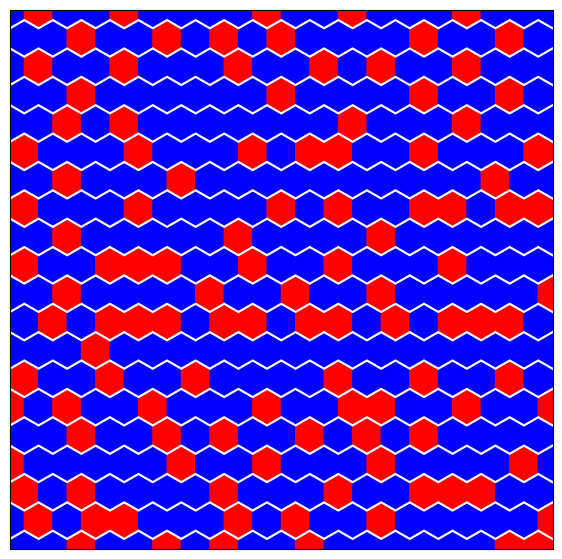

Step:16


sample: 100%|██████████| 4000/4000 [01:28<00:00, 45.22it/s, 127 steps of size 4.57e-02. acc. prob=0.78] 



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.91      1.04      4.90      3.25      6.75     57.25      1.06
    alpha2      5.57      1.16      5.51      3.57      7.40    154.04      1.02
     delta      1.64      0.56      1.58      0.78      2.60    722.36      1.01
  k_length      0.06      0.01      0.06      0.05      0.07     61.61      1.05
   k_scale      0.14      0.06      0.13      0.06      0.22    740.28      1.01
     noise      1.63      2.16      1.00      0.03      3.43    767.67      1.00
         t      0.64      0.05      0.66      0.56      0.69      9.20      1.29



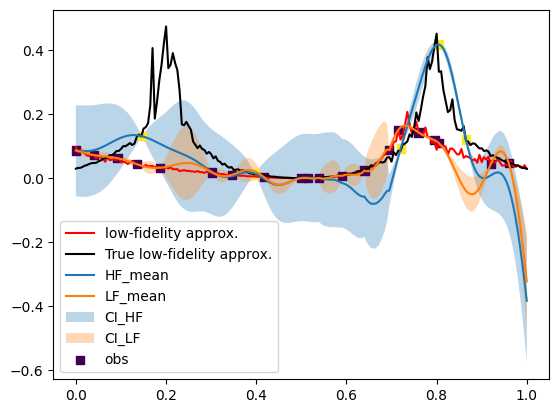

(402,)


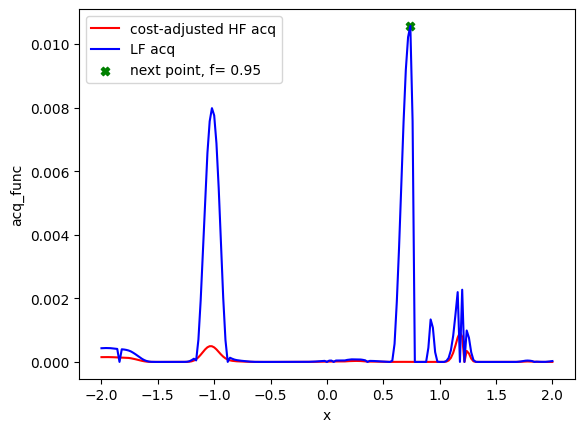

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137]
[0.74 0.95] 0.7400000000000002
Evaluation 26 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.76it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.52it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 17: 68.72794127464294


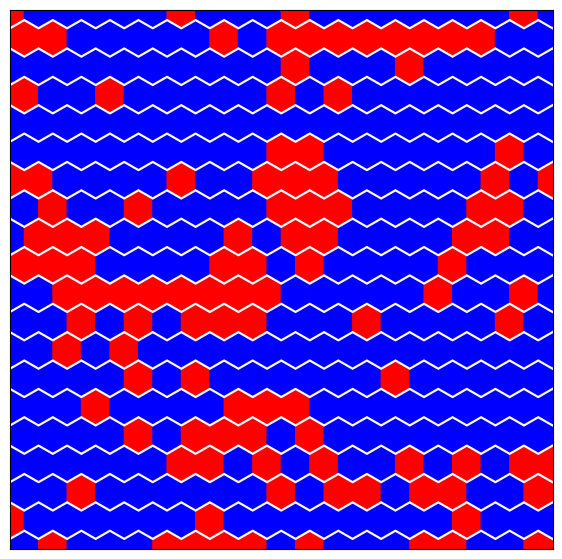

Step:17


sample: 100%|██████████| 4000/4000 [03:04<00:00, 21.65it/s, 1023 steps of size 2.24e-03. acc. prob=0.74]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.40      1.27      4.33      2.39      6.58    452.01      1.00
    alpha2      1.73      1.23      1.45      0.04      3.50    479.37      1.00
     delta      1.79      0.56      1.74      0.97      2.77    367.49      1.00
  k_length      0.04      0.00      0.04      0.04      0.05    245.65      1.02
   k_scale      0.10      0.04      0.09      0.03      0.15    296.90      1.00
     noise      1.65      2.32      0.96      0.01      3.59    390.31      1.00
         t      0.98      0.02      0.98      0.96      1.00    123.27      1.00



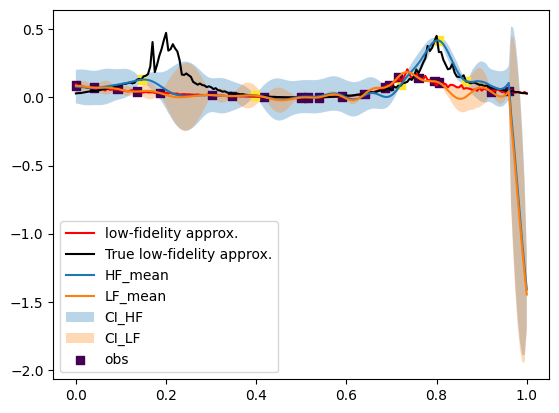

(402,)


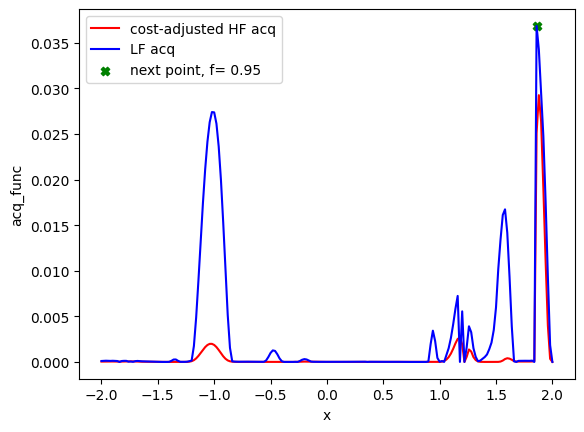

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193]
[1.86 0.95] 1.8599999999999999
Evaluation 27 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.57it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.50it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 18: 69.19056129455566


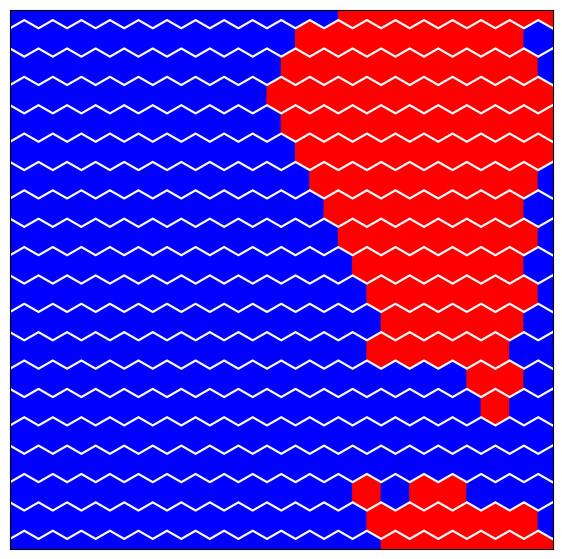

Step:18


sample: 100%|██████████| 4000/4000 [03:28<00:00, 19.18it/s, 1023 steps of size 2.13e-04. acc. prob=0.96]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      7.10      0.79      7.08      5.81      8.46     23.30      1.03
    alpha2      7.54      0.83      7.65      6.32      8.91     11.80      1.03
     delta      1.78      0.42      1.71      1.14      2.52     16.87      1.01
  k_length      0.05      0.00      0.05      0.05      0.06     13.95      1.06
   k_scale      0.14      0.05      0.13      0.07      0.21     13.43      1.20
     noise      1.74      1.10      1.52      0.19      3.18     24.69      1.11
         t      0.74      0.01      0.74      0.72      0.76      5.72      1.54



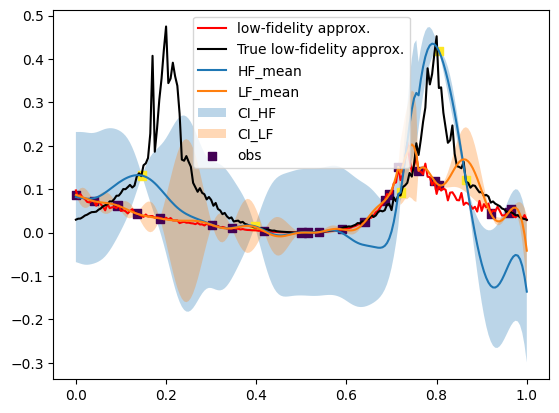

(402,)


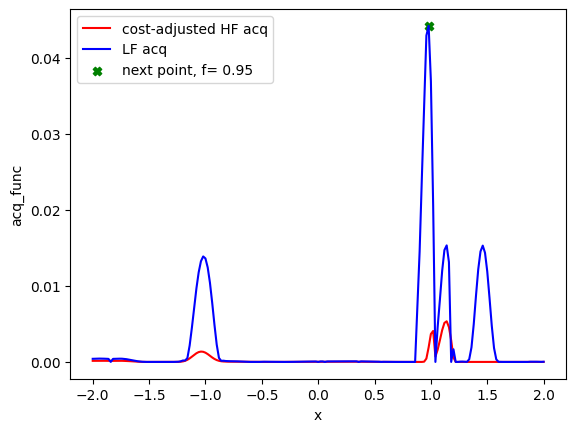

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149]
[0.98 0.95] 0.98
Evaluation 28 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.65it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.37it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 19: 69.3663387298584


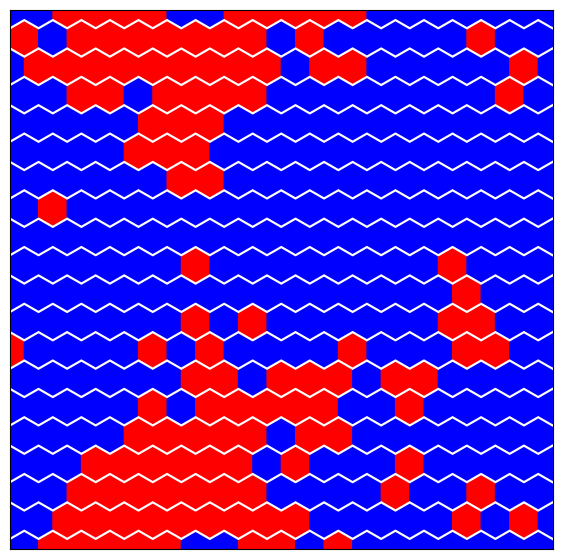

Step:19


sample: 100%|██████████| 4000/4000 [02:29<00:00, 26.68it/s, 255 steps of size 6.58e-03. acc. prob=0.71]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      3.60      1.17      3.48      1.76      5.48    550.28      1.00
    alpha2      3.47      1.68      3.49      0.01      5.65    302.84      1.00
     delta      1.49      0.55      1.44      0.57      2.32    547.70      1.00
  k_length      0.04      0.00      0.04      0.03      0.04    450.39      1.00
   k_scale      0.15      0.06      0.14      0.06      0.23    331.01      1.00
     noise      1.62      2.15      0.96      0.06      3.47    574.76      1.00
         t      0.84      0.03      0.84      0.81      0.89    321.82      1.00



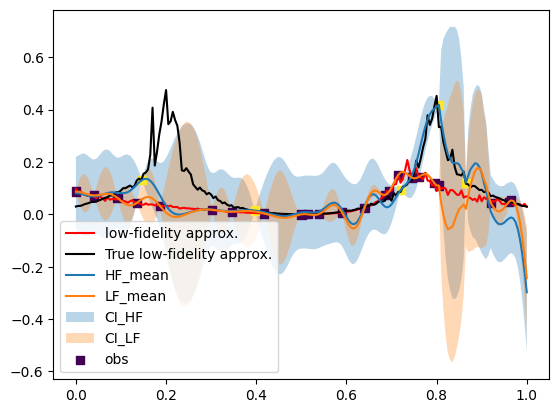

(402,)


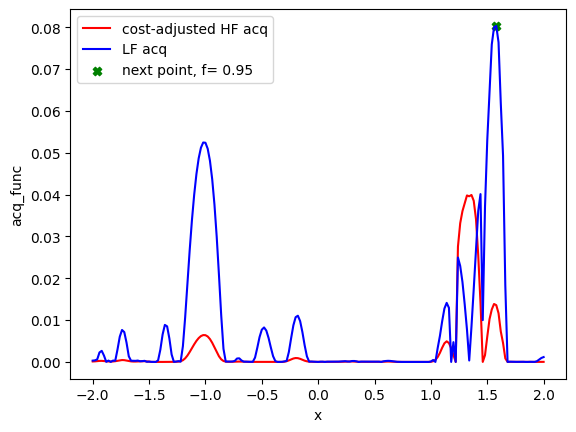

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179]
[1.58 0.95] 1.58
Evaluation 29 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.20it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:38<00:00, 12.90it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 20: 71.68885135650635


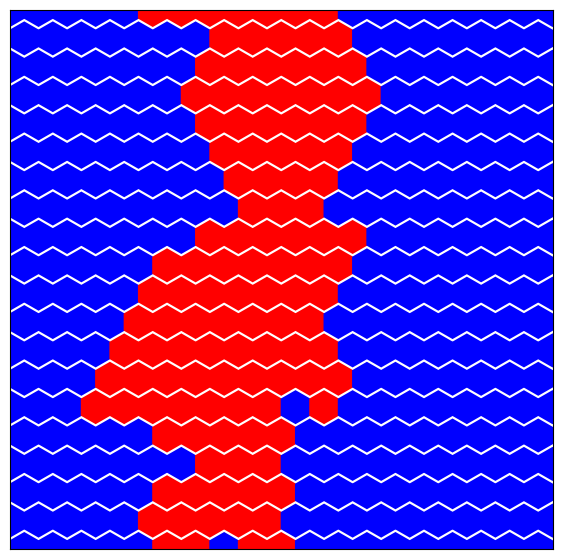

Step:20


sample: 100%|██████████| 4000/4000 [04:07<00:00, 16.16it/s, 1023 steps of size 7.78e-04. acc. prob=0.90]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.92      1.04      2.75      1.39      4.64    131.04      1.00
    alpha2      4.80      1.39      4.65      2.60      6.94     61.26      1.00
     delta      1.50      0.54      1.46      0.65      2.36     63.80      1.00
  k_length      0.04      0.00      0.04      0.03      0.04     43.57      1.01
   k_scale      0.15      0.07      0.13      0.07      0.23     30.60      1.04
     noise      1.88      2.63      1.06      0.04      4.16     74.79      1.00
         t      0.59      0.04      0.60      0.54      0.64     45.89      1.01



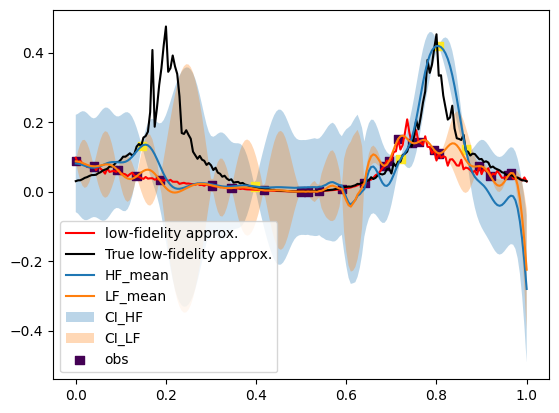

(402,)


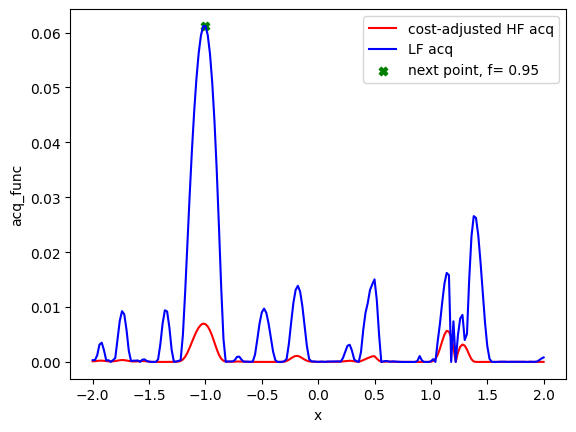

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50]
[-1.    0.95] -1.0
Evaluation 30 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.48it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.43it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 21: 69.54908514022827


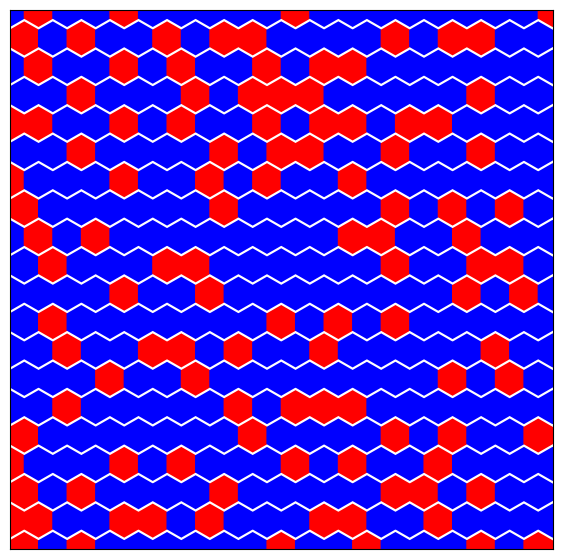

Step:21


sample: 100%|██████████| 4000/4000 [03:57<00:00, 16.85it/s, 1023 steps of size 4.50e-03. acc. prob=0.87]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.96      1.12      2.85      1.28      4.82    334.20      1.00
    alpha2      4.77      1.45      4.70      2.40      7.06    539.81      1.00
     delta      1.50      0.55      1.46      0.61      2.39   1193.70      1.00
  k_length      0.04      0.00      0.04      0.03      0.04    485.31      1.00
   k_scale      0.14      0.06      0.13      0.06      0.23    541.12      1.00
     noise      1.67      2.13      0.99      0.06      3.69   1149.62      1.00
         t      0.59      0.04      0.60      0.52      0.64     34.52      1.01



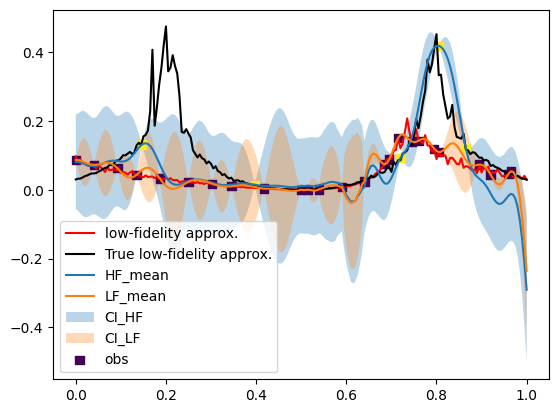

(402,)


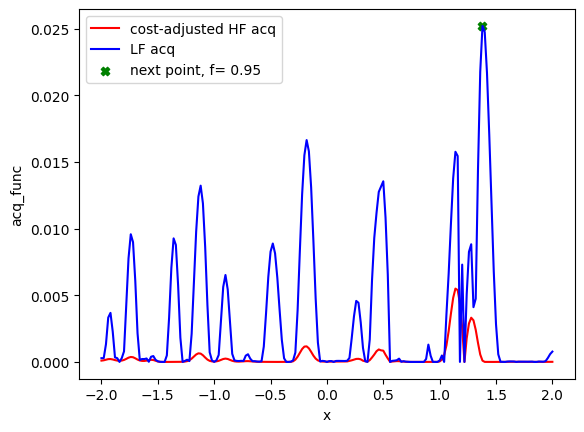

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50 169]
[1.38 0.95] 1.38
Evaluation 31 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.52it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.19it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 22: 70.15015649795532


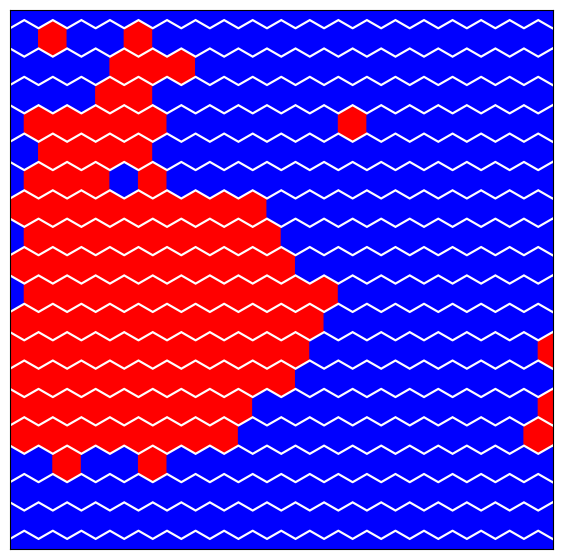

Step:22


sample: 100%|██████████| 4000/4000 [03:31<00:00, 18.92it/s, 1023 steps of size 4.93e-03. acc. prob=0.89]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.93      1.10      2.75      1.26      4.62    443.18      1.00
    alpha2      4.87      1.40      4.77      2.53      7.10    362.15      1.00
     delta      1.47      0.55      1.40      0.60      2.34   1183.80      1.00
  k_length      0.04      0.00      0.04      0.03      0.04    616.14      1.00
   k_scale      0.13      0.06      0.12      0.06      0.20    513.95      1.00
     noise      1.66      2.71      0.97      0.05      3.56    933.55      1.00
         t      0.59      0.04      0.60      0.53      0.64     71.12      1.00



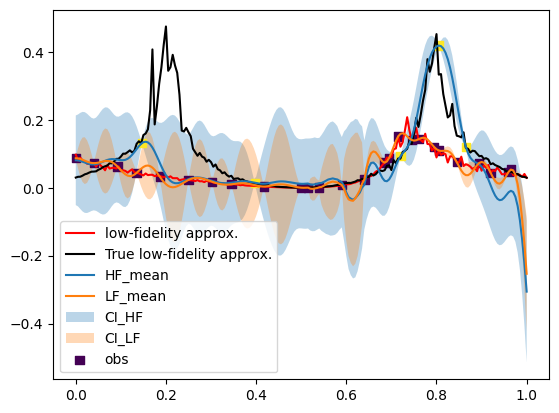

(402,)


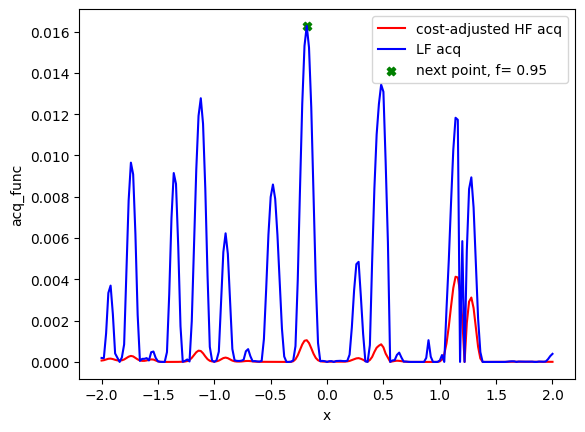

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50 169  91]
[-0.18  0.95] -0.17999999999999994
Evaluation 32 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.53it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.45it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 23: 69.38420248031616


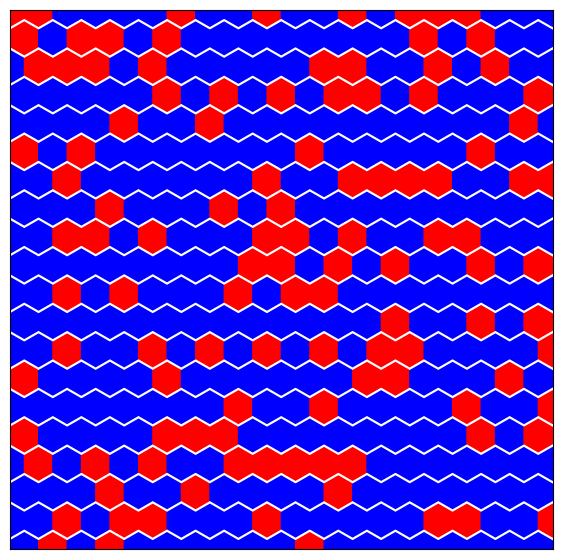

Step:23


sample: 100%|██████████| 4000/4000 [13:09<00:00,  5.07it/s, 1023 steps of size 2.39e-04. acc. prob=0.95]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      2.82      0.90      2.81      1.26      4.06     19.91      1.01
    alpha2      4.84      1.01      4.68      3.14      6.35     10.99      1.08
     delta      1.36      0.36      1.31      0.83      2.00     17.75      1.02
  k_length      0.04      0.00      0.04      0.04      0.04      6.93      1.19
   k_scale      0.14      0.05      0.13      0.06      0.22      6.39      1.44
     noise      1.43      0.94      1.25      0.13      2.46     50.23      1.01
         t      0.61      0.02      0.61      0.59      0.64     23.20      1.06



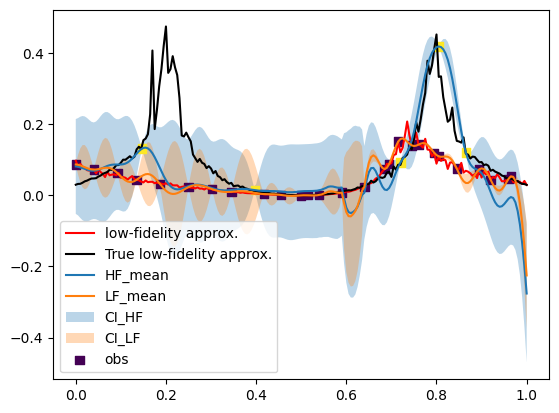

(402,)


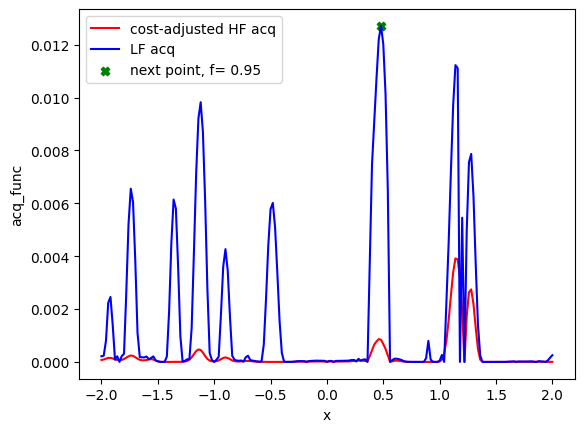

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50 169  91 124]
[0.48 0.95] 0.48
Evaluation 33 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.50it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:36<00:00, 13.55it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 24: 69.17644190788269


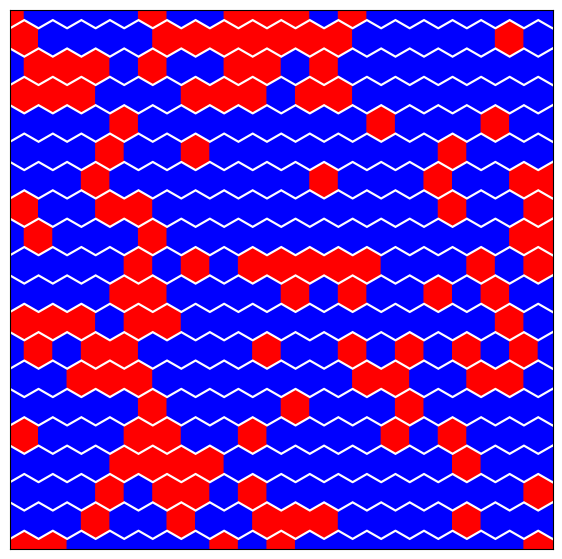

Step:24


sample: 100%|██████████| 4000/4000 [14:52<00:00,  4.48it/s, 1023 steps of size 1.34e-04. acc. prob=0.91]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.68      0.70      4.63      3.59      5.88     20.74      1.12
    alpha2      5.52      0.44      5.51      4.91      6.30     11.28      1.15
     delta      1.10      0.16      1.10      0.88      1.38     19.49      1.00
  k_length      0.04      0.00      0.04      0.04      0.04      3.20      1.94
   k_scale      0.17      0.06      0.15      0.09      0.26      3.56      2.21
     noise      1.30      0.52      1.20      0.45      2.05     11.67      1.20
         t      0.63      0.01      0.63      0.62      0.64    104.25      1.01



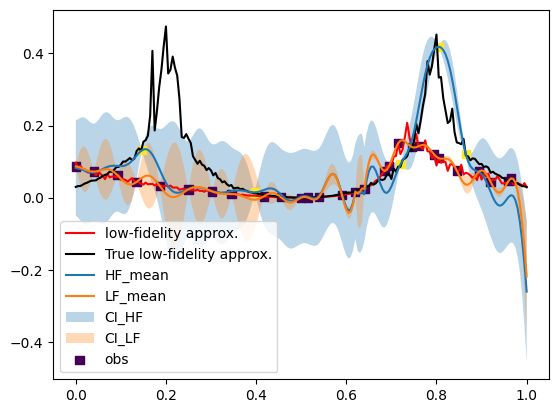

(402,)


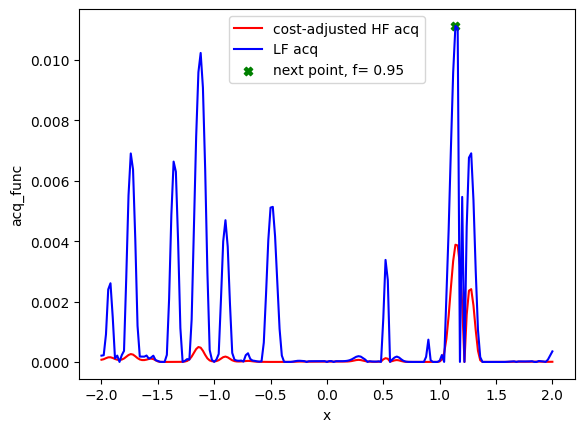

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50 169  91 124 157]
[1.14 0.95] 1.1400000000000001
Evaluation 34 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:31<00:00, 15.67it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.40it/s]
<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


Completed. Saving
Time (s) to complete simulation 25: 69.22279572486877


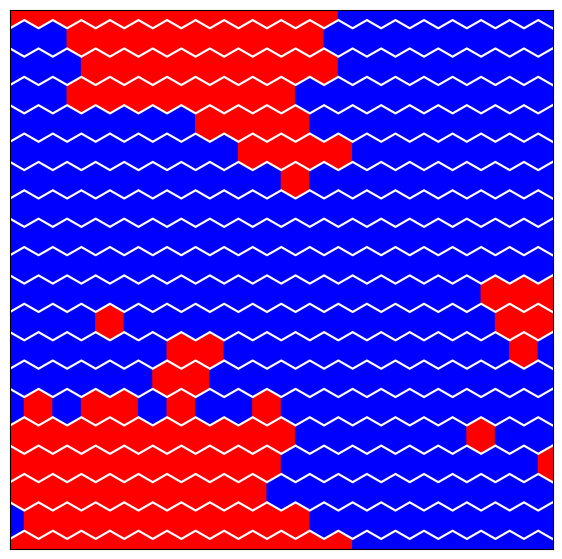

Step:25


sample: 100%|██████████| 4000/4000 [14:31<00:00,  4.59it/s, 1023 steps of size 6.92e-05. acc. prob=0.98]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.33      0.39      4.36      3.60      4.87     11.82      1.01
    alpha2      5.35      0.82      5.26      4.01      6.59      4.82      1.14
     delta      2.07      0.24      2.11      1.65      2.42      6.74      1.12
  k_length      0.03      0.00      0.03      0.03      0.04      4.81      1.50
   k_scale      0.15      0.04      0.13      0.10      0.20      3.76      2.21
     noise      1.80      0.40      1.78      1.15      2.48     19.21      1.11
         t      0.88      0.01      0.88      0.87      0.89      6.03      1.42



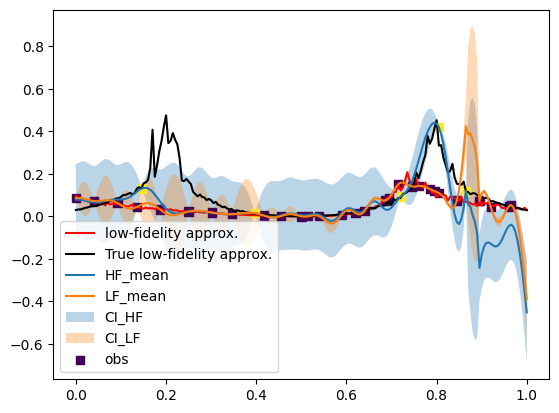

(402,)


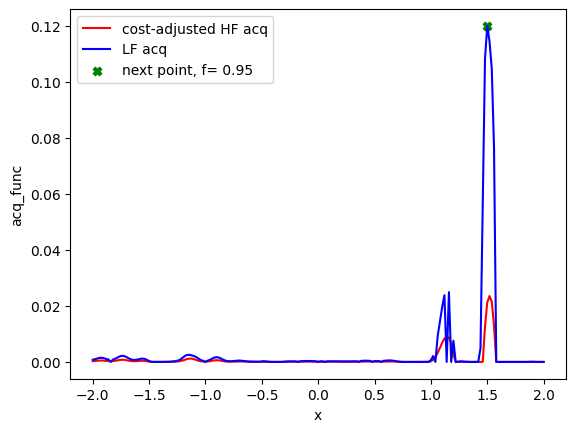

[362 374 159 118 128 139 161 103 100 143 152  27 184 192   8 137 193 149
 179  50 169  91 124 157 175]
[1.5  0.95] 1.5
Evaluation 35 of 35
Evaluation for fidelity: 0.95

---Performing Equlibration---



100%|██████████| 500/500 [00:32<00:00, 15.47it/s]



---Finished...
----Performing MC Moves----



100%|██████████| 500/500 [00:37<00:00, 13.28it/s]

Completed. Saving
Time (s) to complete simulation 26: 70.01024079322815



<ipython-input-4-d3cc8f309220>:231: MatplotlibDeprecationWarning: Passing the radius parameter of __init__() positionally is deprecated since Matplotlib 3.6; the parameter will become keyword-only two minor releases later.
  polygon = mpatches.RegularPolygon([i-dx/2., j], 6, 0.6*dx)


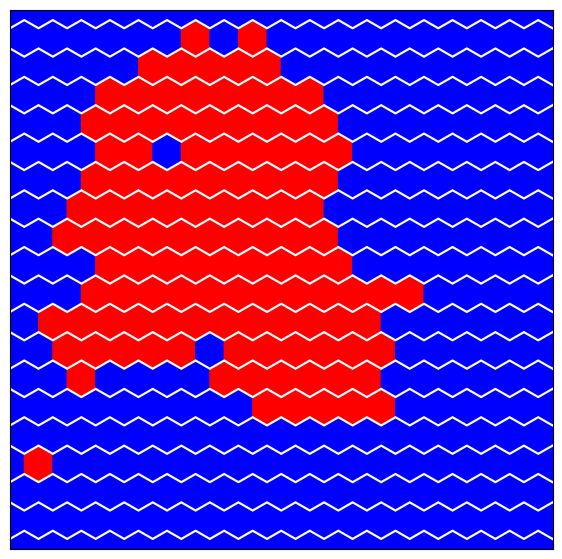

In [ ]:
N = 25
cost_ratio = 8.6/3 #time complexities
f = np.array([1.0, 2.0])
X_test_hf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[0]]))
X_test_lf = np.transpose(np.vstack([xs, np.ones_like(xs)*fidelities[1]]))
X_test =np.vstack((X_test_hf, X_test_lf))
X_test_full = np.vstack((X_test_hf, X_test_lf))
X_test_norm = np.vstack((X_test_hf, X_test_lf))
X_test_norm[:, 0] = (X_test[:, 0]-bounds[0])/(bounds[1]-bounds[0])

# Get random number generator keys for training and prediction
rng_key, rng_key_predict = gpax.utils.get_keys()
idx = []
for i in range(1, N+1):
    print("Step:"+str(i))


    # Initialize MF model
    gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior2, mean_fn=mean_func, mean_fn_prior=mf_priors)
    # Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
    gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)


    if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
        y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
        y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
        plt.plot(xs_norm, approx_ys_tri, "r", label="low-fidelity approx.")
        plt.plot(xs_norm, approx_ys_sq, "k", label="True low-fidelity approx.")
        pred_lower = y_pred - y_sampled.std(axis=(0,1))
        pred_upper = y_pred + y_sampled.std(axis=(0,1))
        pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
        pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
        plt.plot(xs_norm, y_pred, label="HF_mean")
        plt.plot(xs_norm, y_pred_lf, label="LF_mean")
        plt.fill_between(
            xs_norm.flatten(),
            pred_lower,
            pred_upper,
            alpha=0.3,
            label="CI_HF",
        )

        plt.fill_between(
            xs_norm.flatten(),
            pred_lower_lf,
            pred_upper_lf,
            alpha=0.3,
            label="CI_LF",
        )

        plt.scatter(train_x_full_norm[:, 0], train_y, c=train_x_full_norm[:, 1], cmap="viridis", marker="s", label="obs")

        plt.legend(loc="best")
        plt.show()
    # Compute the MF acq function - EI based
    test_data = [X_test, X_test_norm]
    acq, next_point_idx, next_point_val  = fidelity_acqfun(gp_model, test_data, f, cost_ratio, rng_key_predict, idx, isnorm=True)
    idx = np.hstack((idx, next_point_idx))
    if i == 1:
        idx = int(idx)
        print(idx)
    else:
        idx = idx
        print(idx)

    # acq = gpax.acquisition.EI(rng_key_predict, gp_model, X_test, maximize=True, noiseless=True)
    # acq = gpax.acquisition.UCB(rng_key_predict, gp_model, X_test, beta=4, maximize=True, noiseless=True)
    if next_point_val == 0:
        print("Model sufficiently learned")
        break
    else:
        next_point = X_test[next_point_idx]
        next_point_norm = X_test_norm[next_point_idx]
        train_x_full = np.vstack((train_x_full, next_point))
        train_x_full_norm = np.vstack((train_x_full_norm, next_point_norm))
        #print(next_point_idx, next_point, next_point_norm, train_x_full, train_x_full_norm)

        Jx=train_x_full[:,0]
        print(next_point, Jx[-1])
        J_mat = np.array([[0,0,0,0,0],
                  [0,0,Jx[-1],0,0],
                  [0,Jx[-1],0,Jx[-1],0],
                  [0,0,Jx[-1],0,0],
                  [0,0,0,0,0]])
        print("Evaluation " +str (n+i) +" of " +str(n+N))
        start_time = time.time()
        np.random.seed(0)
        if train_x_full[-1,1] == 1: #High fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            sq_sim = IsingSim(N = 60, J_mat = J_mat, T = 2.7, save_trajectories=True, eqSteps = 500, mcSteps = 500)  # Intializing the object
        else: #Low fidelity
            print("Evaluation for fidelity: "+str(train_x_full[-1,1]))
            J_mat = np.array([[0,Jx[-1],0,Jx[-1],0],
                      [Jx[-1],0,0,0,Jx[-1]],
                      [0,Jx[-1],0,Jx[-1],0]])
            tri_sim = Tri_IsingSim(N = 20, J_mat = J_mat, T = 2.7, save_trajectories=True, # Intializing the object
                    eqSteps = 500, mcSteps = 500,
                    prop = 0.3)  # Proportion of the sites occupied
            sq_sim = tri_sim

        sq_sim.performIsingSim()   # Running the sim
        end_time = time.time()
        #time_eval[i]= end_time-start_time
        print("Time (s) to complete simulation " +str(i+1)+ ": " +str(end_time-start_time))
        resultsBO_dict[n+i] = {'sim': sq_sim.results,}
        new_y = resultsBO_dict[n+i]['sim']['SpecificHeat']
        if train_x_full[-1,1] == 1: #High fidelity
            plt.imshow(resultsBO_dict[n+i]['sim']['config'][-1])

        else: #Low fidelity
            sq_sim.plot_config(resultsBO_dict[n+i]['sim']['config'][-1])

        plt.show()
        train_y = np.vstack((train_y, new_y))

    #X_test = np.concatenate([X_test[:next_point_idx], X_test[next_point_idx+1:]])
    #print(X_test.shape)

# Final GP prediction

sample: 100%|██████████| 4000/4000 [12:07<00:00,  5.50it/s, 1023 steps of size 4.40e-04. acc. prob=0.97]



                mean       std    median      5.0%     95.0%     n_eff     r_hat
    alpha1      4.84      1.19      4.75      2.98      6.86     28.05      1.00
    alpha2      6.31      1.30      6.33      4.21      8.22     50.47      1.00
     delta      1.71      0.46      1.67      0.96      2.42     35.47      1.03
  k_length      0.03      0.00      0.03      0.02      0.03     28.51      1.05
   k_scale      0.09      0.03      0.08      0.05      0.14     20.97      1.04
     noise      1.61      2.06      1.08      0.07      3.21     75.53      1.00
         t      0.83      0.01      0.83      0.81      0.84     39.01      1.06



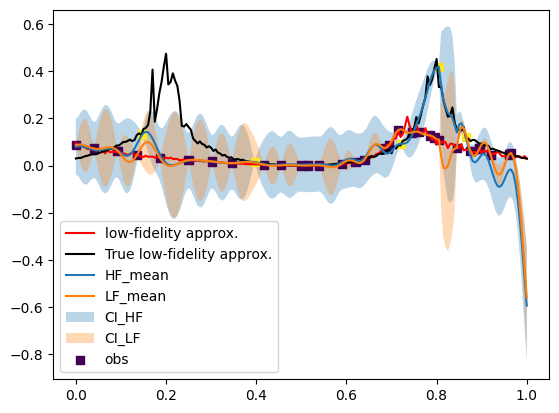

In [ ]:
# Initialize MF model
gp_model = gpax.ExactGP(1, kernel= fidelity_kernel, kernel_prior = fidelity_kernel_prior2, mean_fn=mean_func, mean_fn_prior=mf_priors)
# Run Hamiltonian Monte Carlo to obtain posterior samples for kernel parameters and model noise
gp_model.fit(rng_key, train_x_full_norm, train_y, num_chains=1)

if ((i == 1) or ((i % 1) == 0)): # Check predictions after every 3 BO runs
    y_pred, y_sampled = gp_model.predict(rng_key_predict, X_test_norm[X_test_lf.shape[0]:, :], noiseless=False)
    y_pred_lf, y_sampled_lf = gp_model.predict(rng_key_predict, X_test_norm[0:X_test_lf.shape[0], :], noiseless=False)
    plt.plot(xs_norm, approx_ys_tri, "r", label="low-fidelity approx.")
    plt.plot(xs_norm, approx_ys_sq, "k", label="True low-fidelity approx.")
    pred_lower = y_pred - y_sampled.std(axis=(0,1))
    pred_upper = y_pred + y_sampled.std(axis=(0,1))
    pred_lower_lf = y_pred_lf - y_sampled_lf.std(axis=(0,1))
    pred_upper_lf = y_pred_lf + y_sampled_lf.std(axis=(0,1))
    plt.plot(xs_norm, y_pred, label="HF_mean")
    plt.plot(xs_norm, y_pred_lf, label="LF_mean")
    plt.fill_between(
        xs_norm.flatten(),
        pred_lower,
        pred_upper,
        alpha=0.3,
        label="CI_HF",
    )

    plt.fill_between(
        xs_norm.flatten(),
        pred_lower_lf,
        pred_upper_lf,
        alpha=0.3,
        label="CI_LF",
    )

    plt.scatter(train_x_full_norm[:, 0], train_y, c=train_x_full_norm[:, 1], cmap="viridis", marker="s", label="obs")

    plt.legend(loc="best")
    plt.show()

In [ ]:
train_x_full

array([[-0.33191198,  0.95      ],
       [ 0.88129797,  1.        ],
       [-1.9995425 ,  0.95      ],
       [-0.79066971,  0.95      ],
       [-1.41297644,  1.        ],
       [-1.63064562,  0.95      ],
       [-1.25495915,  0.95      ],
       [-0.61775709,  0.95      ],
       [-0.4129301 ,  1.        ],
       [ 0.15526694,  0.95      ],
       [ 1.22      ,  1.        ],
       [ 1.46      ,  1.        ],
       [ 1.18      ,  0.95      ],
       [ 0.36      ,  0.95      ],
       [ 0.56      ,  0.95      ],
       [ 0.78      ,  0.95      ],
       [ 1.22      ,  0.95      ],
       [ 0.06      ,  0.95      ],
       [ 0.        ,  0.95      ],
       [ 0.86      ,  0.95      ],
       [ 1.04      ,  0.95      ],
       [-1.46      ,  0.95      ],
       [ 1.68      ,  0.95      ],
       [ 1.84      ,  0.95      ],
       [-1.84      ,  0.95      ],
       [ 0.74      ,  0.95      ],
       [ 1.86      ,  0.95      ],
       [ 0.98      ,  0.95      ],
       [ 1.58      ,